In [1]:
import re
import math
import pickle
import requests
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb
from time import time
import IPython.display as Disp
from wordcloud import WordCloud
from pylatexenc.latex2text import LatexNodes2Text
from sklearn.metrics.pairwise import cosine_similarity
from gensim import corpora, models, similarities
from sklearn.feature_extraction.text import TfidfVectorizer, ENGLISH_STOP_WORDS
from sklearn.neighbors import NearestNeighbors
from sklearn.decomposition import PCA
from sklearn.metrics import mean_squared_error
from underthesea import word_tokenize
from operator import itemgetter
warnings.filterwarnings('ignore')
pd.set_option('display.max_colwidth', None)

In [2]:
df_org = pd.read_csv('2k_data_Sep.csv')
df = df_org.copy()
df.shape

(2000, 8)

In [3]:
def clean_function(text):  
    #lowercase
    text = text.lower()
    
#     #xoá ký tự đặc biệt, ký tự không phải alphanumeric 
#     text = re.sub("[^a-z0-9àáạảãâầấậẩẫăằắặẳẵèéẹẻẽêềếệểễòóọỏõôồốộổỗơờớợởỡìíịỉĩùúụủũưừứựửữỳýỵỷỹđ]",' ', text)
    text = re.sub("[àáạảãâầấậẩẫăằắặẳẵèéẹẻẽêềếệểễòóọỏõôồốộổỗơờớợởỡìíịỉĩùúụủũưừứựửữỳýỵỷỹđ]",'', text)    
#     #xoá leading zero
#     text = [e.lstrip('0') for e in text.split(' ')]
#     text = (' ').join(text)
    
    #replace extra spaces with single space
    text = re.sub(' +',' ',text)
    
    #xoá khoảng trắng ở đầu và cuối mỗi câu
    text = text.strip()
    
    #word tokenzie
    text = word_tokenize(text, format='text')
    return text

In [4]:
check_dup = df[['Lookup Text', 'Question Text']][df[['Lookup Text', 'Question Text']].duplicated()]
df = df.drop(check_dup.index)
df = df.reset_index(drop = True)
df.shape

(1962, 8)

In [5]:
df['index_org'] = df.index

df['lookup_plain'] = df['Lookup Text'].map(lambda x: LatexNodes2Text().latex_to_text(x))
df['question_plain'] = df['Question Text'].map(lambda x: LatexNodes2Text().latex_to_text(x))

df['clean_lookup'] = df['lookup_plain'].map(lambda x: clean_function(x))
df['clean_question'] = df['question_plain'].map(lambda x: clean_function(x))

df['char_count_lookup'] = df['clean_lookup'].str.len()
df['word_count_lookup'] = df['clean_lookup'].str.split().str.len()
df['average_word_length_lookup'] = df['char_count_lookup'] / df['word_count_lookup']

df['char_count_question'] = df['clean_question'].str.len()
df['word_count_question'] = df['clean_question'].str.split().str.len()
df['average_word_length_question'] = df['char_count_question'] / df['word_count_question']

In [6]:
with open('vietnamese-stopwords.txt', 'r', encoding='utf-8') as file:
    vn_stop_words = file.read()
vn_stop_words = vn_stop_words.split('\n') 

# combine Vietnamese stopwords and English stopwords
stop_words = ENGLISH_STOP_WORDS.union(vn_stop_words)

In [7]:
def cosine_search_new(query, tf, tfidf_matrix, data, top_result = 5, check_time = True):
    t0 = time()
    query = clean_function(query)
    query_tf = tf.transform([query])
    query_tf = pd.DataFrame(query_tf.toarray(),
                            columns = tf.get_feature_names())
    
    cosine_sim = cosine_similarity(query_tf, tfidf_matrix).flatten()
    
    related_question = cosine_sim.argsort()[-top_result:][::-1]
    
    cosine_sim = sorted(cosine_sim, reverse = True)
    similarities_score = cosine_sim[:top_result]
    
    result = pd.DataFrame({'question_text': data.iloc[related_question, :]['question_plain'].values,
                           'sim_score': similarities_score})
    if check_time:
        print('Time:', time() - t0)
    return result

In [9]:
def cosine_search_all_new(queries, tf, tfidf_matrix, data, top_result = 5, check_time = True):
    t0 = time()
    results = []
    for i in range(0, len(queries)):
        query = clean_function(queries[i])
        query_tf = tf.transform([query])
        query_tf = pd.DataFrame(query_tf.toarray(),
                                columns = tf.get_feature_names())
        cosine_sim = cosine_similarity(query_tf, tfidf_matrix.iloc[[i]]).flatten()
        results.append(cosine_sim[0])
    times = time() - t0
    if check_time:
        if times < 60:
            print('Cosine search took {:.2f}s.'.format(times))
        else:
            print('Cosine search took {:.2f} minutes.'.format(times / 60))
    return results

In [8]:
tf_question = TfidfVectorizer(analyzer = 'word', stop_words = stop_words, min_df=0)
tfidf_question = tf_question.fit_transform(df['clean_question'])
tfidf_question = pd.DataFrame(tfidf_question.toarray(),
                            columns = tf_question.get_feature_names())
tfidf_question.shape

(1962, 3749)

In [10]:
cosine_score = cosine_search_all_new(df['lookup_plain'].values, tf_question, tfidf_question, df)

Cosine search took 13.17s.


In [12]:
df['score'] = cosine_score

In [13]:
df.head()

,Feedback ID,Lookup Text,Question Text,Feedback Type,Feedback Result,Human Feedback,Lookup Image,Question Image,index_org,lookup_plain,question_plain,clean_lookup,clean_question,char_count_lookup,word_count_lookup,average_word_length_lookup,char_count_question,word_count_question,average_word_length_question,score
0,4416.0,b) \( \left(\frac{-4}{15}-\frac{18}{19}\right)-\left(\frac{20}{19}-\frac{11}{15}\right) \),a) \( \frac{2}{3}+\frac{-1}{3}+\frac{7}{15} \)\nd) \( \frac{3}{5}+\frac{1}{5} \cdot \frac{-17}{9} \)\nb) \( \left(\frac{-4}{15}-\frac{18}{19}\right)-\left(\frac{20}{19}-\frac{11}{15}\right) \)\nc) \( \left(\frac{9}{10}-\frac{15}{16}\right) \cdot\left(\frac{5}{12}-\frac{11}{15}-\frac{7}{20}\right) \)\ne) \( \left(\frac{-3}{4}+\frac{2}{5}\right): \frac{3}{7}+\left(\frac{3}{5}+\frac{-1}{4}\right): \frac{3}{7} \),NEGATIVE,MATCH,NOT MATCH,https://s3.icankid.io/uploads/question/9a7aa760-2952-11ed-8671-9785b1571c36,https://s3.icankid.io/uploads/question/41bf56d0-2929-11ed-8671-9785b1571c36,0,b) (-4/15-18/19)-(20/19-11/15),a) 2/3+-1/3+7/15\nd) 3/5+1/5·-17/9\nb) (-4/15-18/19)-(20/19-11/15)\nc) (9/10-15/16) ·(5/12-11/15-7/20)\ne) (-3/4+2/5): 3/7+(3/5+-1/4): 3/7,b ) ( - 4/15 - 18/19 ) - ( 20/19 - 11/15 ),a ) 2/3 + - 1/3_+_7/15 d ) 3/5 + 1/5 · - 17/9 b ) ( - 4/15 - 18/19 ) - ( 20/19 - 11/15 ) c ) ( 9/10 - 15/16 ) · ( 5/12 - 11/15 - 7/20 ) e ) ( - 3/4 + 2/5 ) : 3/7 + ( 3/5_+ - 1/4 ) : 3/7,42,14,3.000000,185,61,3.032787,0.830472
1,4419.0,Đề số \( 1 . \)\n1. Tính\nb) \( \sqrt{25} \)\nc) \( \sqrt{-36} \)\na) \( \sqrt{64} \)\ne) \( \sqrt{(-5)^{2}} \)\nd) \( \sqrt{5^{2}} \)\nf) \( \frac{2}{3} \sqrt{81}-\left(-\frac{3}{4}\right): \sqrt{\frac{9}{64}}+\left(\frac{\sqrt{2}}{\sqrt{3}}\right)^{0}-(\sqrt{3})^{2} \),b) \( \sqrt{25} \)\nc) \( \sqrt{-36} \)\na) \( \sqrt{64} \)\n\( 0=\frac{2 s}{\partial s} \) e) \( \sqrt{(-5)^{2}} \)\nd) \( \sqrt{5^{2}} \)\nf) \( \frac{2}{3} \sqrt{81}-\left(-\frac{3}{4}\right): \sqrt{\frac{9}{64}}+\left(\frac{\sqrt{2}}{3}\right)^{0}-(\sqrt{3})^{2} \),NEGATIVE,MATCH,MATCH,https://s3.icankid.io/uploads/question/03980200-298b-11ed-8671-9785b1571c36,https://s3.icankid.io/uploads/question/5a47b890-2529-11ed-8671-9785b1571c36,1,Đề số 1 .\n1. Tính\nb) √(25)\nc) √(-36)\na) √(64)\ne) √((-5)^2)\nd) √(5^2)\nf) 2/3√(81)-(-3/4): √(9/64)+(√(2)/√(3))^0-(√(3))^2,b) √(25)\nc) √(-36)\na) √(64)\n0=2 s/∂ s e) √((-5)^2)\nd) √(5^2)\nf) 2/3√(81)-(-3/4): √(9/64)+(√(2)/3)^0-(√(3))^2,s 1 . 1 ._tnh b ) √ ( 25 ) c ) √ ( - 36 ) a ) √ ( 64 ) e ) √ ( ( - 5 ) ^ 2 ) d ) √ ( 5 ^ 2 ) f ) 2/3_√ ( 81 ) - ( - 3/4 ) : √ ( 9/64 ) + ( √ ( 2 ) / √ ( 3 ) ) ^ 0 - ( √ ( 3 ) ) ^ 2,b ) √ ( 25 ) c ) √ ( - 36 ) a ) √ ( 64 ) 0 = 2 s / ∂ s e ) √ ( ( - 5 ) ^ 2 ) d ) √ ( 5 ^ 2 ) f ) 2/3_√ ( 81 ) - ( - 3/4 ) : √ ( 9/64 ) + ( √ ( 2 ) / 3 ) ^ 0 - ( √ ( 3 ) ) ^ 2,180,82,2.195122,174,81,2.148148,0.970282
2,4420.0,1. Tính: \( \sqrt{\frac{25}{4}}+\left(\sqrt{\frac{1}{2}}\right)^{2}:\left(\frac{-\sqrt{9}}{4}\right) \cdot \sqrt{\frac{16}{81}}-3^{2}-(-2)^{2} \),Đề số \( 3 . \)\n1. Tính: \( \sqrt{\frac{25}{4}}+\left(\sqrt{\frac{1}{2}}\right)^{2}:\left(\frac{-\sqrt{9}}{4}\right) \cdot \sqrt{\frac{16}{81}}-3^{2}-(-2)^{2} \),POSITIVE,MATCH,MATCH,https://s3.icankid.io/uploads/question/a81b0750-298b-11ed-8671-9785b1571c36,https://s3.icankid.io/uploads/question/2d3358a0-2529-11ed-8671-9785b1571c36,2,1. Tính: √(25/4)+(√(1/2))^2:(-√(9)/4) ·√(16/81)-3^2-(-2)^2,Đề số 3 .\n1. Tính: √(25/4)+(√(1/2))^2:(-√(9)/4) ·√(16/81)-3^2-(-2)^2,1_._tnh : √ ( 25/4 ) + ( √ ( 1/2 ) ) ^ 2 : ( - √ ( 9 ) / 4 ) ·_√ ( 16/81 ) - 3 ^ 2 - ( - 2 ) ^ 2,s 3 . 1 ._tnh : √ ( 25/4 ) + ( √ ( 1/2 ) ) ^ 2 : ( - √ ( 9 ) / 4 ) ·_√ ( 16/81 ) - 3 ^ 2 - ( - 2 ) ^ 2,96,40,2.400000,102,44,2.318182,0.933083
3,4423.0,"Câu 49: Cho hàm số \( y=f(x) \) có đạo hàm là \( f^{\prime}(x)=(x-1)\left(x^{2}-4\right)(x+10) \), với moi \( x \in R \). Có tất cả bao nhiêu giá trị nguyên của tham số \( m \) đề hàm số \( g(x)=f\left(|x|^{3}+3|x|-3 m-m^{2}\right) \) có đúng 7 điểm cực trị?\nA. 3 .\nB. 4 .\nC. 6\nD. 5 .",Câu 49. Cho hàm số \( y=f(x

In [41]:
mask1 = df['Human Feedback'] == 'NOT MATCH'
mask2 = df['Human Feedback'] == 'MATCH'

df_neg = df[mask1].reset_index(drop = True)
df_pos = df[mask2].reset_index(drop = True)

print(df_neg.shape)
print(df_pos.shape)

(966, 22)
(996, 22)


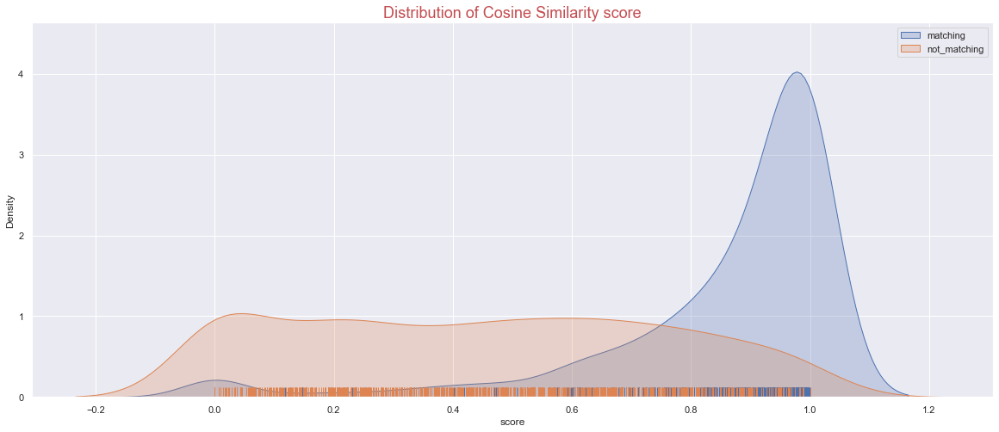

In [15]:
sb.set_theme()
plt.figure(figsize=(20, 8))
sb.distplot(df_pos.score, hist = False, rug = True, kde_kws={'shade':'kde_kws'},label = 'matching')
sb.distplot(df_neg.score, hist = False, rug = True, kde_kws={'shade':'kde_kws'},label = 'not_matching')
plt.legend()
plt.title('Distribution of Cosine Similarity score', fontsize = 18, color = 'r');

In [16]:
df.loc[df['score'] >= 0.8].shape

(906, 20)

In [17]:
def jaccard_search(query_matrix, source_matrix, check_time = True):
#     #Load data
#     df_product = pd.read_csv('data/product_names_clean.csv', index_col=0)
    
    t0=time()
    results = []
       
    for q1, q2 in zip(query_matrix, source_matrix):
        words_doc1 = set(q1.lower().split()) 
        words_doc2 = set(q2.lower().split())

        # Find the intersection of words list of doc1 & doc2
        intersection = words_doc1.intersection(words_doc2)

        # Find the union of words list of doc1 & doc2
        union = words_doc1.union(words_doc2)

        # Calculate Jaccard similarity score 
        # using length of intersectioEm n set divided by length of union set
        jaccard_score = len(intersection) / len(union)
        results.append(jaccard_score)
    times = time() - t0
    if check_time:
        if times < 60:
            print('Jaccard search took {:.2f}s.'.format(times))
        else:
            print('Jaccard search took {:.2f} minutes.'.format(times / 60))
    return results

In [18]:
jc_score = jaccard_search(df['clean_lookup'].values, df['clean_question'].values)

Jaccard search took 0.12s.


In [20]:
df['jc_score'] = jc_score

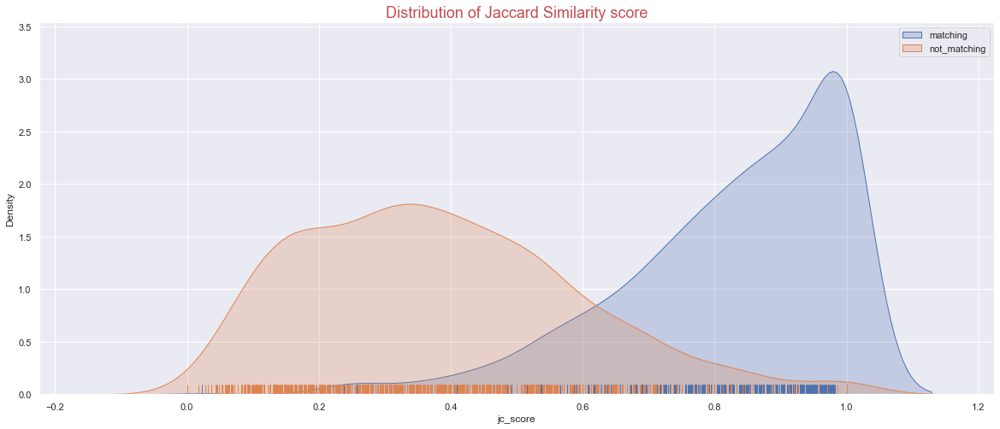

In [24]:
plt.figure(figsize=(20, 8))
sb.distplot(df_pos.jc_score, hist = False, rug = True, kde_kws={'shade':'kde_kws'},label = 'matching')
sb.distplot(df_neg.jc_score, hist = False, rug = True, kde_kws={'shade':'kde_kws'},label = 'not_matching')
plt.legend()
plt.title('Distribution of Jaccard Similarity score', fontsize = 18, color = 'r');

In [25]:
df.columns

Index(['Feedback ID', 'Lookup Text', 'Question Text', 'Feedback Type',
       'Feedback Result', 'Human Feedback', 'Lookup Image', 'Question Image',
       'index_org', 'lookup_plain', 'question_plain', 'clean_lookup',
       'clean_question', 'char_count_lookup', 'word_count_lookup',
       'average_word_length_lookup', 'char_count_question',
       'word_count_question', 'average_word_length_question', 'score',
       'jc_score'],
      dtype='object')

# Implement with PCA

In [50]:
pca = PCA(n_components = 600, random_state=42)
question_pca = pca.fit_transform(tfidf_question)

In [51]:
question_pca = pd.DataFrame(question_pca)
question_pca.shape

(1962, 600)

Sum of variance: 0.9281361794840177



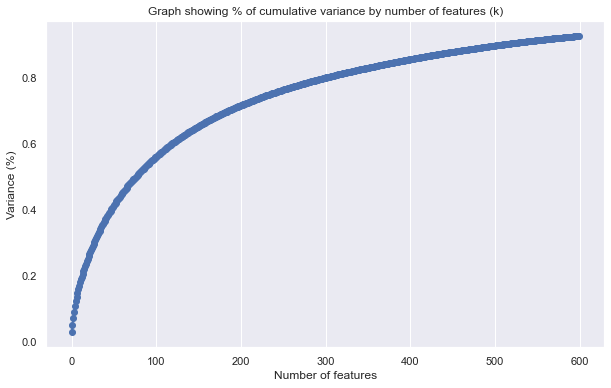

In [52]:
print('Sum of variance: {}'.format(pca.explained_variance_ratio_.sum()))
print()
sb.set_theme()
plt.figure(figsize=(10, 6))
plt.plot(np.cumsum(pca.explained_variance_ratio_), marker = "o")
plt.xlabel("Number of features")
plt.ylabel("Variance (%)")
plt.title("Graph showing % of cumulative variance by number of features (k)")
# plt.xlim([0, tfidf_matrix.shape[1] - 1])
plt.grid(axis = "y")
plt.show()

In [53]:
def cosine_search_all_pca(queries, tf, tfidf_matrix, data, top_result = 5, check_time = True):
    t0 = time()
    results = []
    for i in range(0, len(queries)):
        query = clean_function(queries[i])
        query_tf = tf_question.transform([query])
        query_tf = pd.DataFrame(query_tf.toarray(),
                                columns = tf_question.get_feature_names())
        query_pca = pca.transform(query_tf)
        cosine_sim = cosine_similarity(query_pca, tfidf_matrix.iloc[[i]]).flatten()
        results.append(cosine_sim[0])
    times = time() - t0
    if check_time:
        if times < 60:
            print('Cosine search took {:.2f}s.'.format(times))
        else:
            print('Cosine search took {:.2f} minutes.'.format(times / 60))
    return results

In [54]:
cosine_pca = cosine_search_all_pca(df['lookup_plain'].values, tf_question, question_pca, df)

Cosine search took 1.35 minutes.


In [55]:
df['pca_score'] = cosine_pca

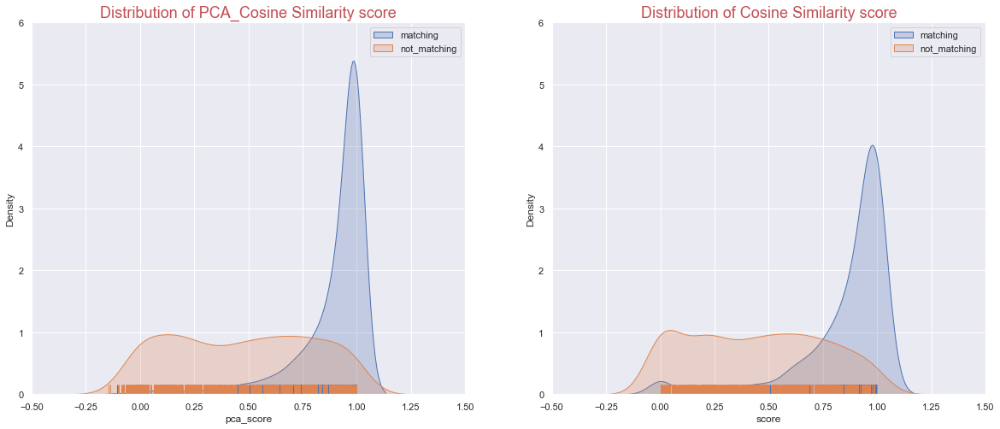

In [56]:
plt.figure(figsize=(20, 8))
plt.subplot(121)
sb.distplot(df_pos.pca_score, hist = False, rug = True, kde_kws={'shade':'kde_kws'},label = 'matching')
sb.distplot(df_neg.pca_score, hist = False, rug = True, kde_kws={'shade':'kde_kws'},label = 'not_matching')
plt.xlim([-0.5, 1.5])
plt.ylim([0, 6])
plt.legend()
plt.title('Distribution of PCA_Cosine Similarity score', fontsize = 18, color = 'r');
plt.subplot(122)
sb.distplot(df_pos.score, hist = False, rug = True, kde_kws={'shade':'kde_kws'},label = 'matching')
sb.distplot(df_neg.score, hist = False, rug = True, kde_kws={'shade':'kde_kws'},label = 'not_matching')
plt.xlim([-0.5, 1.5])
plt.ylim([0, 6])
plt.legend()
plt.title('Distribution of Cosine Similarity score', fontsize = 18, color = 'r');

In [61]:
df_test = df_neg.loc[df_neg['score'] >= 0.8]
df_test.shape

(147, 22)

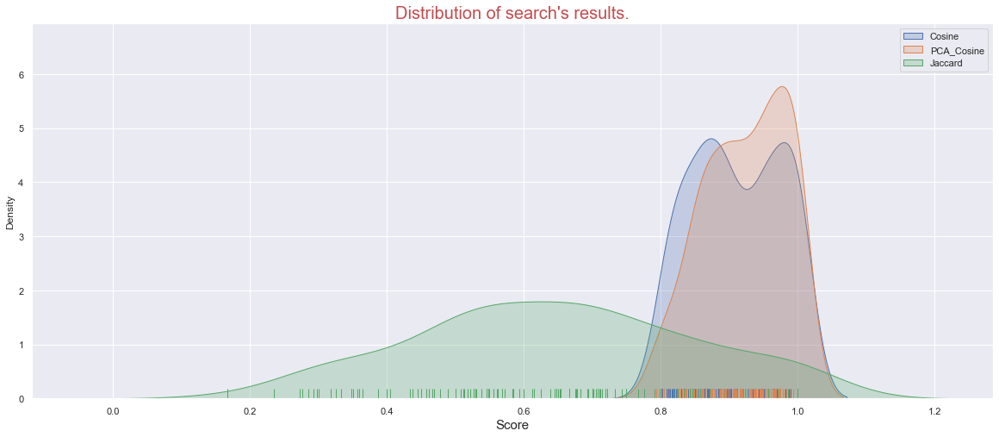

In [70]:
plt.figure(figsize=(20, 8))
sb.distplot(df_test.score, hist = False, rug = True, kde_kws={'shade':'kde_kws'},label = 'Cosine')
sb.distplot(df_test.pca_score, hist = False, rug = True, kde_kws={'shade':'kde_kws'},label = 'PCA_Cosine')
sb.distplot(df_test.jc_score, hist = False, rug = True, kde_kws={'shade':'kde_kws'},label = 'Jaccard')
plt.legend()
plt.xlabel('Score', fontsize=15)
plt.title("Distribution of search's results.", fontsize=20, color = 'r');

In [74]:
df_test = df_test.sort_values(by = 'score', ascending = False)
df_test.head()

,Feedback ID,Lookup Text,Question Text,Feedback Type,Feedback Result,Human Feedback,Lookup Image,Question Image,index_org,lookup_plain,...,clean_question,char_count_lookup,word_count_lookup,average_word_length_lookup,char_count_question,word_count_question,average_word_length_question,score,jc_score,pca_score
191,5590.0,(3) \( 68+42 \cdot 5-625: 25 \),"\( 3,68+42 \cdot 5-625: 25 \)",POSITIVE,MATCH,NOT MATCH,https://s3.icankid.io/uploads/question/9d22f0b0-3179-11ed-8671-9785b1571c36,https://s3.icankid.io/uploads/question/f718cba0-3177-11ed-8671-9785b1571c36,412,(3) 68+42 · 5-625: 25,...,"3,68 + 42 · 5-625 : 25",26,10,2.600000,22,7,3.142857,1.0,0.545455,1.0
317,6345.0,a) \( \frac{2}{15}+\left(\frac{-5}{24}\right) \),a) \( \frac{2}{15}+\left(\frac{-5}{24}\right) \),POSITIVE,SKIP,NOT MATCH,https://s3.icankid.io/uploads/question/ff2ad420-335f-11ed-afcb-abad28552b30,https://s3.icankid.io/uploads/question/7669bf60-069c-11ed-abd5-4dcb92c2b90f,694,a) 2/15+(-5/24),...,a ) 2/15_+ ( - 5/24 ),21,7,3.000000,21,7,3.000000,1.0,1.000000,1.0
950,9895.0,c) \( \frac{\sqrt{30}-\sqrt{18}}{\sqrt{8-2 \sqrt{15}}}+\frac{18}{\sqrt{6}}-\frac{20}{\sqrt{6}-1} \),c) \( \frac{\sqrt{30}-\sqrt{18}}{\sqrt{8}-2 \sqrt{15}}-\frac{20}{\sqrt{6}-1}+\frac{18}{\sqrt{6}} \),POSITIVE,SKIP,NOT MATCH,https://s3.icankid.io/uploads/question/eb69efa0-3a4b-11ed-afcb-abad28552b30,https://s3.icankid.io/uploads/question/aeca7a70-38d8-11ed-afcb-abad28552b30,1935,c) √(30)-√(18)/√(8-2 √(15))+18/√(6)-20/√(6)-1,...,c ) √ ( 30 ) - √ ( 18 ) / √ ( 8 ) - 2_√ ( 15 ) - 20 / √ ( 6 ) - 1 + 18 / √ ( 6 ),78,35,2.228571,80,37,2.162162,1.0,0.812500,1.0
564,7773.0,5. Tỉnh độ dài cạnh \( A B \) trong mỗi trường hợp sau:,Tính độ dài cạnh \( A B \) trong mỗi trường hợp sau:,POSITIVE,MATCH,NOT MATCH,https://s3.icankid.io/uploads/question/6b1b3bc0-3694-11ed-afcb-abad28552b30,https://s3.icankid.io/uploads/question/6c20c4e0-3694-11ed-afcb-abad28552b30,1204,5. Tỉnh độ dài cạnh A B trong mỗi trường hợp sau:,...,tnh di cnh a b trong mi trng hp sau :,41,13,3.153846,37,11,3.363636,1.0,0.846154,1.0
520,7578.0,4 Use the answers in 3 to write a paragraph of 40-50 words about your school. You can refer to the reading passages to help you.,Use the answers in 3 to write a paragraph of 40-50 words about your school. You can refer to the reading passages to help you.,POSITIVE,MATCH,NOT MATCH,https://s3.icankid.io/uploads/question/dc42ec40-35cb-11ed-afcb-abad28552b30,https://s3.icankid.io/uploads/question/de66ddb0-35cb-11ed-afcb-abad28552b30,1126,4 Use the answers in 3 to write a paragraph of 40-50 words about your school. You can refer to the reading passages to help you.,...,use the answers in 3 to write a paragraph of_40-50 words about your school ._you can refer to the reading passages to help you .,130,26,5.000000,128,25,5.120000,1.0,0.956522,1.0


In [76]:
df_test.shape[0]/df_neg.shape[0]

0.15217391304347827

PAIRS: 1 - Cosine score: 1.0000000000000002
-- Number of words: 10


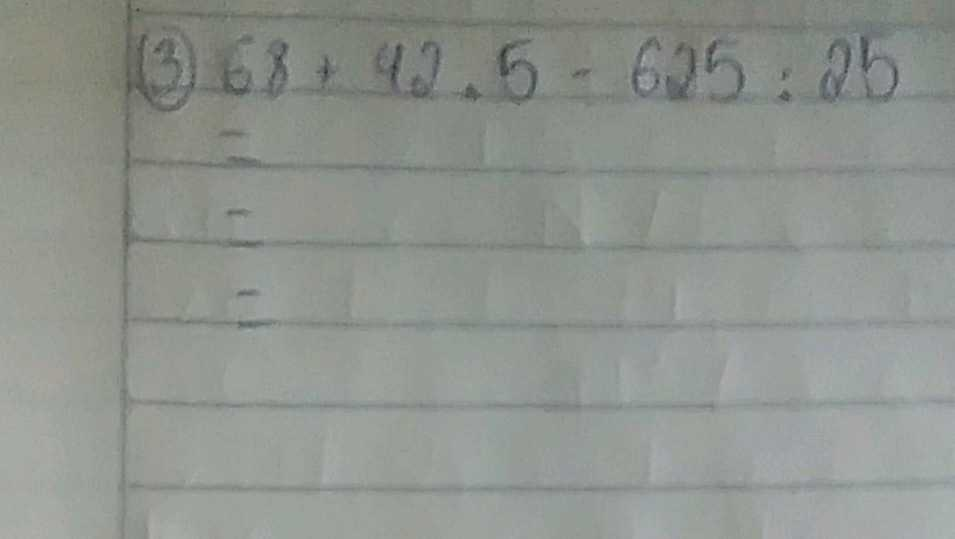

-- Number of words: 7


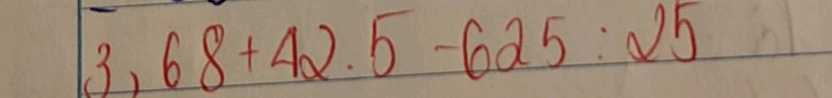

************

PAIRS: 2 - Cosine score: 1.0000000000000002
-- Number of words: 7


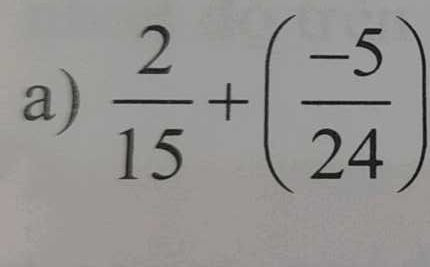

-- Number of words: 7


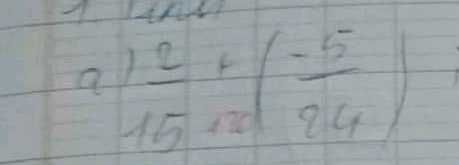

************

PAIRS: 3 - Cosine score: 1.0000000000000002
-- Number of words: 35


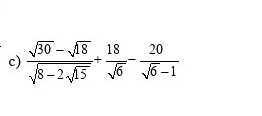

-- Number of words: 37


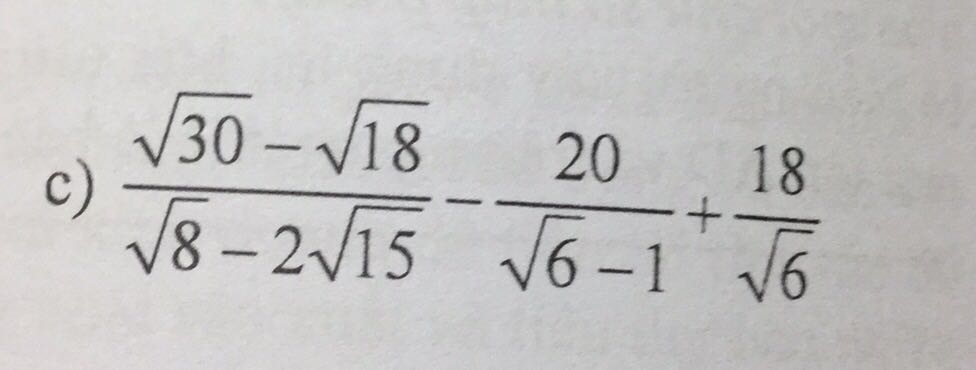

************

PAIRS: 4 - Cosine score: 1.0000000000000002
-- Number of words: 13


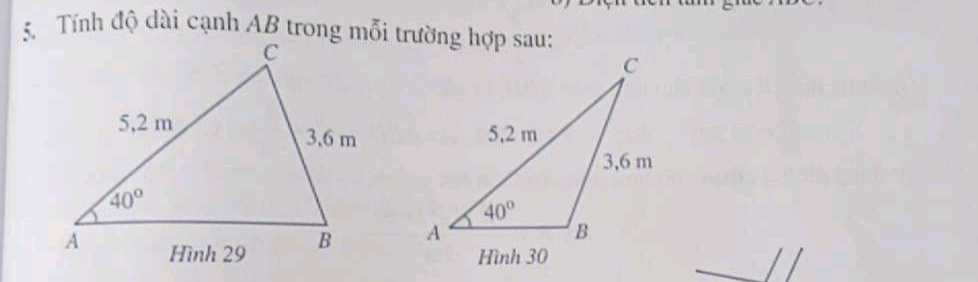

-- Number of words: 11


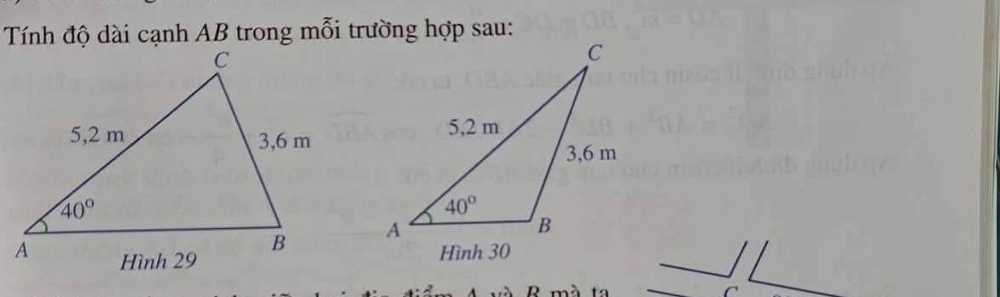

************

PAIRS: 5 - Cosine score: 1.0000000000000002
-- Number of words: 26


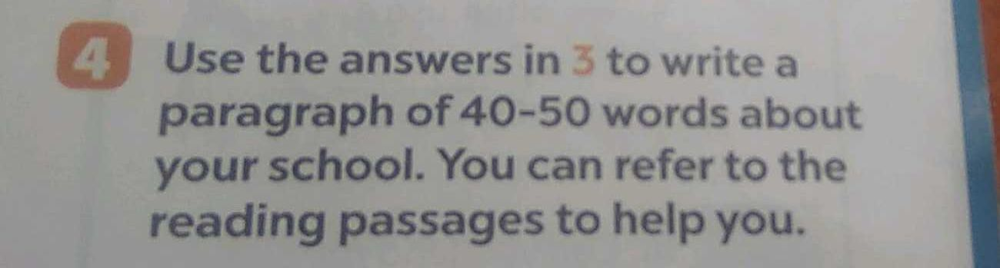

-- Number of words: 25


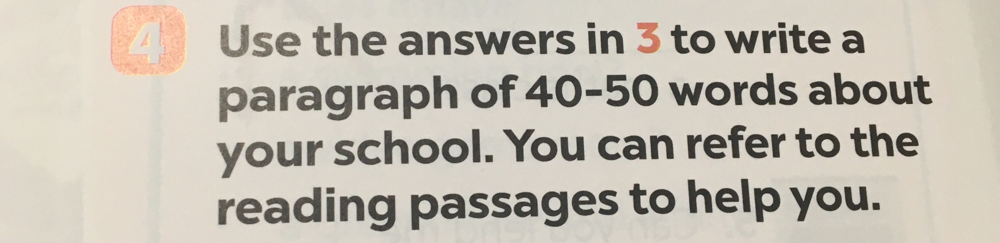

************

PAIRS: 6 - Cosine score: 1.0000000000000002
-- Number of words: 87


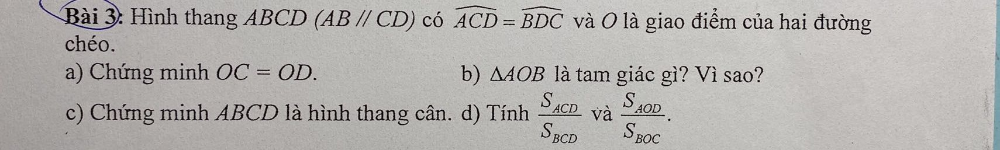

-- Number of words: 87


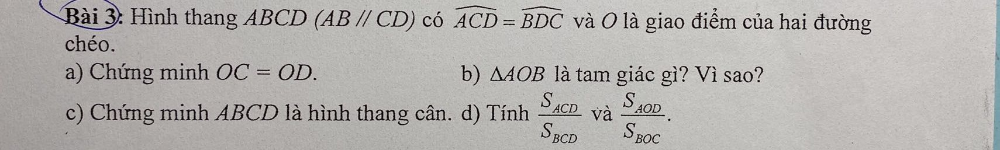

************

PAIRS: 7 - Cosine score: 1.0000000000000002
-- Number of words: 35


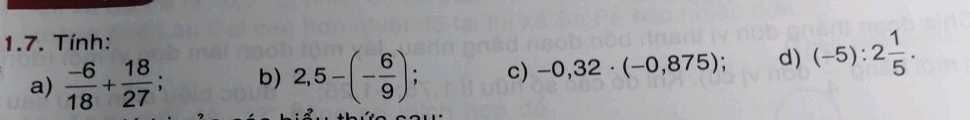

-- Number of words: 34


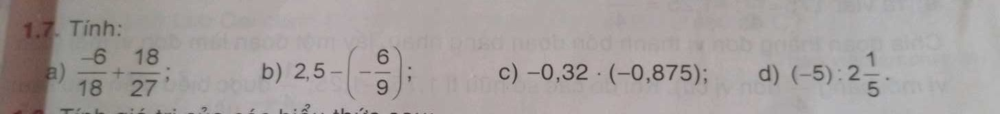

************

PAIRS: 8 - Cosine score: 1.0
-- Number of words: 57


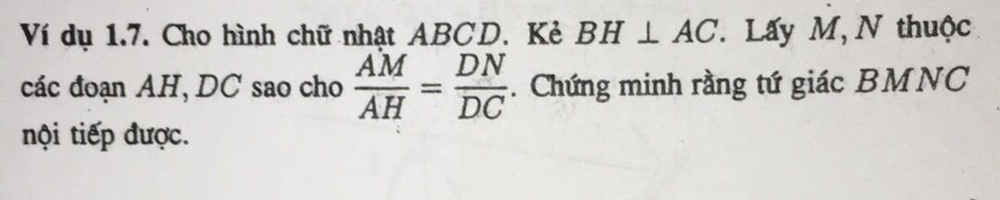

-- Number of words: 57


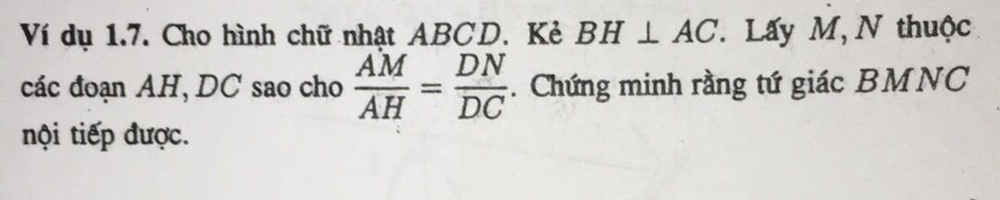

************

PAIRS: 9 - Cosine score: 1.0
-- Number of words: 9


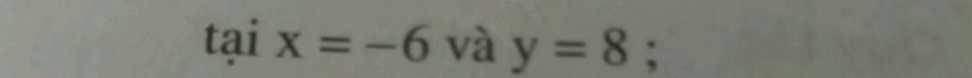

-- Number of words: 22


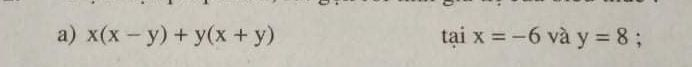

************

PAIRS: 10 - Cosine score: 1.0
-- Number of words: 20


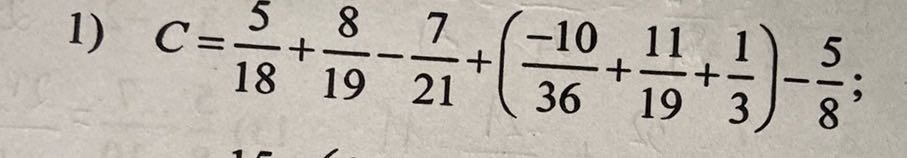

-- Number of words: 20


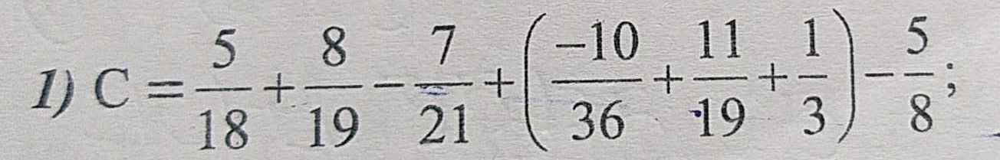

************

PAIRS: 11 - Cosine score: 1.0
-- Number of words: 16


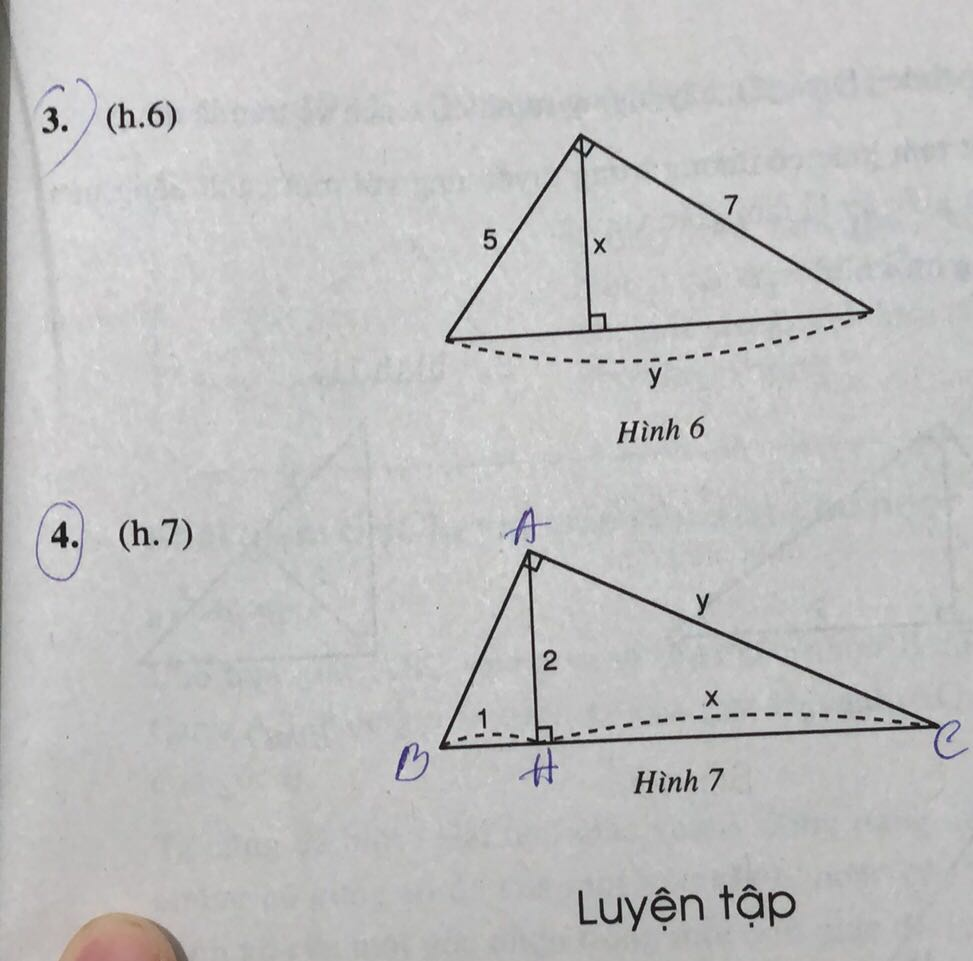

-- Number of words: 16


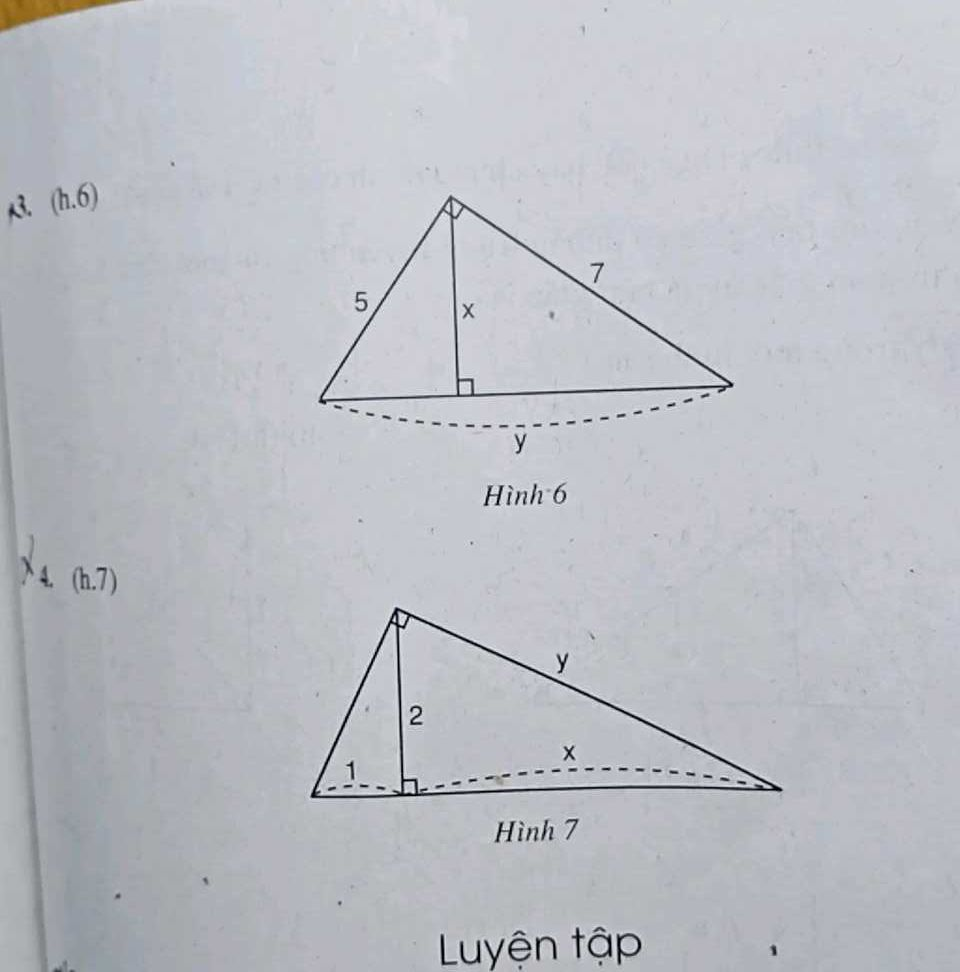

************

PAIRS: 12 - Cosine score: 1.0
-- Number of words: 59


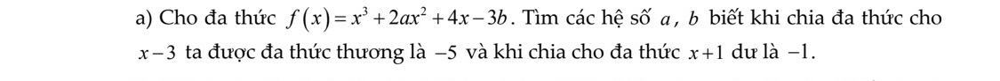

-- Number of words: 59


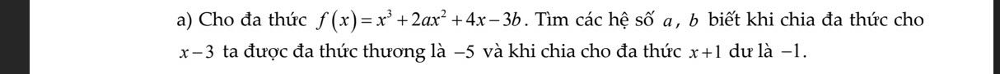

************

PAIRS: 13 - Cosine score: 1.0
-- Number of words: 23


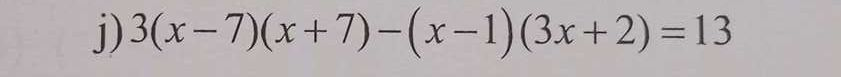

-- Number of words: 22


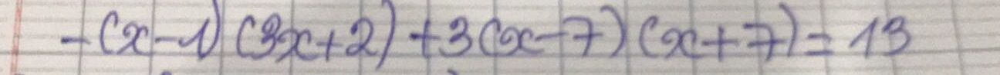

************

PAIRS: 14 - Cosine score: 1.0
-- Number of words: 14


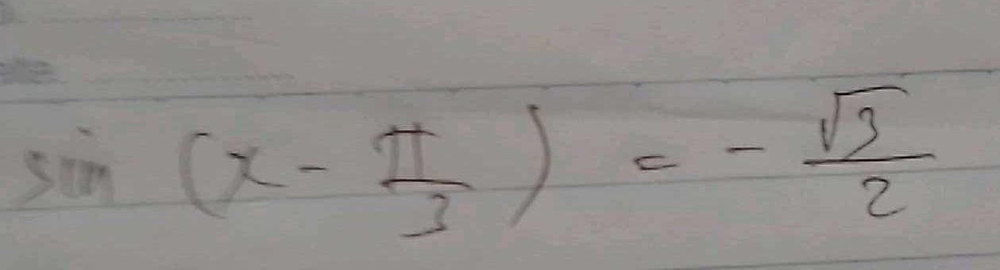

-- Number of words: 18


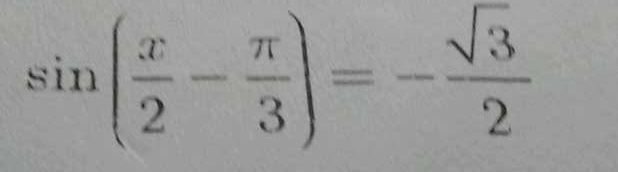

************

PAIRS: 15 - Cosine score: 1.0
-- Number of words: 10


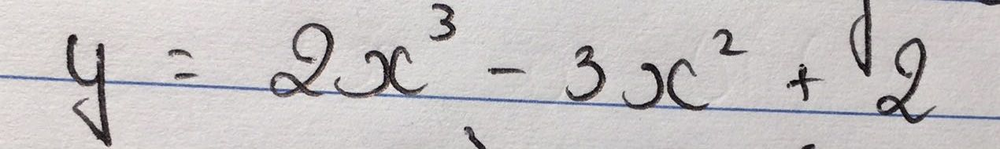

-- Number of words: 13


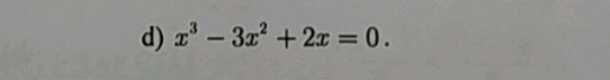

************

PAIRS: 16 - Cosine score: 1.0
-- Number of words: 20


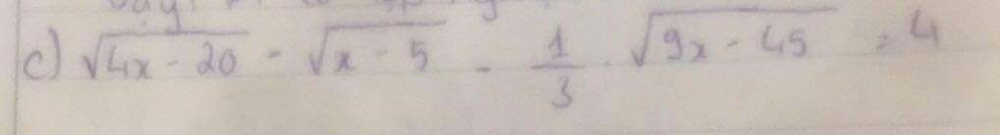

-- Number of words: 18


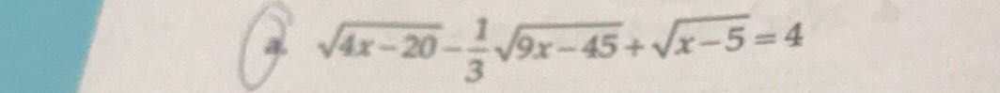

************

PAIRS: 17 - Cosine score: 1.0
-- Number of words: 19


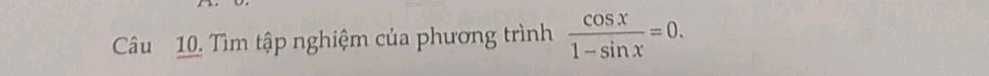

-- Number of words: 19


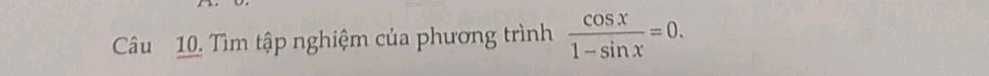

************

PAIRS: 18 - Cosine score: 1.0
-- Number of words: 26


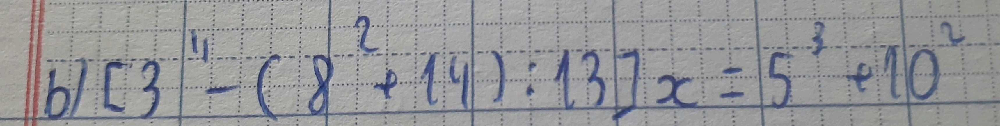

-- Number of words: 26


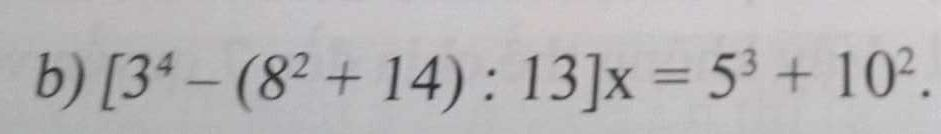

************

PAIRS: 19 - Cosine score: 1.0
-- Number of words: 30


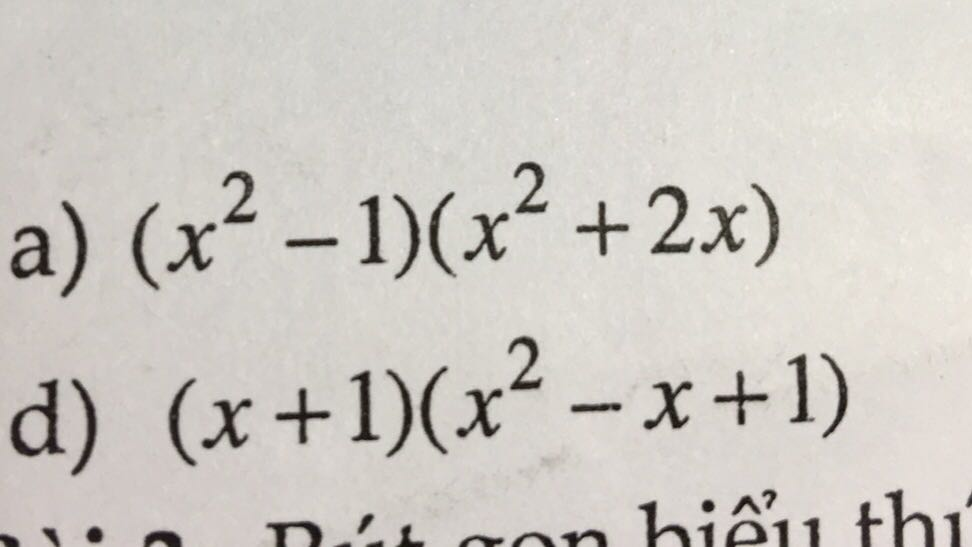

-- Number of words: 70


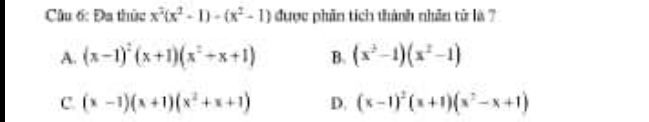

************

PAIRS: 20 - Cosine score: 1.0
-- Number of words: 39


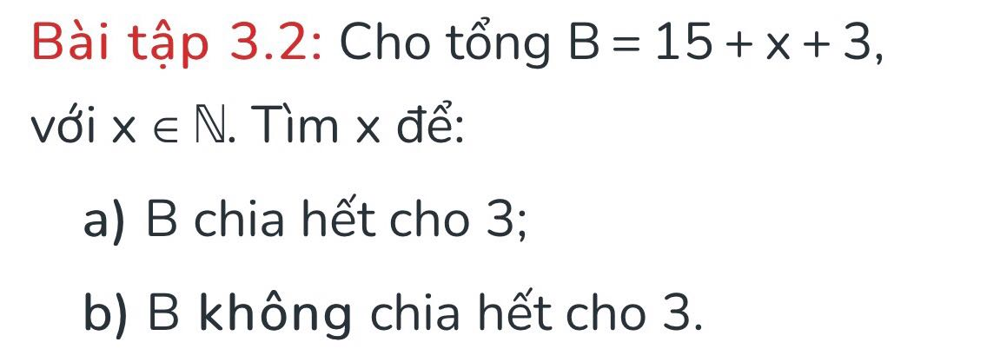

-- Number of words: 39


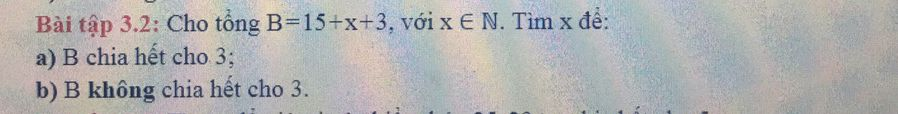

************

PAIRS: 21 - Cosine score: 1.0
-- Number of words: 37


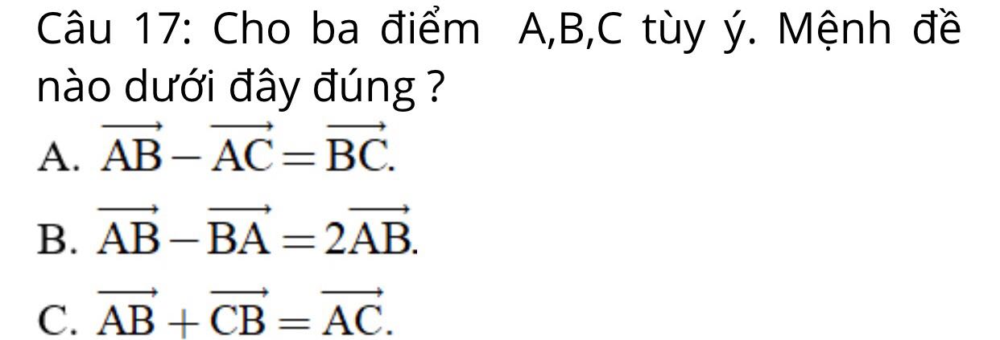

-- Number of words: 37


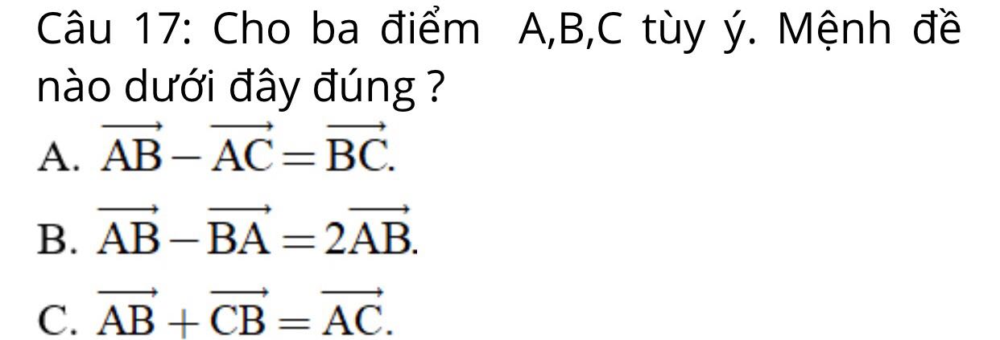

************

PAIRS: 22 - Cosine score: 1.0
-- Number of words: 6


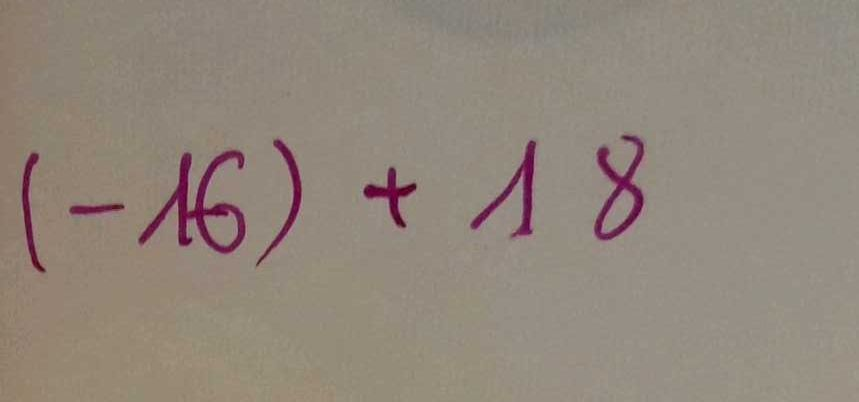

-- Number of words: 10


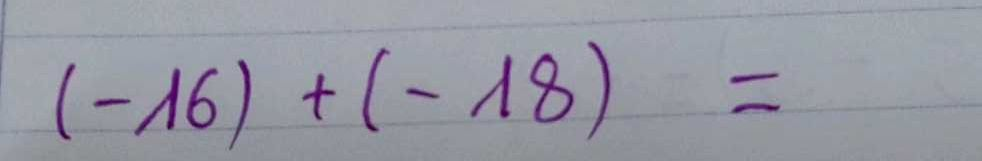

************

PAIRS: 23 - Cosine score: 1.0
-- Number of words: 20


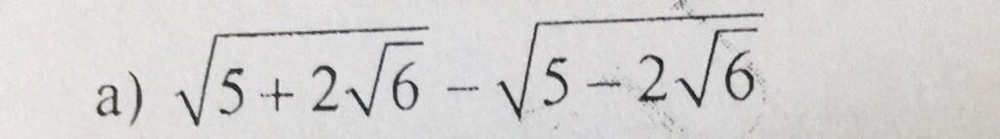

-- Number of words: 18


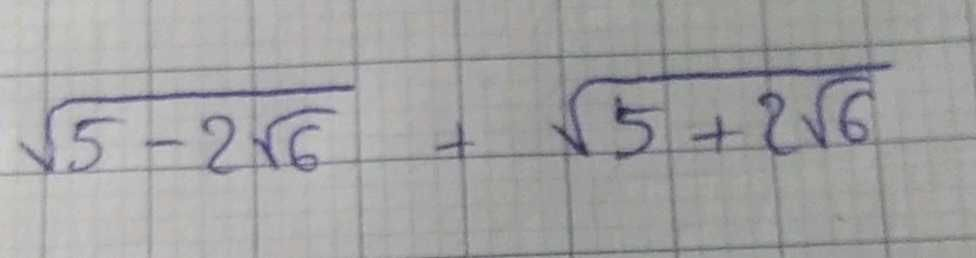

************

PAIRS: 24 - Cosine score: 1.0
-- Number of words: 5


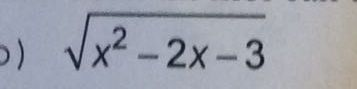

-- Number of words: 9


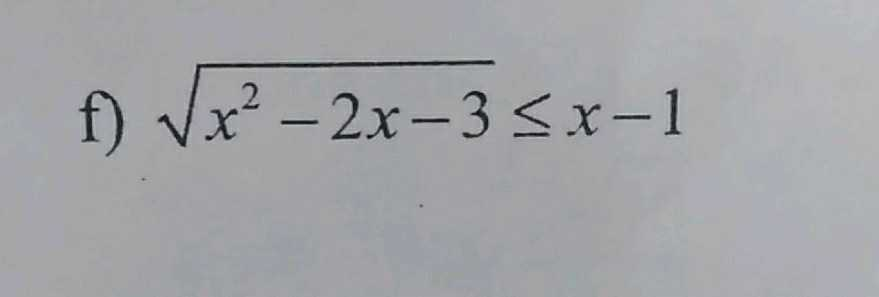

************

PAIRS: 25 - Cosine score: 1.0
-- Number of words: 14


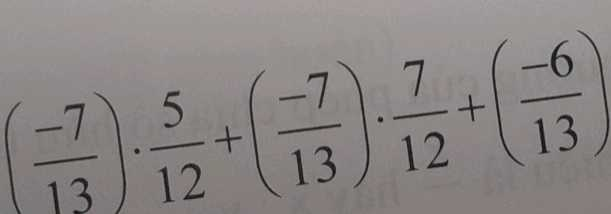

-- Number of words: 14


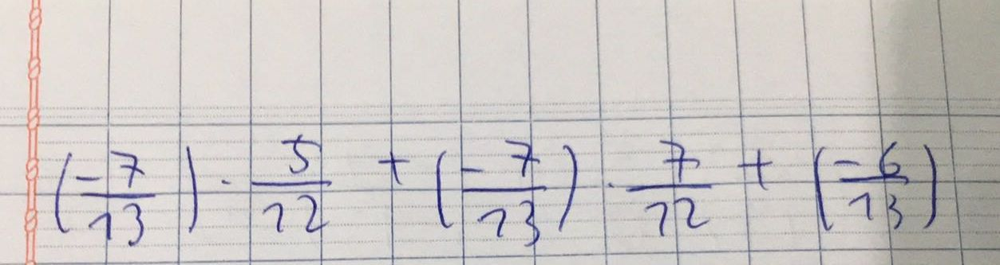

************

PAIRS: 26 - Cosine score: 0.9999999999999999
-- Number of words: 5


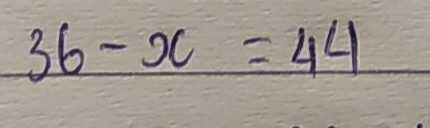

-- Number of words: 10


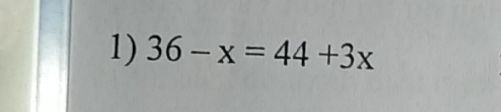

************

PAIRS: 27 - Cosine score: 0.9894099328696406
-- Number of words: 29


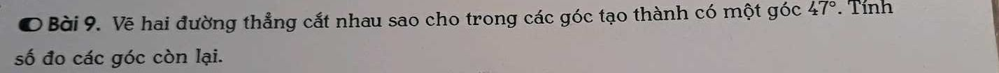

-- Number of words: 27


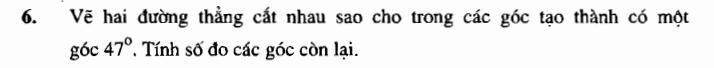

************

PAIRS: 28 - Cosine score: 0.9870435485487516
-- Number of words: 39


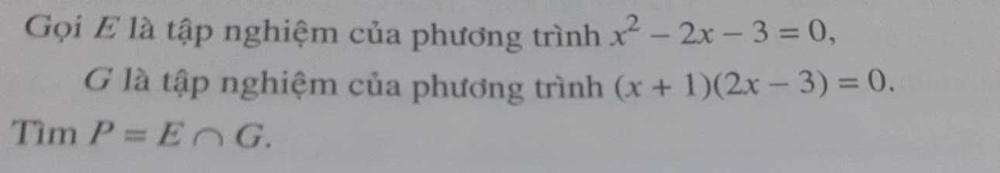

-- Number of words: 40


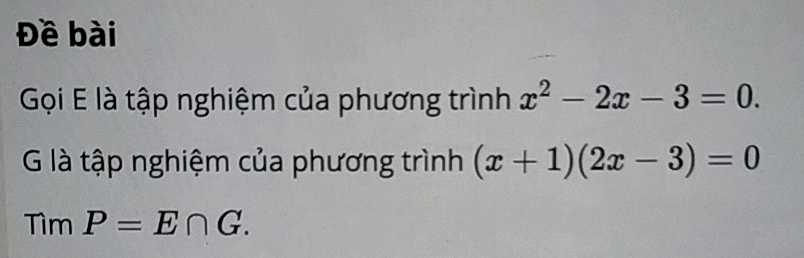

************

PAIRS: 29 - Cosine score: 0.982867335786801
-- Number of words: 77


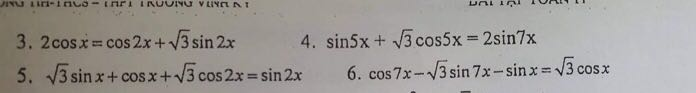

-- Number of words: 187


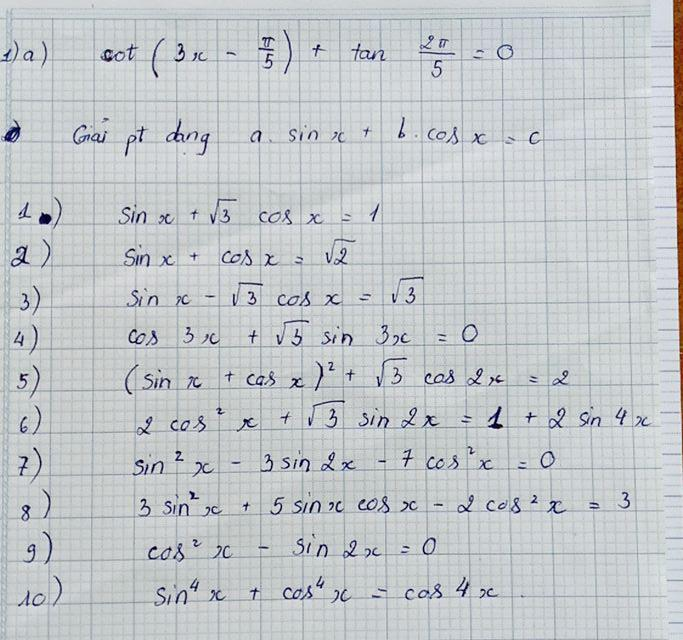

************

PAIRS: 30 - Cosine score: 0.9822212572589185
-- Number of words: 45


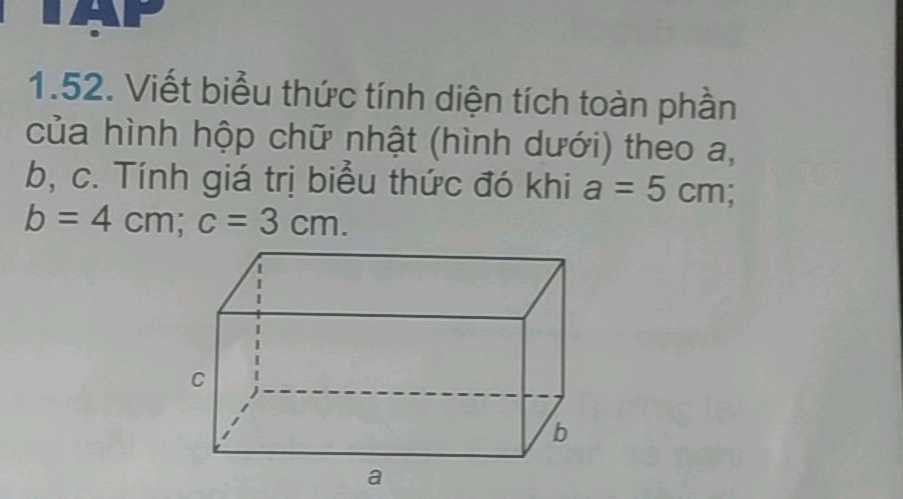

-- Number of words: 46


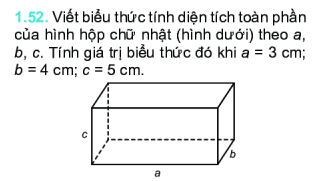

************

PAIRS: 31 - Cosine score: 0.9751089908206786
-- Number of words: 108


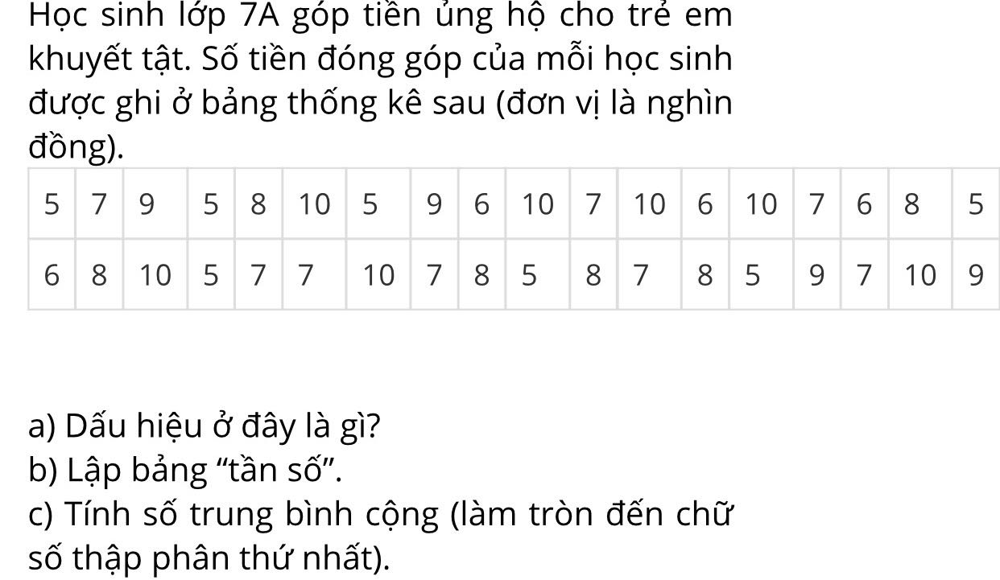

-- Number of words: 102


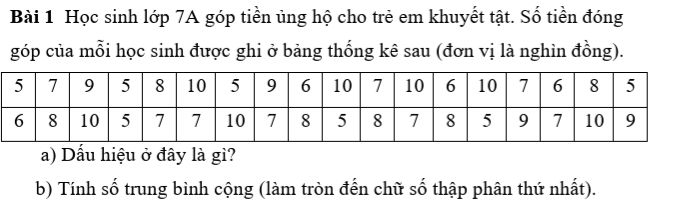

************

PAIRS: 32 - Cosine score: 0.9746345235229766
-- Number of words: 72


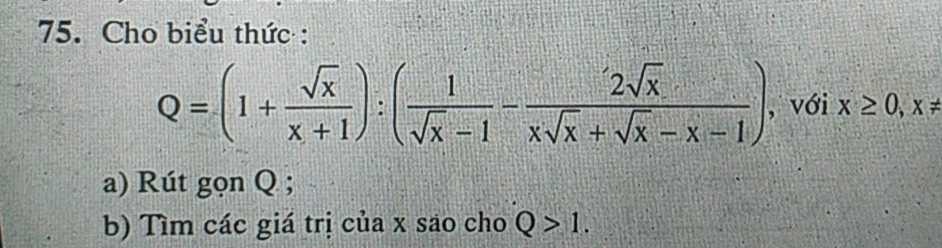

-- Number of words: 75


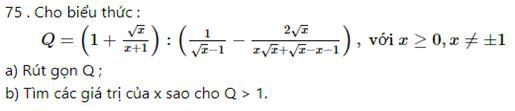

************

PAIRS: 33 - Cosine score: 0.974353873768409
-- Number of words: 35


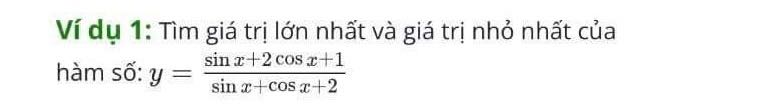

-- Number of words: 34


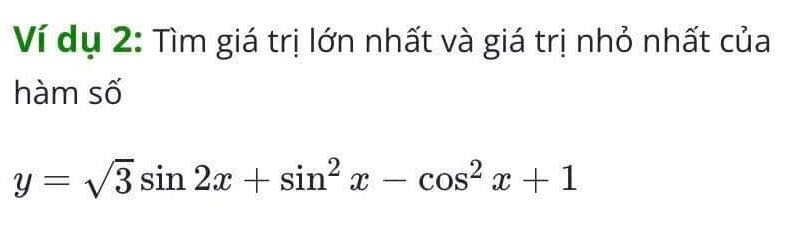

************

PAIRS: 34 - Cosine score: 0.9739332867951676
-- Number of words: 52


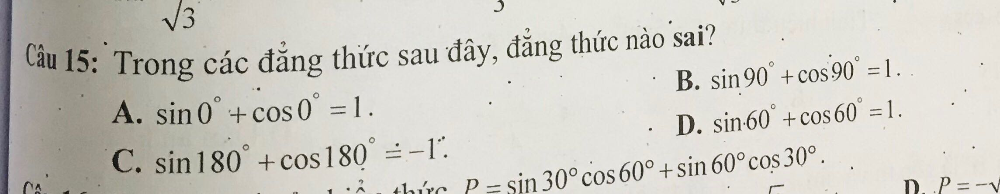

-- Number of words: 51


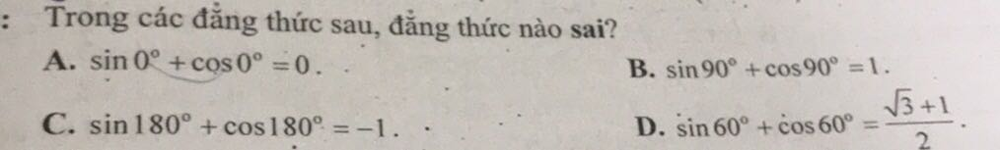

************

PAIRS: 35 - Cosine score: 0.9689413317600817
-- Number of words: 79


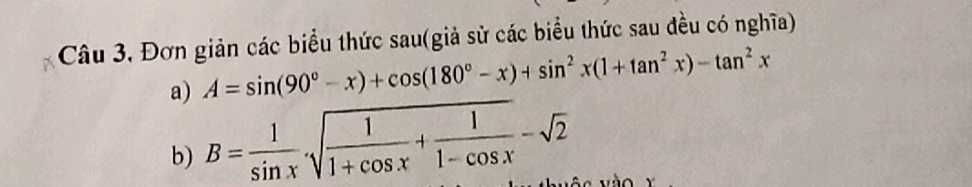

-- Number of words: 76


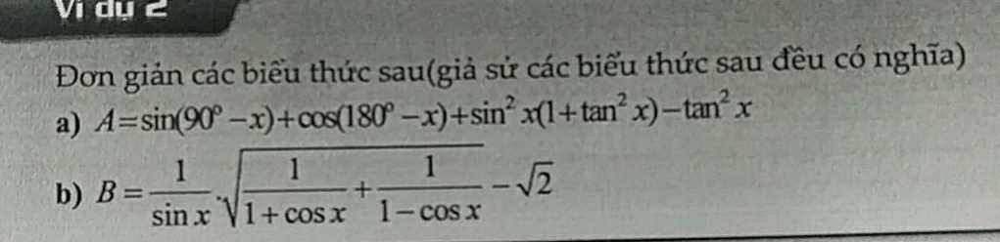

************

PAIRS: 36 - Cosine score: 0.9685341860963163
-- Number of words: 18


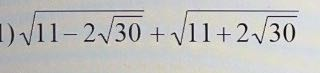

-- Number of words: 14


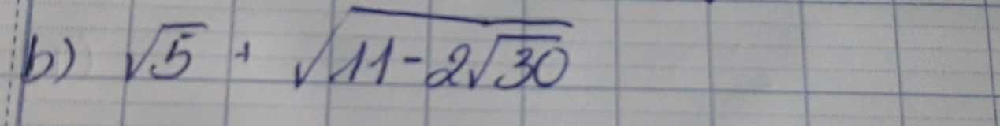

************

PAIRS: 37 - Cosine score: 0.9662468377937832
-- Number of words: 45


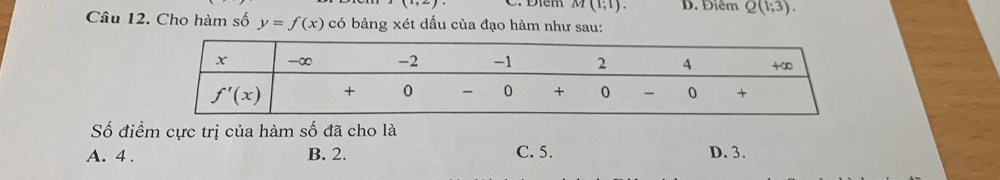

-- Number of words: 45


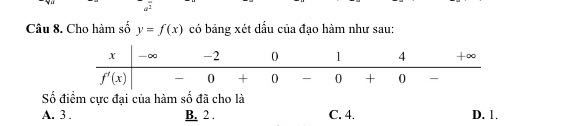

************

PAIRS: 38 - Cosine score: 0.9652651452589791
-- Number of words: 15


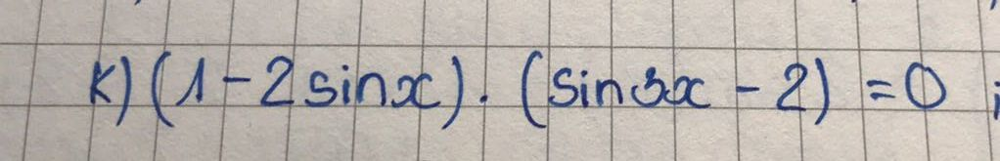

-- Number of words: 98


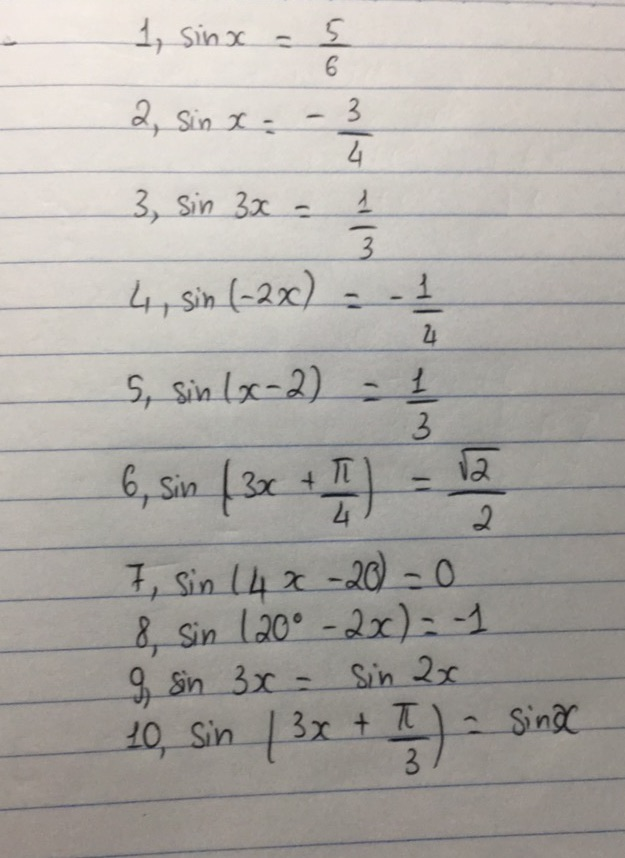

************

PAIRS: 39 - Cosine score: 0.964444132170679
-- Number of words: 175


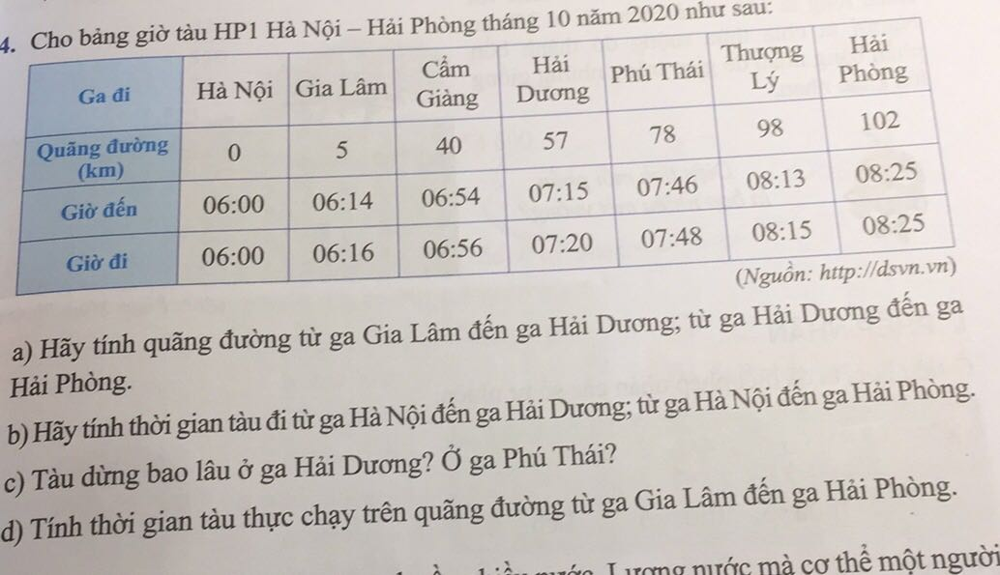

-- Number of words: 175


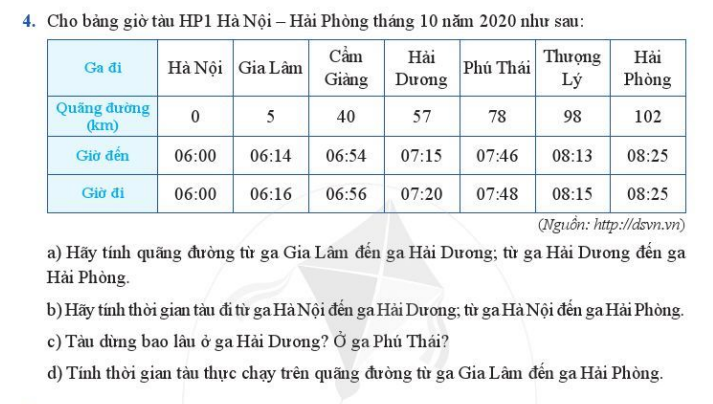

************

PAIRS: 40 - Cosine score: 0.9636172360279999
-- Number of words: 160


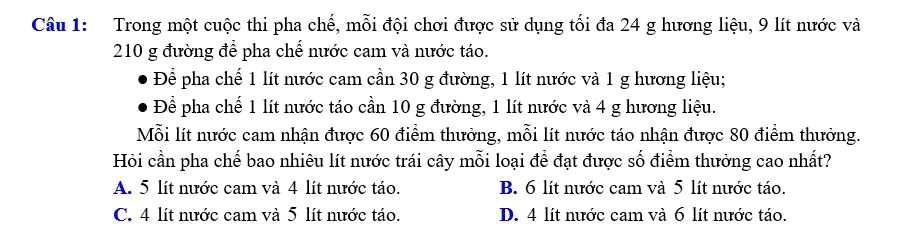

-- Number of words: 141


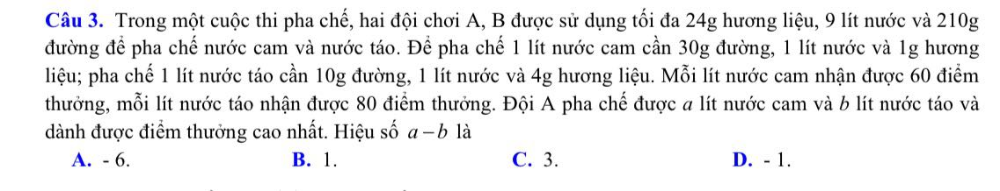

************

PAIRS: 41 - Cosine score: 0.9631858570690702
-- Number of words: 66


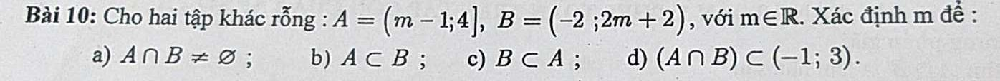

-- Number of words: 64


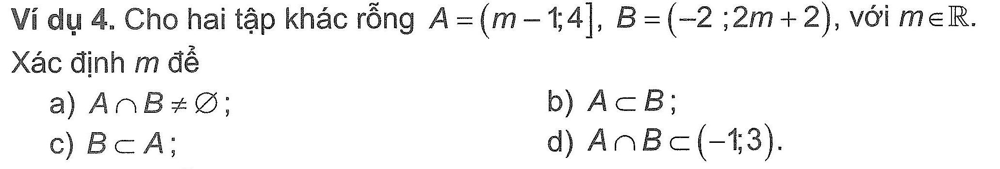

************

PAIRS: 42 - Cosine score: 0.962940422679819
-- Number of words: 52


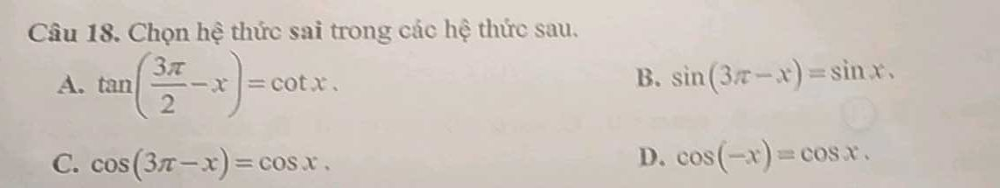

-- Number of words: 53


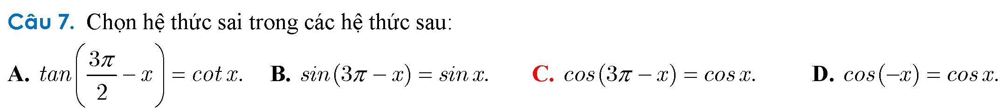

************

PAIRS: 43 - Cosine score: 0.9627018532508466
-- Number of words: 70


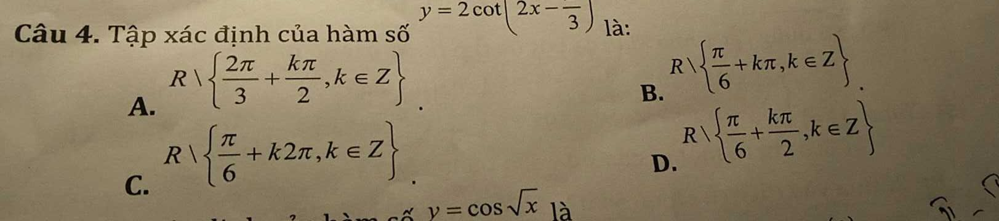

-- Number of words: 83


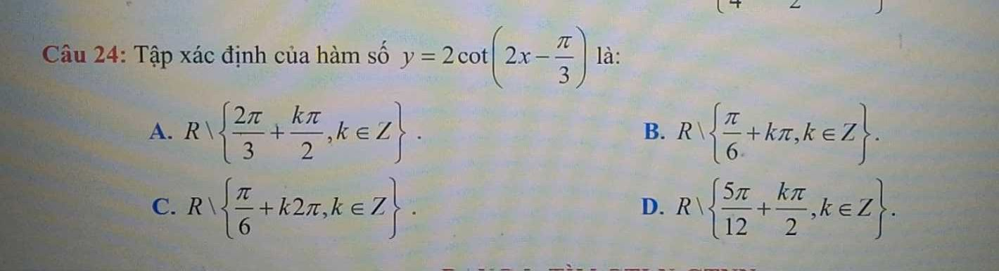

************

PAIRS: 44 - Cosine score: 0.9604798569714368
-- Number of words: 38


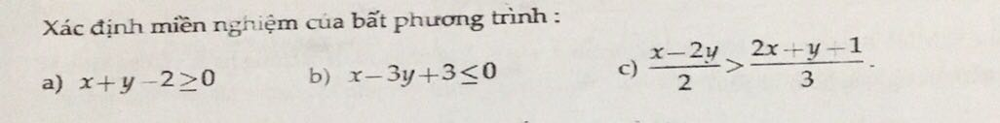

-- Number of words: 35


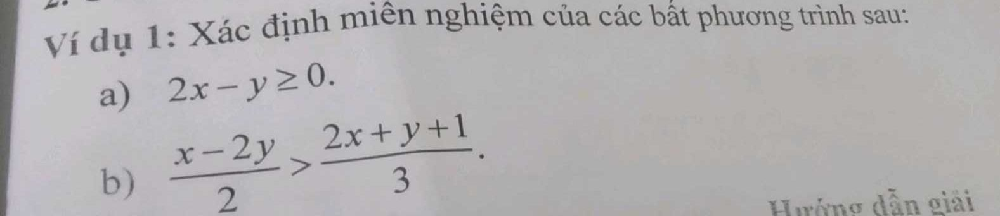

************

PAIRS: 45 - Cosine score: 0.9563940080784323
-- Number of words: 37


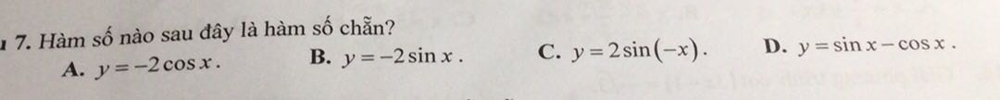

-- Number of words: 37


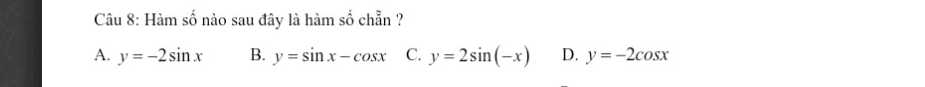

************

PAIRS: 46 - Cosine score: 0.9562999133937065
-- Number of words: 75


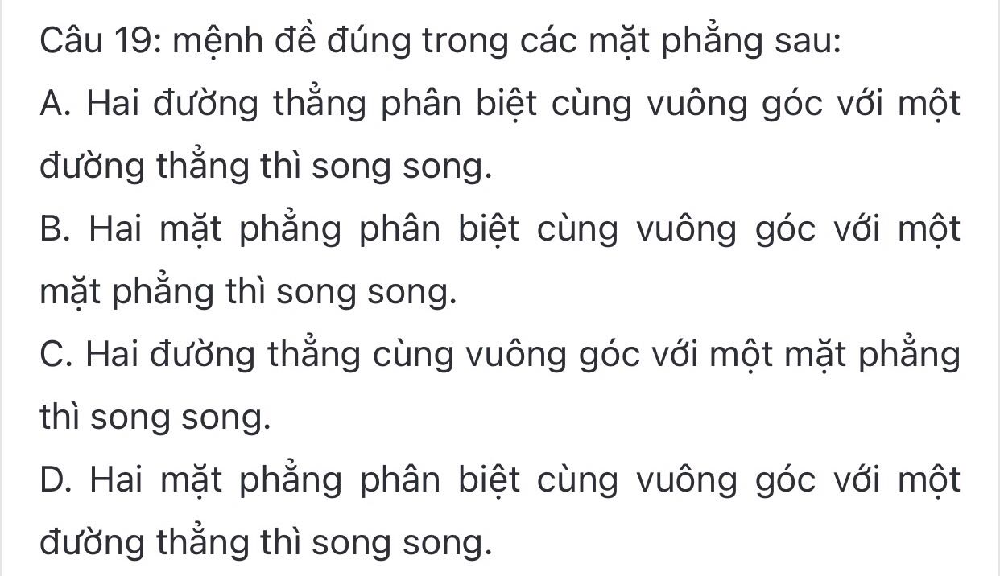

-- Number of words: 82


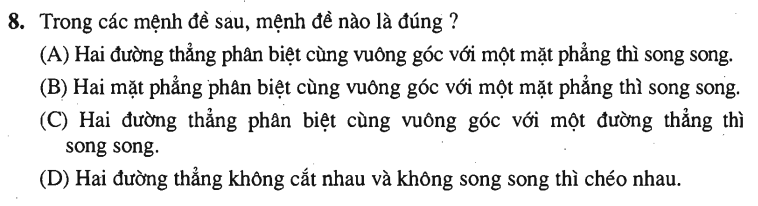

************

PAIRS: 47 - Cosine score: 0.9537858714917409
-- Number of words: 59


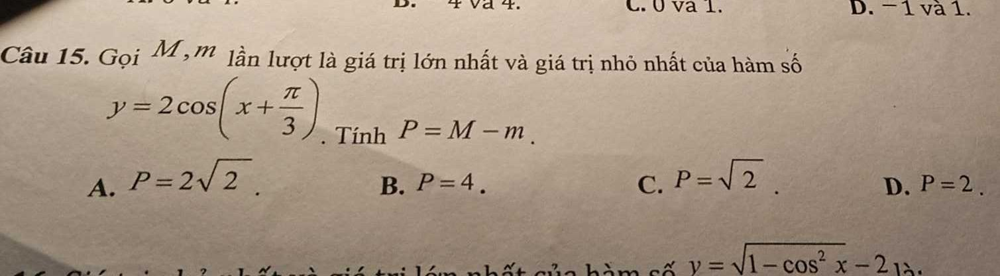

-- Number of words: 56


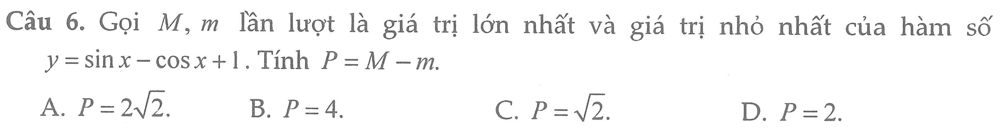

************

PAIRS: 48 - Cosine score: 0.951818702589247
-- Number of words: 55


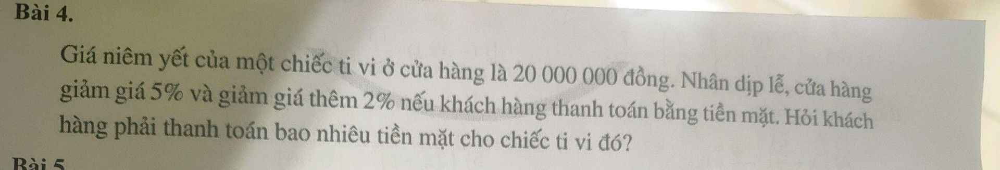

-- Number of words: 54


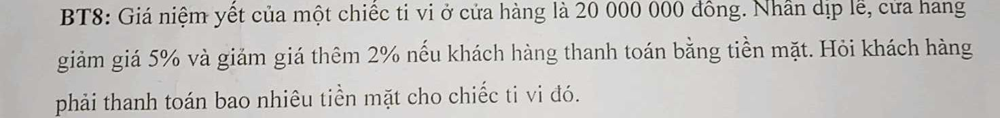

************

PAIRS: 49 - Cosine score: 0.9510188523098112
-- Number of words: 115


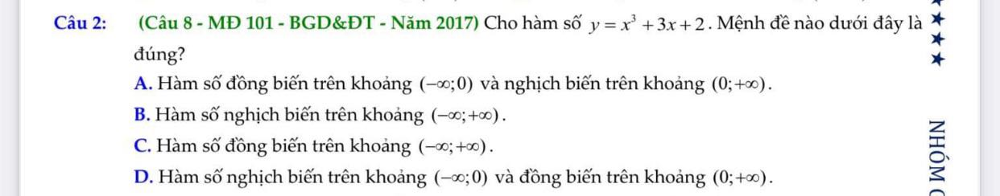

-- Number of words: 74


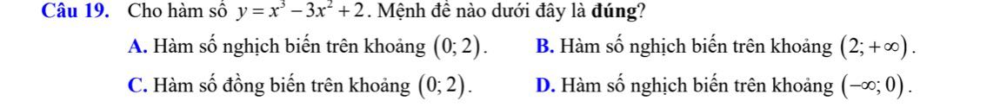

************

PAIRS: 50 - Cosine score: 0.949995119215417
-- Number of words: 76


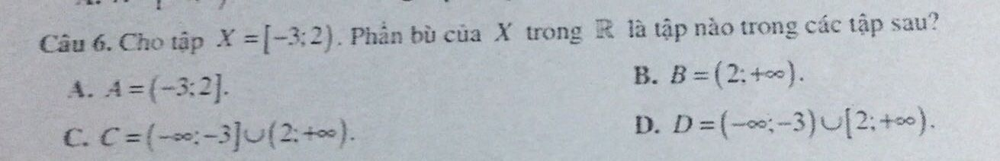

-- Number of words: 78


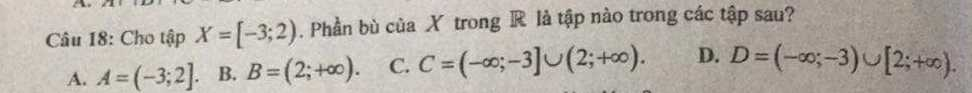

************

PAIRS: 51 - Cosine score: 0.9498937353121932
-- Number of words: 11


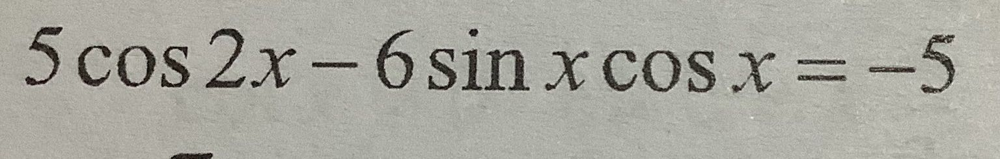

-- Number of words: 12


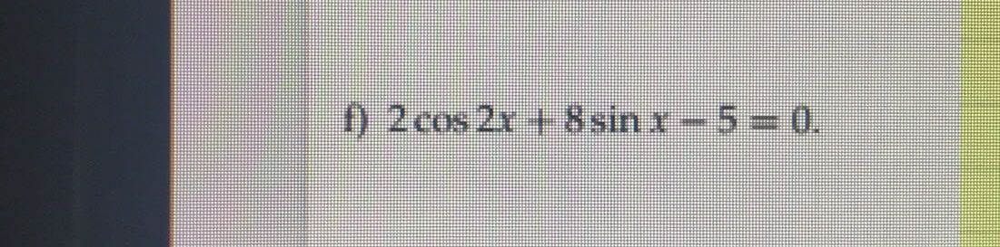

************

PAIRS: 52 - Cosine score: 0.9478444376197963
-- Number of words: 77


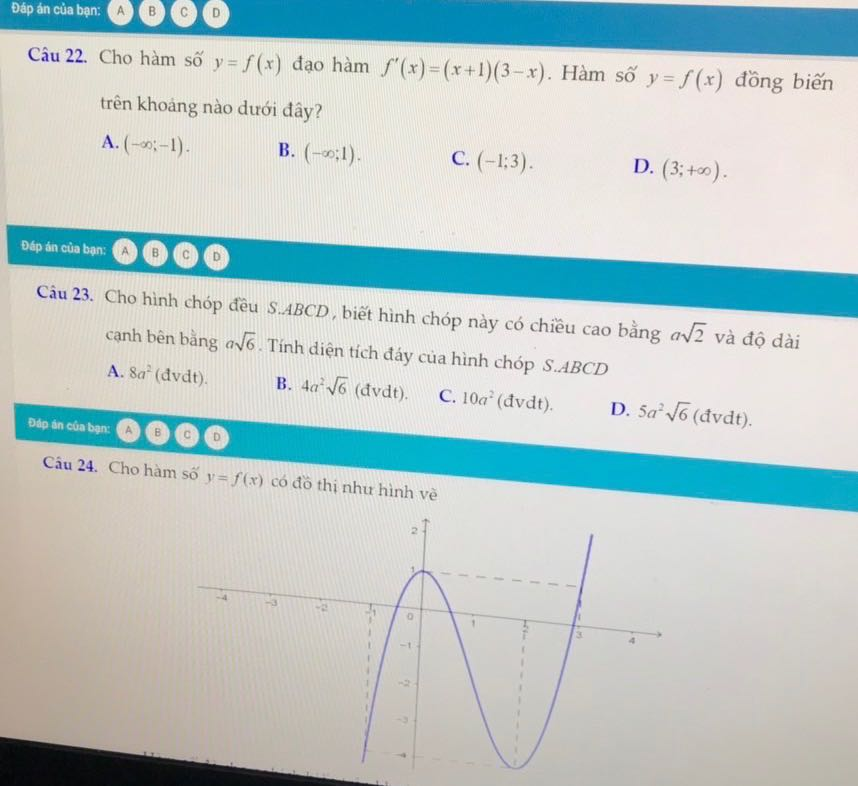

-- Number of words: 81


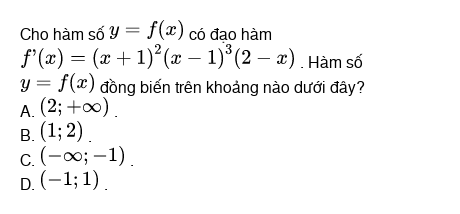

************

PAIRS: 53 - Cosine score: 0.9473082716076904
-- Number of words: 9


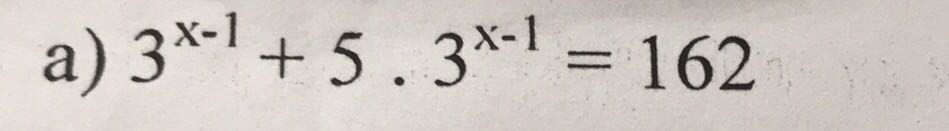

-- Number of words: 11


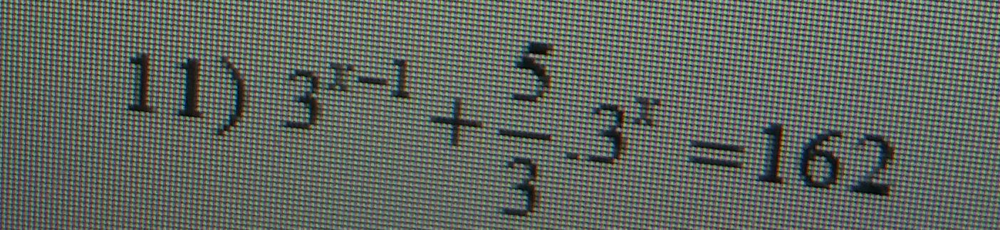

************

PAIRS: 54 - Cosine score: 0.947178682348448
-- Number of words: 76


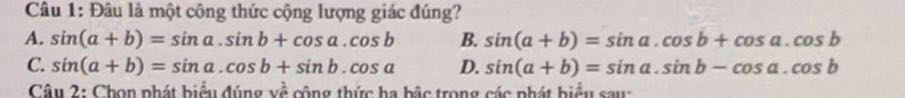

-- Number of words: 73


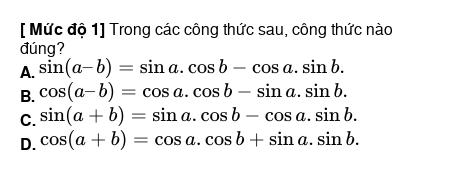

************

PAIRS: 55 - Cosine score: 0.9471406930156575
-- Number of words: 33


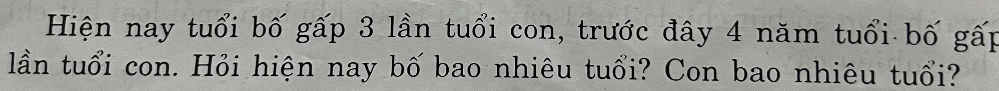

-- Number of words: 39


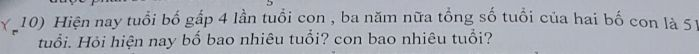

************

PAIRS: 56 - Cosine score: 0.9468232043217425
-- Number of words: 9


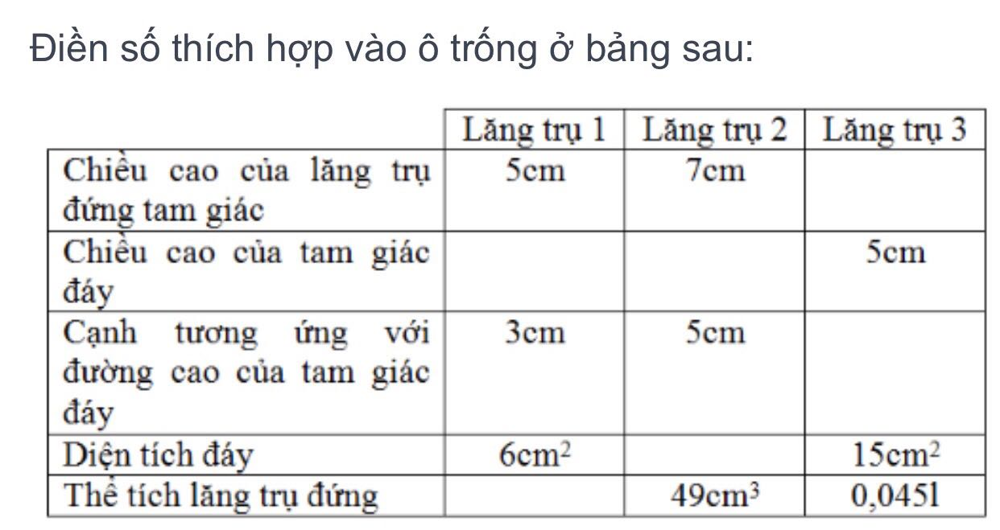

-- Number of words: 8


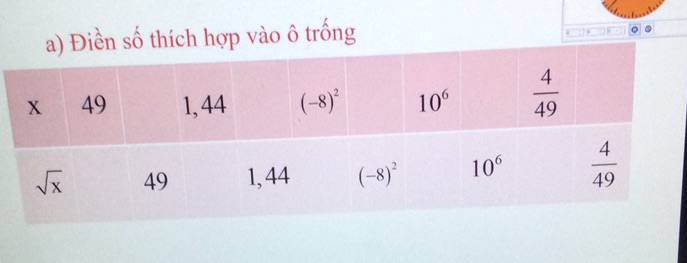

************

PAIRS: 57 - Cosine score: 0.9455257793291771
-- Number of words: 101


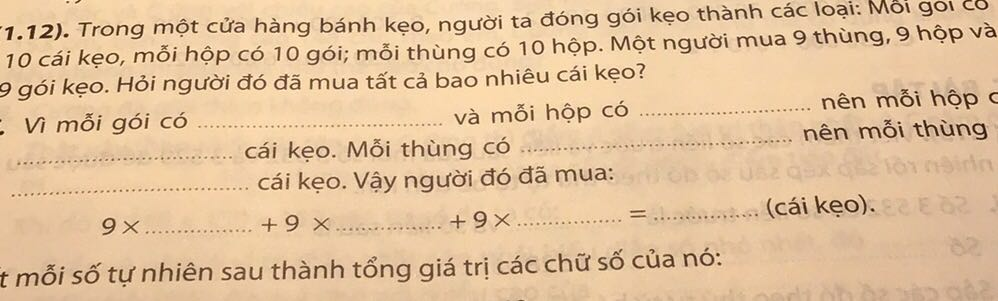

-- Number of words: 58


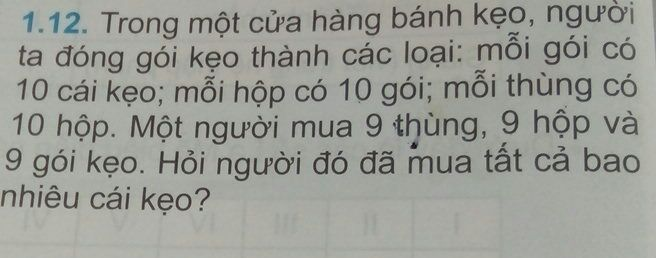

************

PAIRS: 58 - Cosine score: 0.94344474686472
-- Number of words: 45


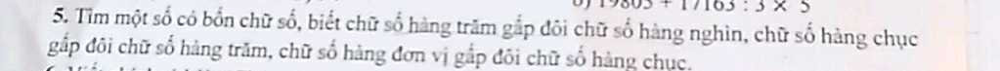

-- Number of words: 45


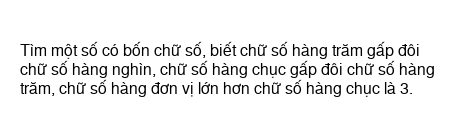

************

PAIRS: 59 - Cosine score: 0.9412378496957041
-- Number of words: 12


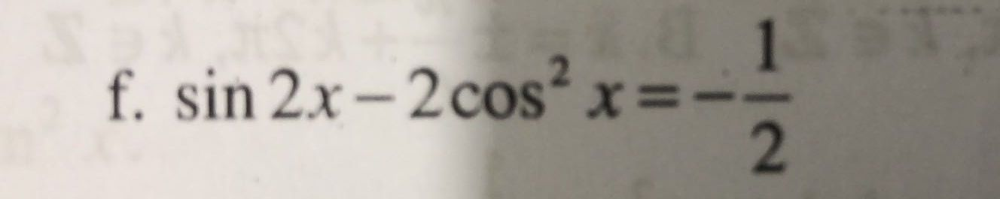

-- Number of words: 69


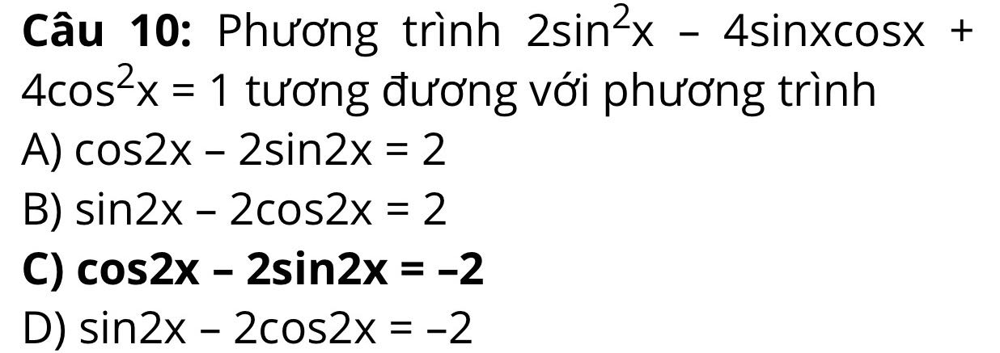

************

PAIRS: 60 - Cosine score: 0.9376801751944619
-- Number of words: 48


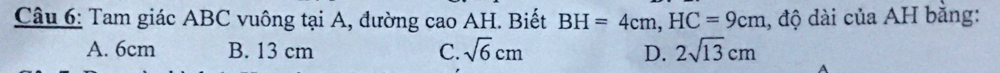

-- Number of words: 47


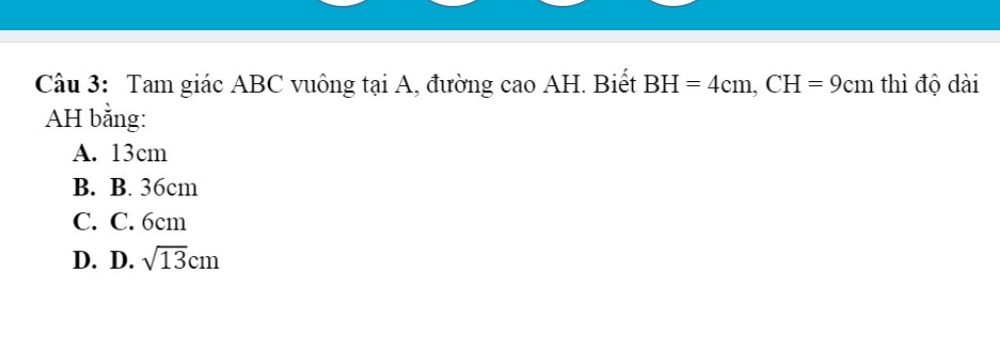

************

PAIRS: 61 - Cosine score: 0.933840656593802
-- Number of words: 106


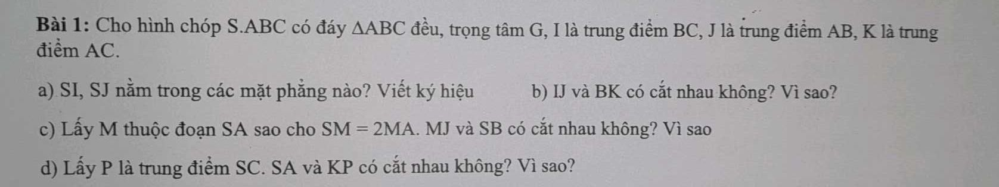

-- Number of words: 105


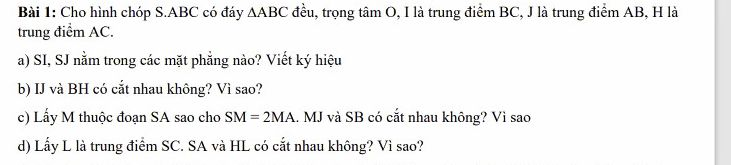

************

PAIRS: 62 - Cosine score: 0.9337875391427669
-- Number of words: 6


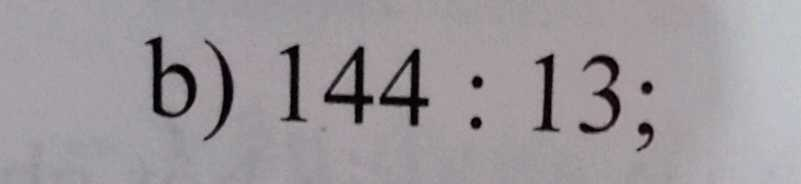

-- Number of words: 18


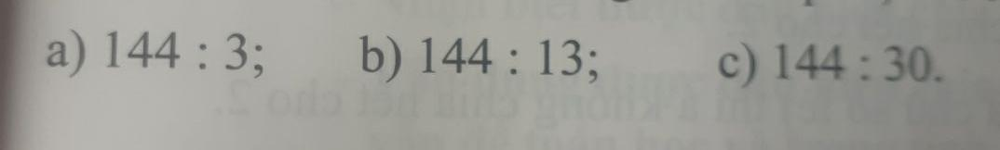

************

PAIRS: 63 - Cosine score: 0.9315980812905018
-- Number of words: 107


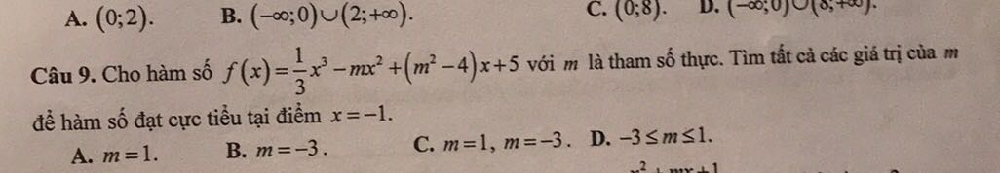

-- Number of words: 74


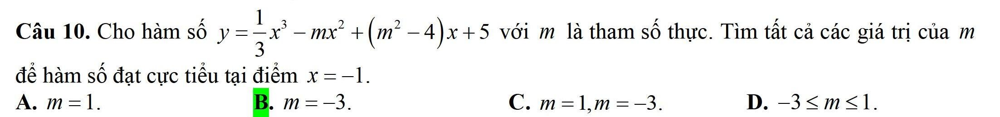

************

PAIRS: 64 - Cosine score: 0.9274164511389775
-- Number of words: 33


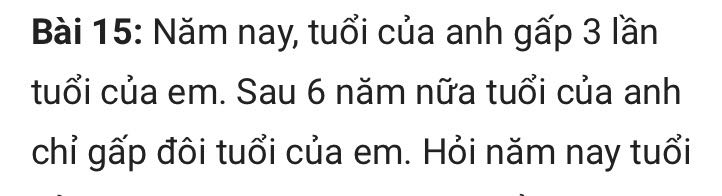

-- Number of words: 39


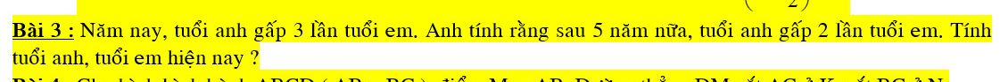

************

PAIRS: 65 - Cosine score: 0.9203910580744395
-- Number of words: 96


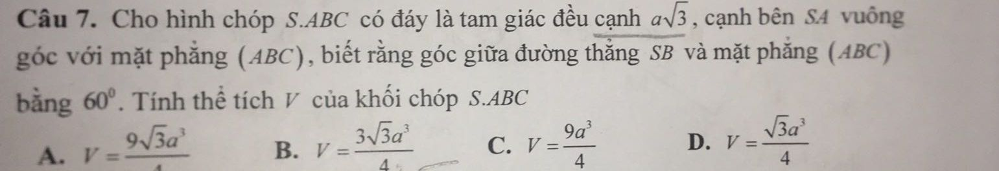

-- Number of words: 73


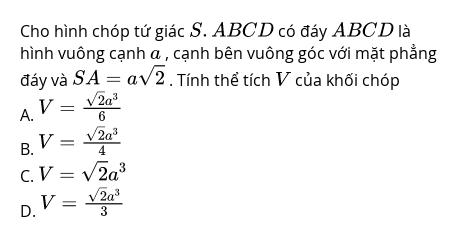

************

PAIRS: 66 - Cosine score: 0.9186279456394623
-- Number of words: 5


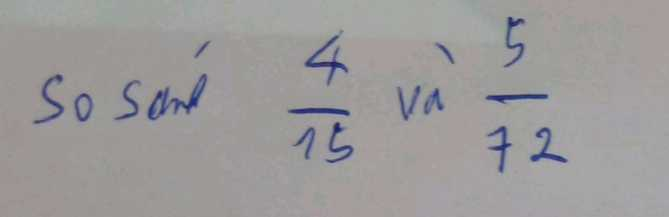

-- Number of words: 10


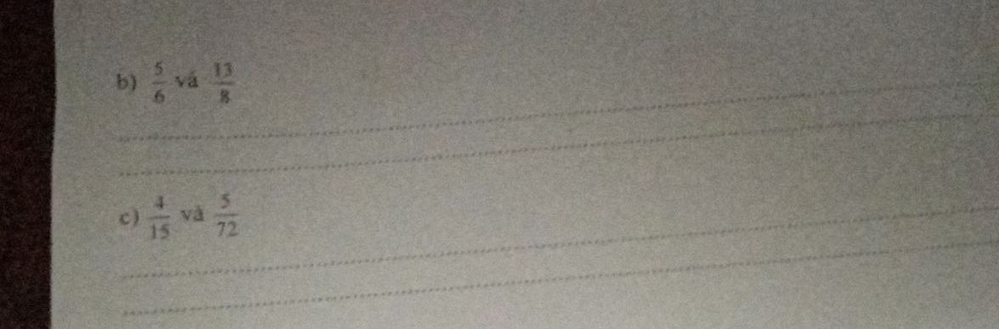

************

PAIRS: 67 - Cosine score: 0.911083560618516
-- Number of words: 28


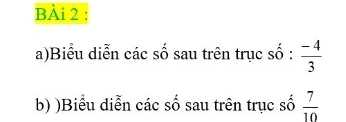

-- Number of words: 43


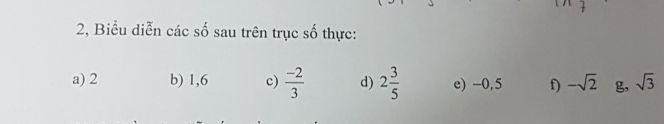

************

PAIRS: 68 - Cosine score: 0.9109680004057731
-- Number of words: 20


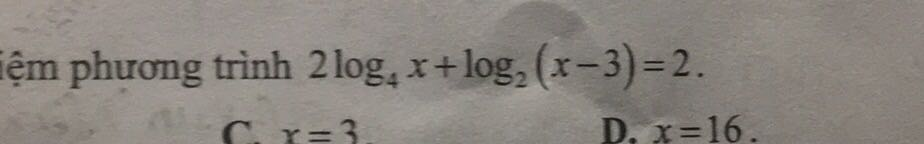

-- Number of words: 54


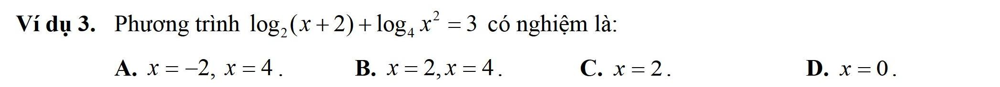

************

PAIRS: 69 - Cosine score: 0.9109359131423165
-- Number of words: 33


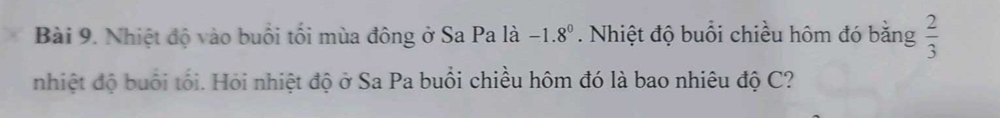

-- Number of words: 43


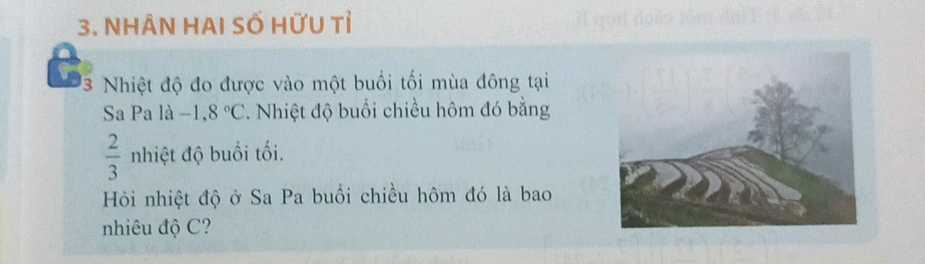

************

PAIRS: 70 - Cosine score: 0.9109146750660164
-- Number of words: 200


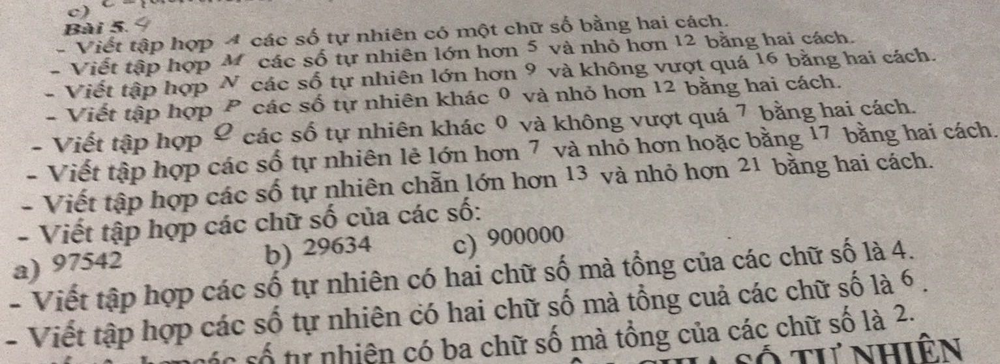

-- Number of words: 62


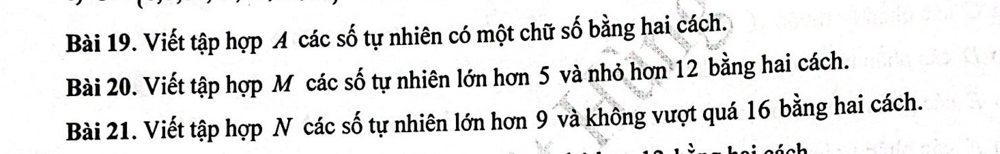

************

PAIRS: 71 - Cosine score: 0.9095802506973907
-- Number of words: 57


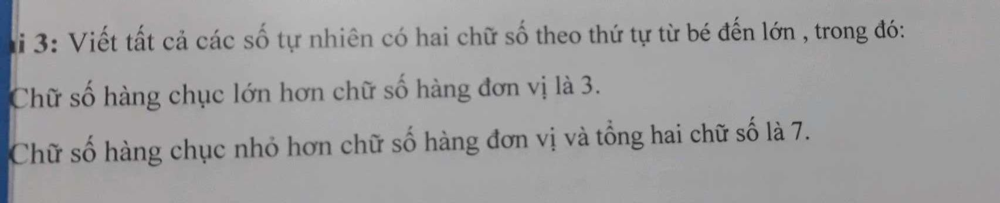

-- Number of words: 74


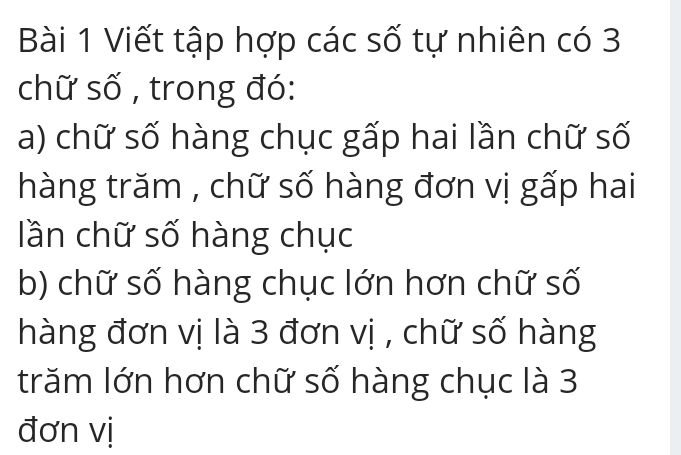

************

PAIRS: 72 - Cosine score: 0.9095356998364105
-- Number of words: 72


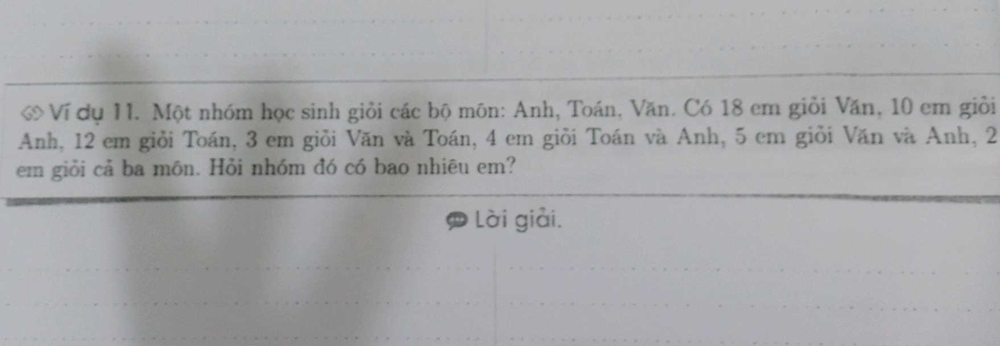

-- Number of words: 82


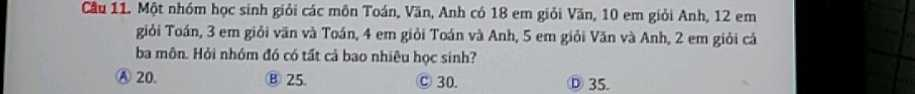

************

PAIRS: 73 - Cosine score: 0.9092806386648413
-- Number of words: 145


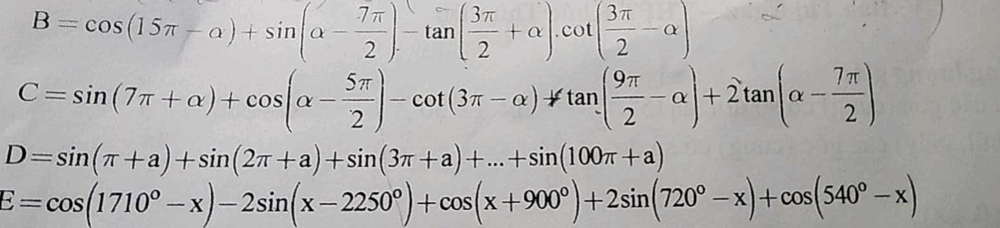

-- Number of words: 164


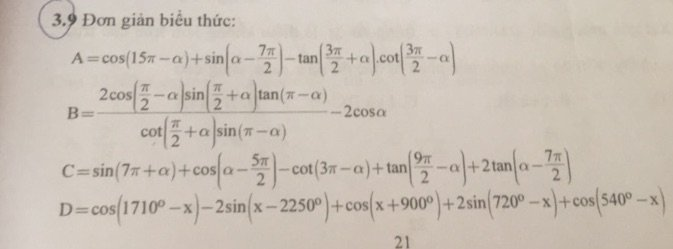

************

PAIRS: 74 - Cosine score: 0.9062587652825482
-- Number of words: 45


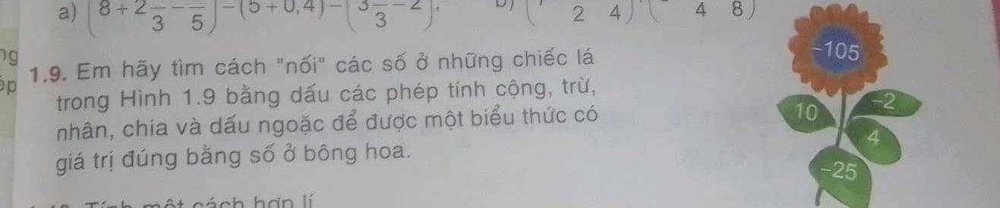

-- Number of words: 49


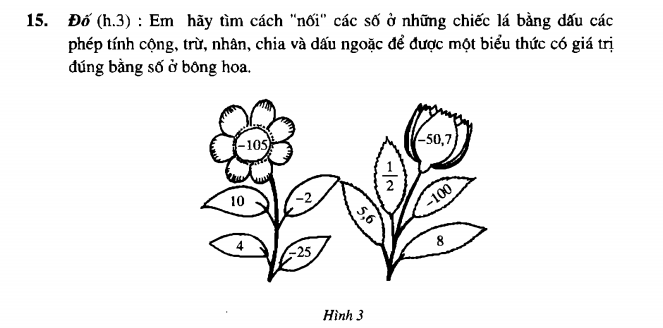

************

PAIRS: 75 - Cosine score: 0.9031068893928909
-- Number of words: 59


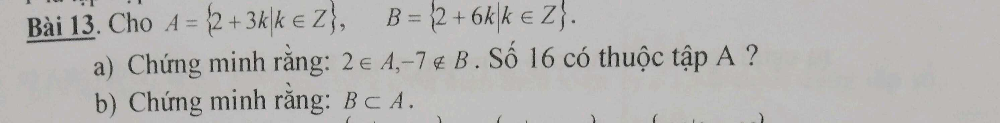

-- Number of words: 54


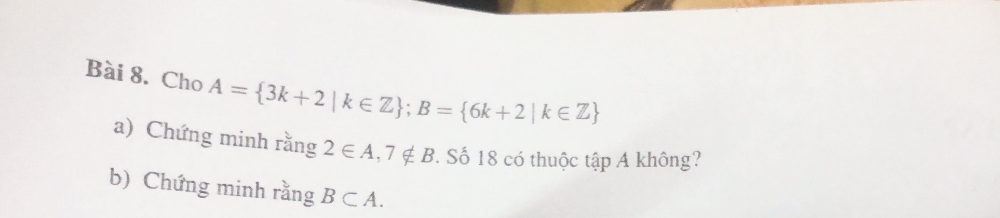

************

PAIRS: 76 - Cosine score: 0.9022295271686651
-- Number of words: 17


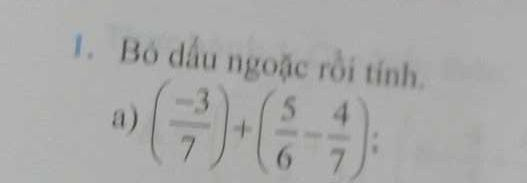

-- Number of words: 17


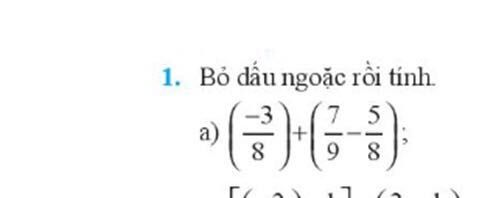

************

PAIRS: 77 - Cosine score: 0.9020402567932968
-- Number of words: 32


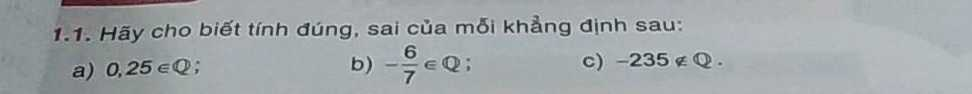

-- Number of words: 32


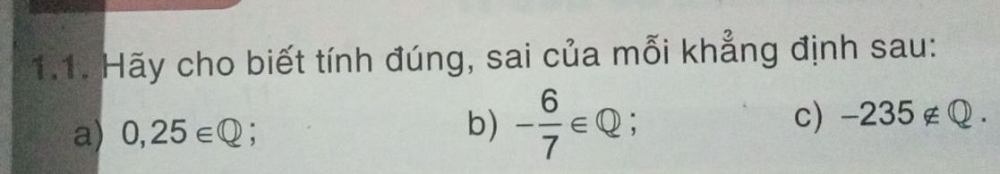

************

PAIRS: 78 - Cosine score: 0.9011650806714677
-- Number of words: 62


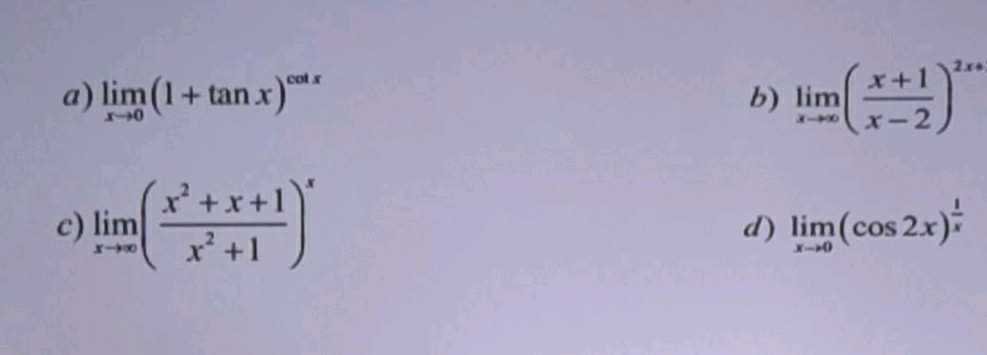

-- Number of words: 120


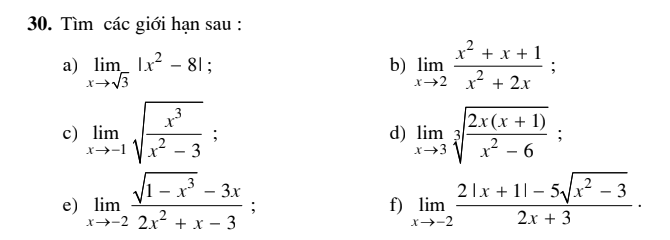

************

PAIRS: 79 - Cosine score: 0.8993988733155283
-- Number of words: 43


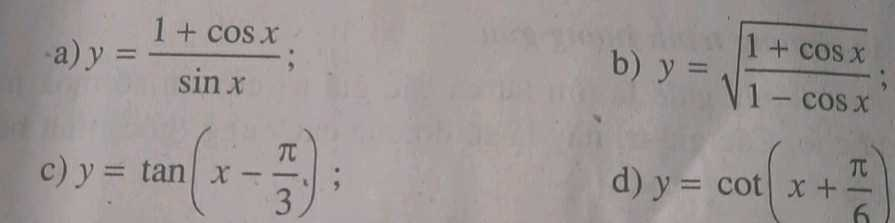

-- Number of words: 56


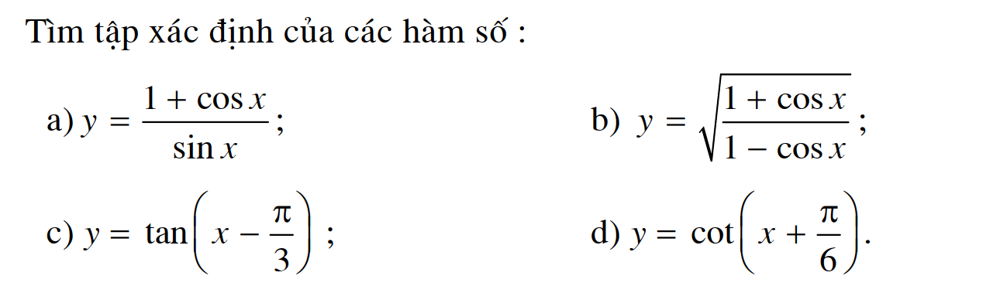

************

PAIRS: 80 - Cosine score: 0.898034056644347
-- Number of words: 81


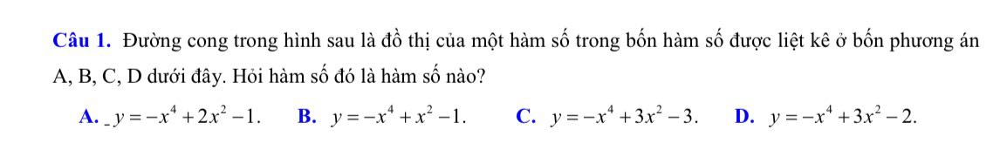

-- Number of words: 88


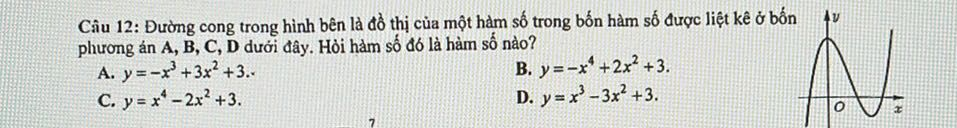

************

PAIRS: 81 - Cosine score: 0.8959587318151572
-- Number of words: 35


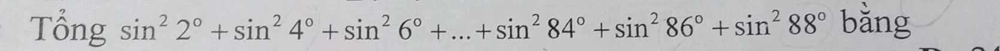

-- Number of words: 51


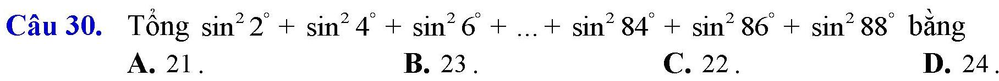

************

PAIRS: 82 - Cosine score: 0.8951242728505058
-- Number of words: 31


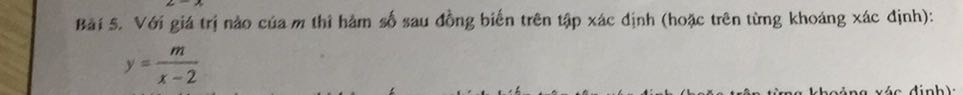

-- Number of words: 50


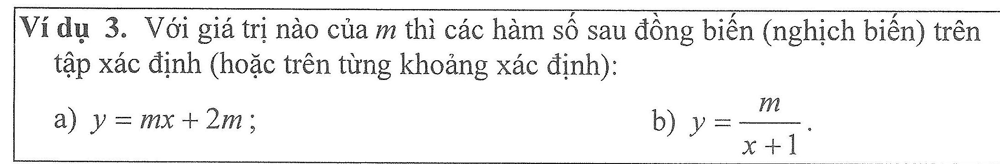

************

PAIRS: 83 - Cosine score: 0.8927359373204871
-- Number of words: 57


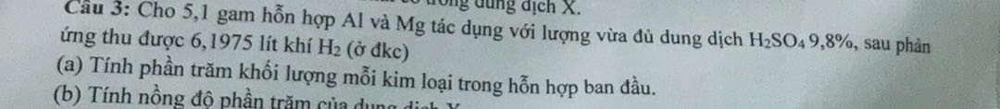

-- Number of words: 67


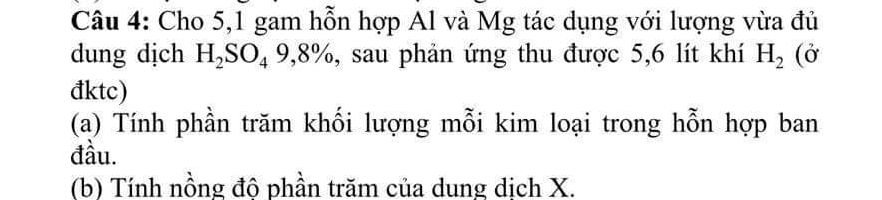

************

PAIRS: 84 - Cosine score: 0.8893174212867845
-- Number of words: 41


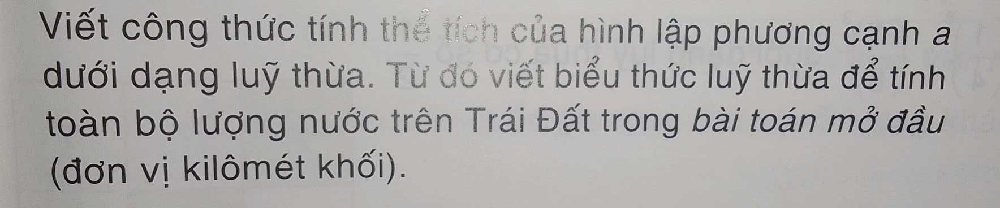

-- Number of words: 43


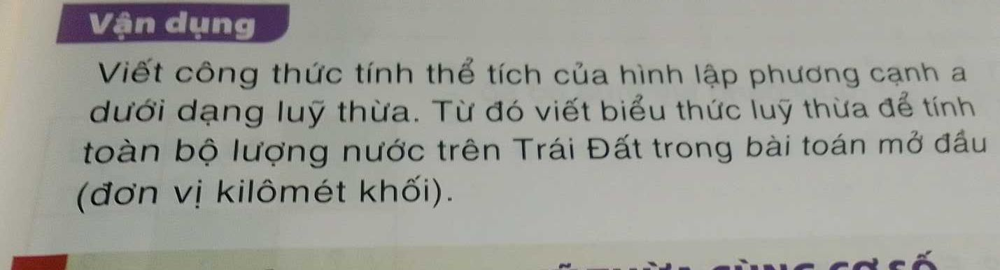

************

PAIRS: 85 - Cosine score: 0.8881847989401024
-- Number of words: 8


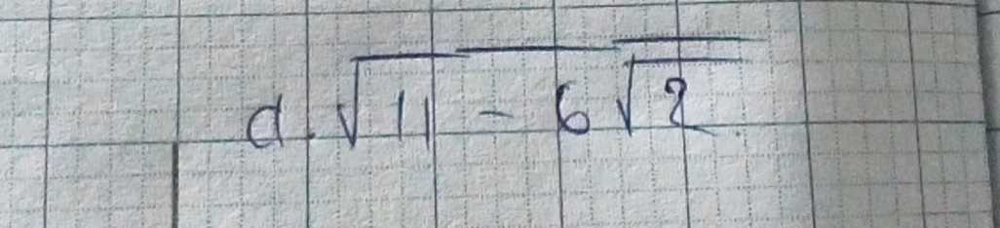

-- Number of words: 17


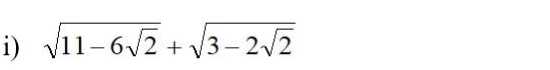

************

PAIRS: 86 - Cosine score: 0.8864139956279787
-- Number of words: 33


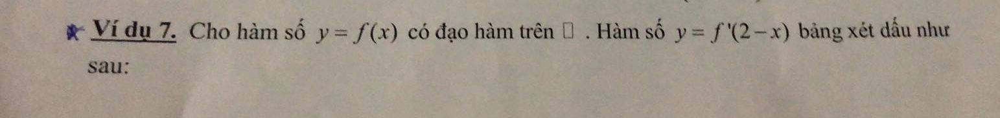

-- Number of words: 79


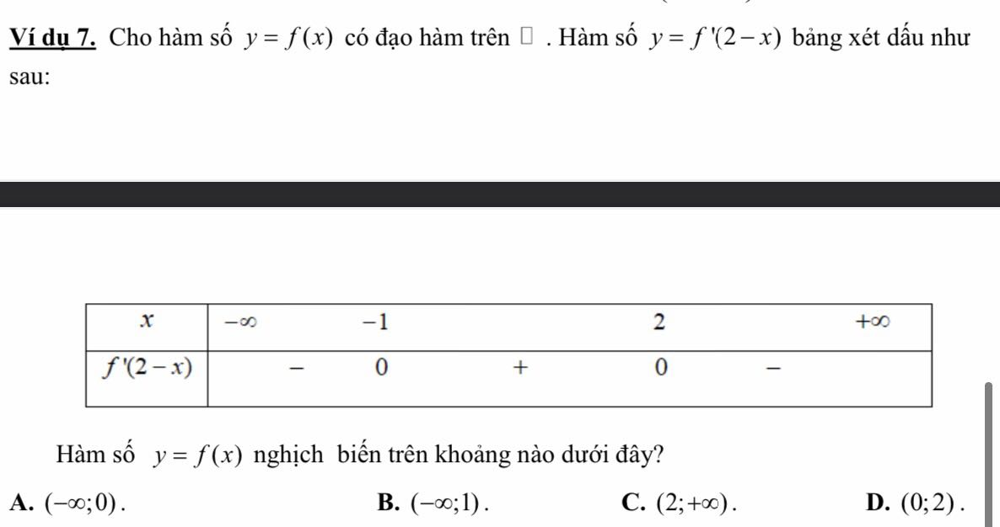

************

PAIRS: 87 - Cosine score: 0.8862321093470598
-- Number of words: 97


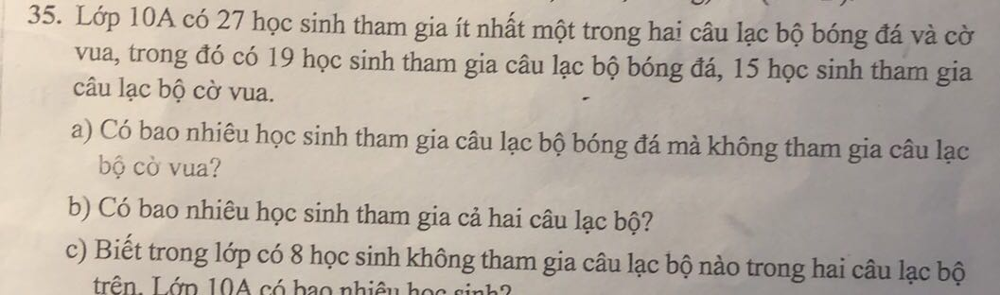

-- Number of words: 119


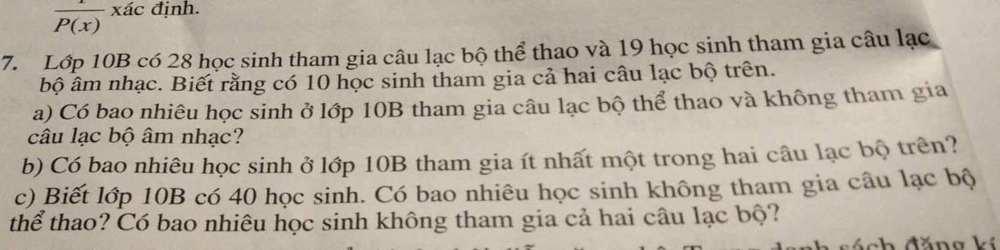

************

PAIRS: 88 - Cosine score: 0.8850057857612602
-- Number of words: 20


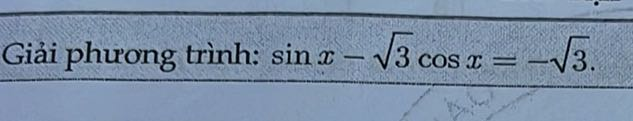

-- Number of words: 22


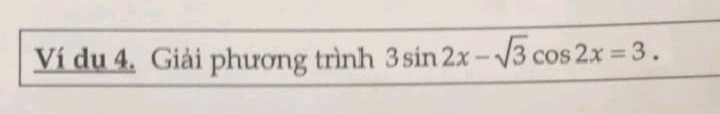

************

PAIRS: 89 - Cosine score: 0.8844673153275577
-- Number of words: 86


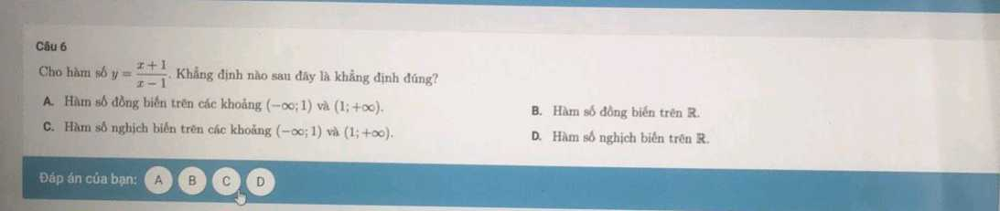

-- Number of words: 74


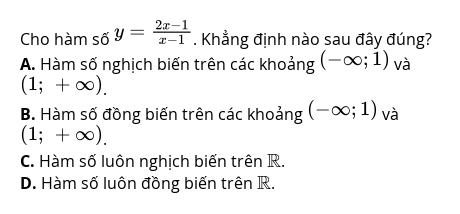

************

PAIRS: 90 - Cosine score: 0.883745558270258
-- Number of words: 105


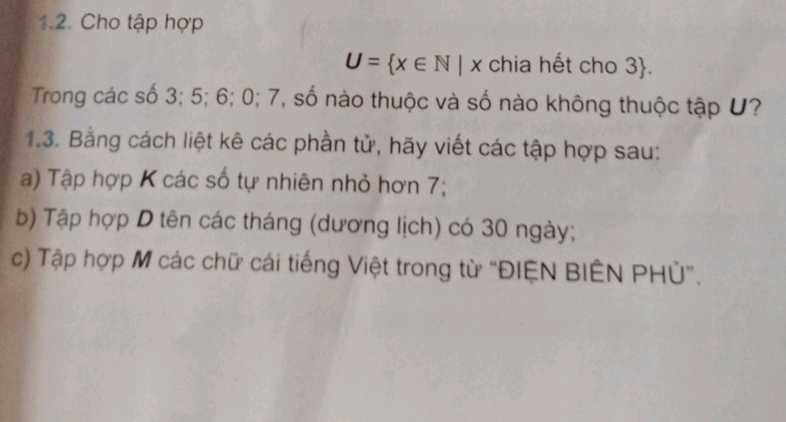

-- Number of words: 141


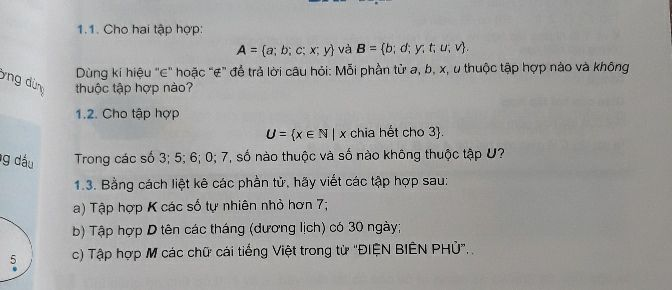

************

PAIRS: 91 - Cosine score: 0.8825623864376413
-- Number of words: 53


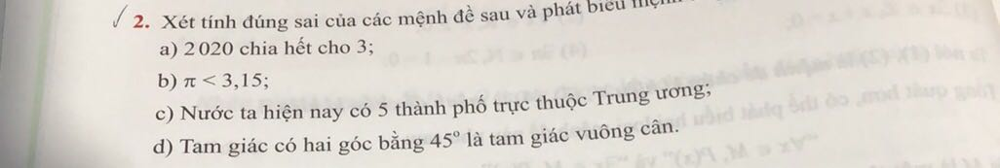

-- Number of words: 63


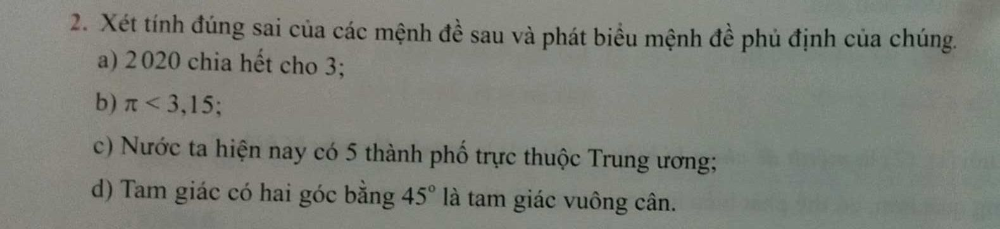

************

PAIRS: 92 - Cosine score: 0.8807935031572351
-- Number of words: 67


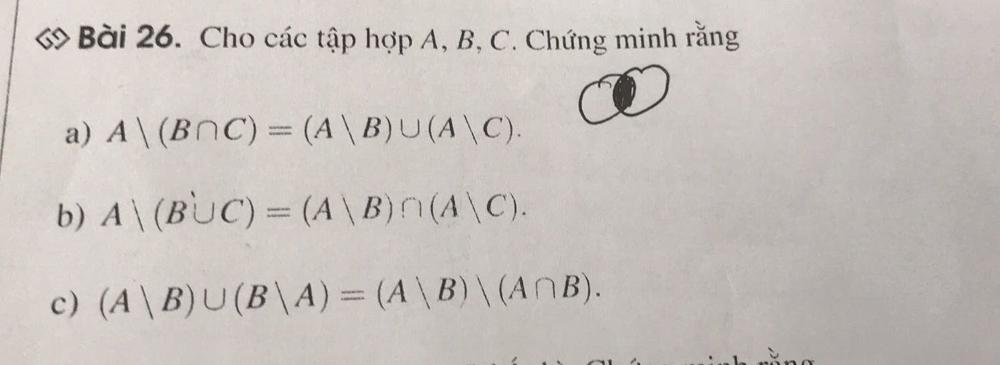

-- Number of words: 68


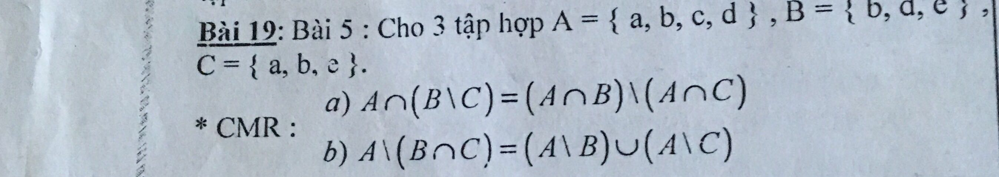

************

PAIRS: 93 - Cosine score: 0.8777834731058846
-- Number of words: 26


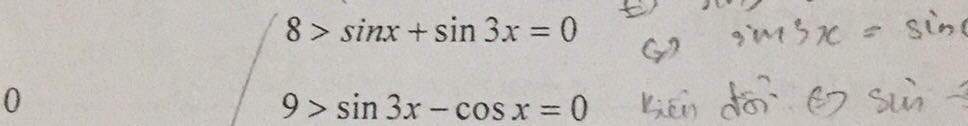

-- Number of words: 60


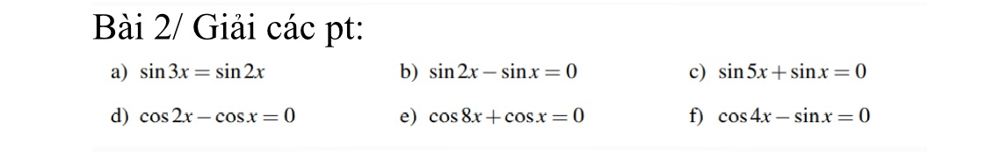

************

PAIRS: 94 - Cosine score: 0.8777130327865916
-- Number of words: 69


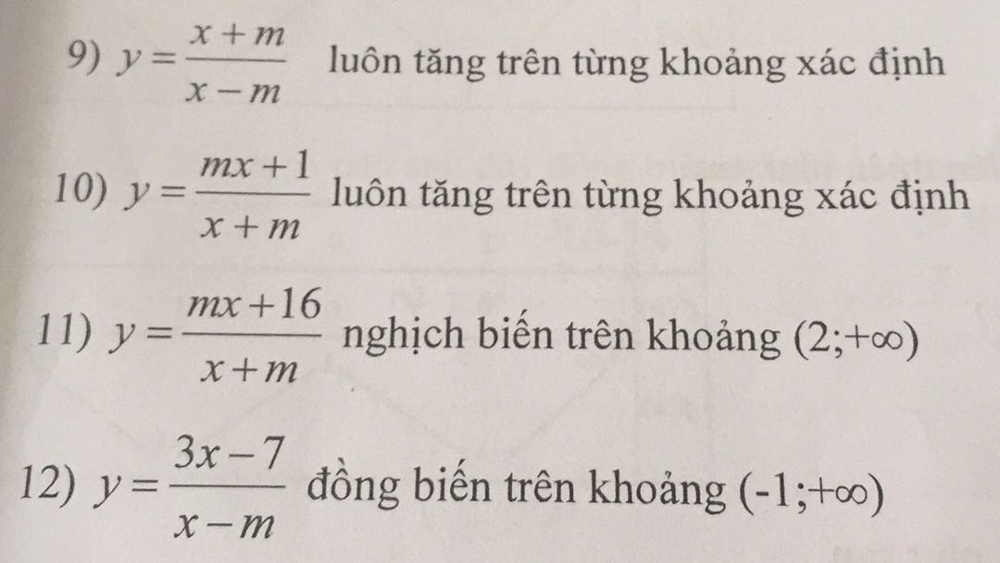

-- Number of words: 151


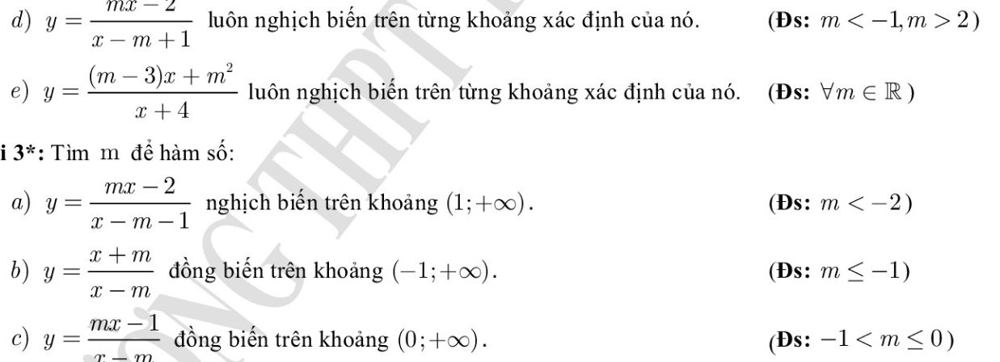

************

PAIRS: 95 - Cosine score: 0.8754738303742126
-- Number of words: 432


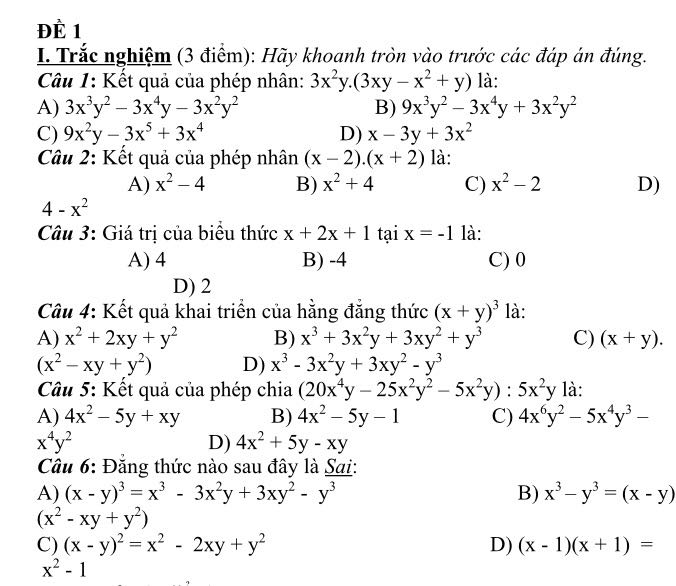

-- Number of words: 433


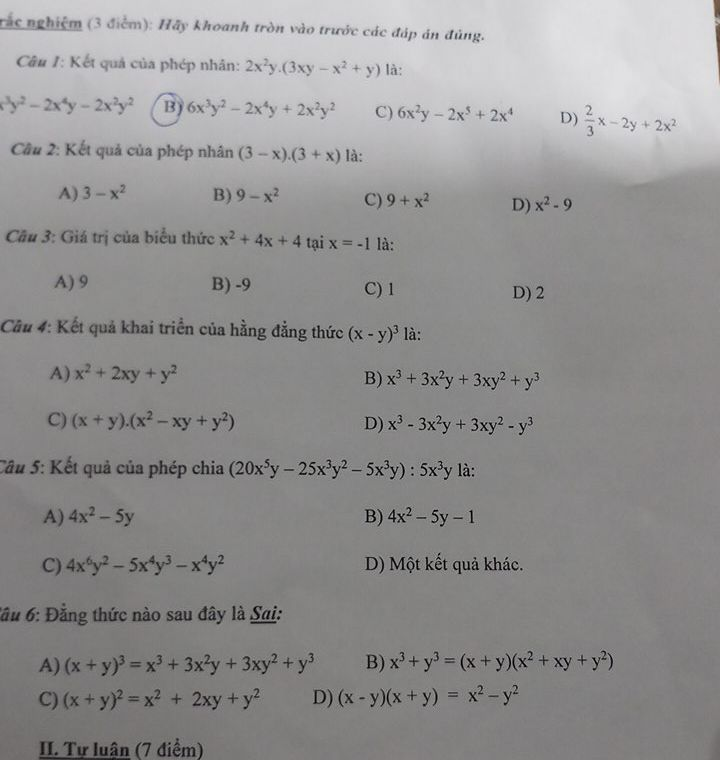

************

PAIRS: 96 - Cosine score: 0.8719477590179233
-- Number of words: 72


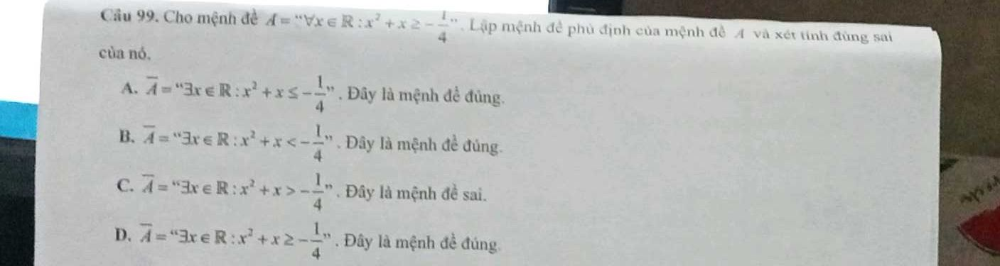

-- Number of words: 129


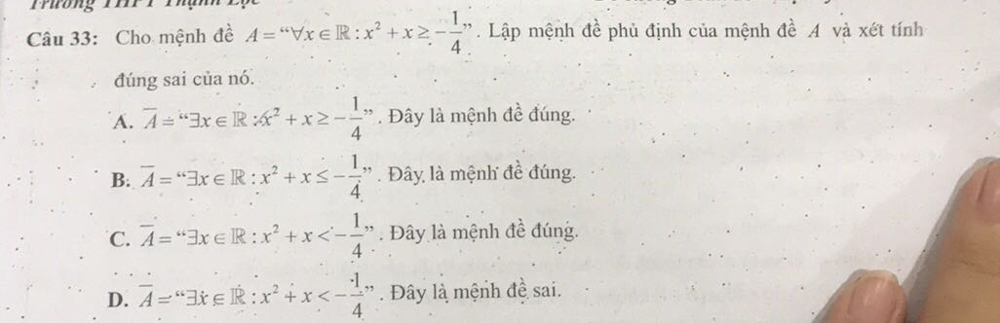

************

PAIRS: 97 - Cosine score: 0.871401226961348
-- Number of words: 96


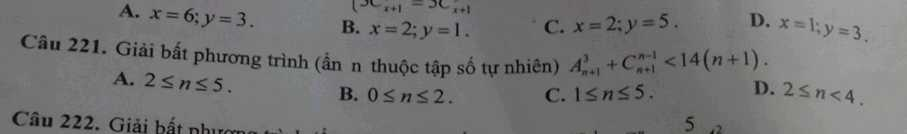

-- Number of words: 64


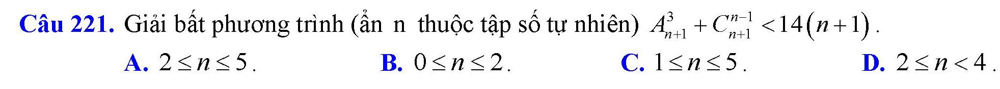

************

PAIRS: 98 - Cosine score: 0.8703966248501869
-- Number of words: 34


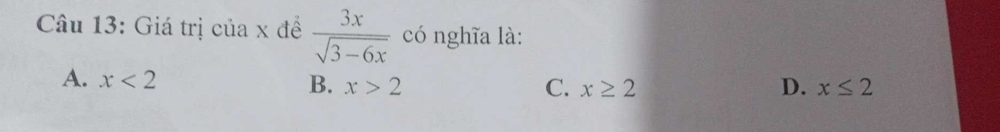

-- Number of words: 38


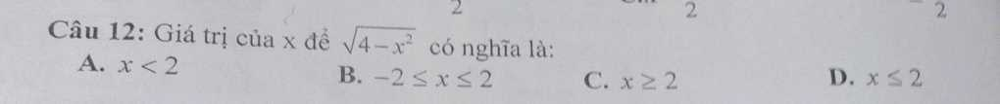

************

PAIRS: 99 - Cosine score: 0.8693988499791228
-- Number of words: 12


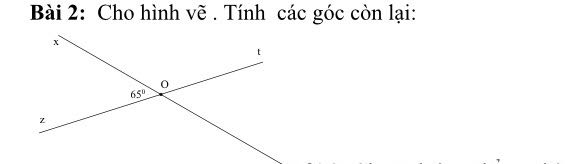

-- Number of words: 15


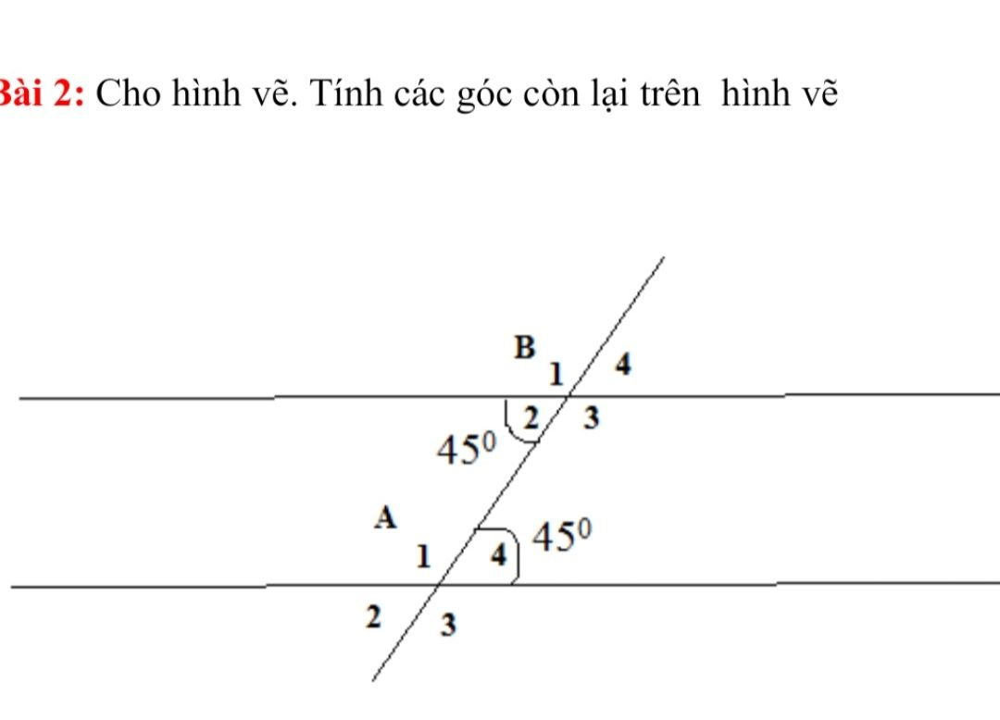

************

PAIRS: 100 - Cosine score: 0.8684587142109799
-- Number of words: 63


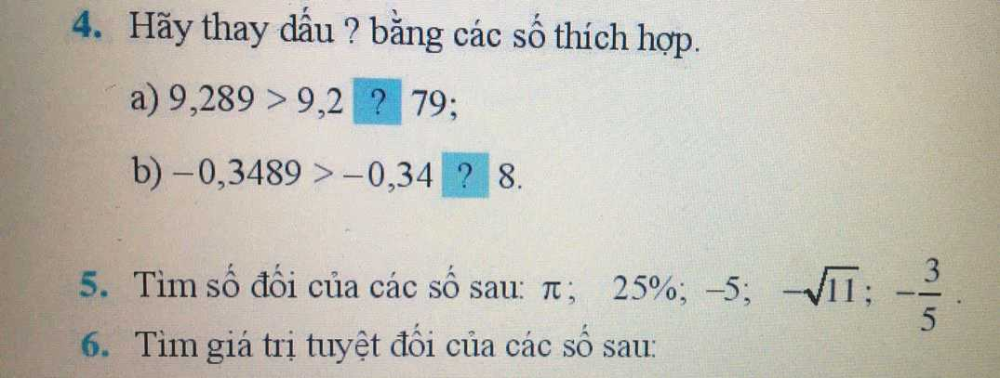

-- Number of words: 25


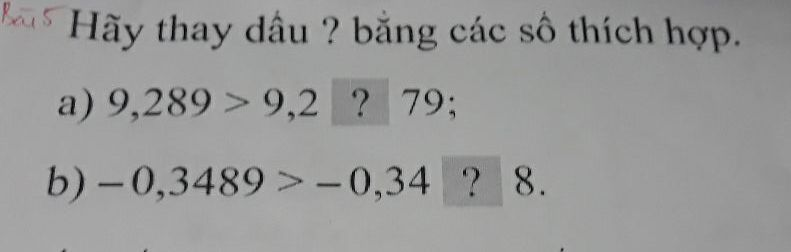

************

PAIRS: 101 - Cosine score: 0.8681568718838886
-- Number of words: 20


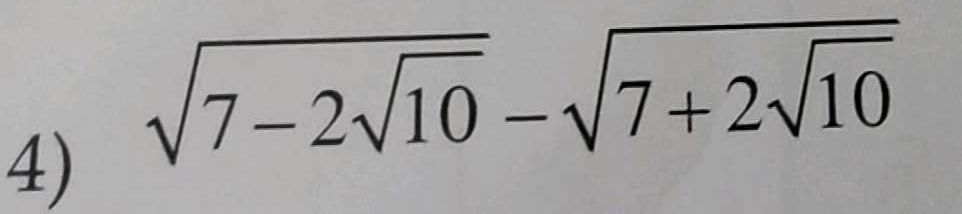

-- Number of words: 21


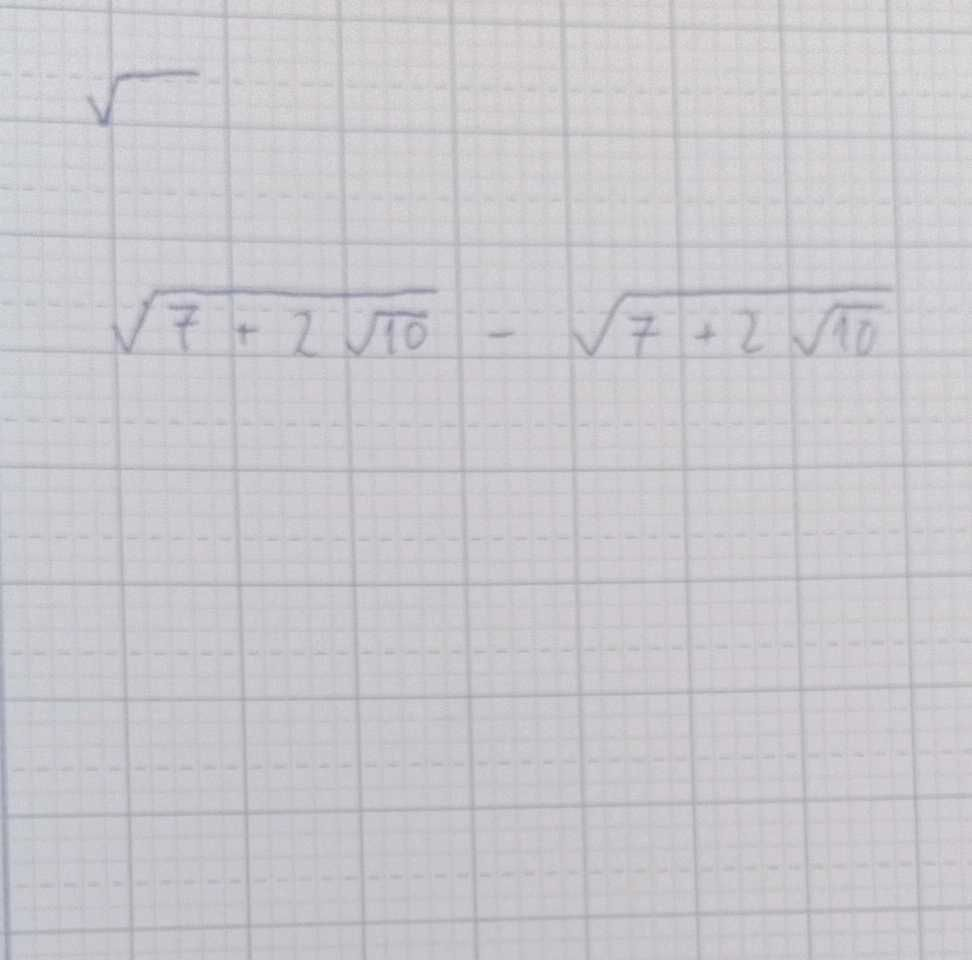

************

PAIRS: 102 - Cosine score: 0.8681126732778396
-- Number of words: 63


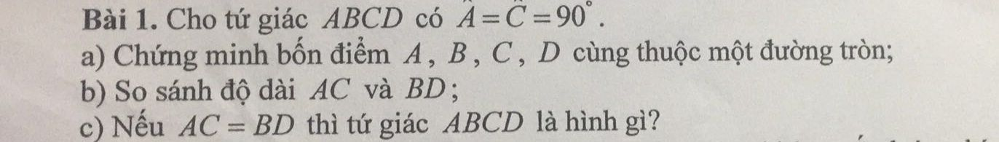

-- Number of words: 52


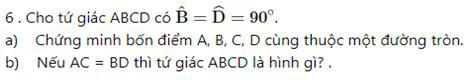

************

PAIRS: 103 - Cosine score: 0.8673175548604628
-- Number of words: 227


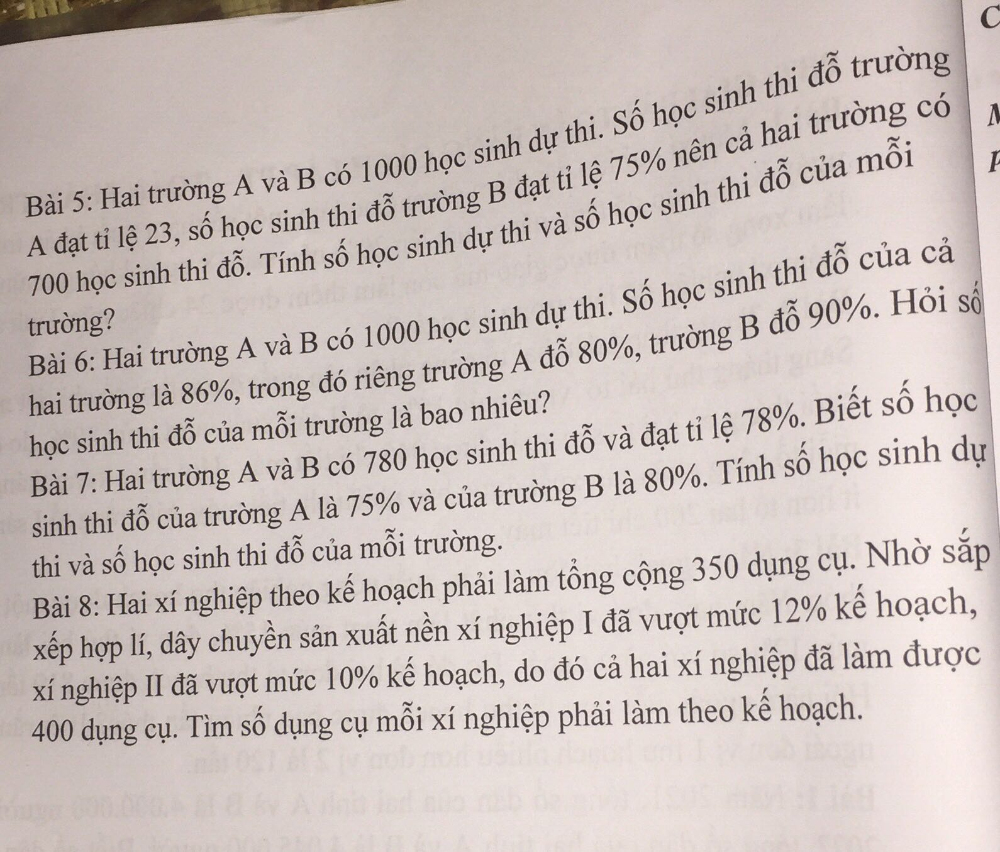

-- Number of words: 61


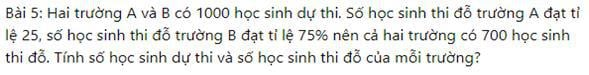

************

PAIRS: 104 - Cosine score: 0.8653357515797255
-- Number of words: 34


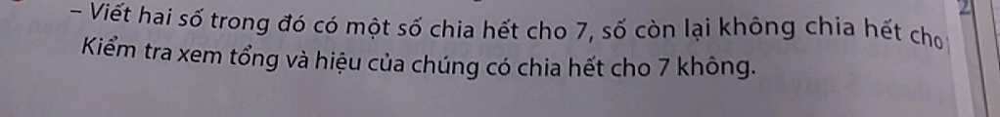

-- Number of words: 35


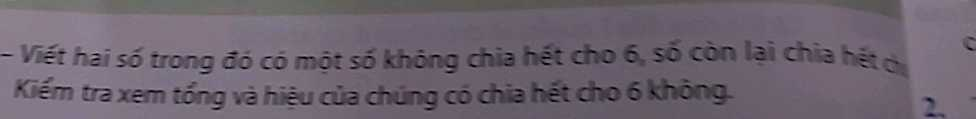

************

PAIRS: 105 - Cosine score: 0.8648261662761617
-- Number of words: 21


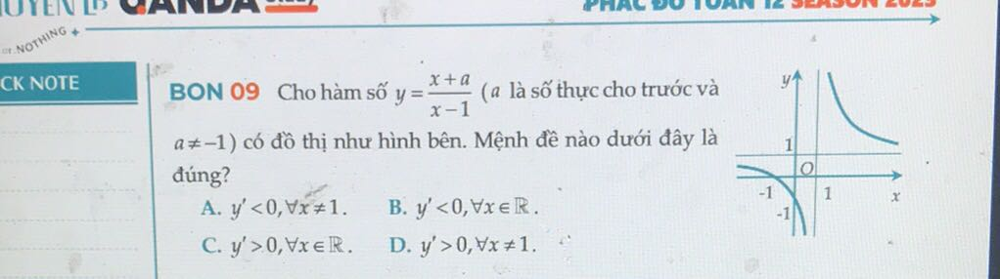

-- Number of words: 80


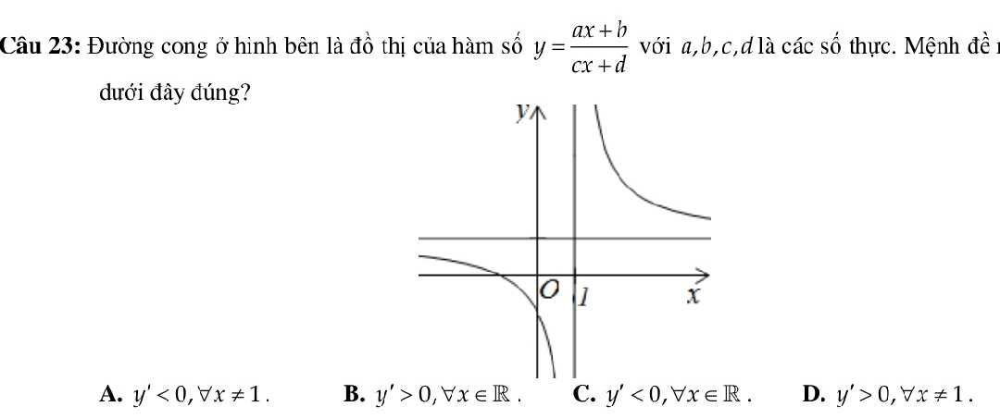

************

PAIRS: 106 - Cosine score: 0.8634440160608587
-- Number of words: 50


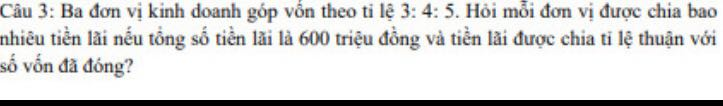

-- Number of words: 48


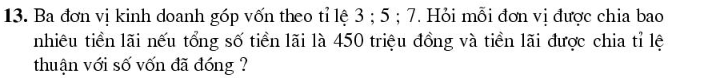

************

PAIRS: 107 - Cosine score: 0.8634199272901036
-- Number of words: 45


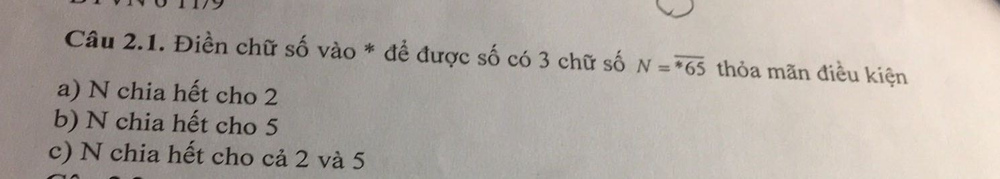

-- Number of words: 287


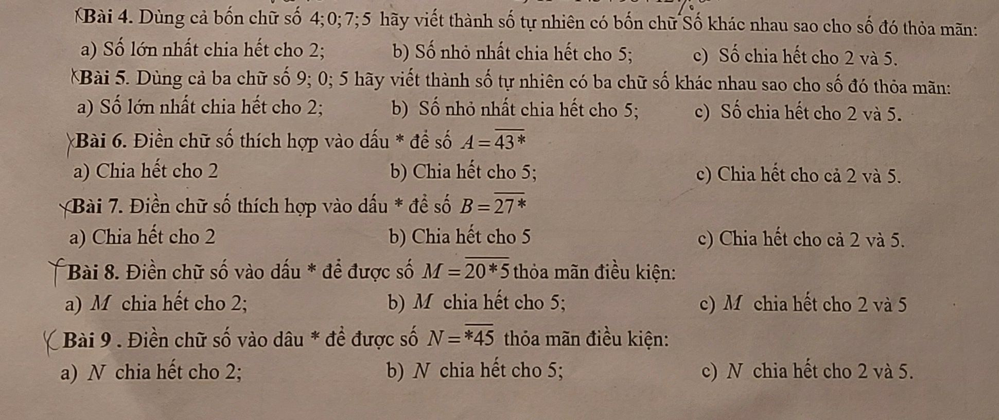

************

PAIRS: 108 - Cosine score: 0.8634198544075077
-- Number of words: 84


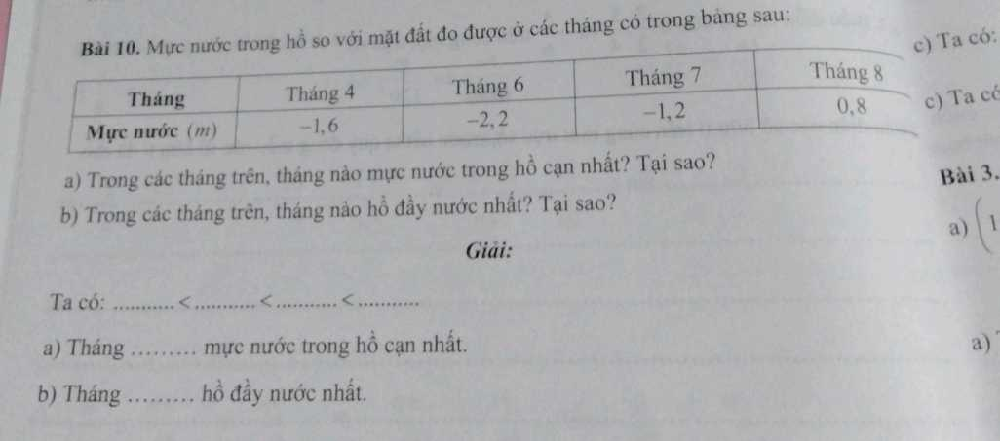

-- Number of words: 74


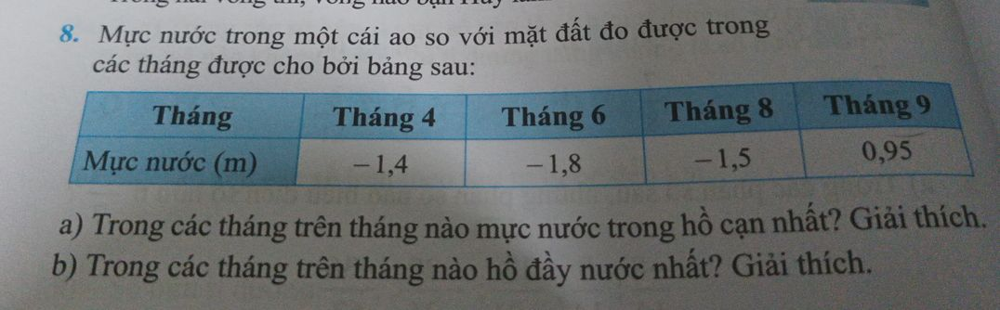

************

PAIRS: 109 - Cosine score: 0.8628561639479326
-- Number of words: 182


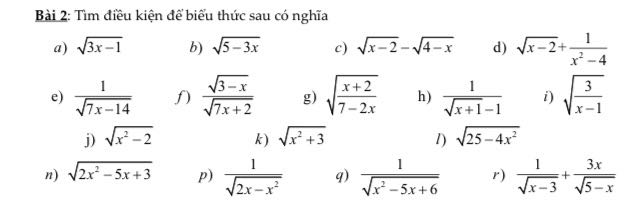

-- Number of words: 198


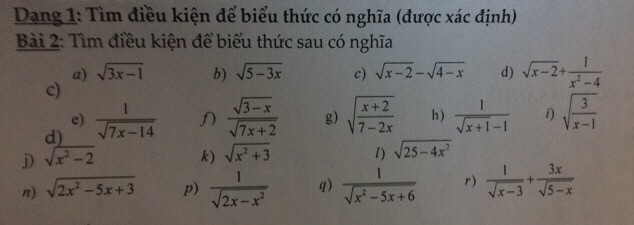

************

PAIRS: 110 - Cosine score: 0.8623178824232496
-- Number of words: 14


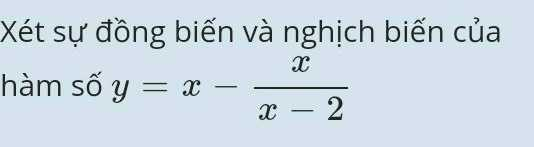

-- Number of words: 18


************

PAIRS: 111 - Cosine score: 0.8584331215699027
-- Number of words: 95


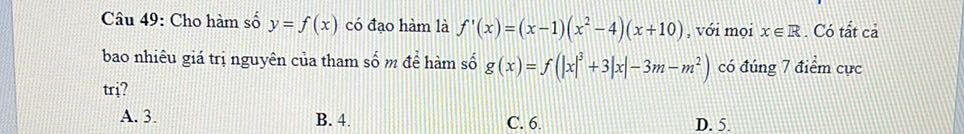

-- Number of words: 94


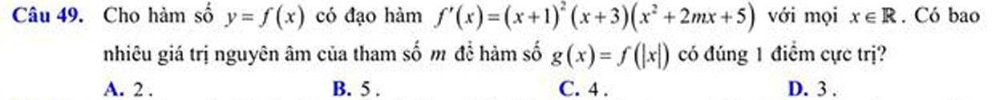

************

PAIRS: 112 - Cosine score: 0.8552488735947443
-- Number of words: 64


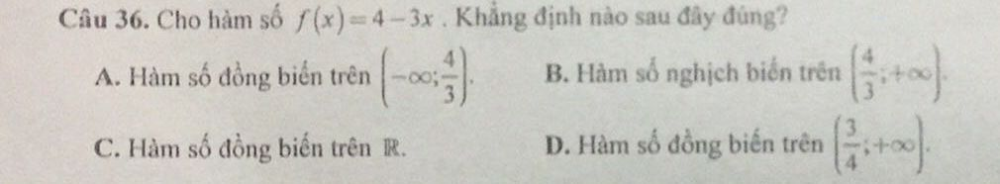

-- Number of words: 90


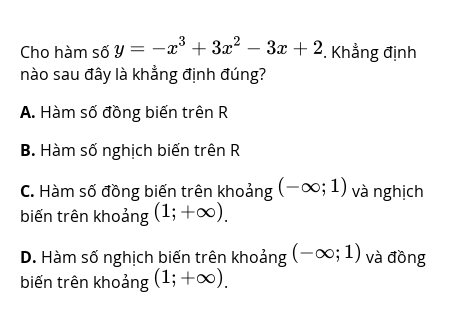

************

PAIRS: 113 - Cosine score: 0.8548346669353207
-- Number of words: 75


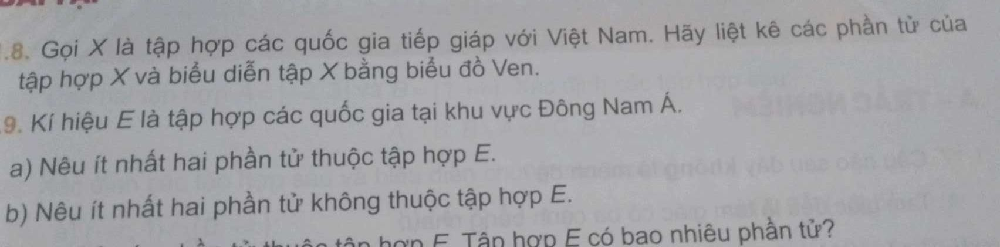

-- Number of words: 62


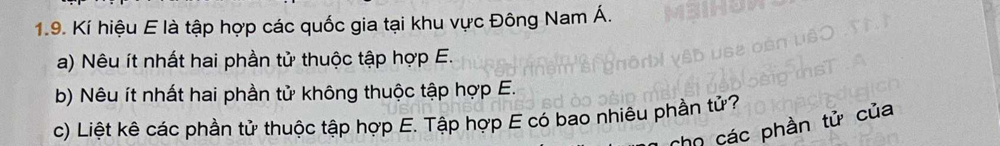

************

PAIRS: 114 - Cosine score: 0.8505632812621826
-- Number of words: 73


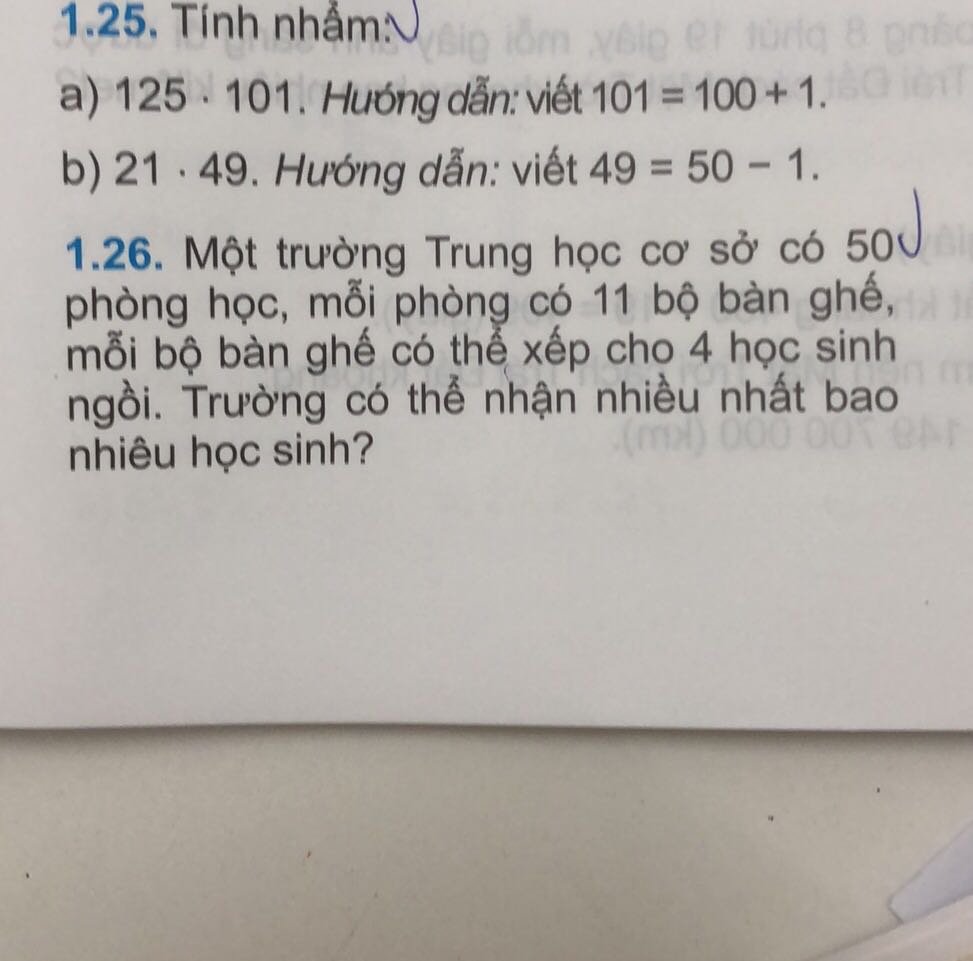

-- Number of words: 124


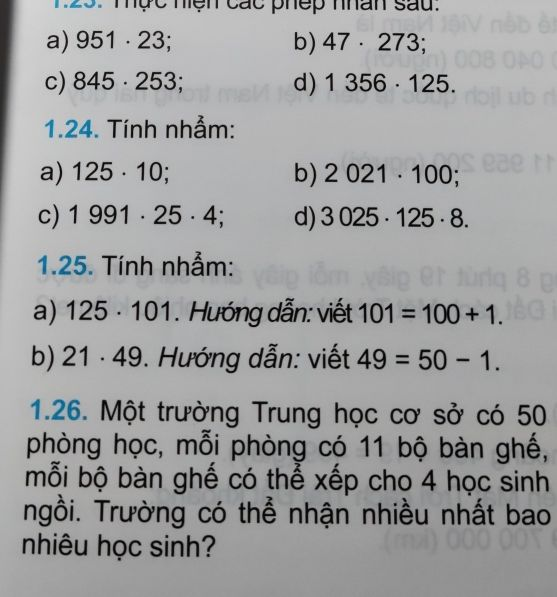

************

PAIRS: 115 - Cosine score: 0.8504247570069494
-- Number of words: 110


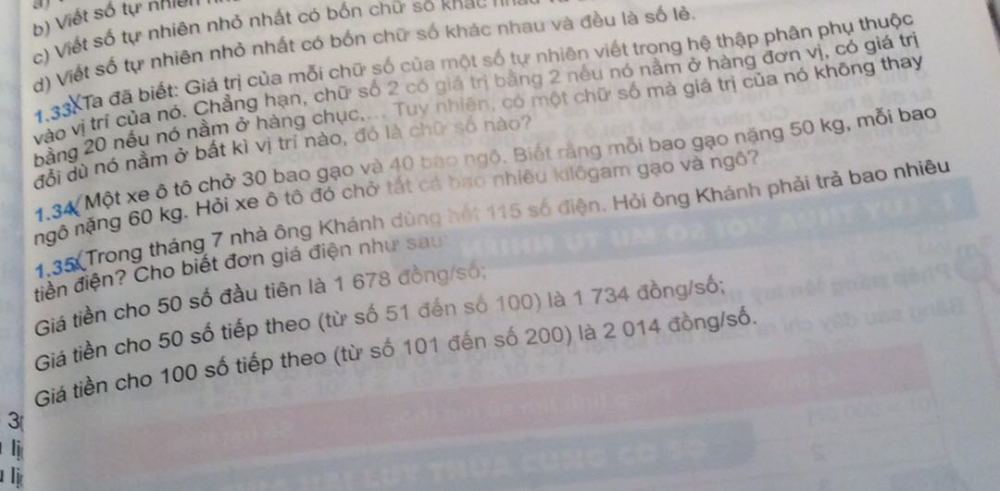

-- Number of words: 85


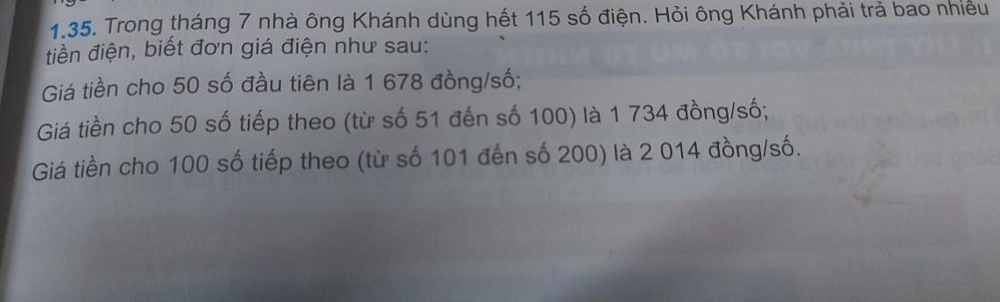

************

PAIRS: 116 - Cosine score: 0.8491879898277767
-- Number of words: 10


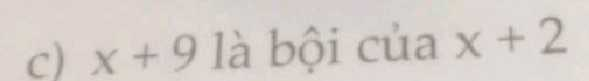

-- Number of words: 39


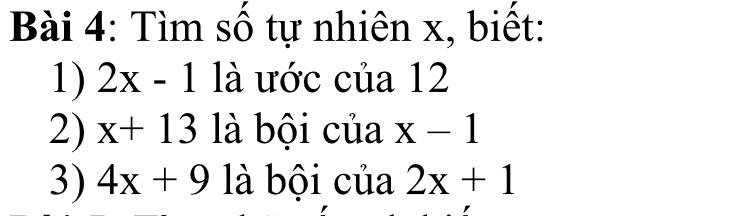

************

PAIRS: 117 - Cosine score: 0.8489995076759572
-- Number of words: 51


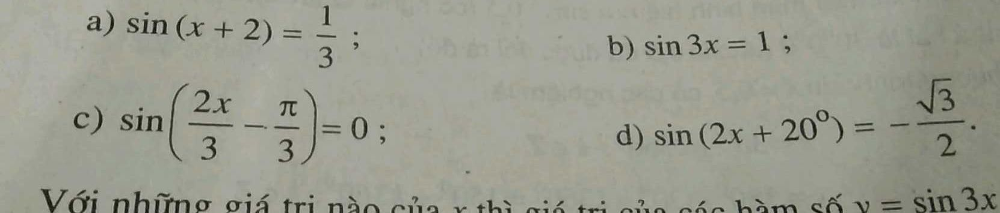

-- Number of words: 59


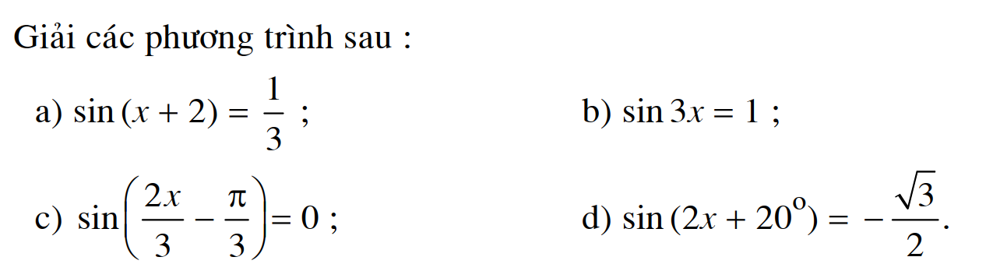

************

PAIRS: 118 - Cosine score: 0.8431531746455649
-- Number of words: 71


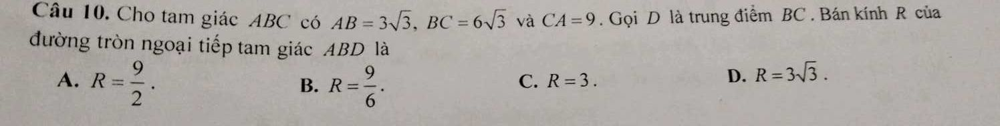

-- Number of words: 55


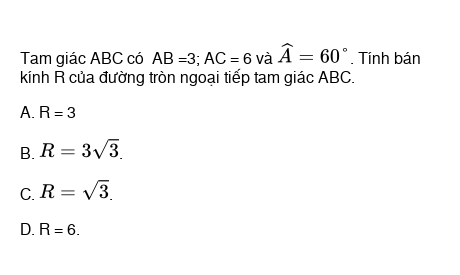

************

PAIRS: 119 - Cosine score: 0.8396694170454387
-- Number of words: 47


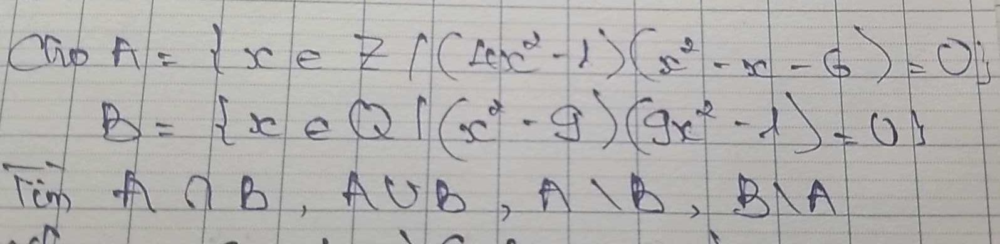

-- Number of words: 41


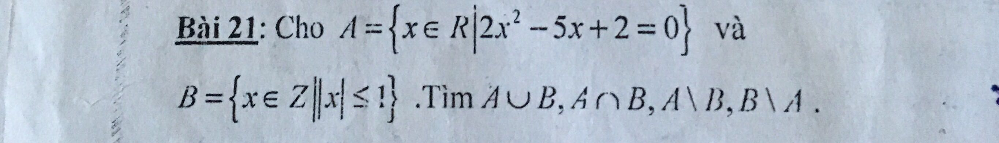

************

PAIRS: 120 - Cosine score: 0.837394114004935
-- Number of words: 94


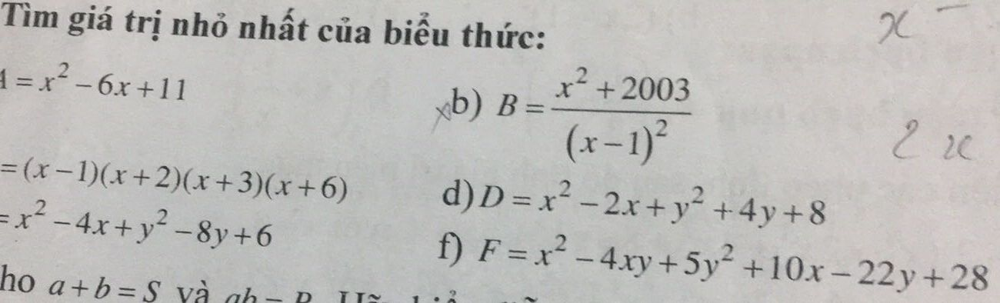

-- Number of words: 105


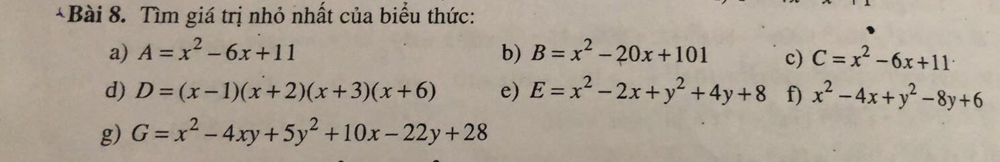

************

PAIRS: 121 - Cosine score: 0.8365447119530594
-- Number of words: 143


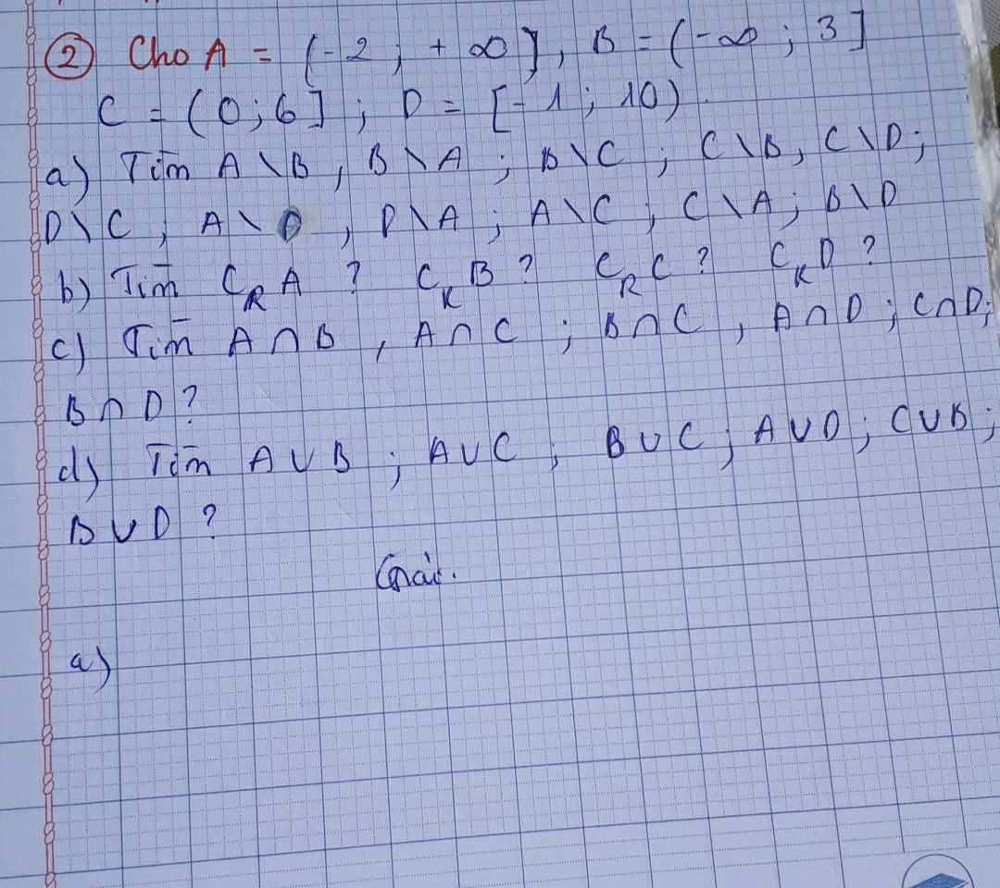

-- Number of words: 78


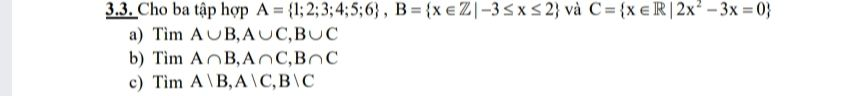

************

PAIRS: 122 - Cosine score: 0.8363413431764142
-- Number of words: 32


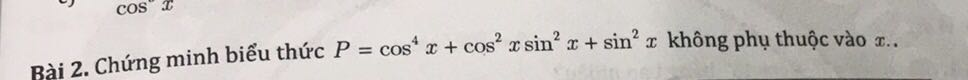

-- Number of words: 92


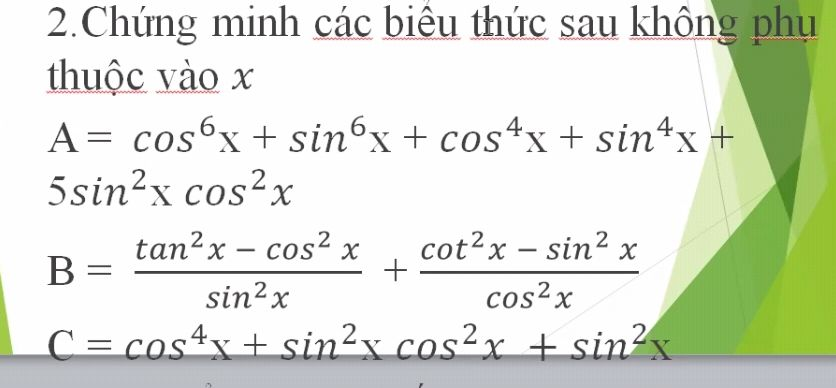

************

PAIRS: 123 - Cosine score: 0.8352755831900704
-- Number of words: 34


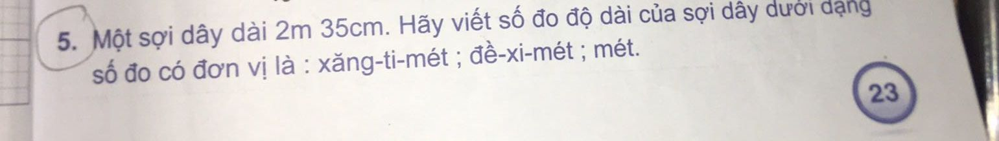

-- Number of words: 37


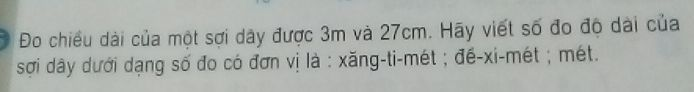

************

PAIRS: 124 - Cosine score: 0.8334215769179635
-- Number of words: 17


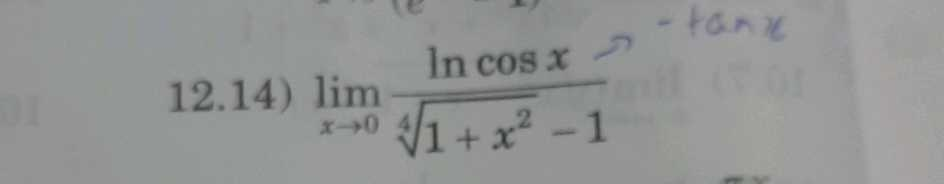

-- Number of words: 70


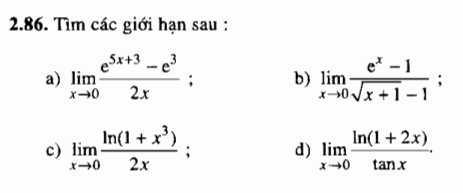

************

PAIRS: 125 - Cosine score: 0.8330813382554778
-- Number of words: 18


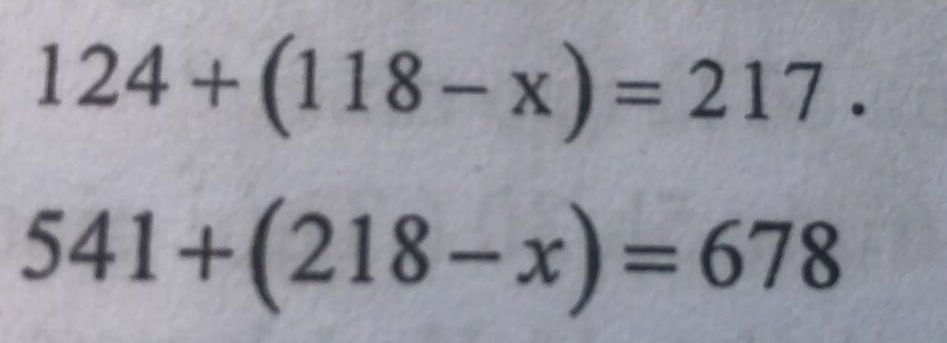

-- Number of words: 9


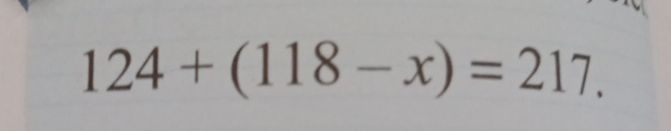

************

PAIRS: 126 - Cosine score: 0.830471885919001
-- Number of words: 14


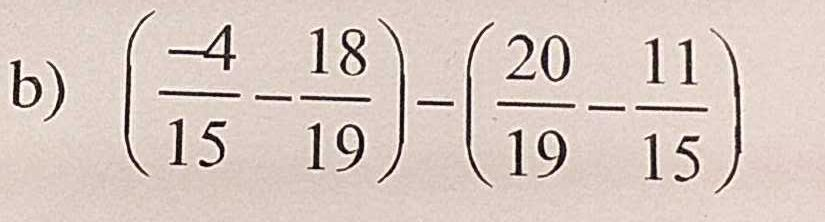

-- Number of words: 61


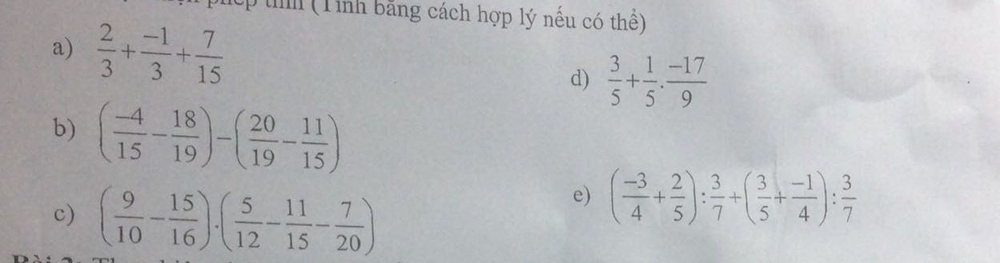

************

PAIRS: 127 - Cosine score: 0.830259104113986
-- Number of words: 42


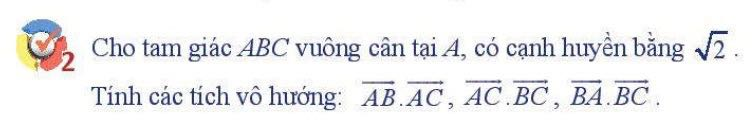

-- Number of words: 46


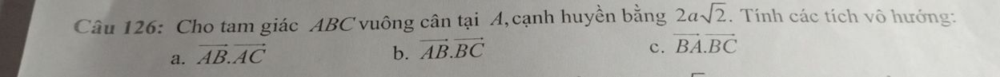

************

PAIRS: 128 - Cosine score: 0.8299189618918824
-- Number of words: 49


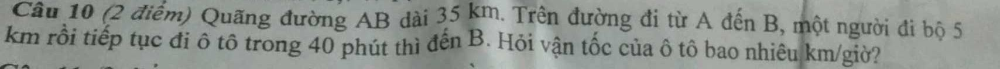

-- Number of words: 39


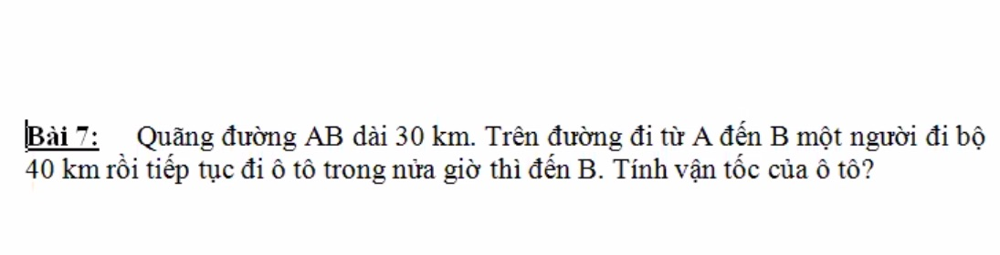

************

PAIRS: 129 - Cosine score: 0.8256072049823703
-- Number of words: 58


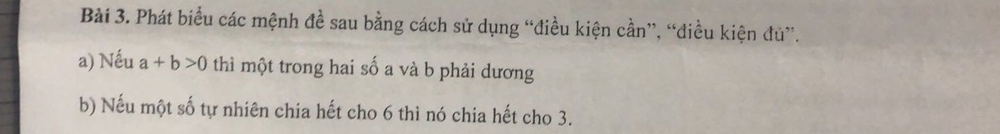

-- Number of words: 68


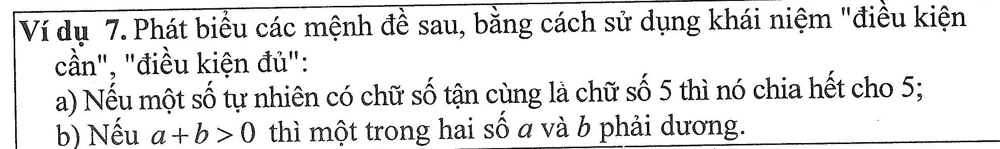

************

PAIRS: 130 - Cosine score: 0.8234532648272409
-- Number of words: 38


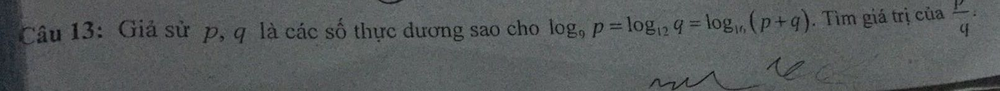

-- Number of words: 64


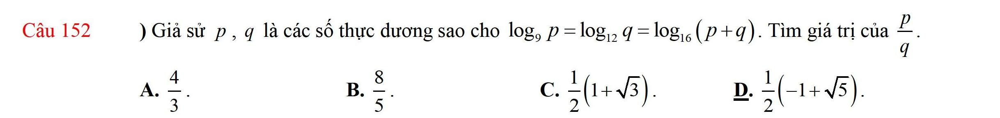

************

PAIRS: 131 - Cosine score: 0.8227265170287865
-- Number of words: 49


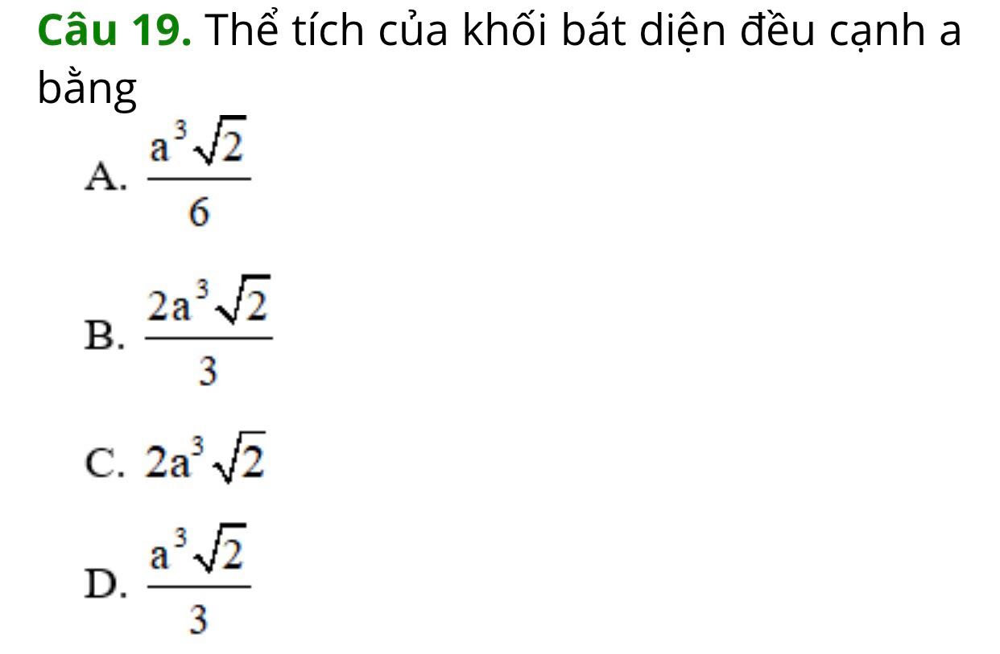

-- Number of words: 60


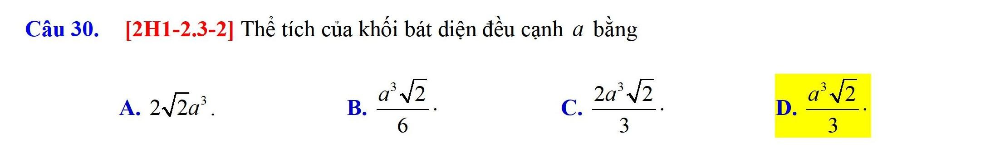

************

PAIRS: 132 - Cosine score: 0.820195518648115
-- Number of words: 858


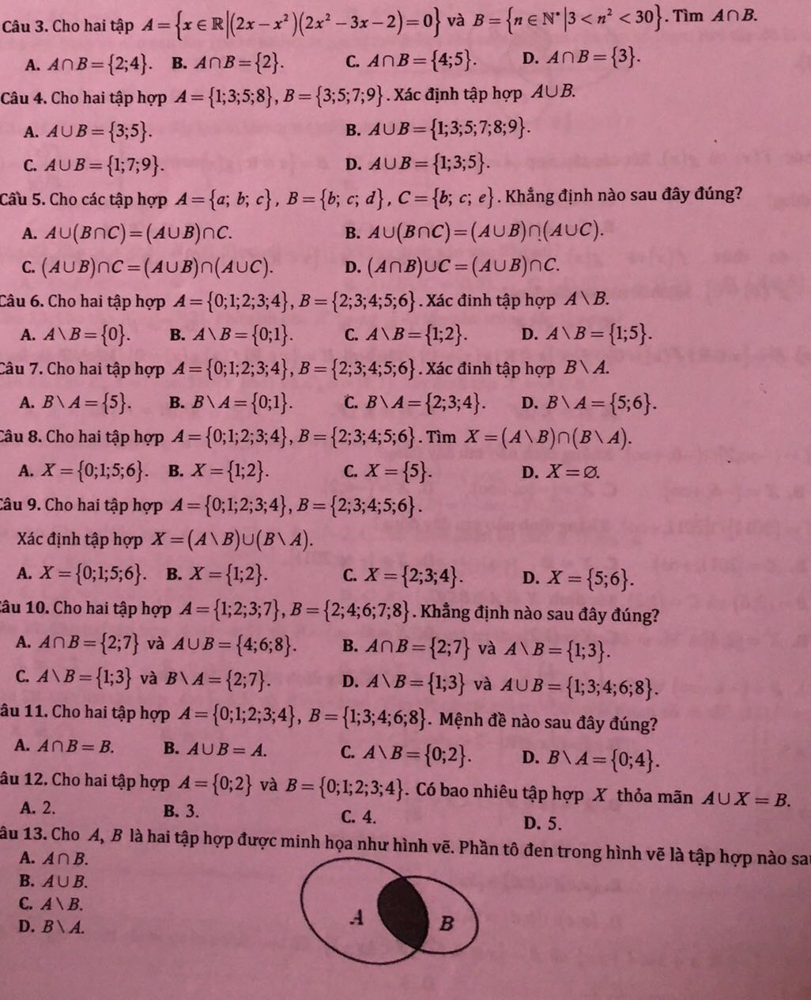

-- Number of words: 187


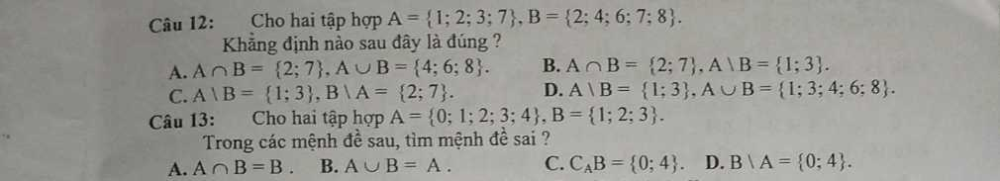

************

PAIRS: 133 - Cosine score: 0.8193900769110835
-- Number of words: 63


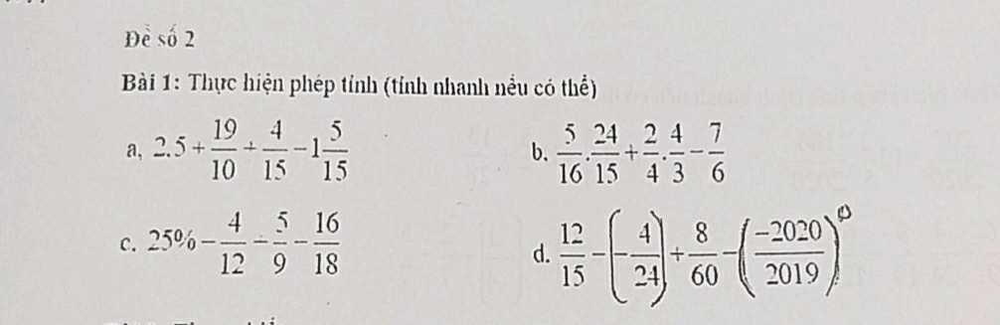

-- Number of words: 108


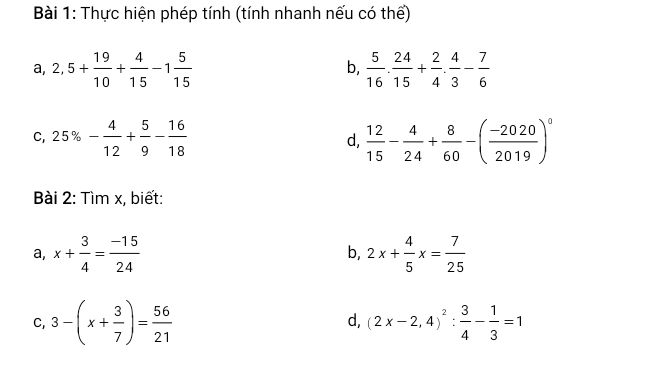

************

PAIRS: 134 - Cosine score: 0.819071185345702
-- Number of words: 40


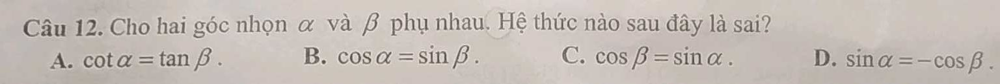

-- Number of words: 48


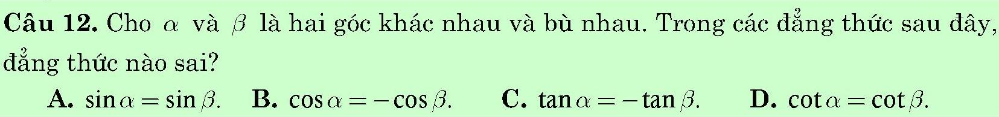

************

PAIRS: 135 - Cosine score: 0.8178195842971682
-- Number of words: 10


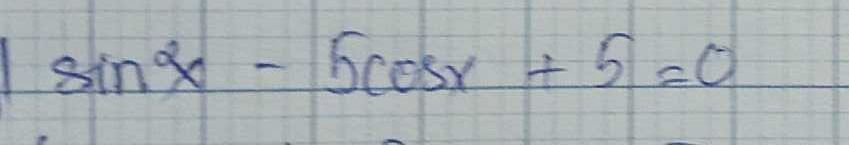

-- Number of words: 12


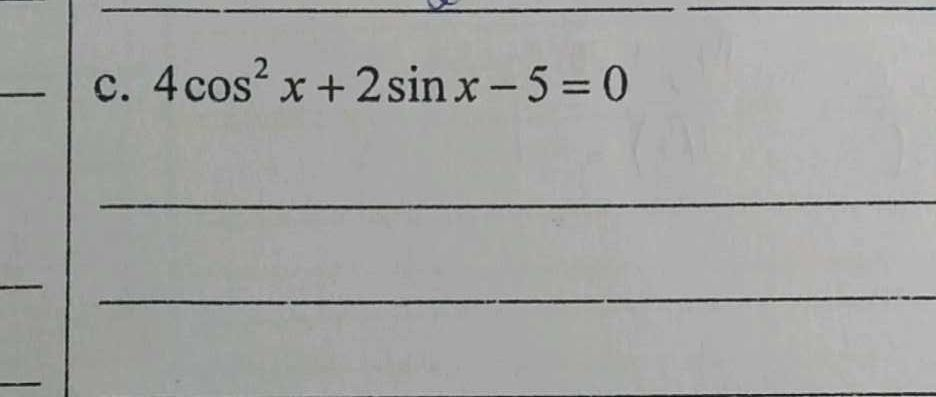

************

PAIRS: 136 - Cosine score: 0.8165162542160186
-- Number of words: 46


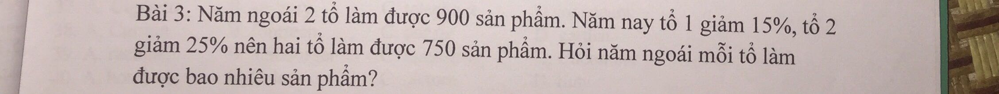

-- Number of words: 45


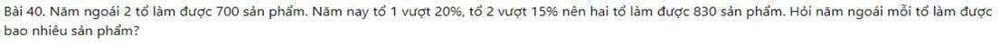

************

PAIRS: 137 - Cosine score: 0.8133396752148199
-- Number of words: 19


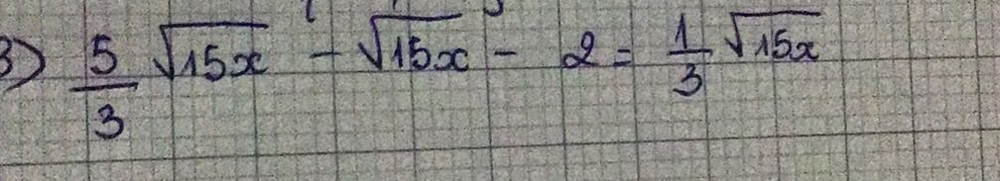

-- Number of words: 41


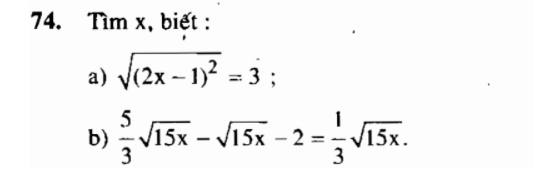

************

PAIRS: 138 - Cosine score: 0.8124143589841701
-- Number of words: 11


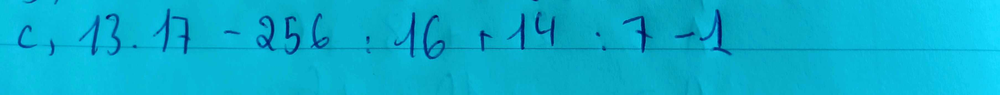

-- Number of words: 13


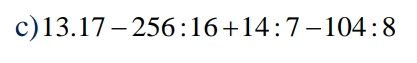

************

PAIRS: 139 - Cosine score: 0.8109396686290715
-- Number of words: 28


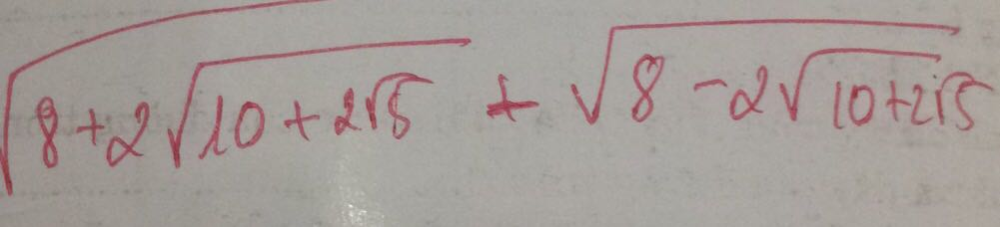

-- Number of words: 48


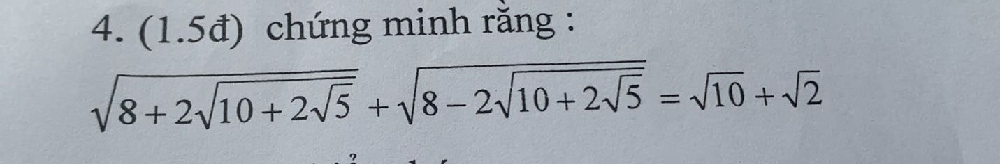

************

PAIRS: 140 - Cosine score: 0.8108983419725213
-- Number of words: 75


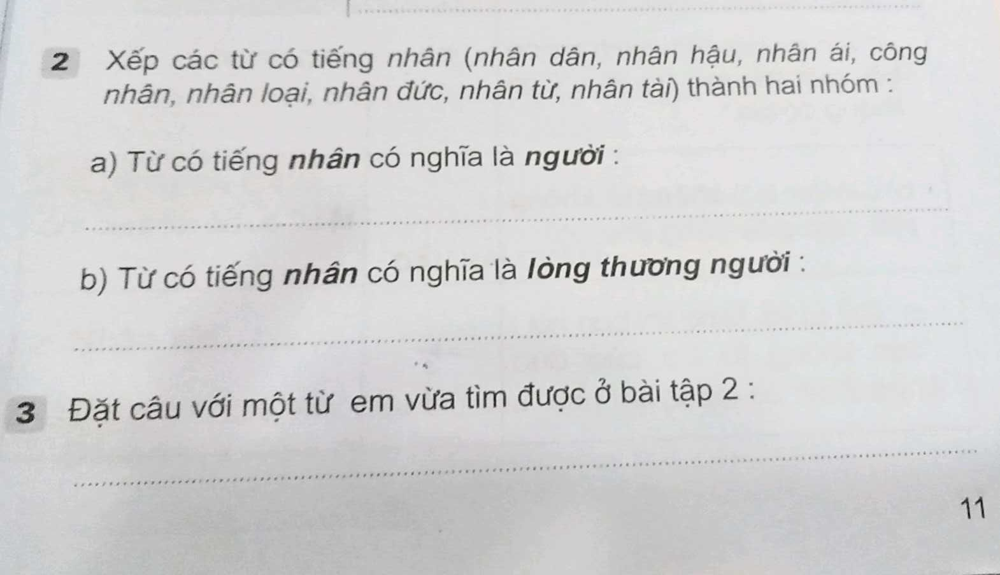

-- Number of words: 147


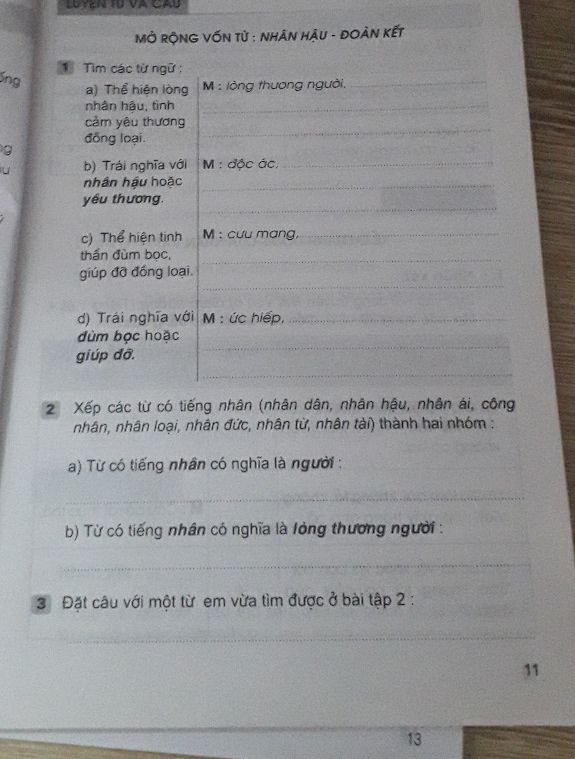

************

PAIRS: 141 - Cosine score: 0.8090081161137538
-- Number of words: 10


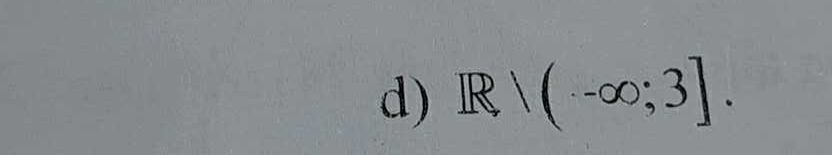

-- Number of words: 52


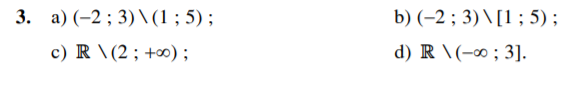

************

PAIRS: 142 - Cosine score: 0.8079638918206129
-- Number of words: 34


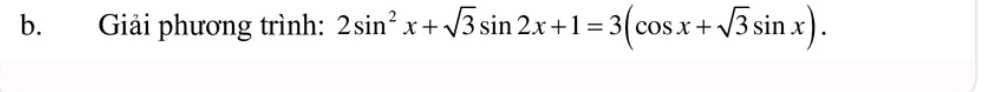

-- Number of words: 28


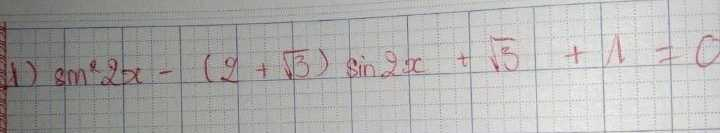

************

PAIRS: 143 - Cosine score: 0.8025452385694969
-- Number of words: 27


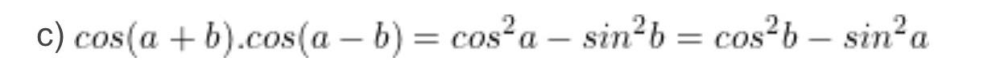

-- Number of words: 27


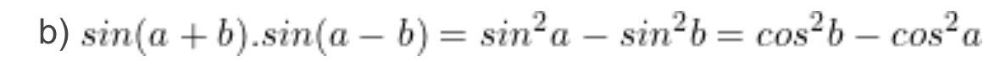

************

PAIRS: 144 - Cosine score: 0.8022419187019614
-- Number of words: 81


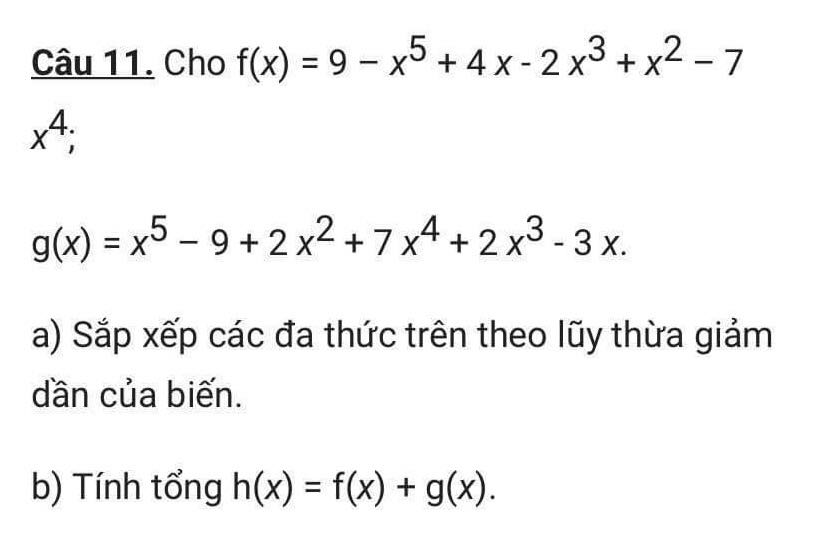

-- Number of words: 96


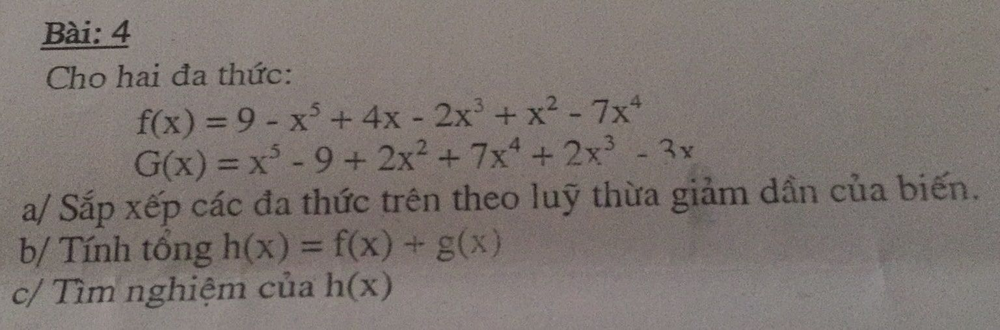

************

PAIRS: 145 - Cosine score: 0.8022007567695667
-- Number of words: 2


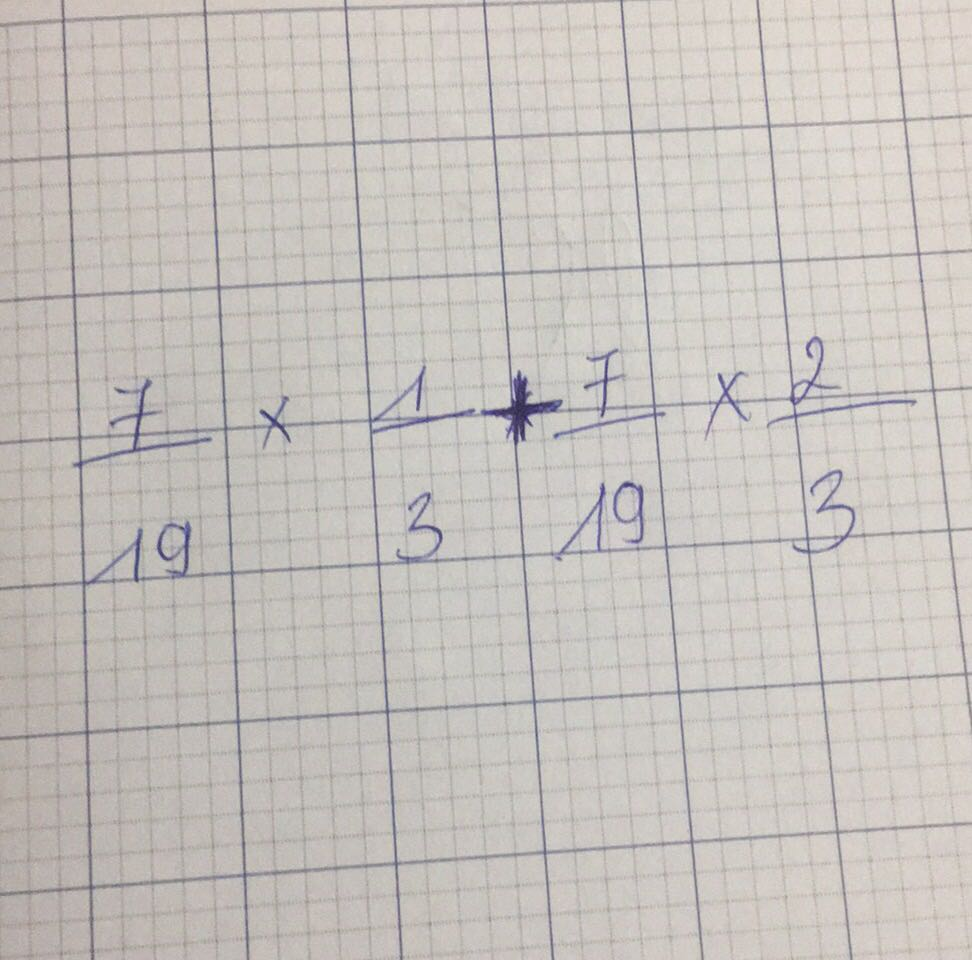

-- Number of words: 5


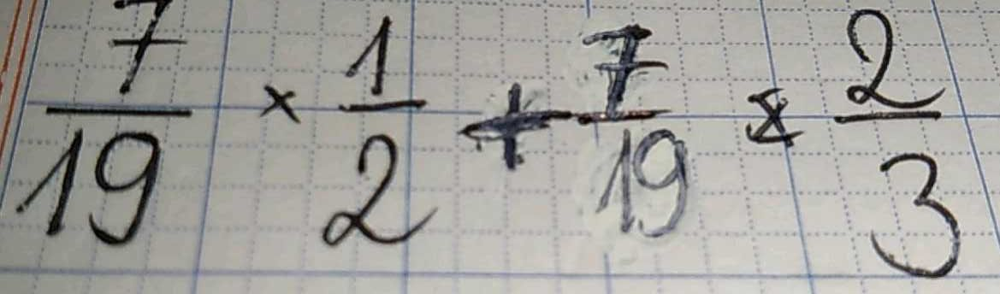

************

PAIRS: 146 - Cosine score: 0.8012932285868173
-- Number of words: 58


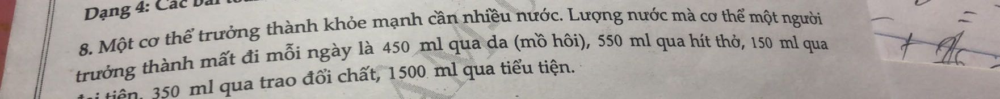

-- Number of words: 133


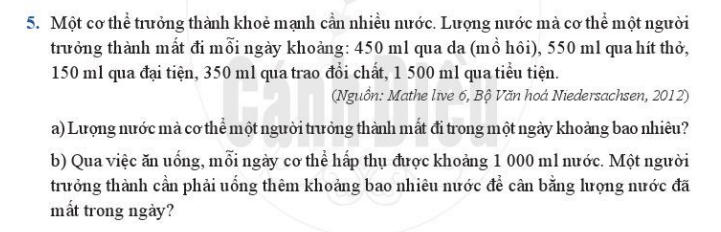

************

PAIRS: 147 - Cosine score: 0.8009927077146458
-- Number of words: 48


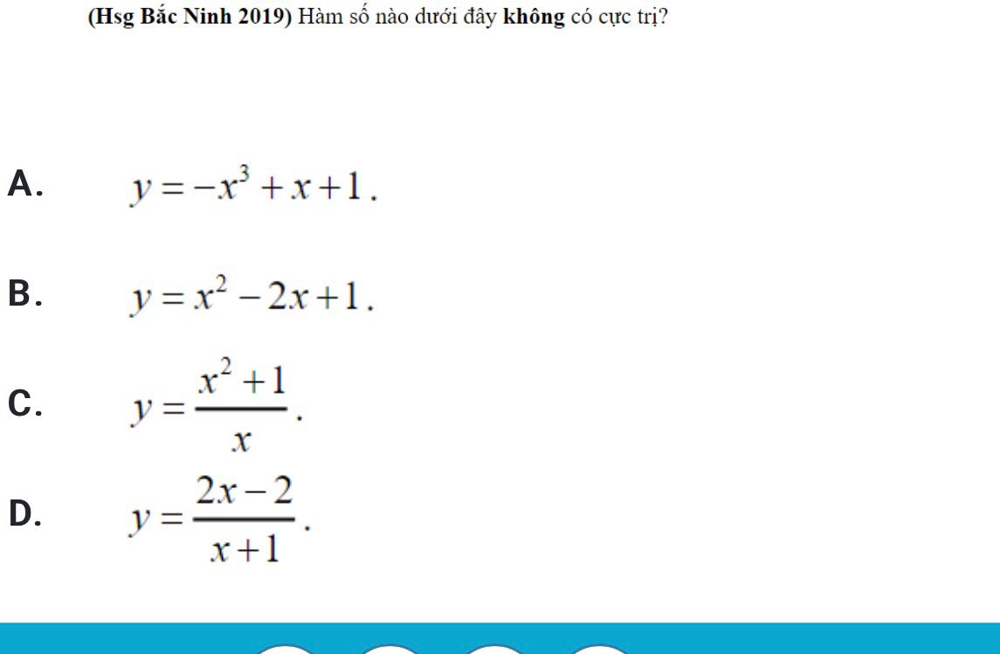

-- Number of words: 45


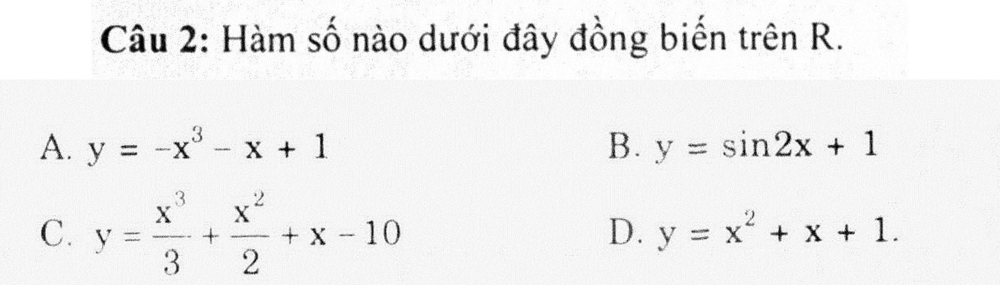

************



In [75]:
idx = 0
# end = 20
for url1 in df_test['Question Image'].values:
    print('PAIRS: {} - Cosine score: {}'.format(idx + 1, df_test['score'].values[idx]))
    print('-- Number of words:', df_test['word_count_lookup'].values[idx])
    img0 = Disp.Image(requests.get(df_test['Lookup Image'].values[idx]).content)
    display(img0)
    print('-- Number of words:', df_test['word_count_question'].values[idx])
    img1 = Disp.Image(requests.get(url1).content)
    display(img1)
#     print('-- Number of words:', df_test['cosine_word_count_question'].values[idx])
#     img2 = Disp.Image(requests.get(url2).content)
#     display(img2)
    print('************')
    print()
    idx += 1
#     if idx > 20:
#         break

In [78]:
(15*5+2)/df_test.shape[0]

0.5238095238095238

In [85]:
df_test2 = df_pos.loc[df_pos['score'] <= 0.75]
df_test2 = df_test2.sort_values(by = 'score', ascending = True)
df_test2.shape

(186, 22)

In [88]:
df_test2

,Feedback ID,Lookup Text,Question Text,Feedback Type,Feedback Result,Human Feedback,Lookup Image,Question Image,index_org,lookup_plain,...,clean_question,char_count_lookup,word_count_lookup,average_word_length_lookup,char_count_question,word_count_question,average_word_length_question,score,jc_score,pca_score
885,9289.0,d) \( x^{2}-x+\frac{1}{4} \),d) \( x^{2}-x+\frac{1}{4} \),POSITIVE,MATCH,MATCH,https://s3.icankid.io/uploads/question/7625a100-395e-11ed-afcb-abad28552b30,https://s3.icankid.io/uploads/question/8e7cad70-ebbb-11ec-80fa-7dd59c10bdcf,1733,d) x^2-x+1/4,...,d ) x ^ 2 - x + 1/4,19,9,2.111111,19,9,2.111111,0.000000,1.000000,1.000000
173,5301.0,i)\n\( I=\left\{x \in R \mid \sqrt{x^{2}} \leq 2\right\} \),i)\n\( I=\left\{x \in R \mid \sqrt{x^{2}} \leq 2\right\} \),POSITIVE,MATCH,MATCH,https://s3.icankid.io/uploads/question/9b395670-2f87-11ed-8671-9785b1571c36,https://s3.icankid.io/uploads/question/9b395670-2f87-11ed-8671-9785b1571c36,310,i)\nI={x ∈ R |√(x^2)≤ 2},...,i ) i =_{ x ∈ r |_√ ( x ^ 2 ) ≤ 2 },35,16,2.187500,35,16,2.187500,0.000000,1.000000,1.000000
185,5357.0,"A. \( "" \exists x \in Q , x=\frac{1}{x} \)\nB. \( w x \in Q , x=\frac{1}{x} \),\nC. \( \cdots \forall x \notin Q, x \neq \frac{1}{x} \)\nD. \( -\forall x \in Q , x \neq \frac{1}{x} \).","A. \( "" \exists x \in Q , x=\frac{1}{x} \)\nB. \( w x \in Q , x=\frac{1}{x} \),\nC. \( \cdots \forall x \notin Q, x \neq \frac{1}{x} \)\nD. \( -\forall x \in Q , x \neq \frac{1}{x} \).",POSITIVE,SKIP,MATCH,https://s3.icankid.io/uploads/question/0e10b040-3013-11ed-8671-9785b1571c36,https://s3.icankid.io/uploads/question/0e10b040-3013-11ed-8671-9785b1571c36,334,"A. "" ∃ x ∈ Q , x=1/x\nB. w x ∈ Q , x=1/x,\nC. ⋯∀ x ∉ Q, x ≠1/x\nD. -∀ x ∈ Q , x ≠1/x.",...,"a . "" ∃ x ∈ q , x = 1 / x b . w x ∈ q , x = 1 / x , c ._⋯_∀ x ∉ q , x ≠ 1 / x d . - ∀ x ∈ q , x ≠ 1 / x .",105,51,2.058824,105,51,2.058824,0.000000,1.000000,1.000000
888,9295.0,c) \( (x-1)(x+1)(x+2) \),b) \( (x-1)(x+1)(x+2) \),POSITIVE,NOT_MATCH,MATCH,https://s3.icankid.io/uploads/question/37eff5f0-3960-11ed-afcb-abad28552b30,https://s3.icankid.io/uploads/question/547771a0-fec1-11ec-abd5-4dcb92c2b90f,1736,c) (x-1)(x+1)(x+2),...,b ) ( x-1 ) ( x + 1 ) ( x + 2 ),31,15,2.066667,31,15,2.066667,0.000000,0.777778,1.000000
863,9142.0,b) \( \frac{3}{5} x-\frac{3}{4}=-1 \frac{1}{2} \),b) \( \frac{3}{5} x-\frac{3}{4}=-1 \frac{1}{2} \);,POSITIVE,SKIP,MATCH,https://s3.icankid.io/uploads/question/f3f9dff0-38ec-11ed-afcb-abad28552b30,https://s3.icankid.io/uploads/question/3d7eb0a0-ff8c-11ec-abd5-4dcb92c2b90f,1684,b) 3/5 x-3/4=-1 1/2,...,b ) 3/5 x-3 / 4 = - 1 1/2 ;,25,10,2.500000,27,11,2.454545,0.000000,0.909091,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267,5829.0,"X 1.17. Tính:\na) \( 63548+19256 \);\nb) \( 129107-34693 \).\n( 1.18. Thay ""?"" bằng \( s \)\n\( ?+2895=2 \)\n1.19. Tìm số tự nhiêr\na) \( 7+x=362 \)","1.17. Tinh:\na) \( 63548+19256 \)\nb) \( 129107-34693 . \)\n1.18. Thay ""?"" bằng số thích hợp:\n\[\n?+2895=2895+6789\n\]",NEGATIVE,NOT_MATCH,MATCH,https://s3.icankid.io/uploads/question/7cb83f60-31d8-11ed-8671-9785b1571c36,https://s3.icankid.io/uploads/question/6e1f7cf0-220d-11ed-8671-9785b1571c36,498,"X 1.17. Tính:\na) 63548+19256;\nb) 129107-34693.\n( 1.18. Thay ""?"" bằng s\n?+2895=2\n1.19. Tìm số tự nhiêr\na) 7+x=362",...,"1.17 ._tinh : a ) 63548 + 19256 b ) 129107 - 34693 ._1.18 . thay "" ? "" bng s thch hp : ? + 2895 = 2895 + 6789",129,42,3.071429,109,31,3.516129,0.743662,0.527778,0.800936
957,9746.0,Bài 1: Cho biếu thức \( M =\frac{1}{\sqrt{x}-2} \)\na) Tìm ĐKXФ của \( M \)\nb) Tính giá trị của \( M \) khi \( x=9 \),Bài 4: Cho biều thức \( M =\frac{1}{\sqrt{x}-2} \)\na) Tìm DKXD của \( M \)\nb) Tính giá trị của \( M \) khi \( x =9 \),POSITIVE,NOT_MATCH,MATCH,https://s3.icankid.io/uploads/question/63c75250-39be-11ed-afcb-abad28552b30,https://s3.icankid.io/uploads/question/64bc1290-39be-11ed-afcb-abad28552b30,1880,Bài 1: Cho biếu thức M =1/√(x)-2\na) Tìm ĐKXФ của M\nb

PAIRS: 1 - Cosine score: 0.0
-- Number of words: 9


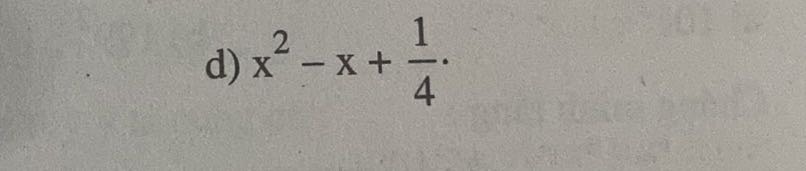

-- Number of words: 9


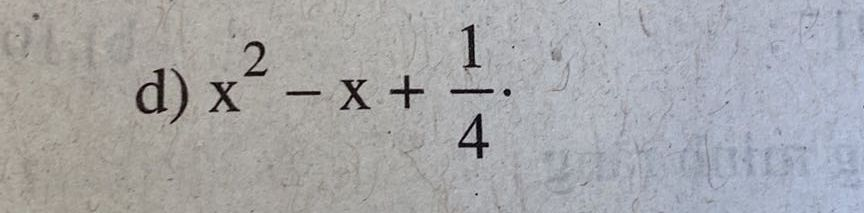

************

PAIRS: 2 - Cosine score: 0.0
-- Number of words: 16


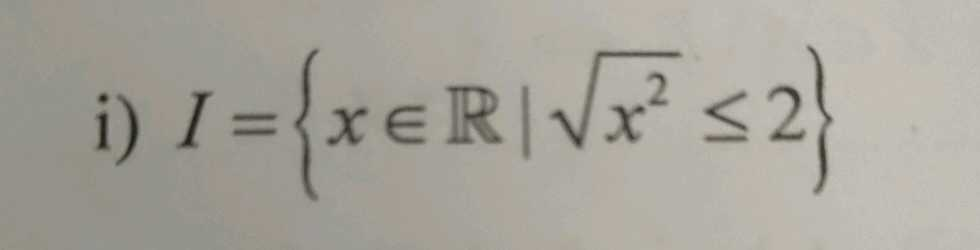

-- Number of words: 16


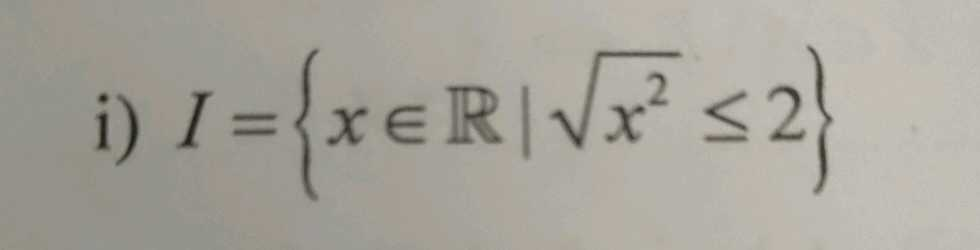

************

PAIRS: 3 - Cosine score: 0.0
-- Number of words: 51


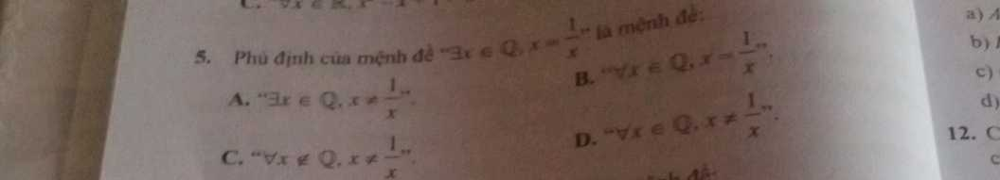

-- Number of words: 51


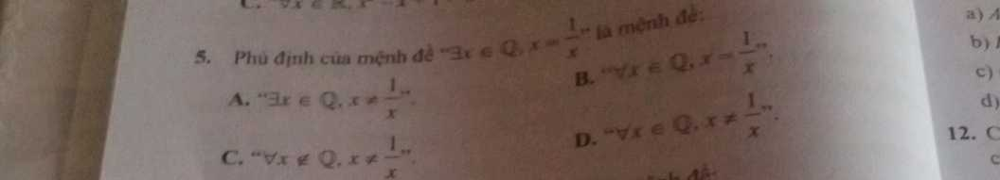

************

PAIRS: 4 - Cosine score: 0.0
-- Number of words: 15


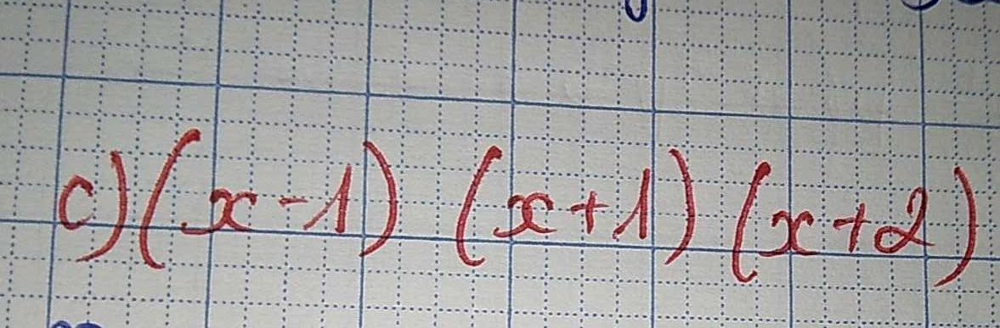

-- Number of words: 15


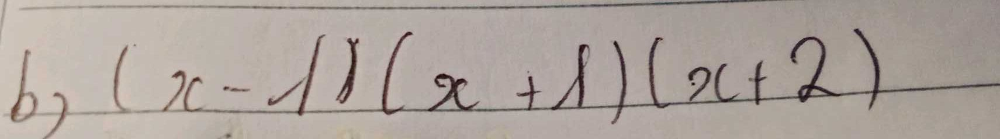

************

PAIRS: 5 - Cosine score: 0.0
-- Number of words: 10


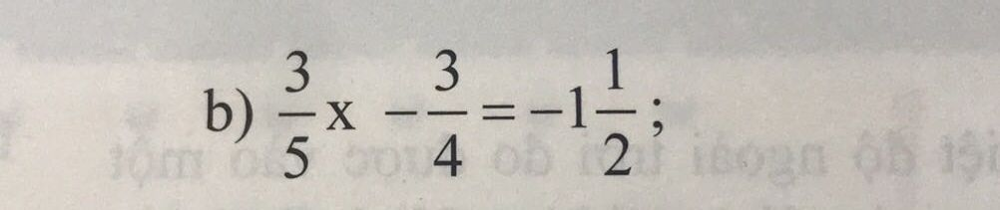

-- Number of words: 11


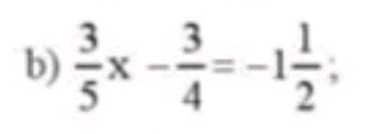

************

PAIRS: 6 - Cosine score: 0.0
-- Number of words: 9


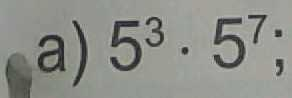

-- Number of words: 7


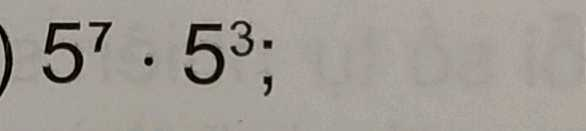

************

PAIRS: 7 - Cosine score: 0.0
-- Number of words: 20


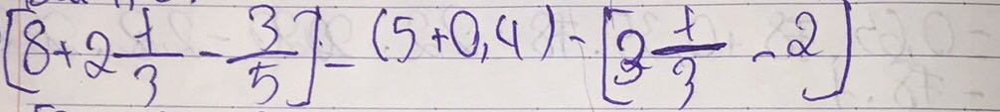

-- Number of words: 22


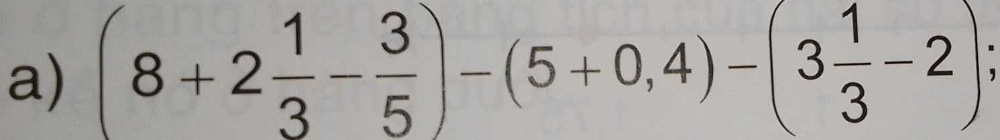

************

PAIRS: 8 - Cosine score: 0.0
-- Number of words: 17


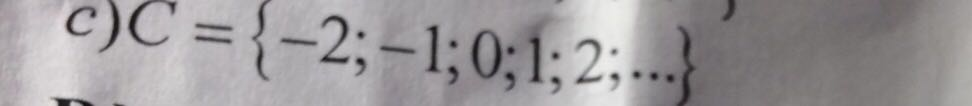

-- Number of words: 17


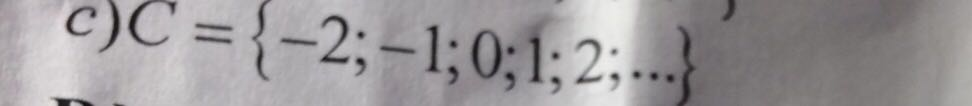

************

PAIRS: 9 - Cosine score: 0.0
-- Number of words: 24


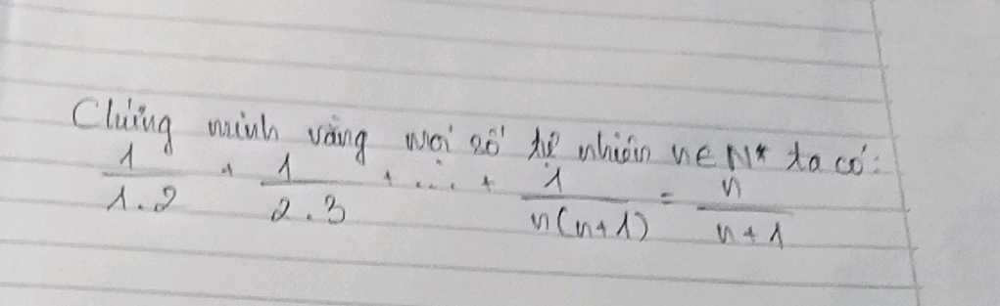

-- Number of words: 28


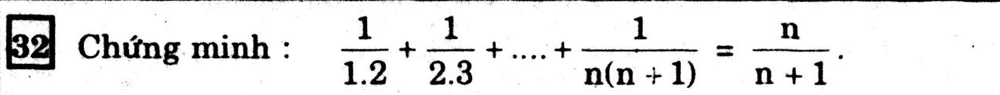

************

PAIRS: 10 - Cosine score: 0.0
-- Number of words: 52


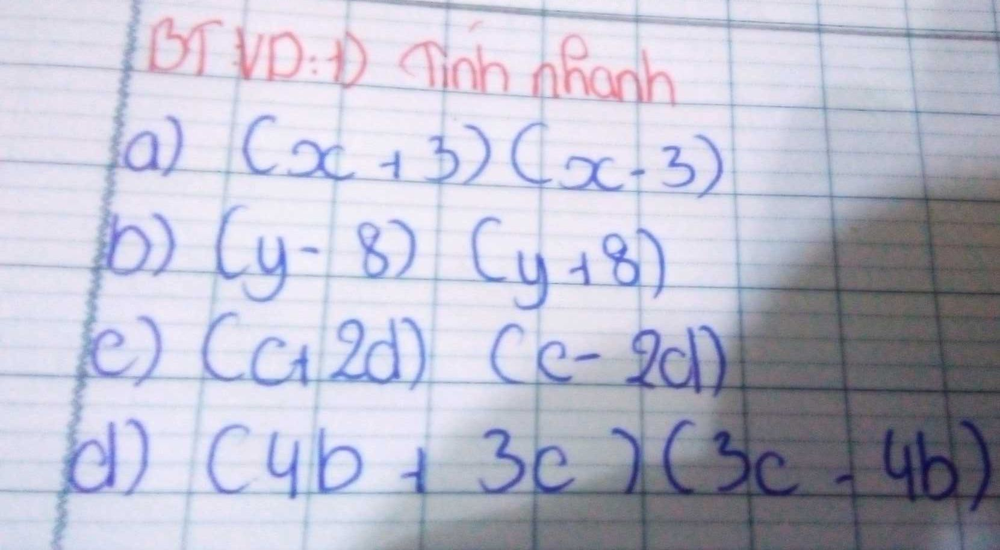

-- Number of words: 46


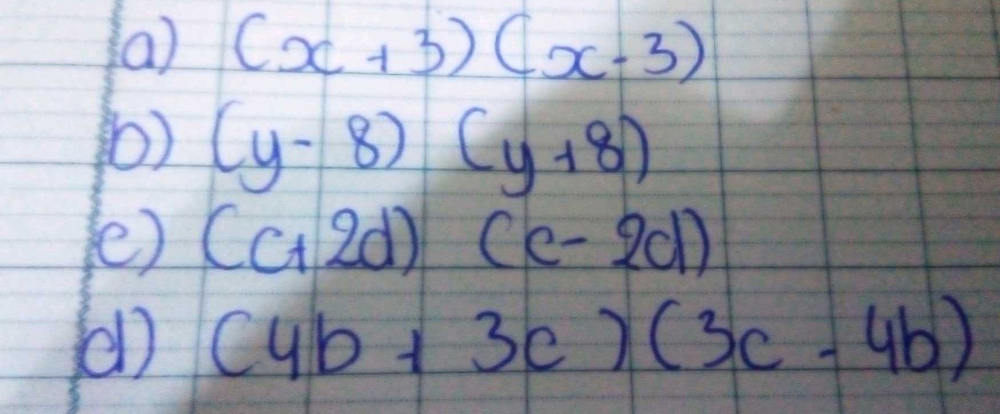

************

PAIRS: 11 - Cosine score: 0.0
-- Number of words: 28


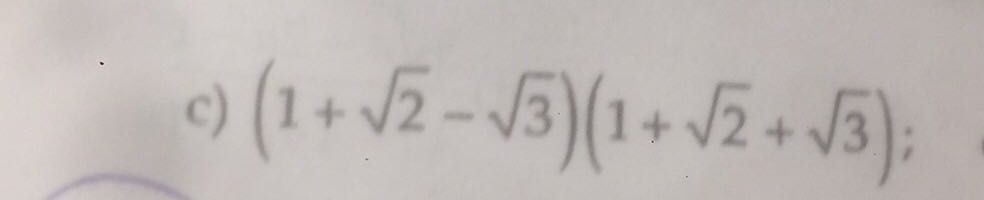

-- Number of words: 28


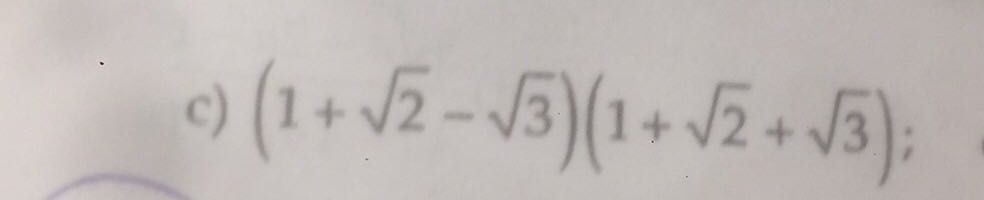

************

PAIRS: 12 - Cosine score: 0.0
-- Number of words: 18


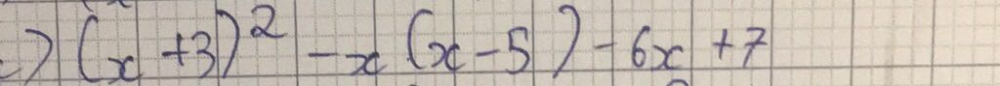

-- Number of words: 19


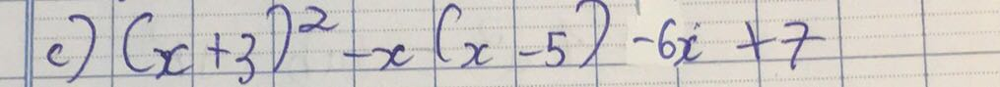

************

PAIRS: 13 - Cosine score: 0.0
-- Number of words: 29


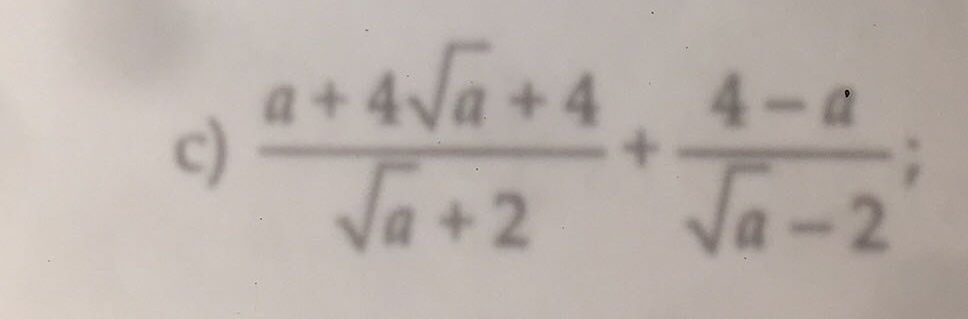

-- Number of words: 27


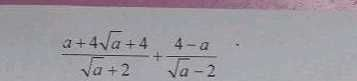

************

PAIRS: 14 - Cosine score: 0.0
-- Number of words: 7


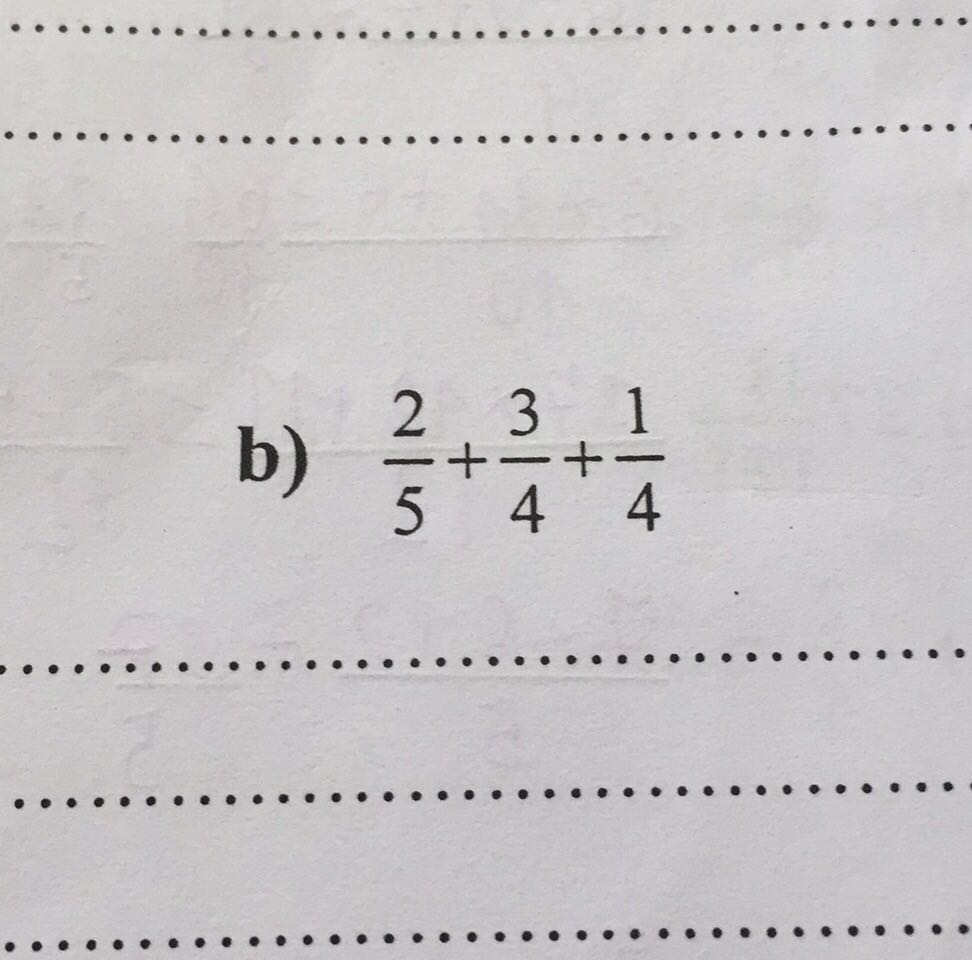

-- Number of words: 7


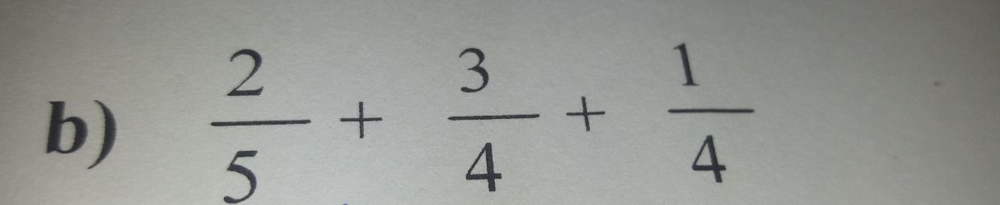

************

PAIRS: 15 - Cosine score: 0.0
-- Number of words: 22


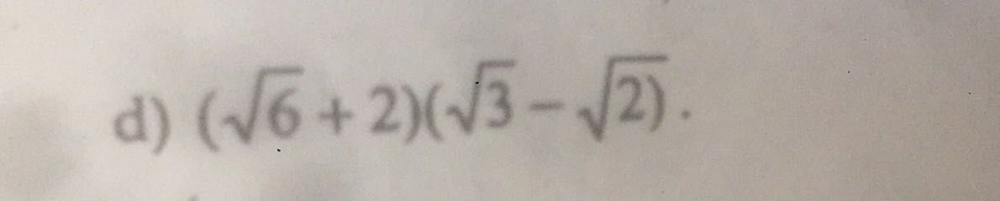

-- Number of words: 21


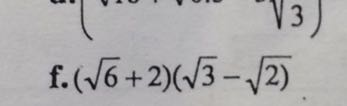

************

PAIRS: 16 - Cosine score: 0.0
-- Number of words: 8


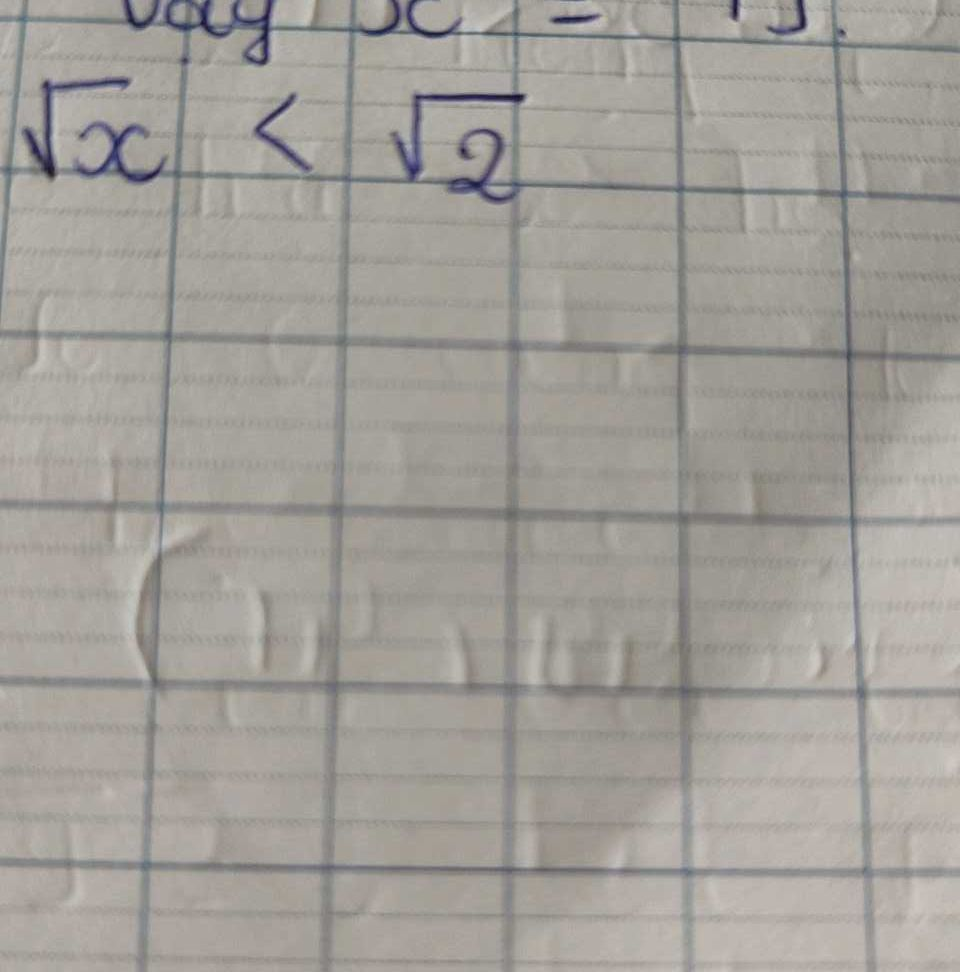

-- Number of words: 10


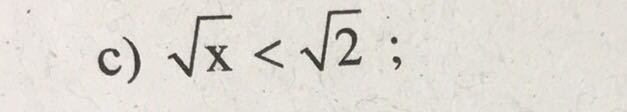

************

PAIRS: 17 - Cosine score: 0.0
-- Number of words: 27


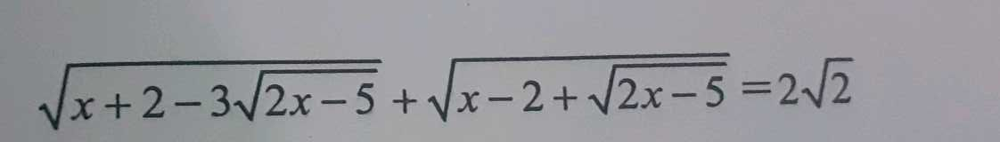

-- Number of words: 31


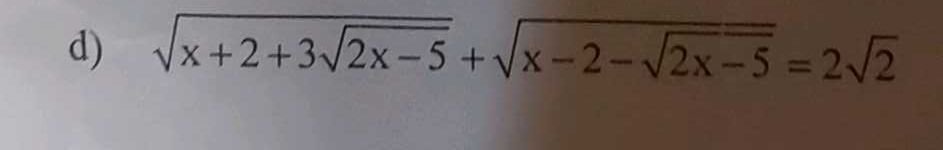

************

PAIRS: 18 - Cosine score: 0.0
-- Number of words: 15


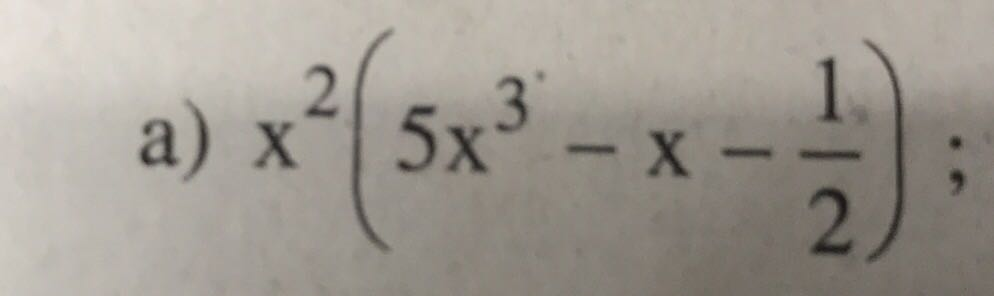

-- Number of words: 19


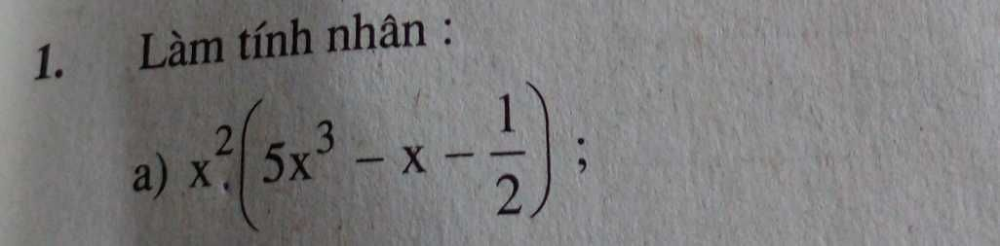

************

PAIRS: 19 - Cosine score: 0.0
-- Number of words: 33


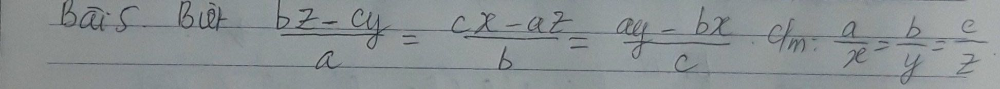

-- Number of words: 72


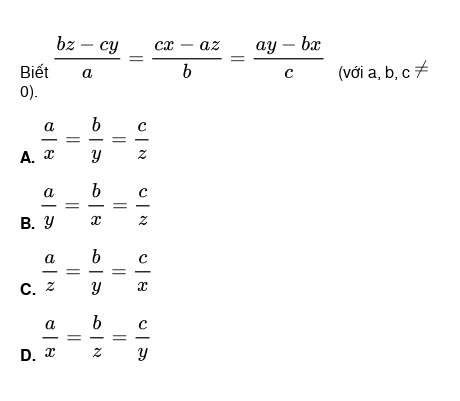

************

PAIRS: 20 - Cosine score: 0.0
-- Number of words: 36


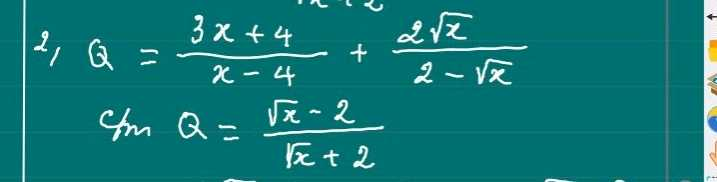

-- Number of words: 36


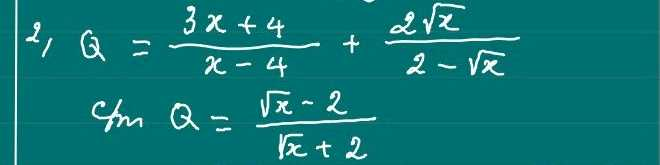

************

PAIRS: 21 - Cosine score: 0.0
-- Number of words: 14


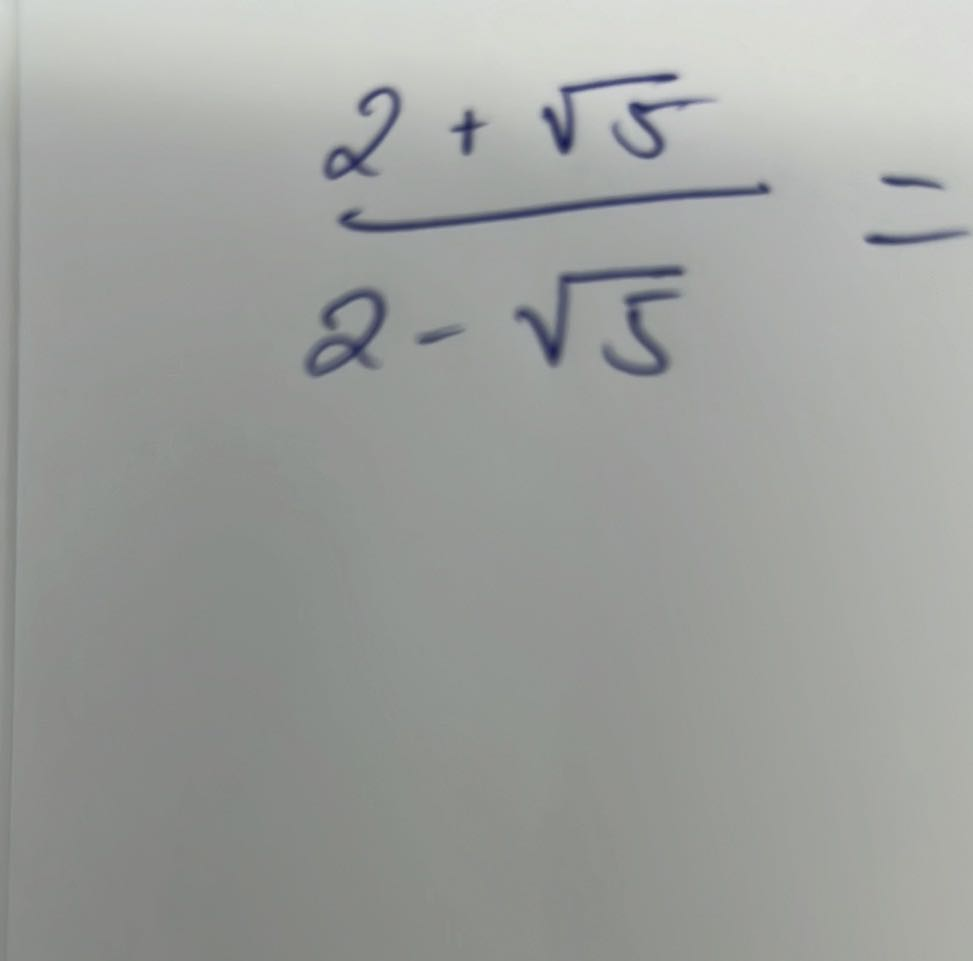

-- Number of words: 14


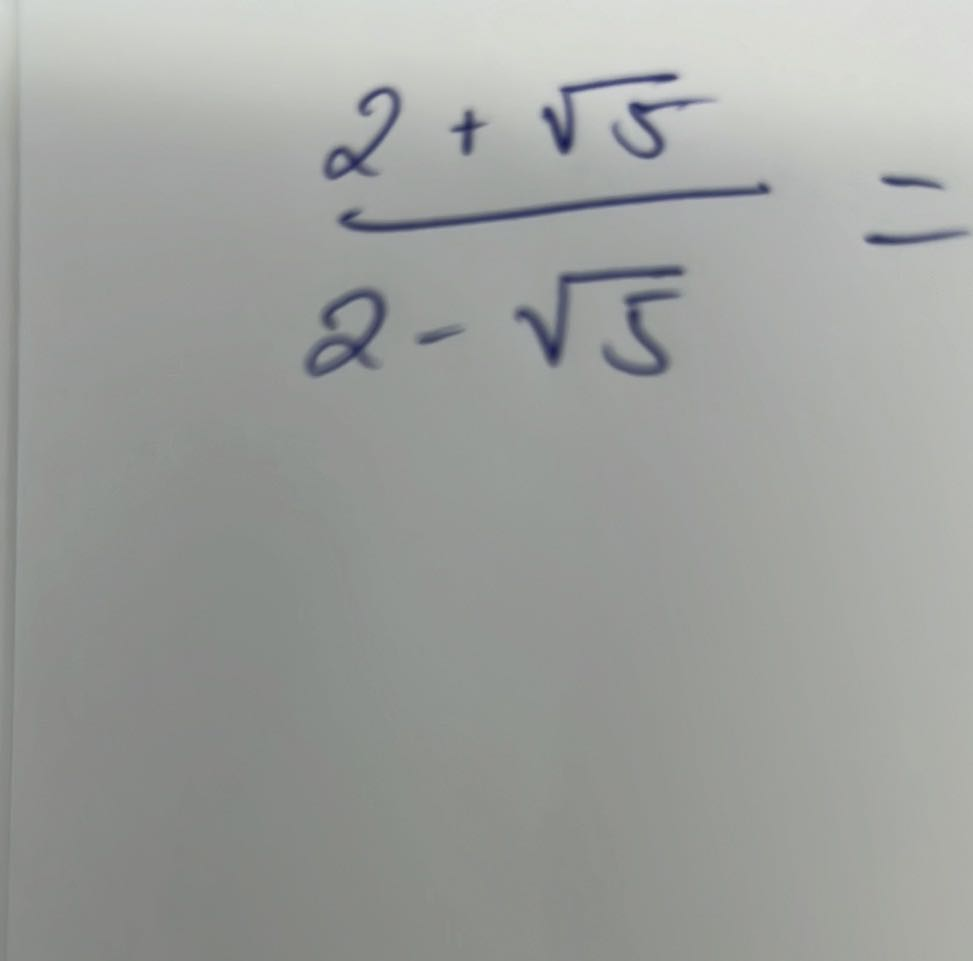

************

PAIRS: 22 - Cosine score: 0.0
-- Number of words: 9


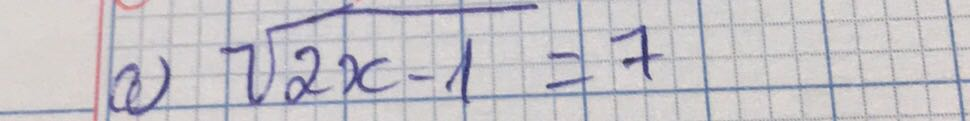

-- Number of words: 34


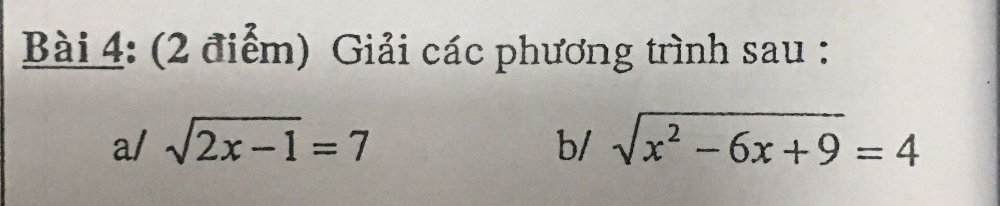

************

PAIRS: 23 - Cosine score: 0.0
-- Number of words: 12


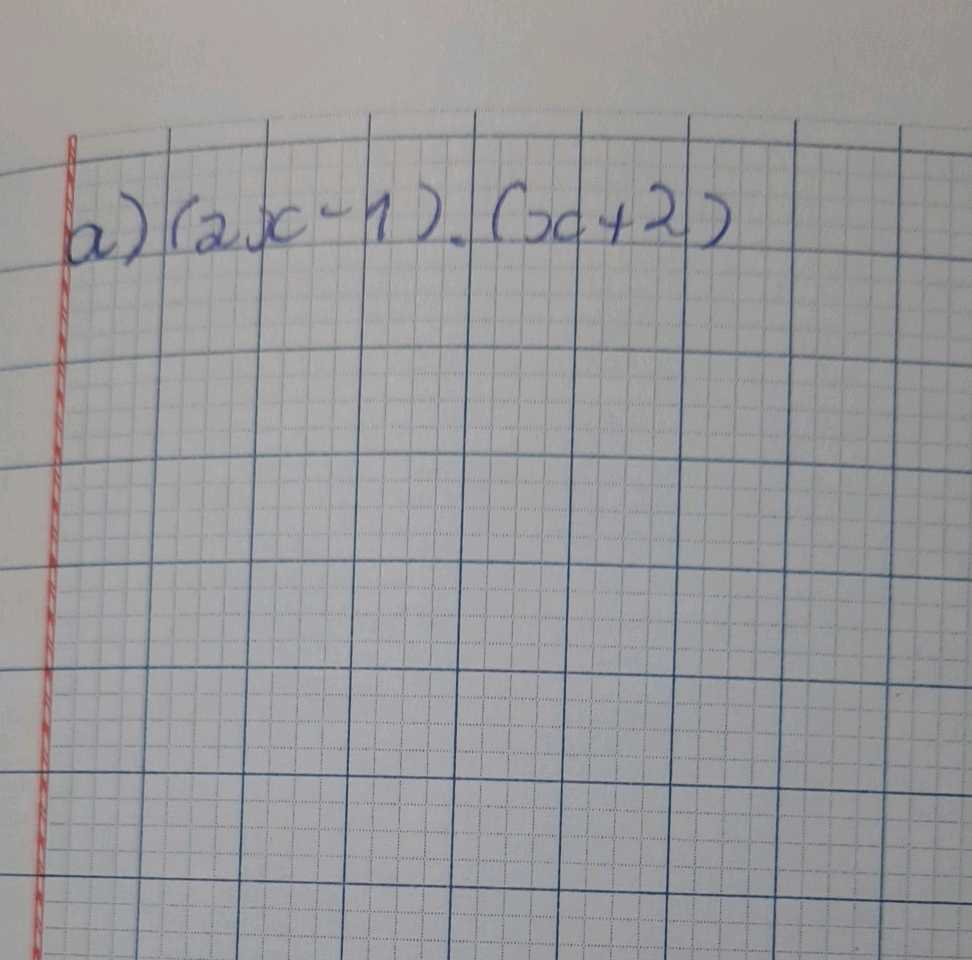

-- Number of words: 12


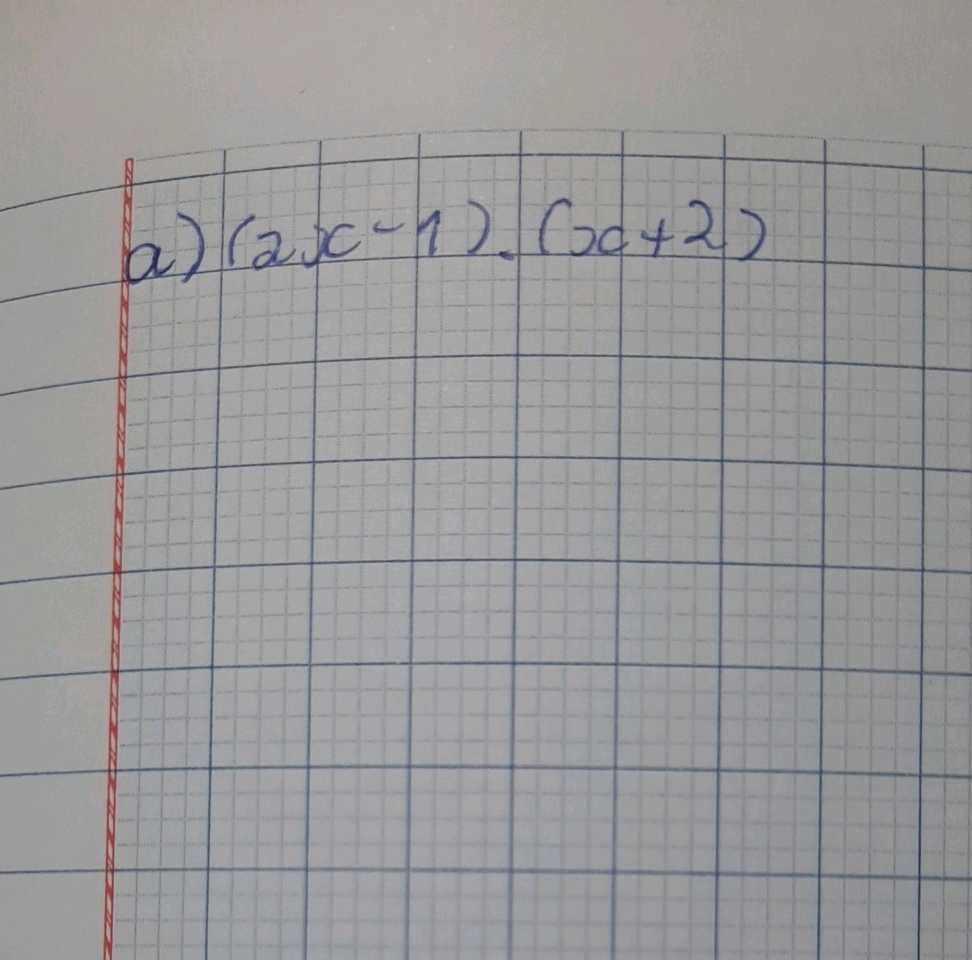

************

PAIRS: 24 - Cosine score: 0.0
-- Number of words: 40


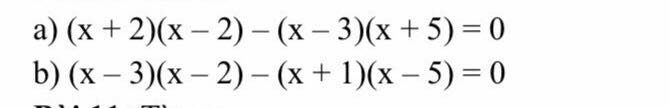

-- Number of words: 46


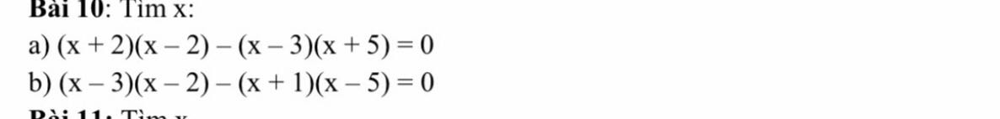

************

PAIRS: 25 - Cosine score: 0.0
-- Number of words: 17


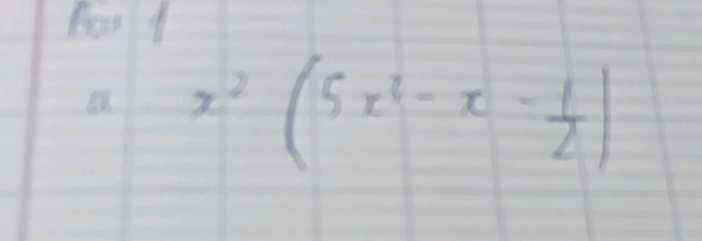

-- Number of words: 19


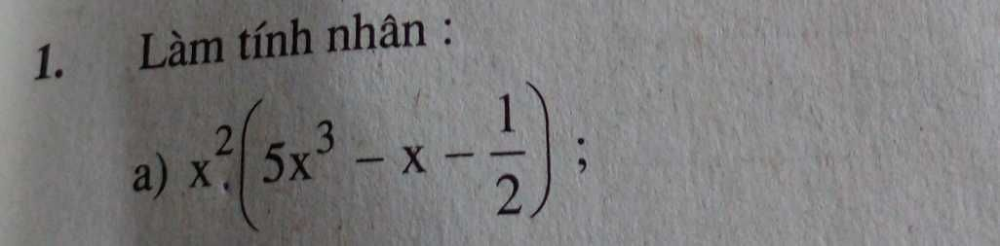

************

PAIRS: 26 - Cosine score: 0.0
-- Number of words: 15


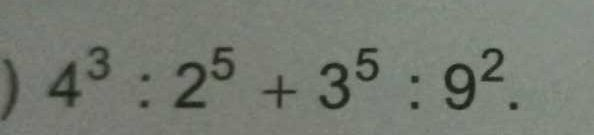

-- Number of words: 17


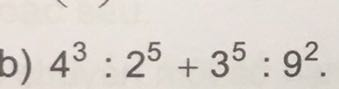

************

PAIRS: 27 - Cosine score: 0.0
-- Number of words: 8


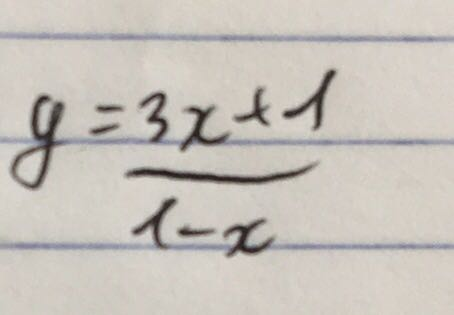

-- Number of words: 21


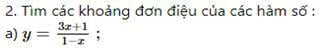

************

PAIRS: 28 - Cosine score: 0.0
-- Number of words: 12


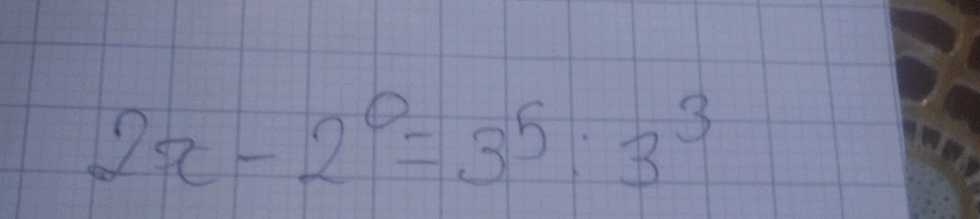

-- Number of words: 14


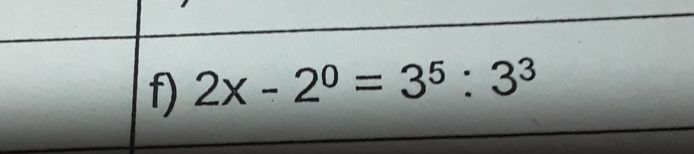

************

PAIRS: 29 - Cosine score: 0.03741806998076388
-- Number of words: 7


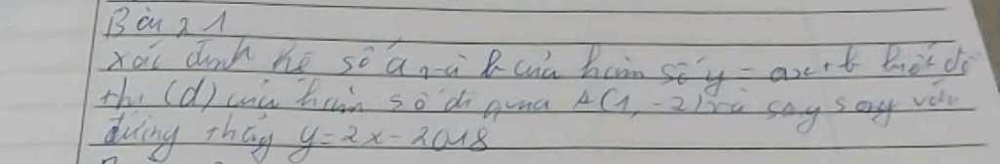

-- Number of words: 48


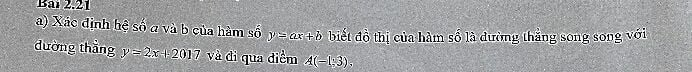

************

PAIRS: 30 - Cosine score: 0.11741768401661691
-- Number of words: 35


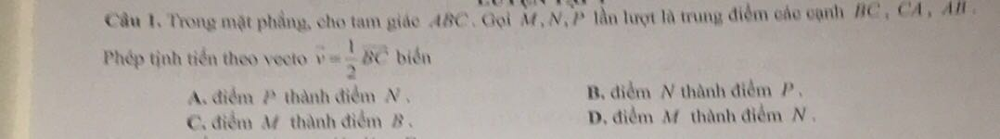

-- Number of words: 71


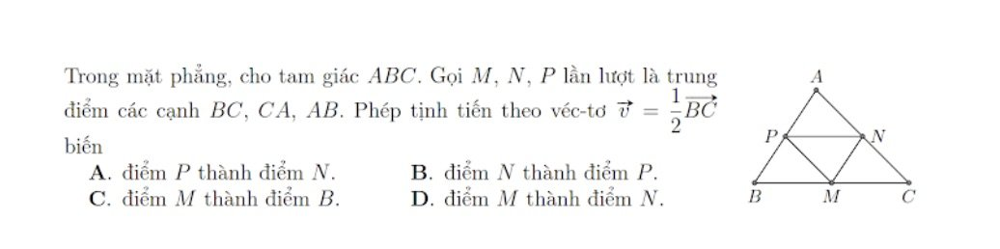

************

PAIRS: 31 - Cosine score: 0.12692563296224368
-- Number of words: 66


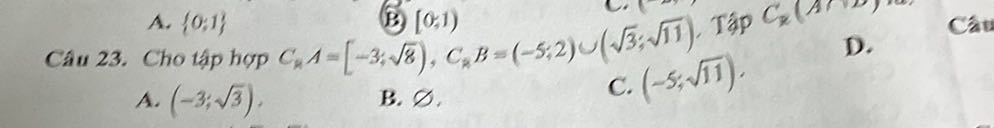

-- Number of words: 96


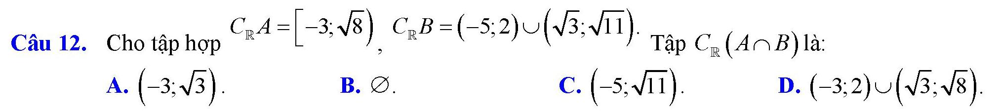

************

PAIRS: 32 - Cosine score: 0.14703291925846648
-- Number of words: 96


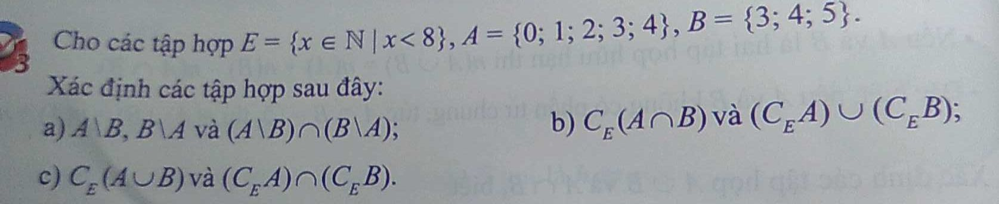

-- Number of words: 95


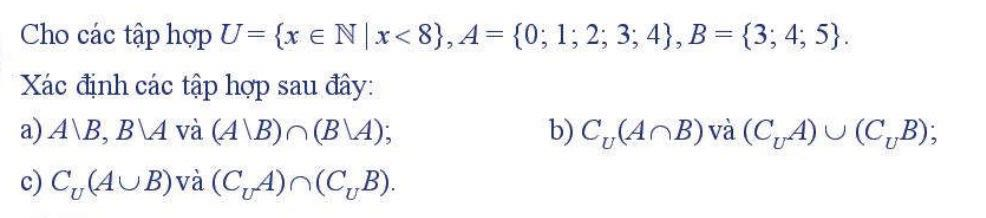

************

PAIRS: 33 - Cosine score: 0.1472026657154009
-- Number of words: 102


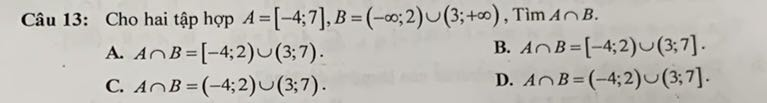

-- Number of words: 92


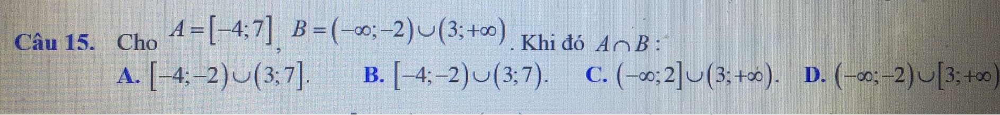

************

PAIRS: 34 - Cosine score: 0.19037073030138124
-- Number of words: 22


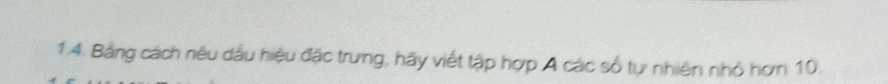

-- Number of words: 23


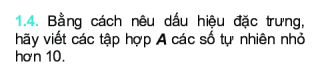

************

PAIRS: 35 - Cosine score: 0.20903357168665432
-- Number of words: 36


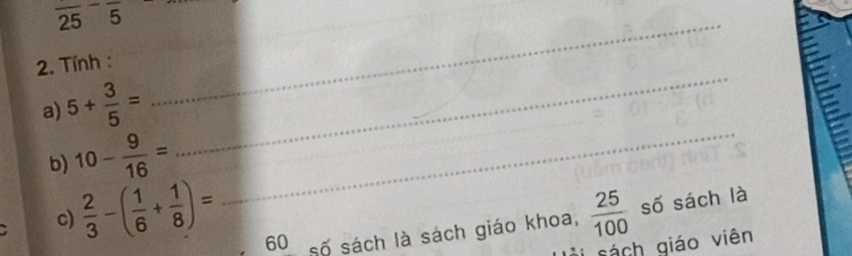

-- Number of words: 60


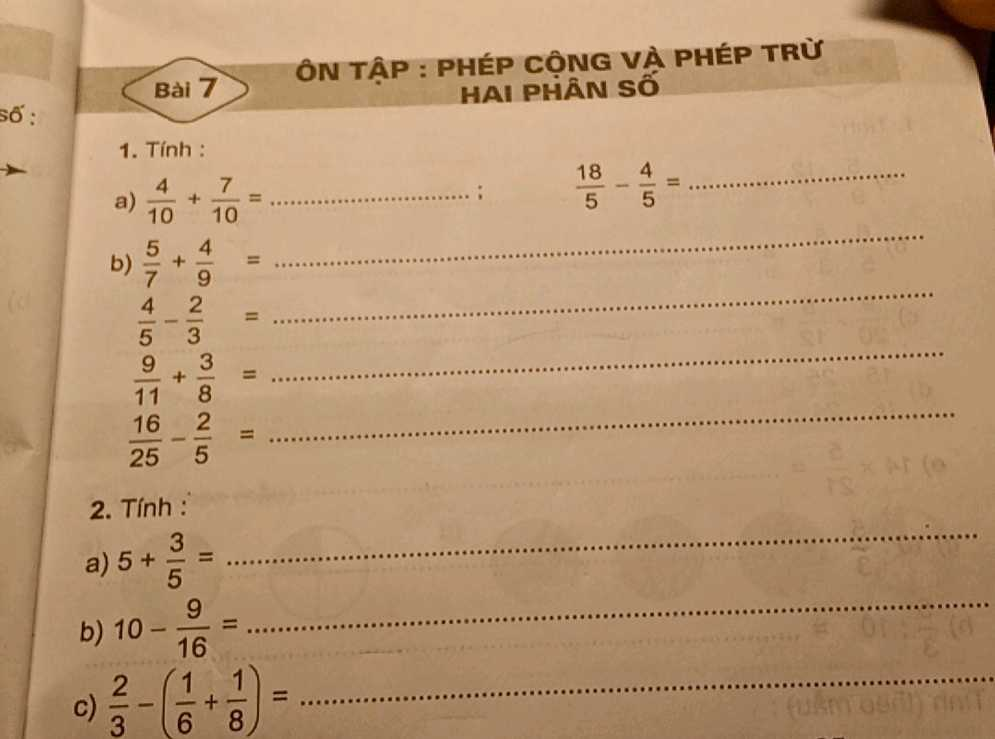

************

PAIRS: 36 - Cosine score: 0.21834441480505318
-- Number of words: 67


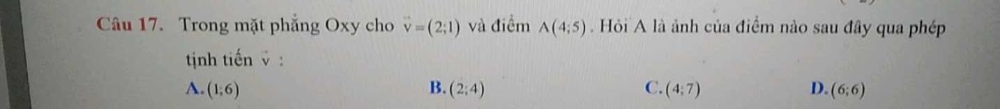

-- Number of words: 72


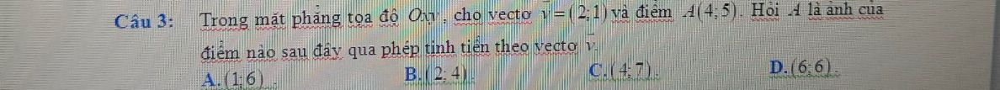

************

PAIRS: 37 - Cosine score: 0.23096384816060905
-- Number of words: 51


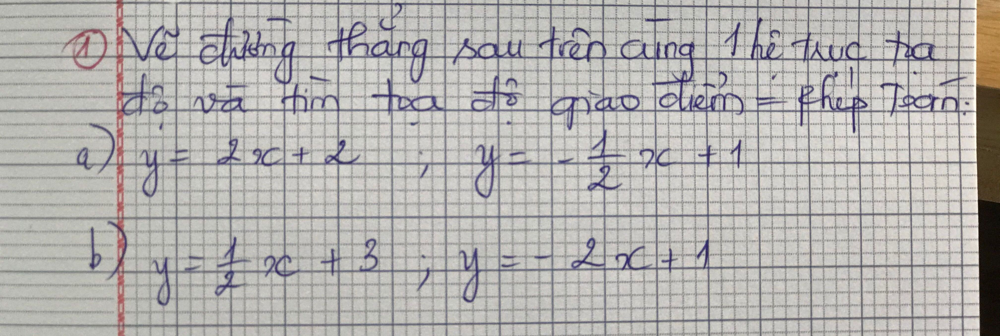

-- Number of words: 57


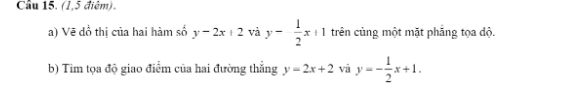

************

PAIRS: 38 - Cosine score: 0.24334670726656996
-- Number of words: 55


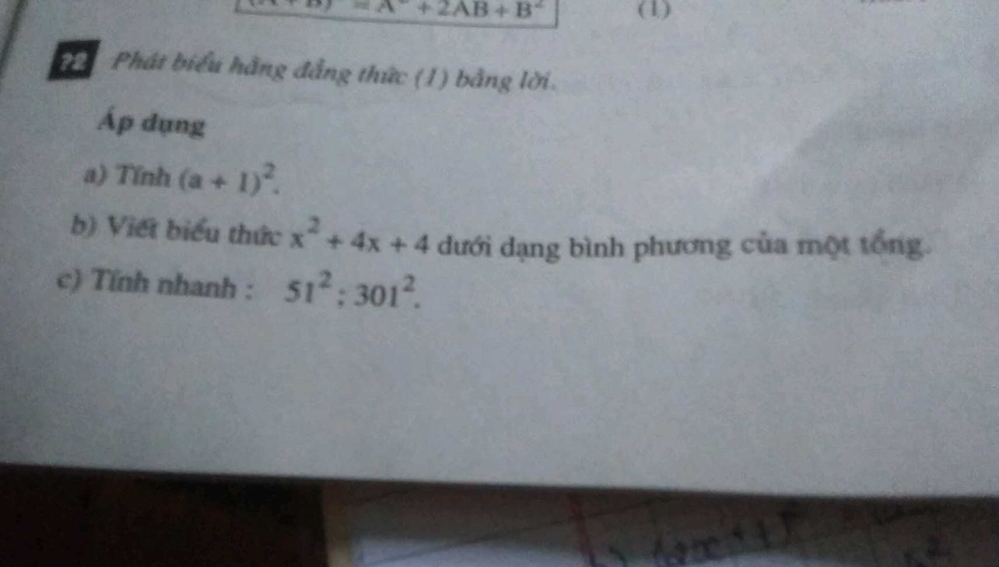

-- Number of words: 44


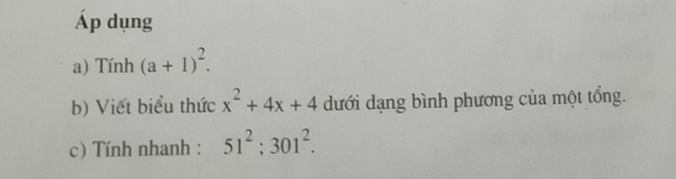

************

PAIRS: 39 - Cosine score: 0.2519374964891701
-- Number of words: 51


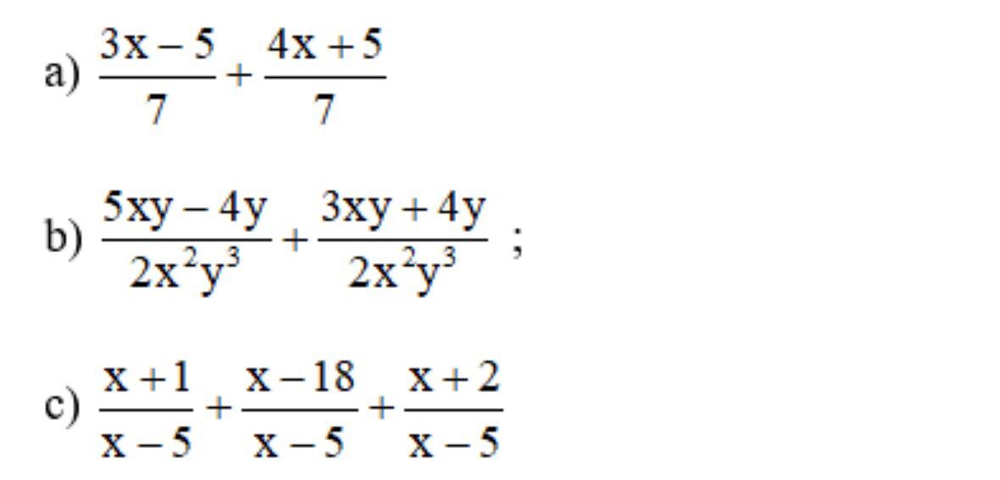

-- Number of words: 61


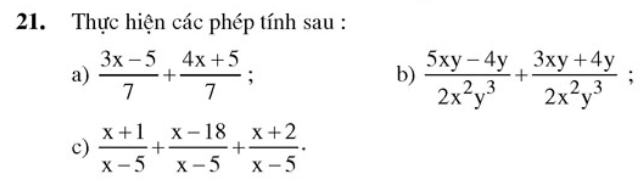

************

PAIRS: 40 - Cosine score: 0.28043676034860093
-- Number of words: 25


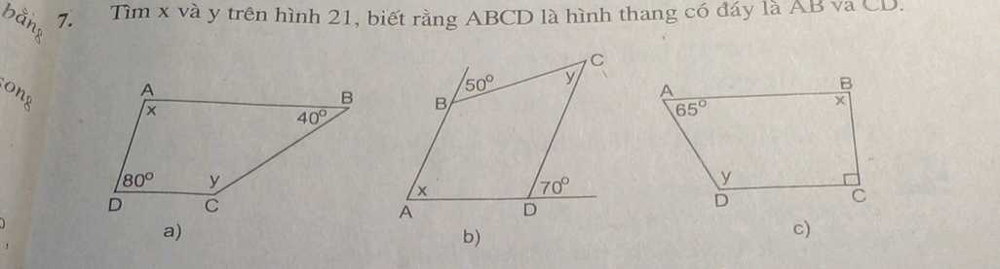

-- Number of words: 28


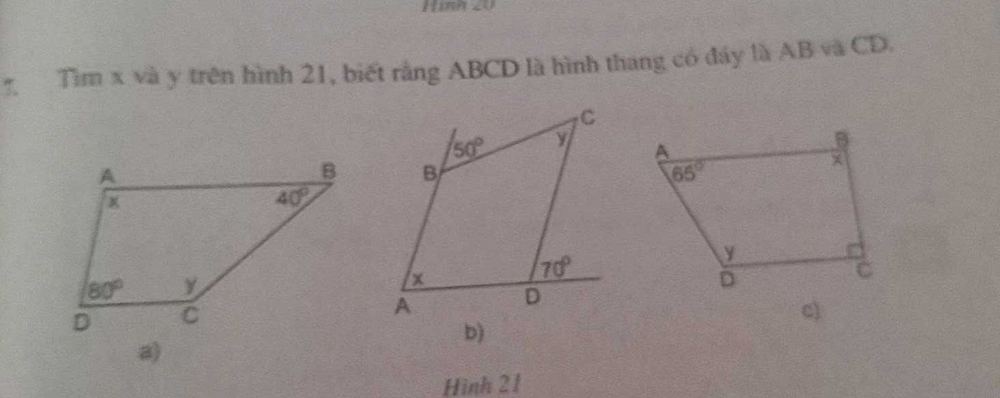

************

PAIRS: 41 - Cosine score: 0.3091767344469956
-- Number of words: 79


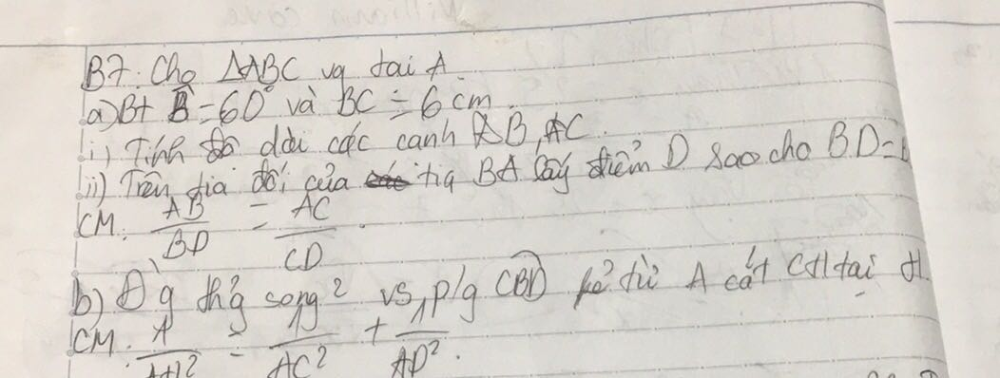

-- Number of words: 106


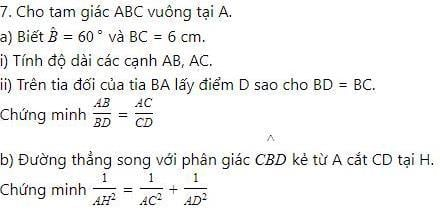

************

PAIRS: 42 - Cosine score: 0.3181691157875187
-- Number of words: 26


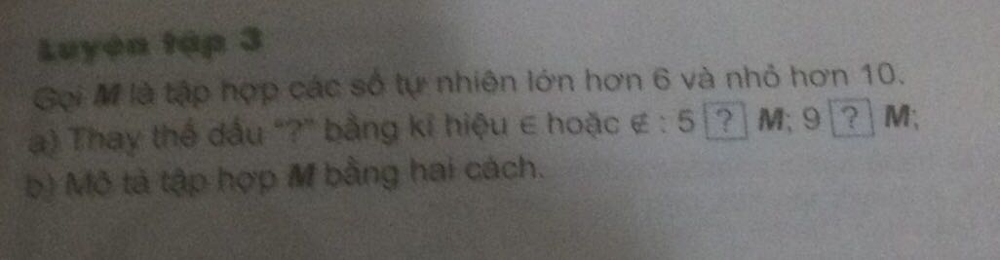

-- Number of words: 49


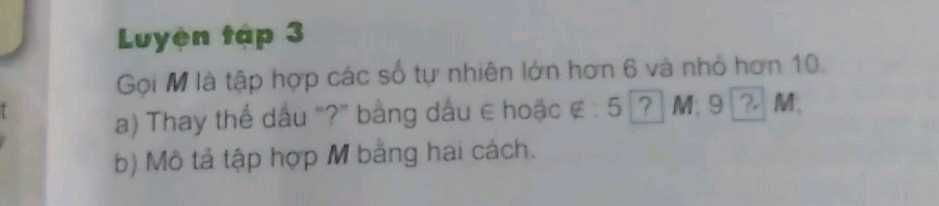

************

PAIRS: 43 - Cosine score: 0.3294280391215736
-- Number of words: 64


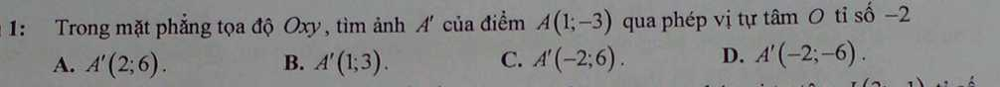

-- Number of words: 71


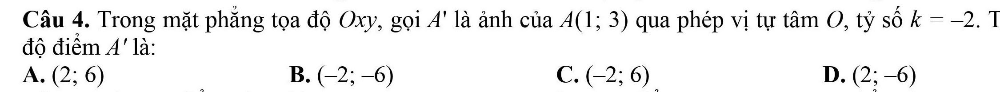

************

PAIRS: 44 - Cosine score: 0.33465200451459043
-- Number of words: 39


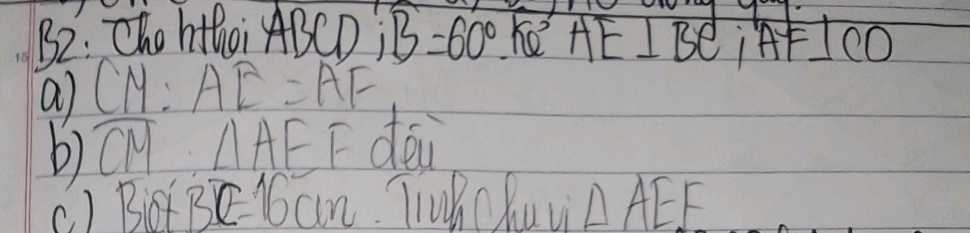

-- Number of words: 55


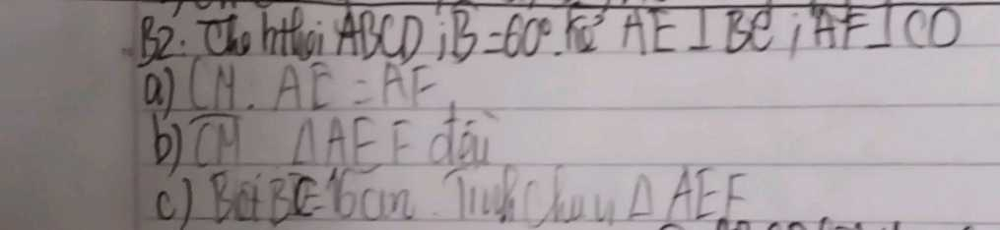

************

PAIRS: 45 - Cosine score: 0.33526594601890114
-- Number of words: 40


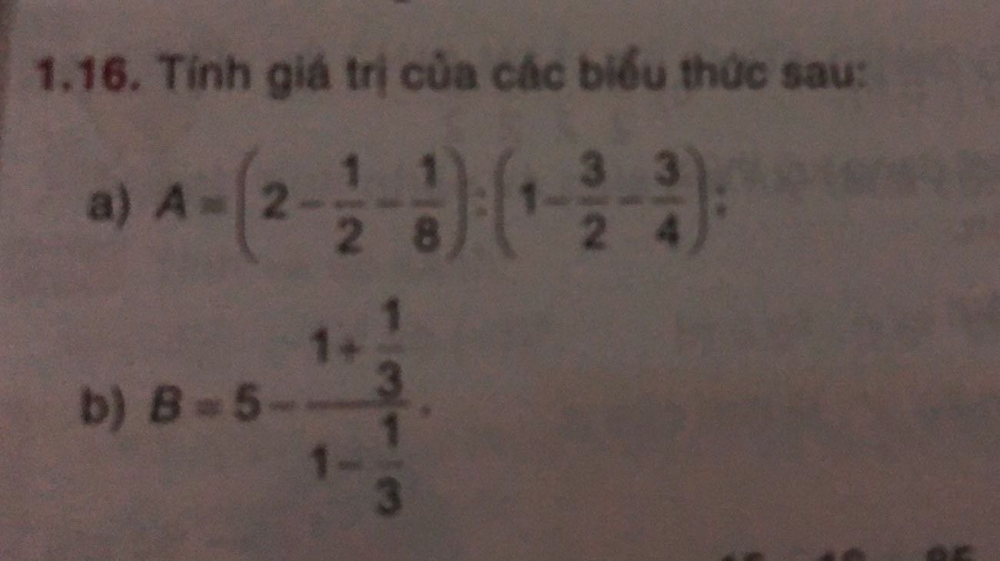

-- Number of words: 39


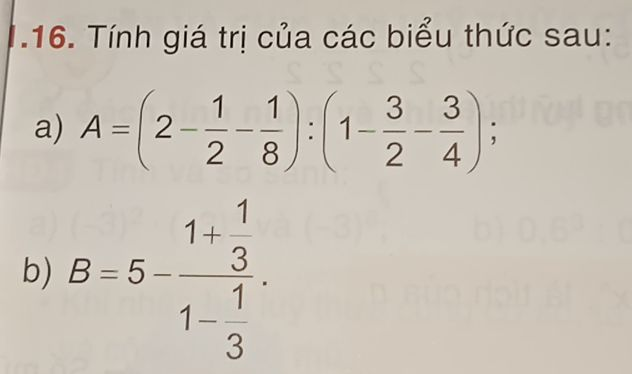

************

PAIRS: 46 - Cosine score: 0.3415960158741274
-- Number of words: 31


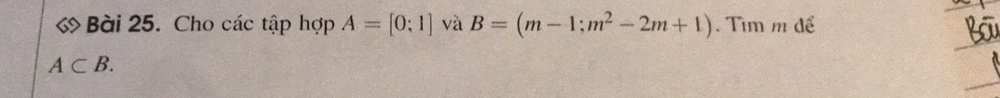

-- Number of words: 33


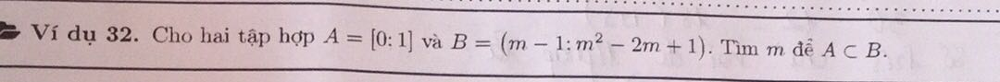

************

PAIRS: 47 - Cosine score: 0.3425290632018527
-- Number of words: 37


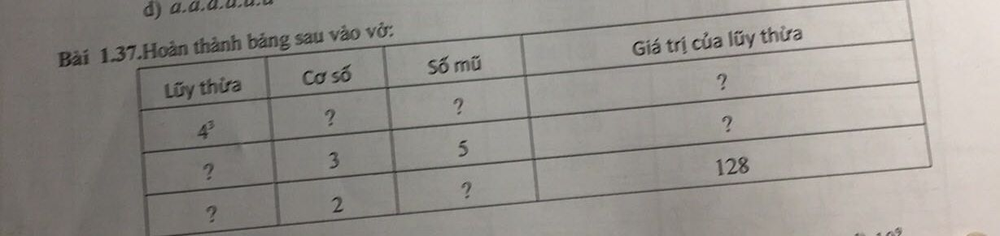

-- Number of words: 34


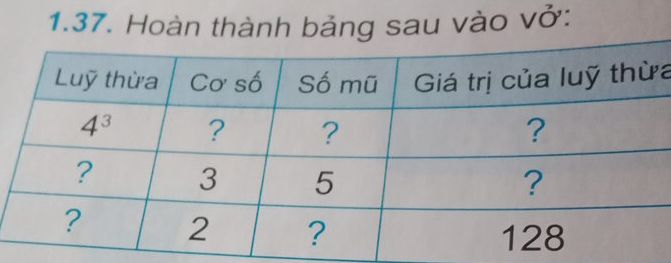

************

PAIRS: 48 - Cosine score: 0.35749028298951785
-- Number of words: 52


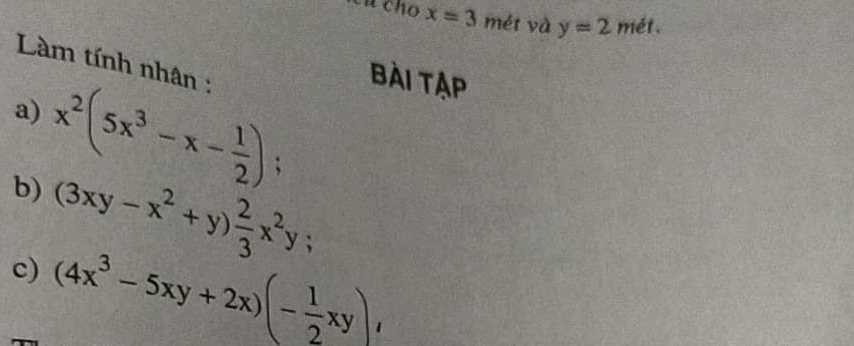

-- Number of words: 54


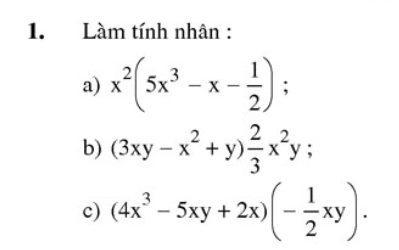

************

PAIRS: 49 - Cosine score: 0.36775520261803635
-- Number of words: 82


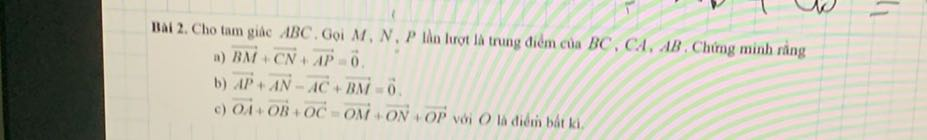

-- Number of words: 85


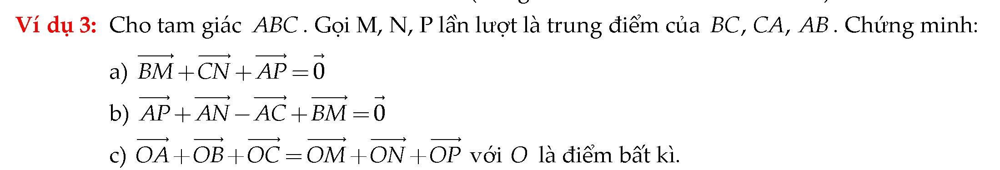

************

PAIRS: 50 - Cosine score: 0.3772103850666852
-- Number of words: 29


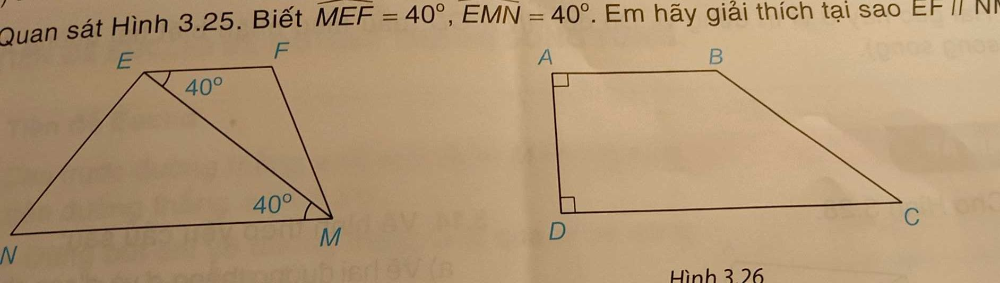

-- Number of words: 43


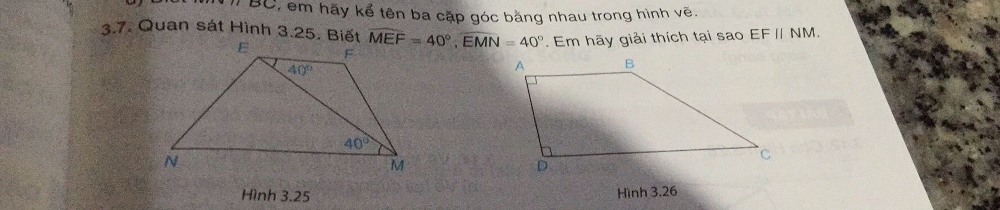

************

PAIRS: 51 - Cosine score: 0.38121245698427253
-- Number of words: 16


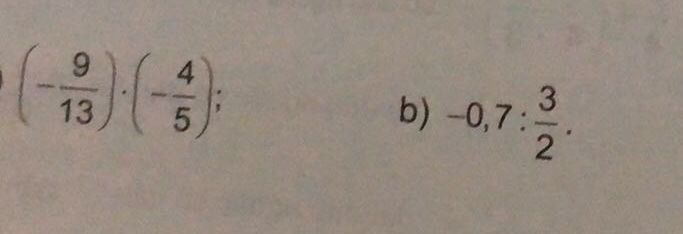

-- Number of words: 28


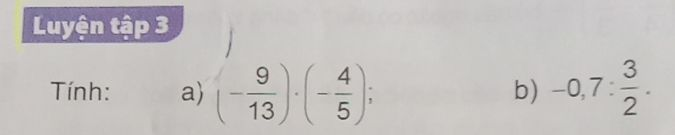

************

PAIRS: 52 - Cosine score: 0.39017966943379456
-- Number of words: 82


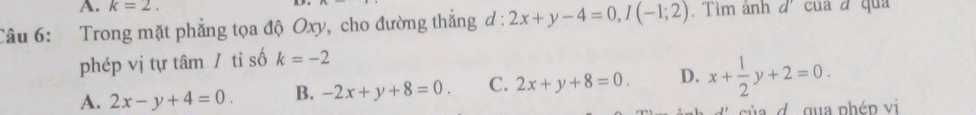

-- Number of words: 109


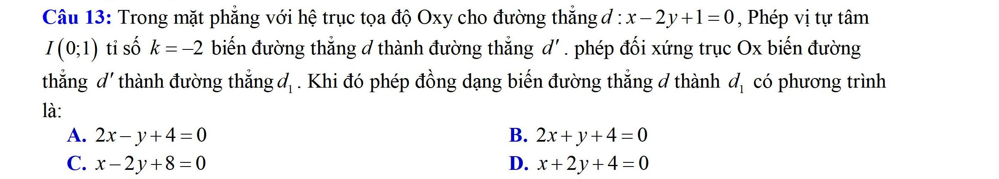

************

PAIRS: 53 - Cosine score: 0.401484327150483
-- Number of words: 18


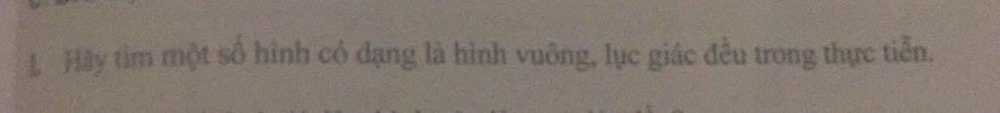

-- Number of words: 18


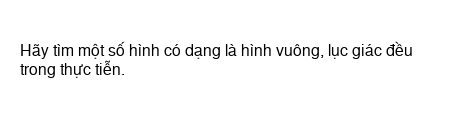

************

PAIRS: 54 - Cosine score: 0.40868632460886034
-- Number of words: 59


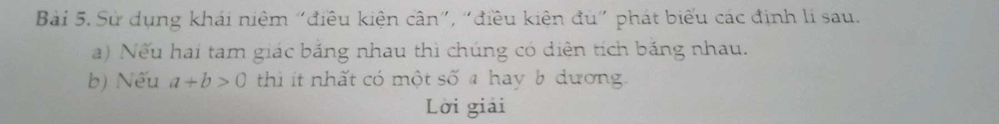

-- Number of words: 58


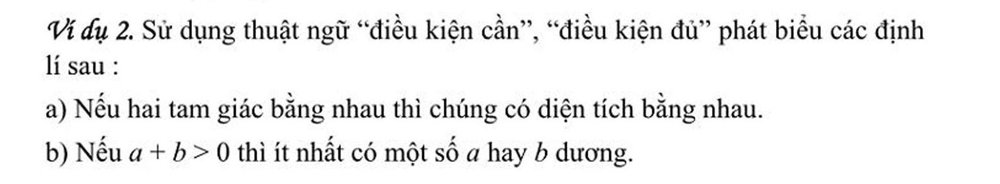

************

PAIRS: 55 - Cosine score: 0.4103862952884108
-- Number of words: 82


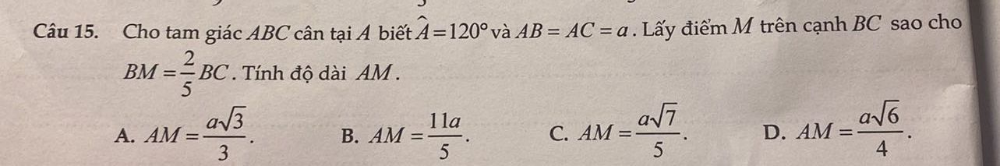

-- Number of words: 79


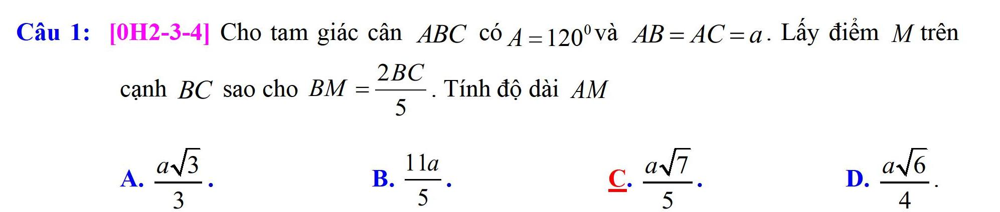

************

PAIRS: 56 - Cosine score: 0.41936566791410523
-- Number of words: 59


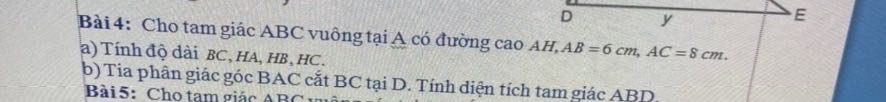

-- Number of words: 50


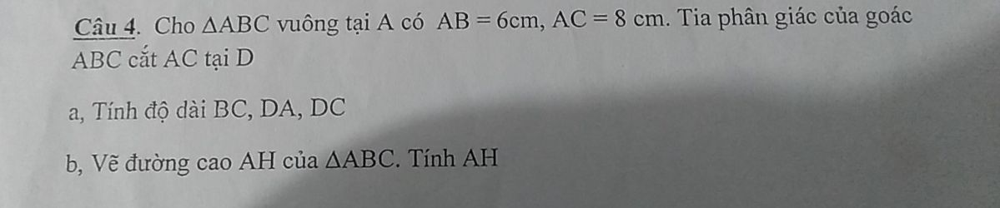

************

PAIRS: 57 - Cosine score: 0.42617006070955443
-- Number of words: 73


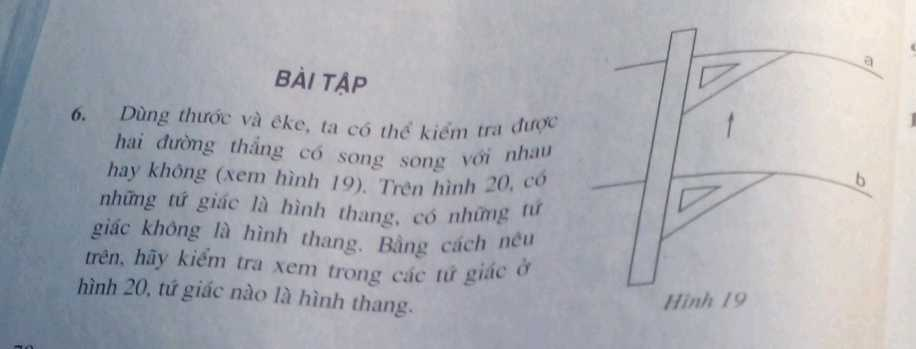

-- Number of words: 66


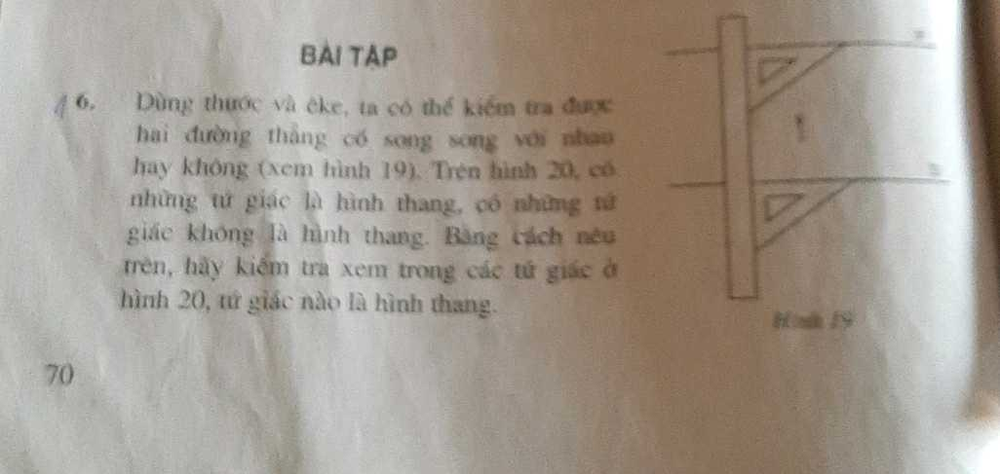

************

PAIRS: 58 - Cosine score: 0.4276185384272543
-- Number of words: 24


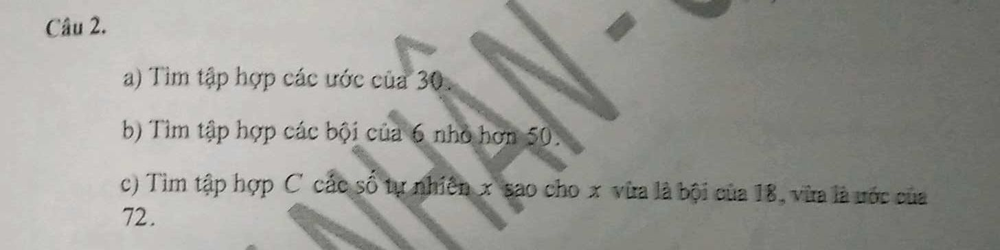

-- Number of words: 47


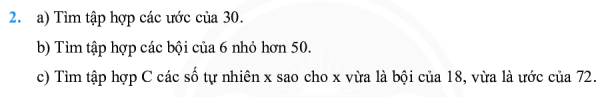

************

PAIRS: 59 - Cosine score: 0.43520258757459845
-- Number of words: 40


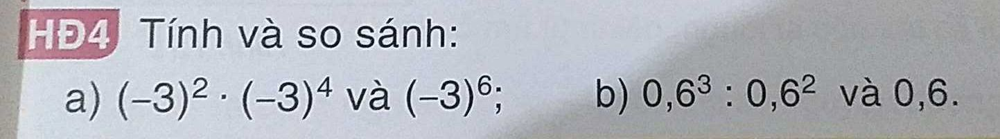

-- Number of words: 40


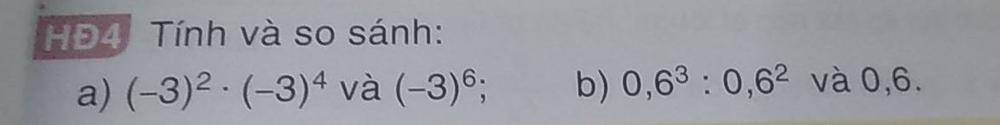

************

PAIRS: 60 - Cosine score: 0.44033659557376703
-- Number of words: 62


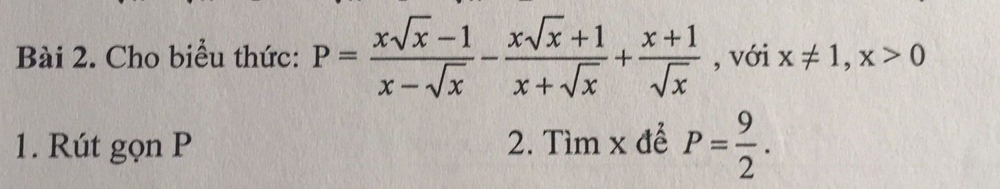

-- Number of words: 65


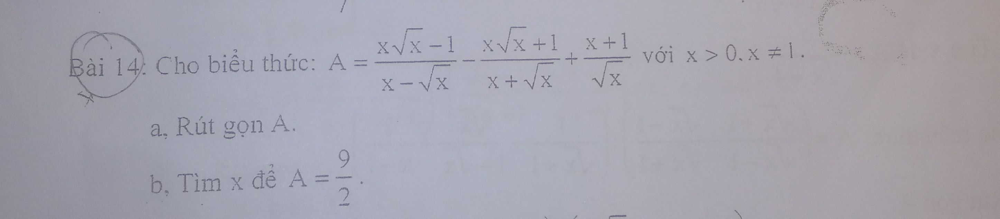

************

PAIRS: 61 - Cosine score: 0.44336219891995937
-- Number of words: 20


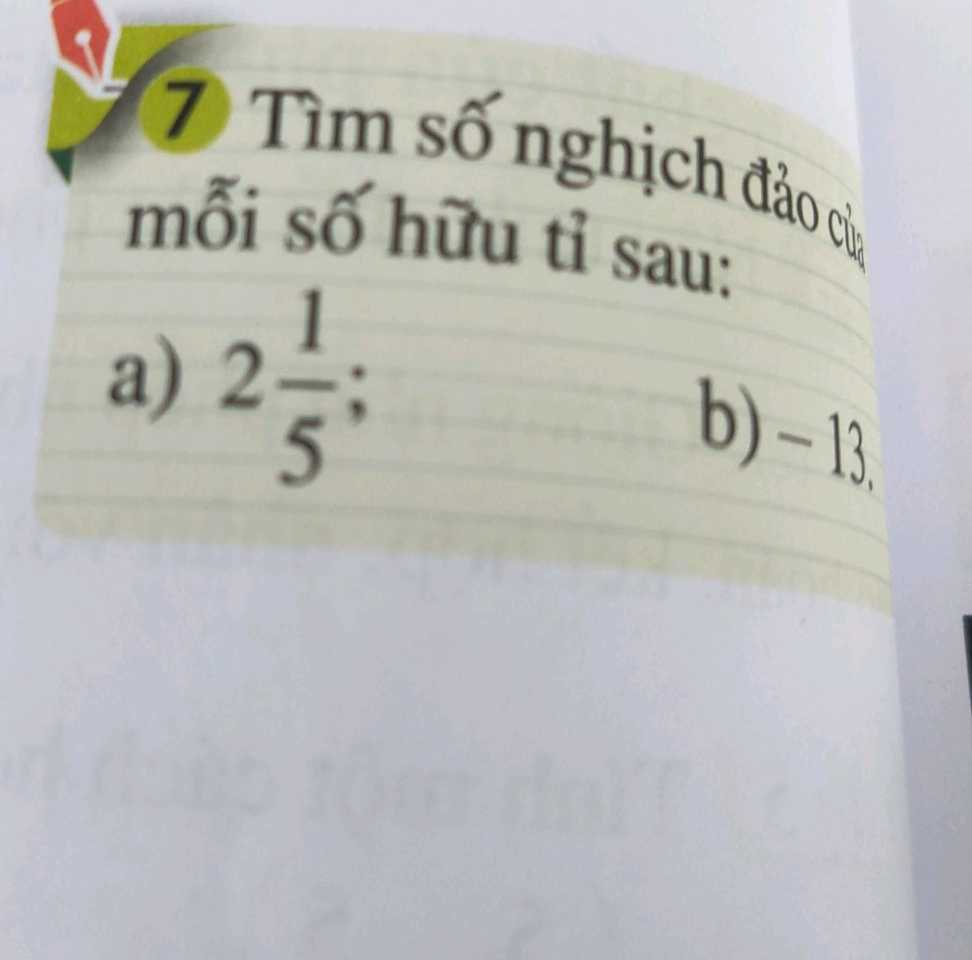

-- Number of words: 23


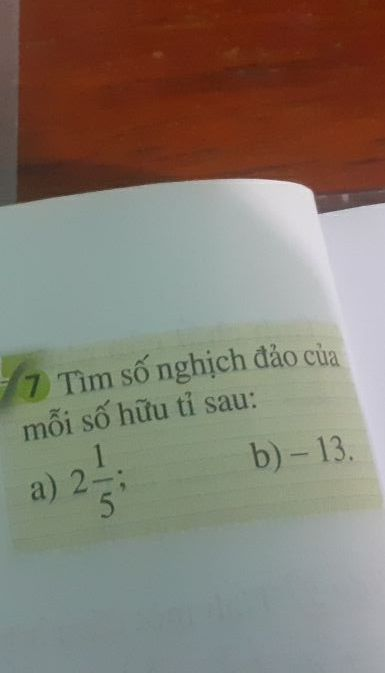

************

PAIRS: 62 - Cosine score: 0.45246935521315185
-- Number of words: 17


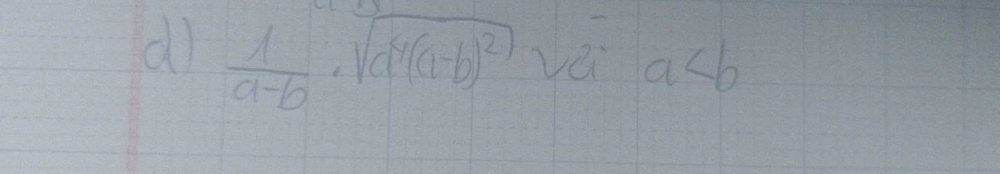

-- Number of words: 21


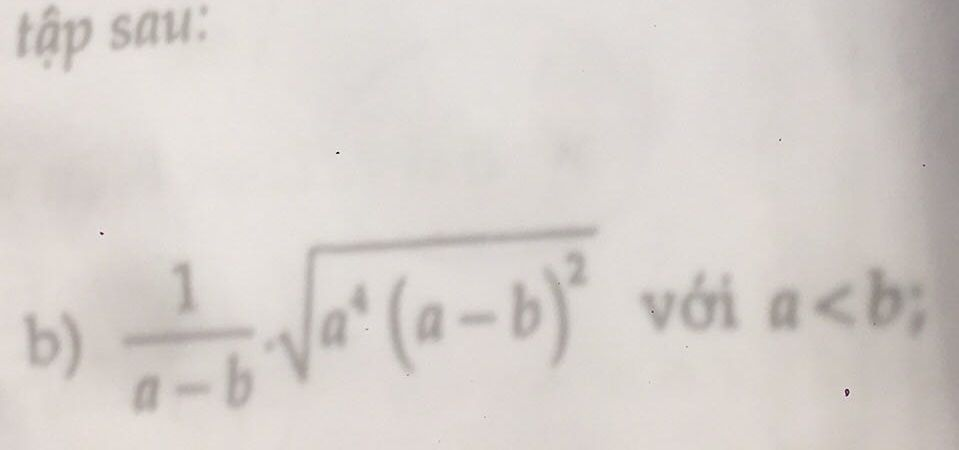

************

PAIRS: 63 - Cosine score: 0.453622896785641
-- Number of words: 14


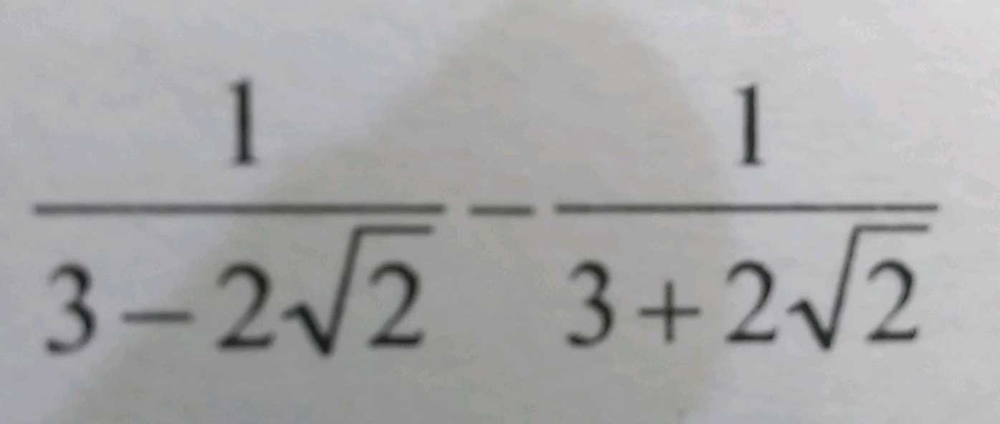

-- Number of words: 15


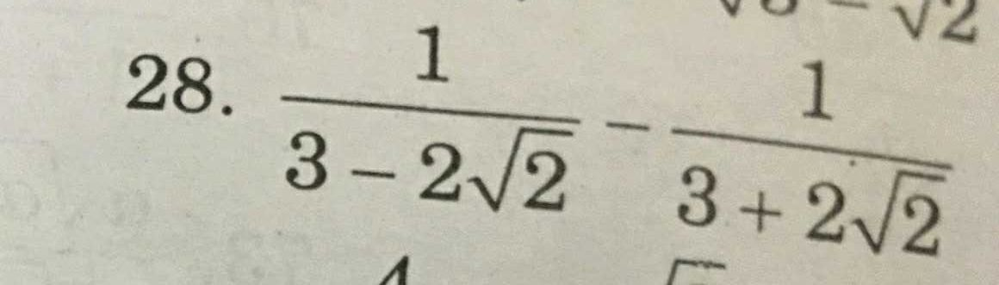

************

PAIRS: 64 - Cosine score: 0.4682541028302115
-- Number of words: 35


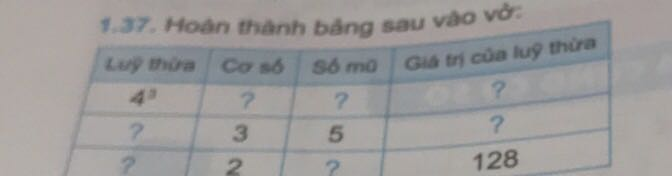

-- Number of words: 40


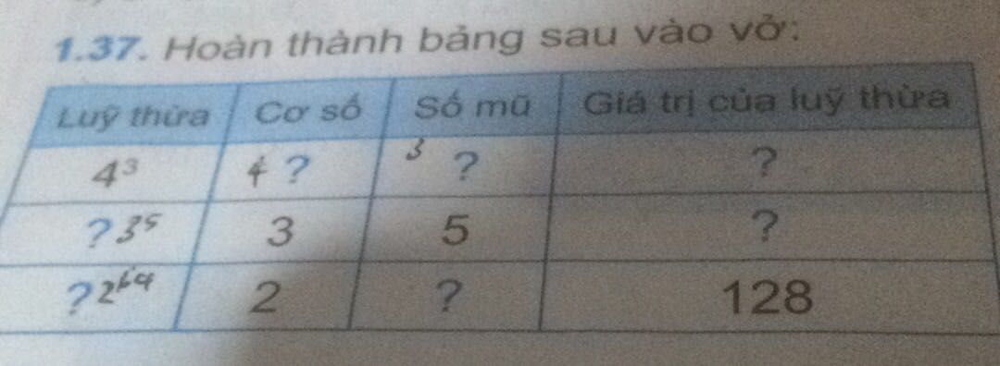

************

PAIRS: 65 - Cosine score: 0.47011373426526515
-- Number of words: 53


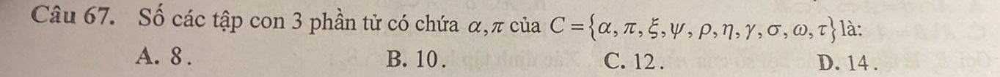

-- Number of words: 46


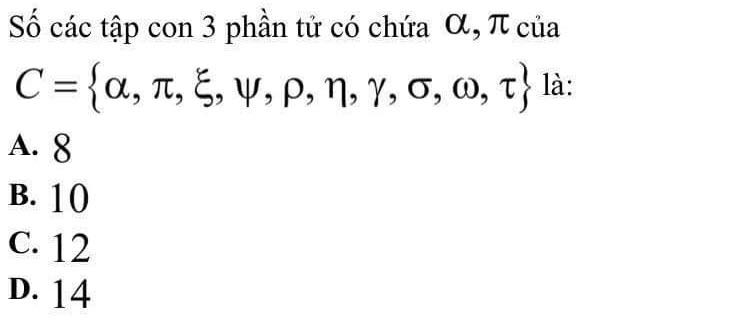

************

PAIRS: 66 - Cosine score: 0.4729930954671967
-- Number of words: 17


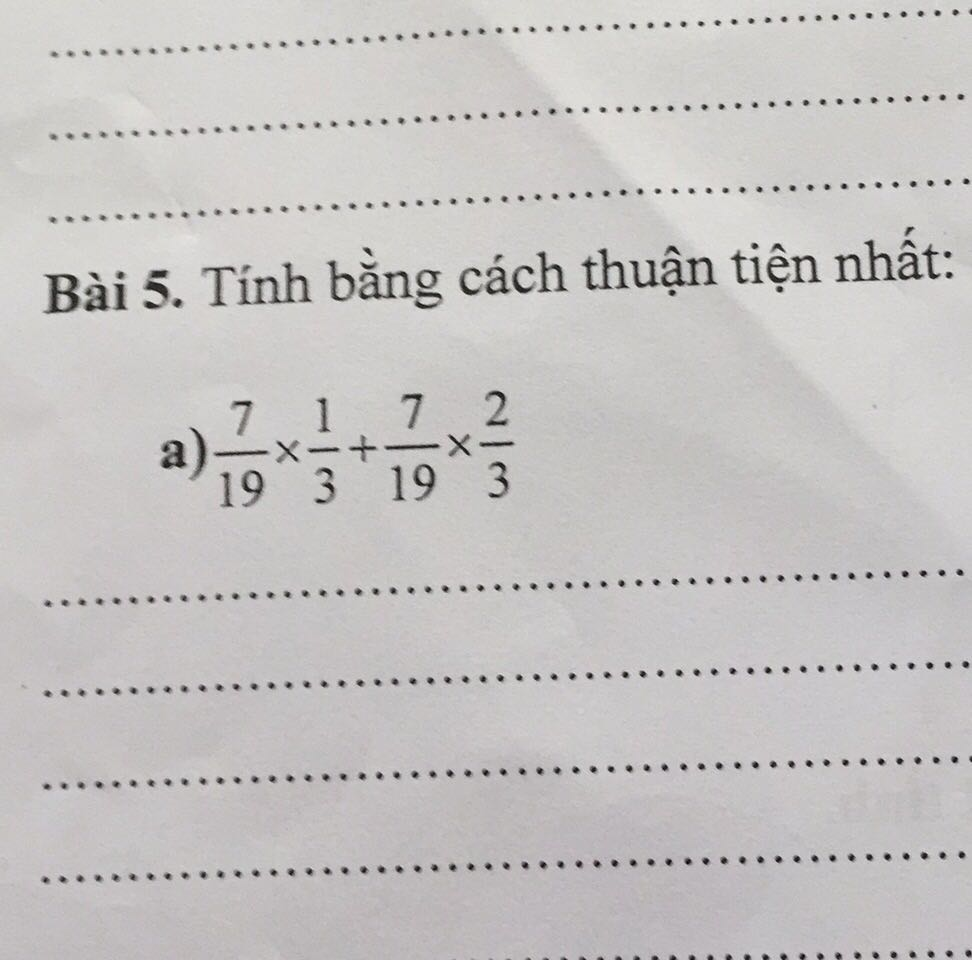

-- Number of words: 25


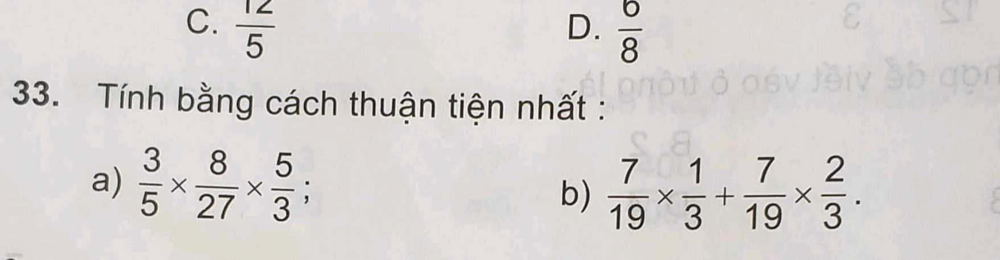

************

PAIRS: 67 - Cosine score: 0.4737317234302388
-- Number of words: 49


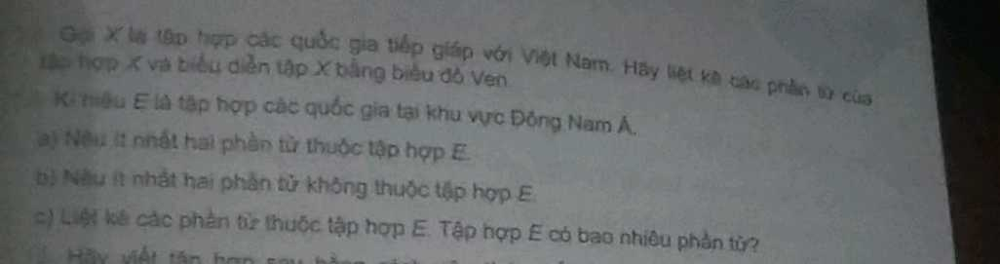

-- Number of words: 96


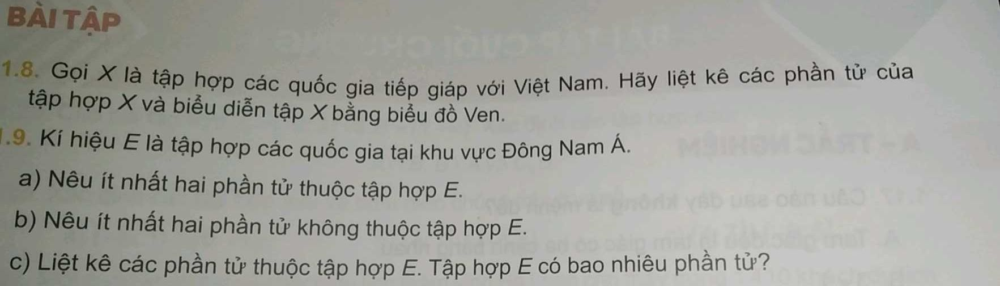

************

PAIRS: 68 - Cosine score: 0.48426412319173084
-- Number of words: 52


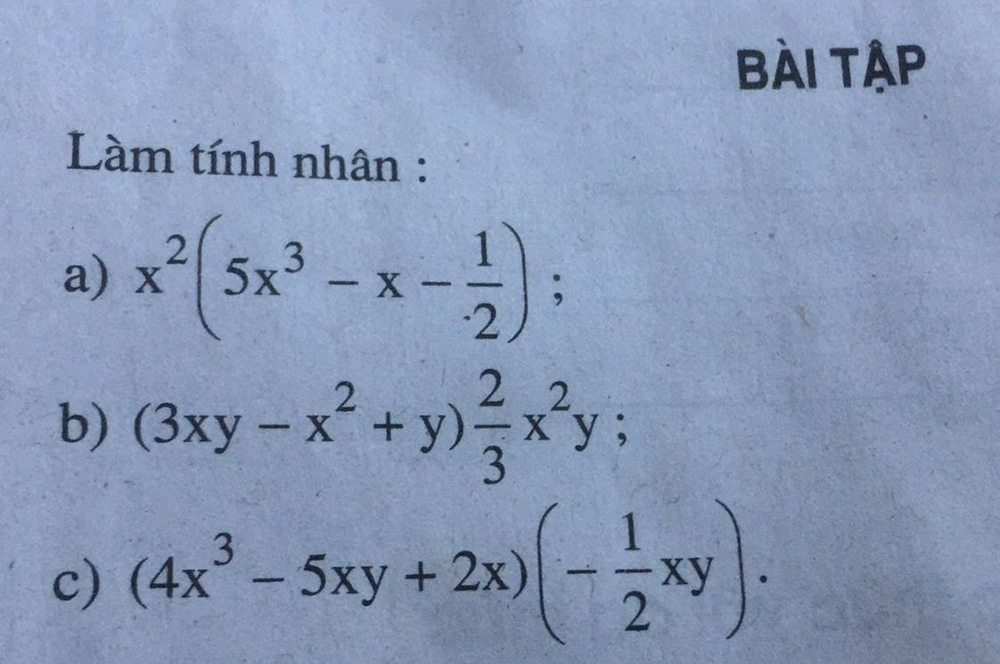

-- Number of words: 57


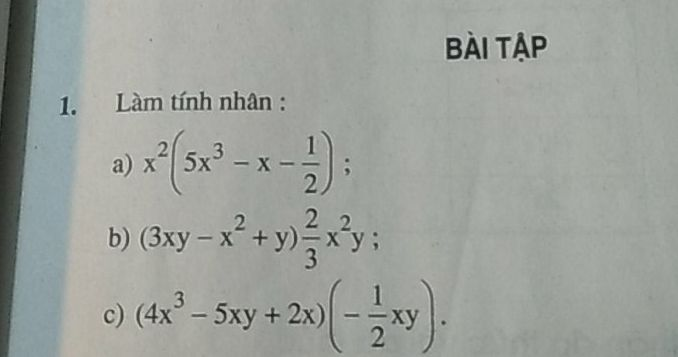

************

PAIRS: 69 - Cosine score: 0.48907614487876605
-- Number of words: 13


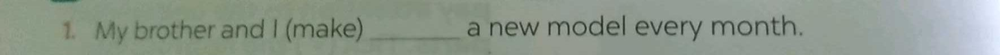

-- Number of words: 68


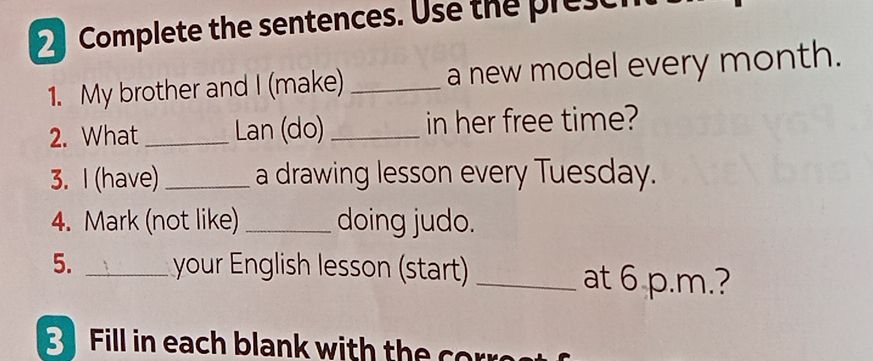

************

PAIRS: 70 - Cosine score: 0.4934181248188819
-- Number of words: 24


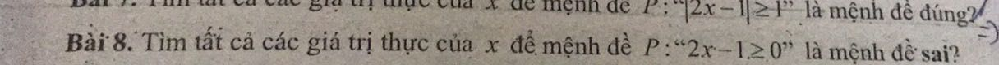

-- Number of words: 22


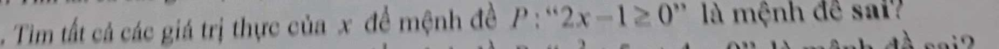

************

PAIRS: 71 - Cosine score: 0.5027485329855715
-- Number of words: 65


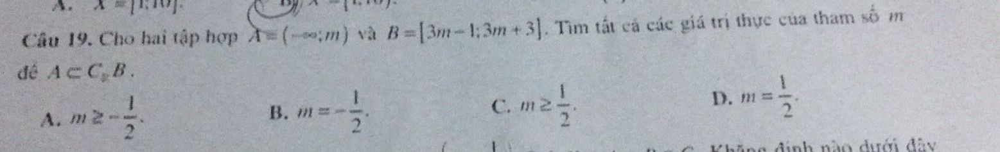

-- Number of words: 61


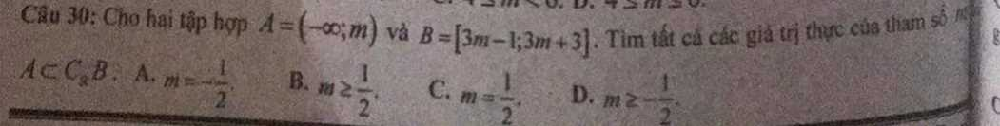

************

PAIRS: 72 - Cosine score: 0.5073093229889649
-- Number of words: 62


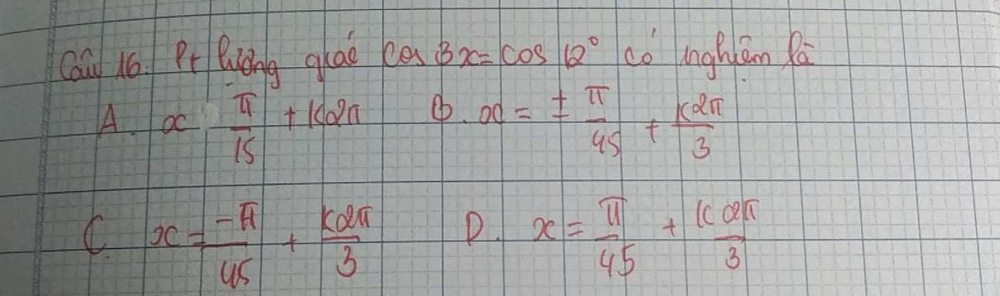

-- Number of words: 68


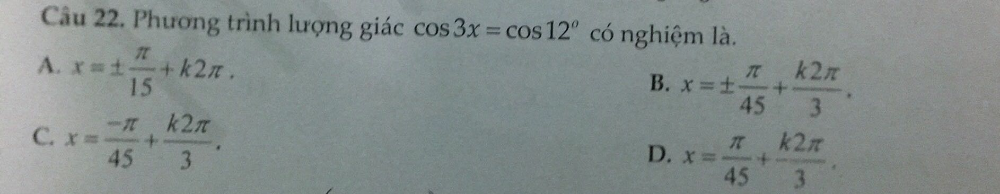

************

PAIRS: 73 - Cosine score: 0.5132313874249291
-- Number of words: 57


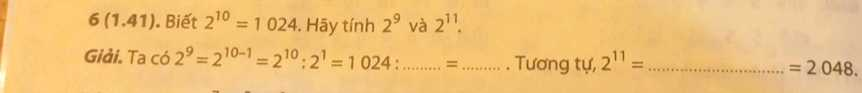

-- Number of words: 148


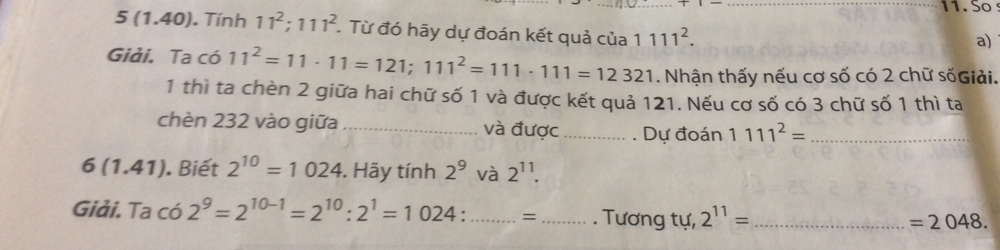

************

PAIRS: 74 - Cosine score: 0.5200113005010805
-- Number of words: 13


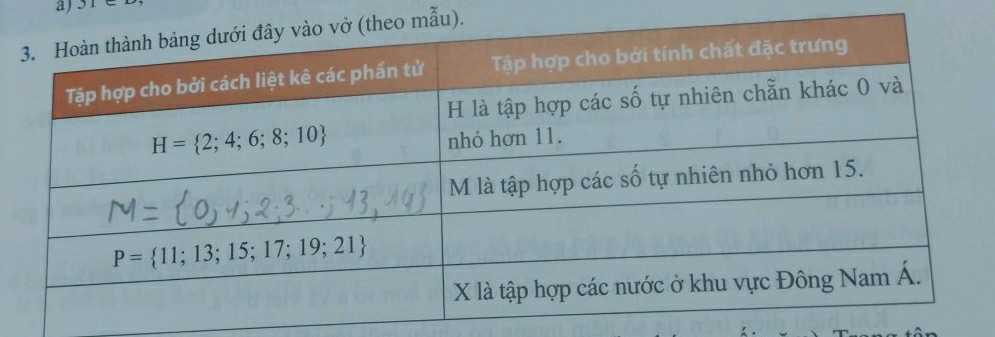

-- Number of words: 38


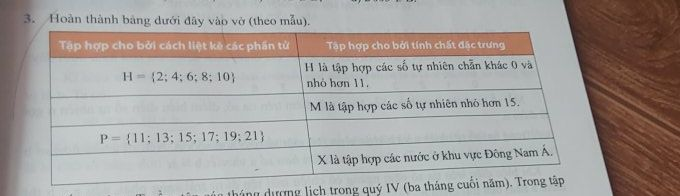

************

PAIRS: 75 - Cosine score: 0.5239502463452156
-- Number of words: 82


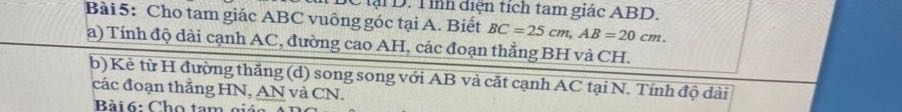

-- Number of words: 62


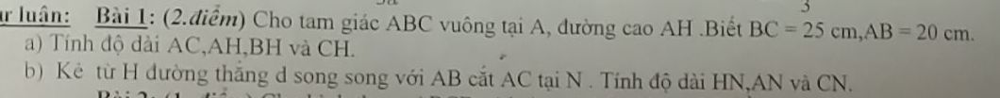

************

PAIRS: 76 - Cosine score: 0.5245336378761162
-- Number of words: 220


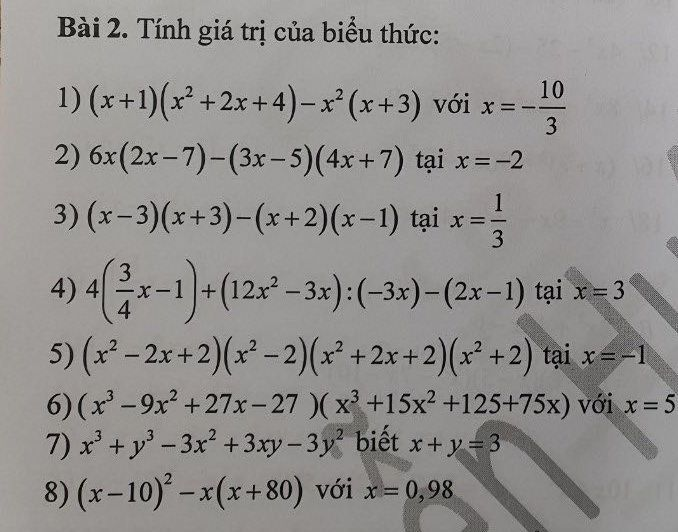

-- Number of words: 205


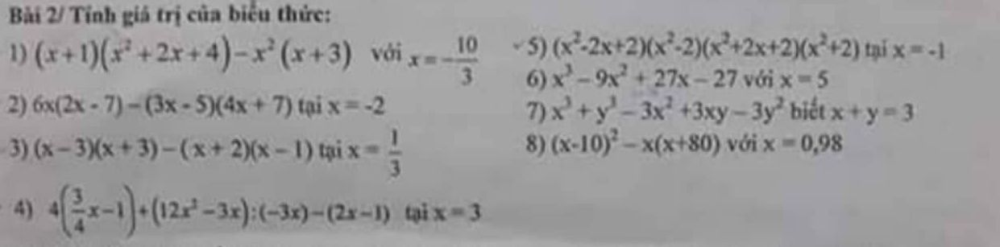

************

PAIRS: 77 - Cosine score: 0.535011042181916
-- Number of words: 69


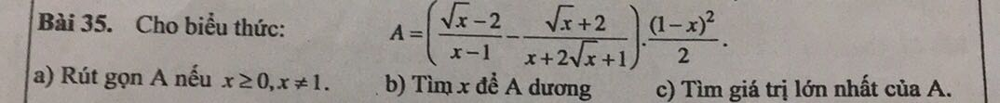

-- Number of words: 69


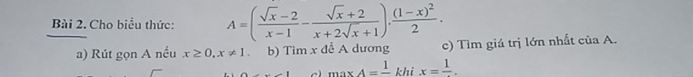

************

PAIRS: 78 - Cosine score: 0.5376208168299073
-- Number of words: 37


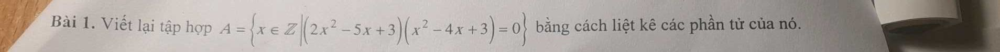

-- Number of words: 50


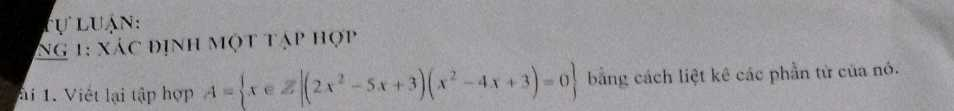

************

PAIRS: 79 - Cosine score: 0.5440237489323647
-- Number of words: 53


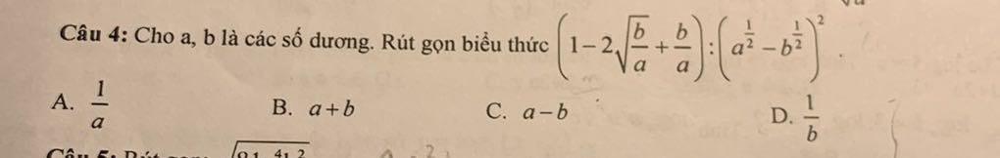

-- Number of words: 65


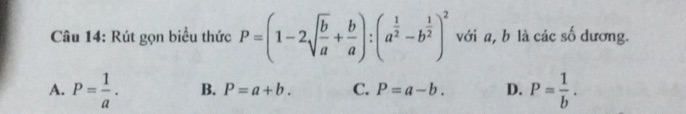

************

PAIRS: 80 - Cosine score: 0.561016929430493
-- Number of words: 40


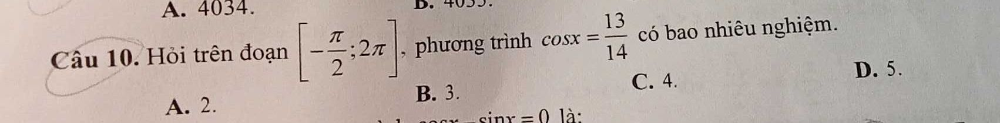

-- Number of words: 41


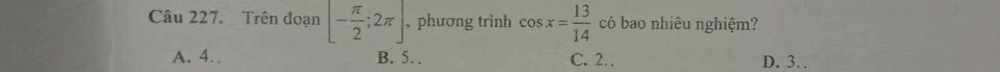

************

PAIRS: 81 - Cosine score: 0.5700496056582861
-- Number of words: 50


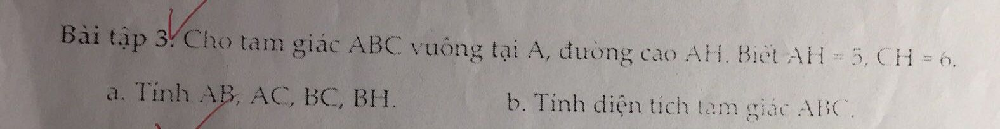

-- Number of words: 52


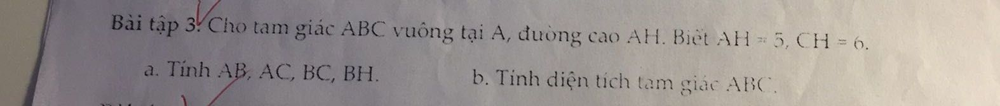

************

PAIRS: 82 - Cosine score: 0.5715910067696723
-- Number of words: 33


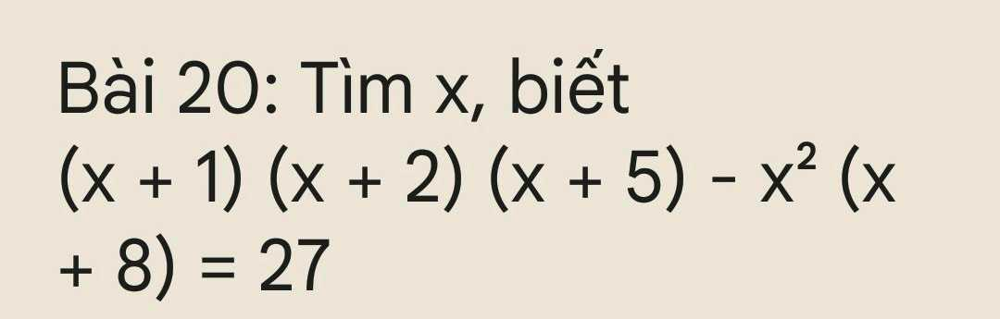

-- Number of words: 28


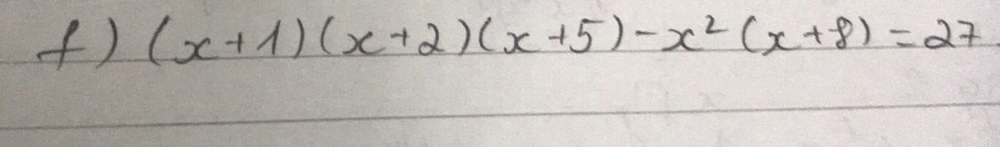

************

PAIRS: 83 - Cosine score: 0.5756665423789685
-- Number of words: 85


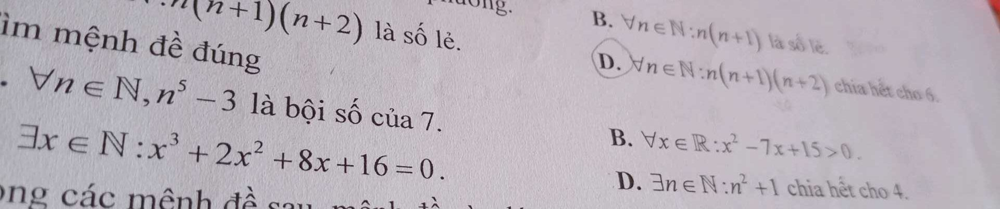

-- Number of words: 53


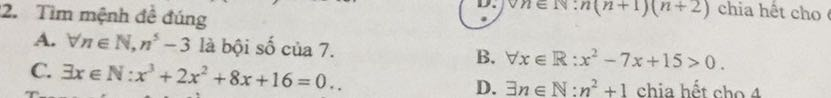

************

PAIRS: 84 - Cosine score: 0.5759588230798327
-- Number of words: 12


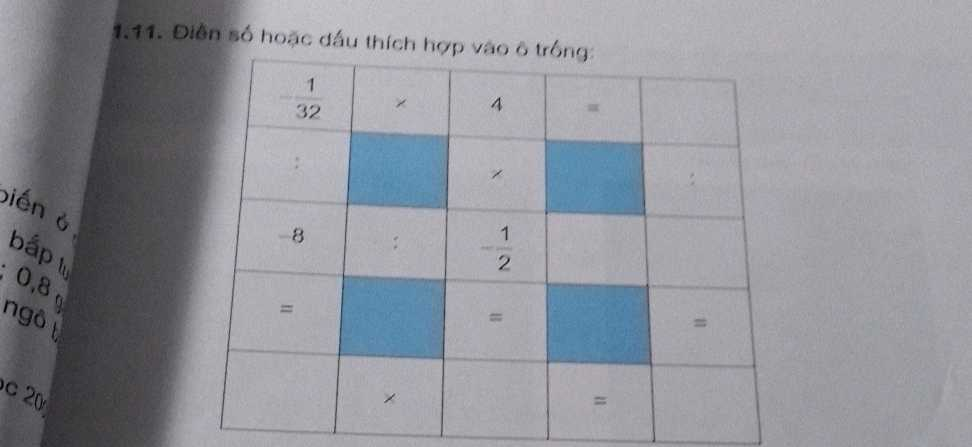

-- Number of words: 11


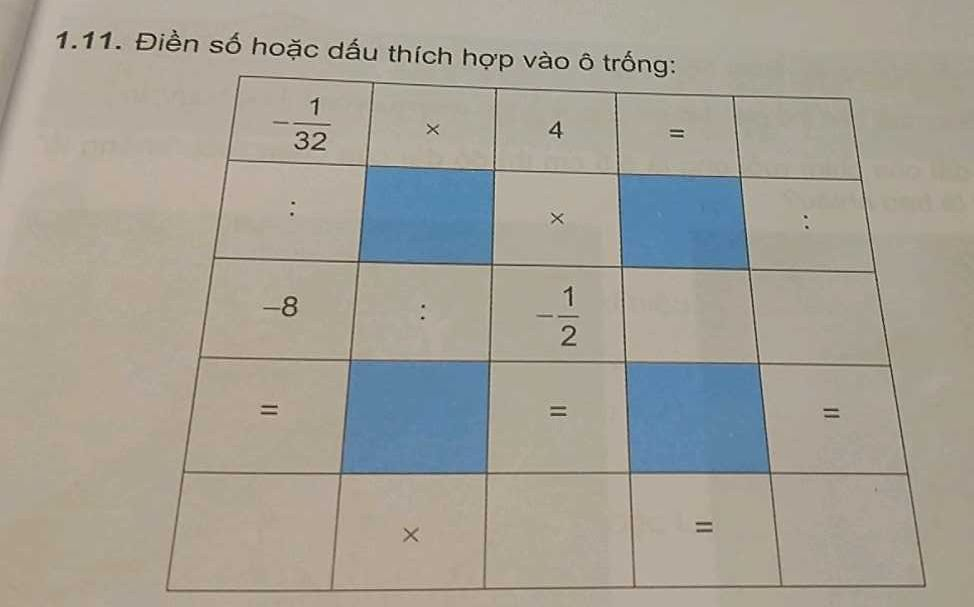

************

PAIRS: 85 - Cosine score: 0.5763556488426995
-- Number of words: 58


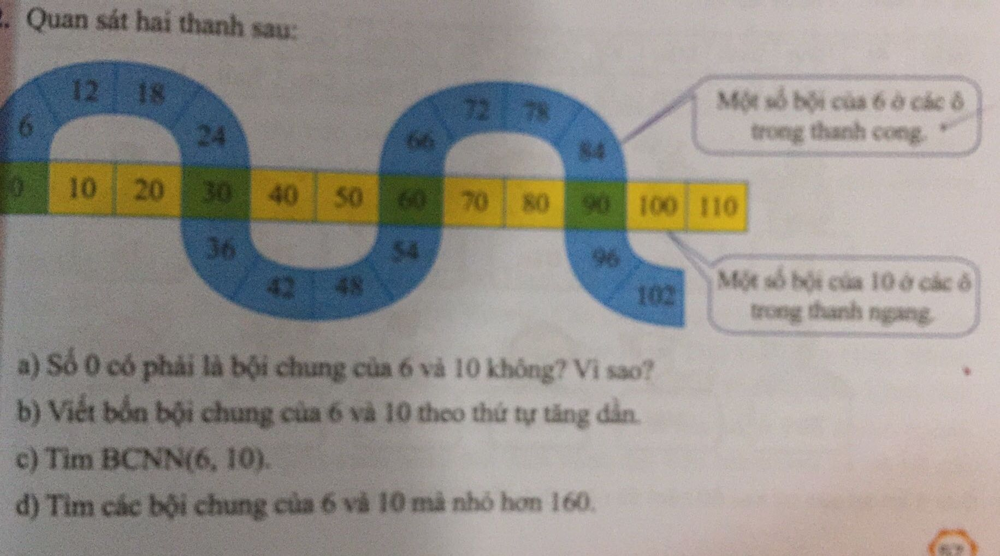

-- Number of words: 66


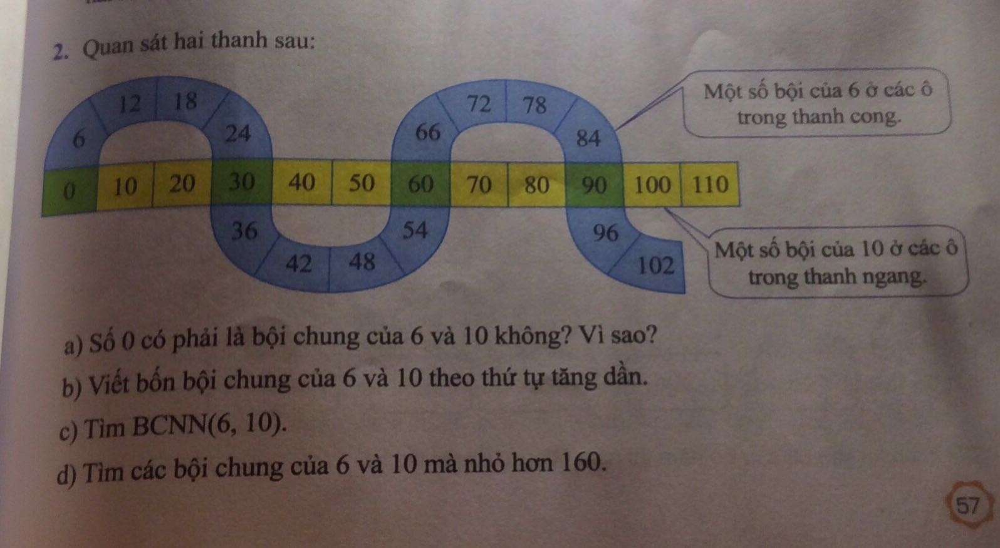

************

PAIRS: 86 - Cosine score: 0.5776364741988116
-- Number of words: 24


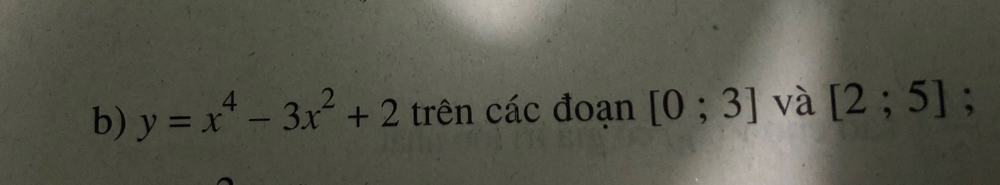

-- Number of words: 35


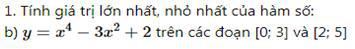

************

PAIRS: 87 - Cosine score: 0.5870904736542099
-- Number of words: 24


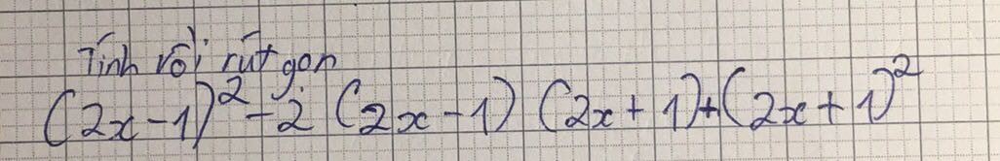

-- Number of words: 31


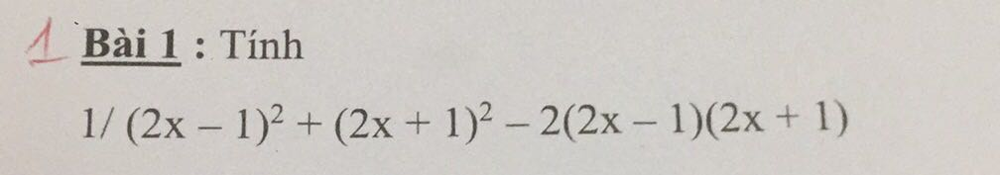

************

PAIRS: 88 - Cosine score: 0.5907740633613365
-- Number of words: 73


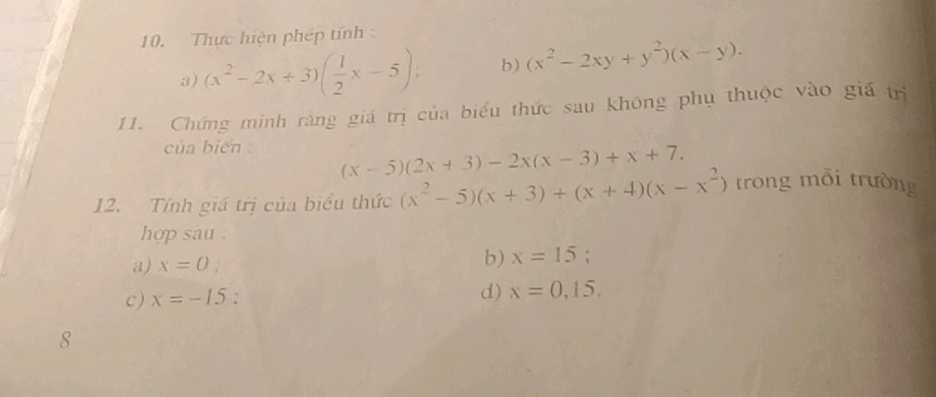

-- Number of words: 129


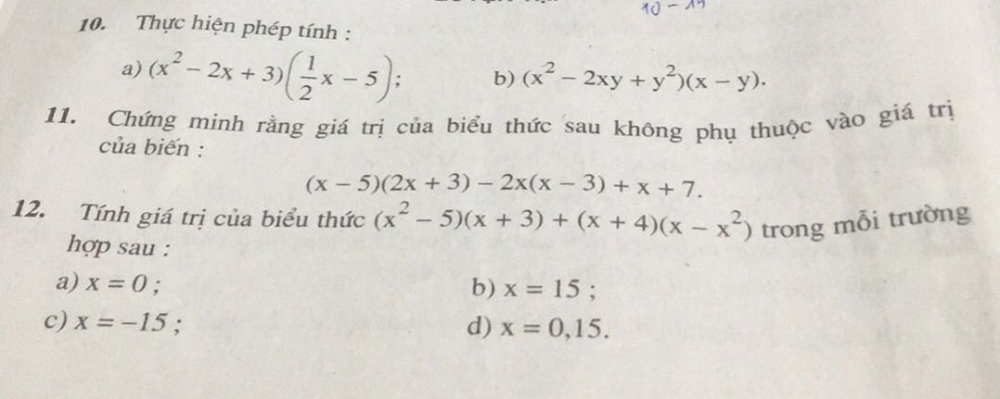

************

PAIRS: 89 - Cosine score: 0.5933078850545146
-- Number of words: 68


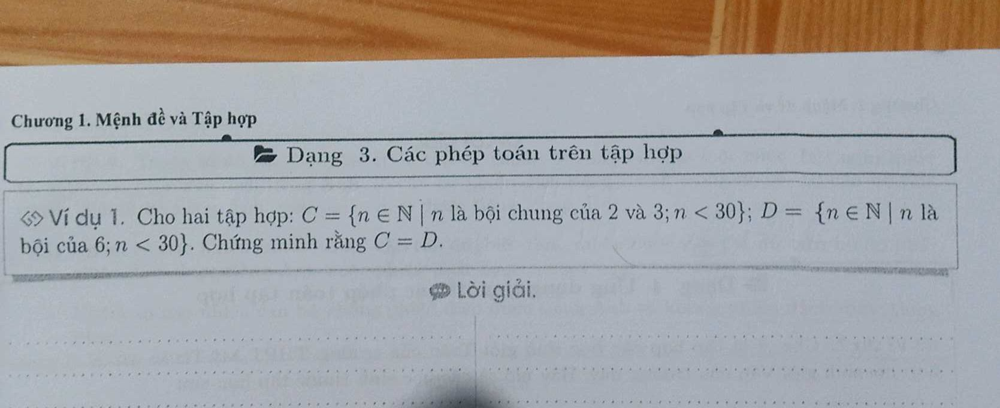

-- Number of words: 49


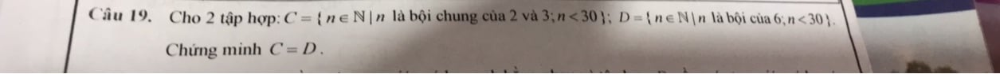

************

PAIRS: 90 - Cosine score: 0.5934651039101216
-- Number of words: 93


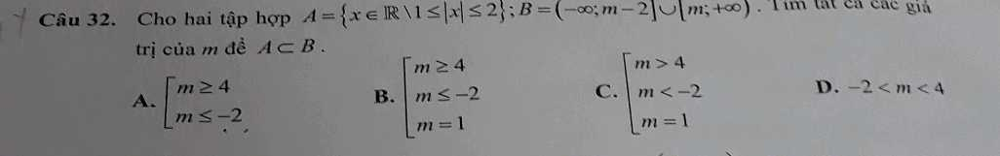

-- Number of words: 92


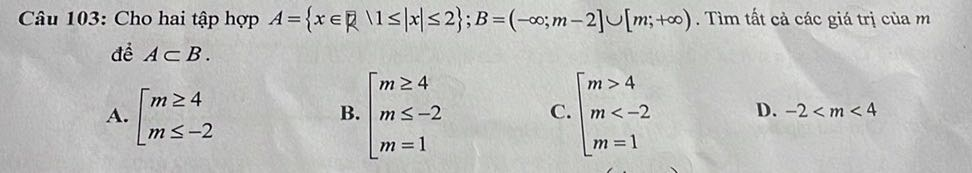

************

PAIRS: 91 - Cosine score: 0.5982896516298656
-- Number of words: 67


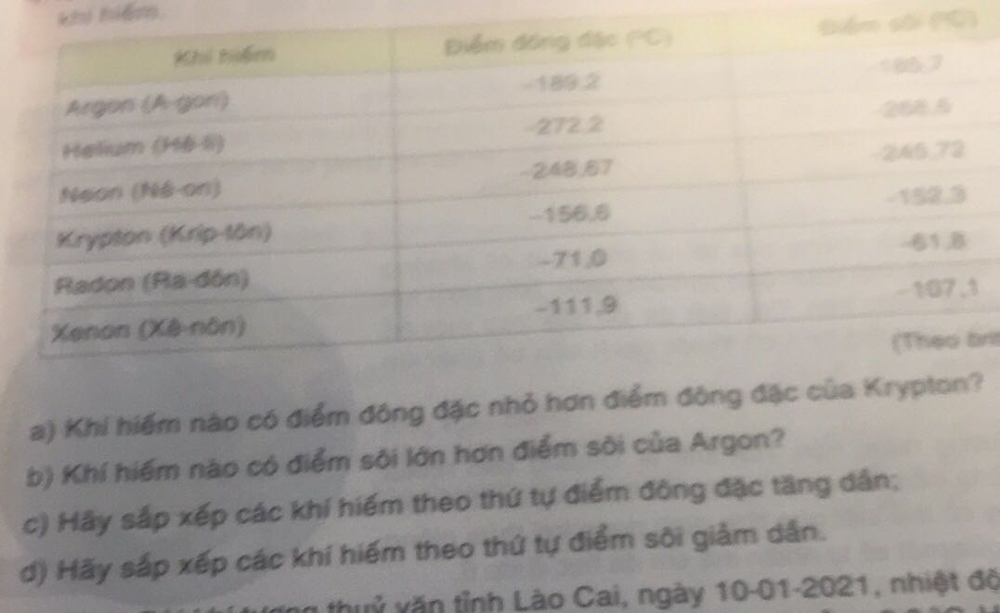

-- Number of words: 87


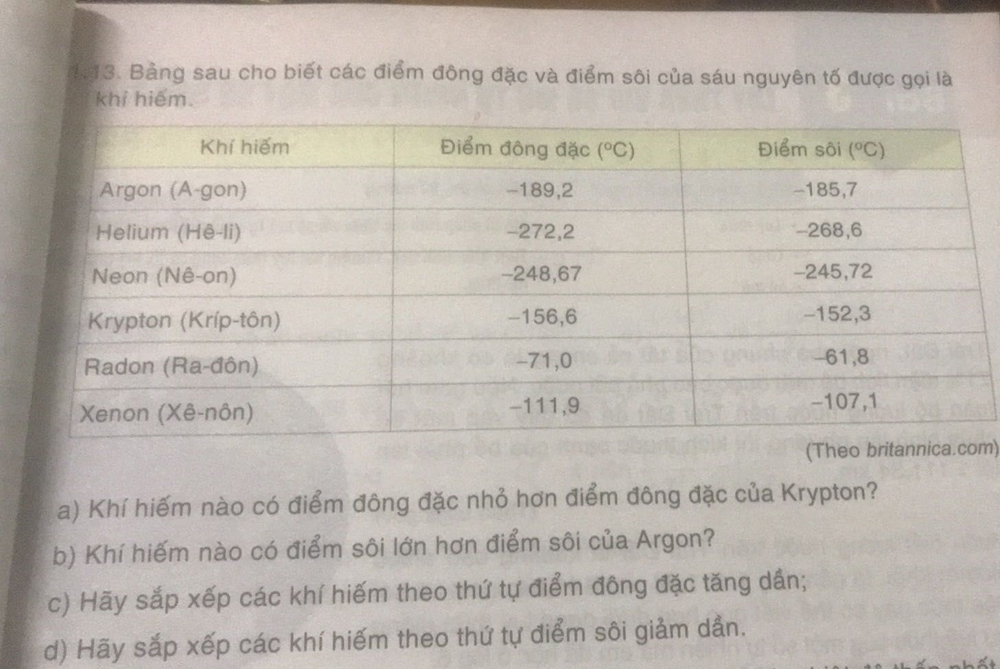

************

PAIRS: 92 - Cosine score: 0.6000854828791324
-- Number of words: 62


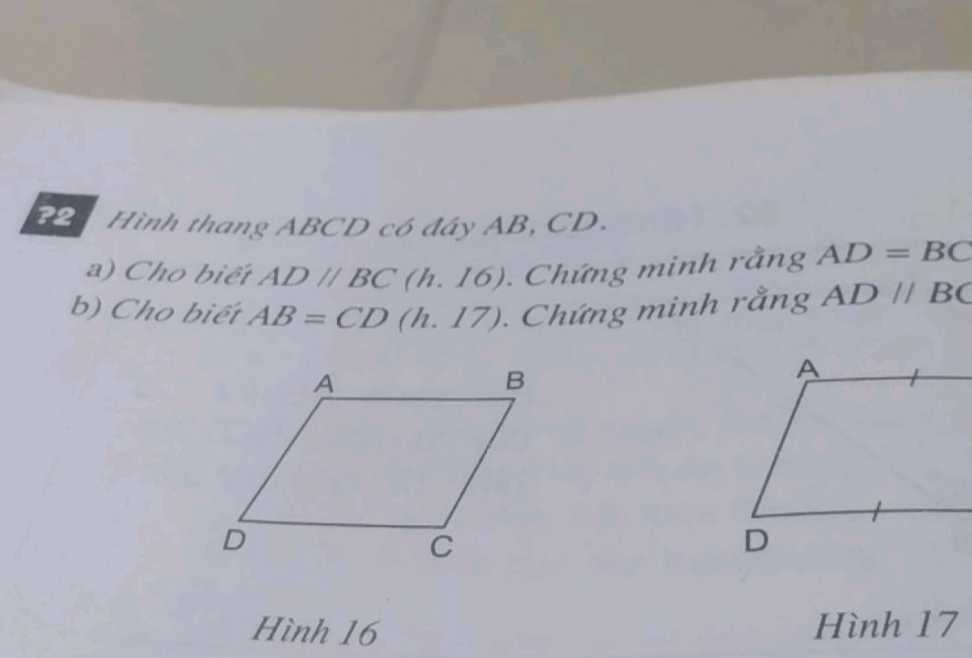

-- Number of words: 73


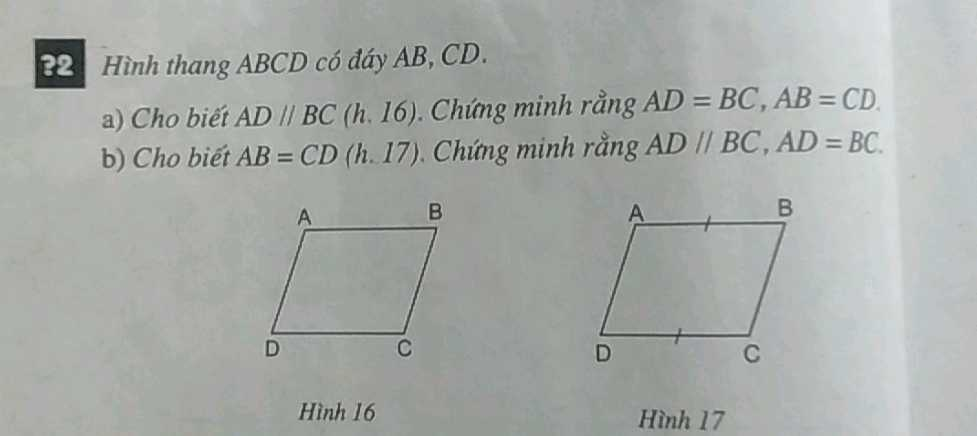

************

PAIRS: 93 - Cosine score: 0.6008746836158582
-- Number of words: 51


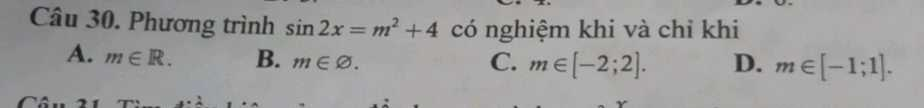

-- Number of words: 53


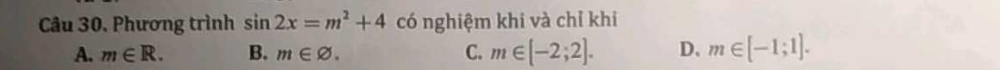

************

PAIRS: 94 - Cosine score: 0.6022266611761289
-- Number of words: 29


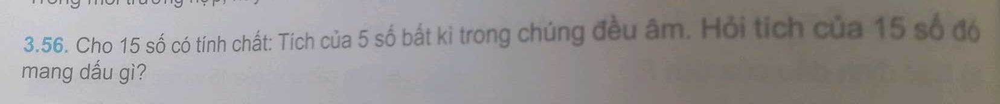

-- Number of words: 29


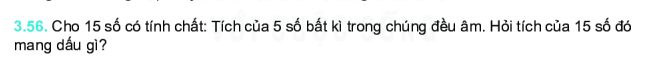

************

PAIRS: 95 - Cosine score: 0.6022952102184834
-- Number of words: 27


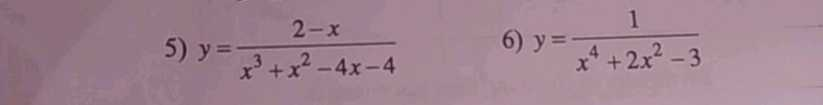

-- Number of words: 90


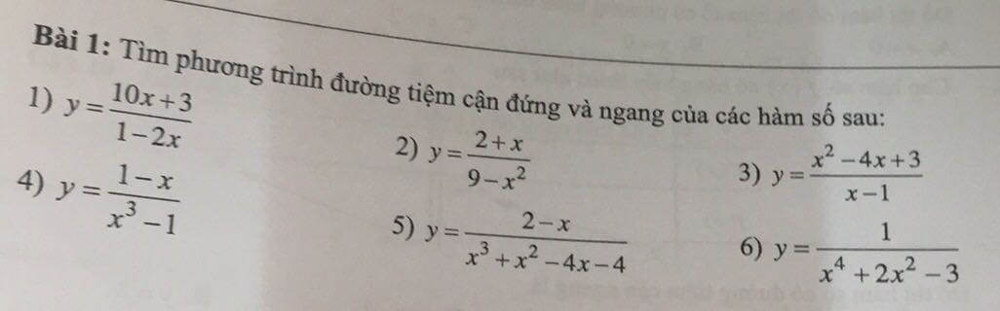

************

PAIRS: 96 - Cosine score: 0.6027370412811547
-- Number of words: 40


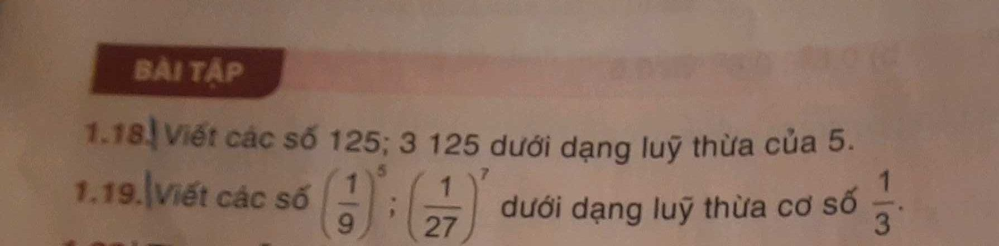

-- Number of words: 37


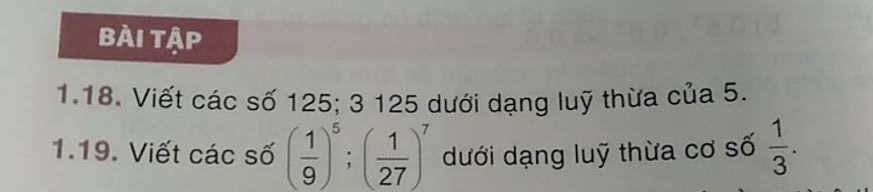

************

PAIRS: 97 - Cosine score: 0.6059980356222734
-- Number of words: 20


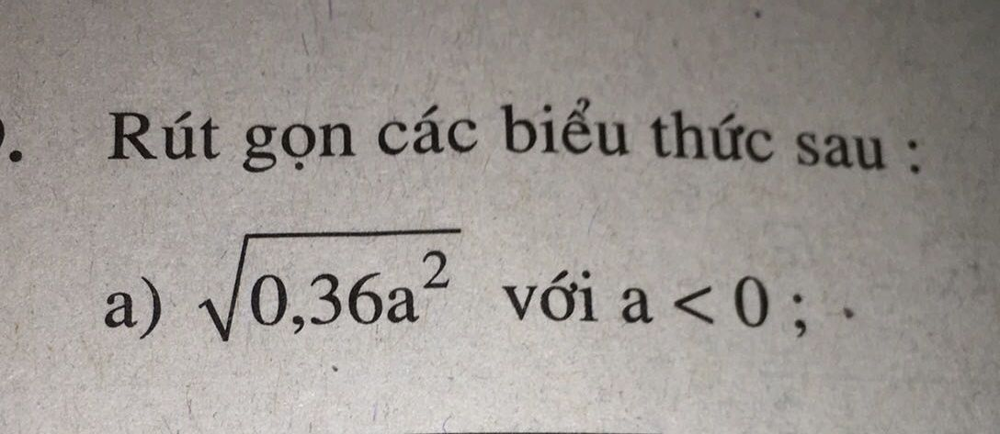

-- Number of words: 77


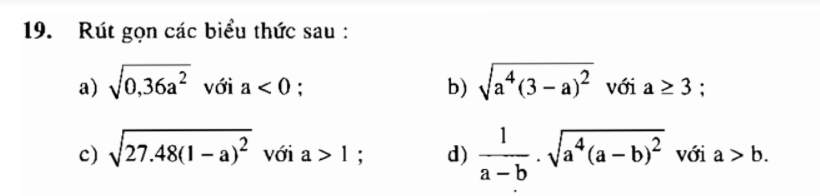

************

PAIRS: 98 - Cosine score: 0.6062249138456814
-- Number of words: 33


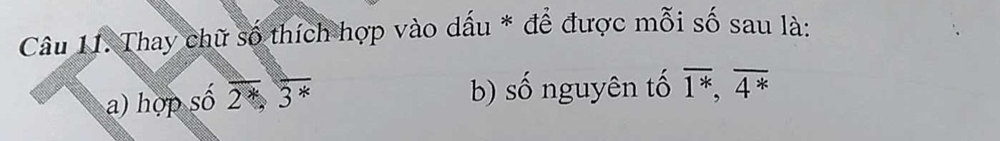

-- Number of words: 49


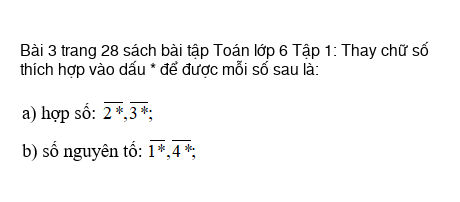

************

PAIRS: 99 - Cosine score: 0.6082355697309387
-- Number of words: 21


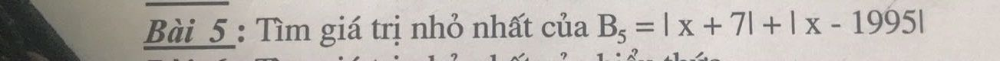

-- Number of words: 20


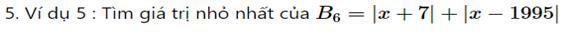

************

PAIRS: 100 - Cosine score: 0.6088948920452404
-- Number of words: 39


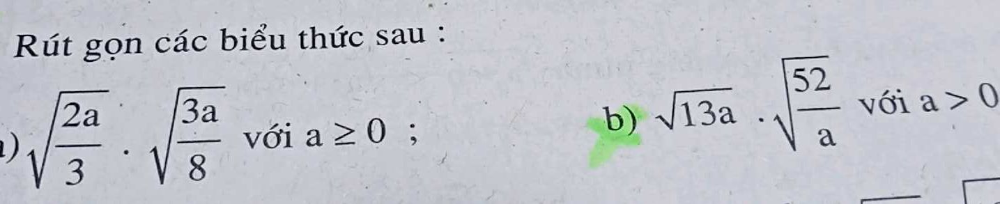

-- Number of words: 89


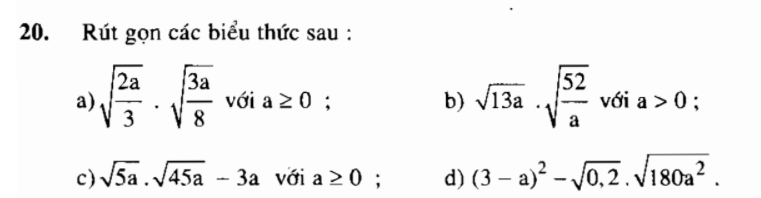

************

PAIRS: 101 - Cosine score: 0.6099699643156353
-- Number of words: 18


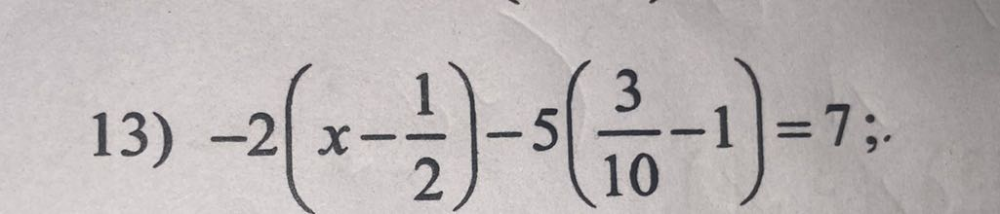

-- Number of words: 18


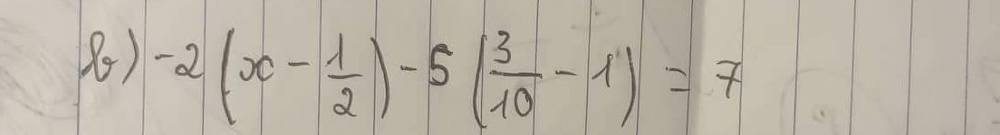

************

PAIRS: 102 - Cosine score: 0.6104684706756511
-- Number of words: 43


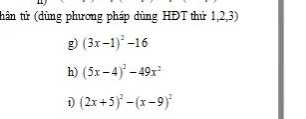

-- Number of words: 43


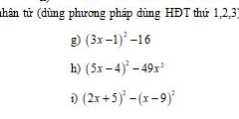

************

PAIRS: 103 - Cosine score: 0.6106656259626668
-- Number of words: 43


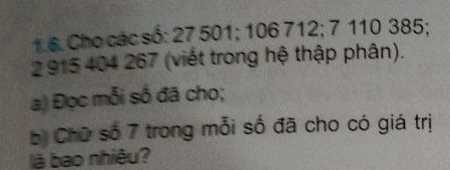

-- Number of words: 44


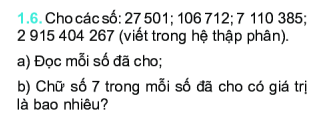

************

PAIRS: 104 - Cosine score: 0.6108737119632959
-- Number of words: 74


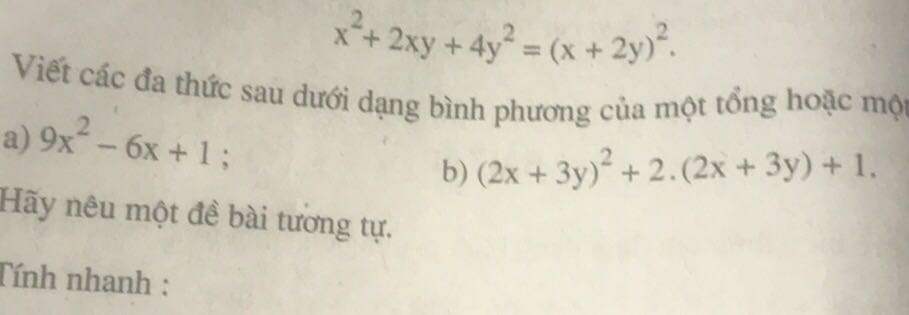

-- Number of words: 74


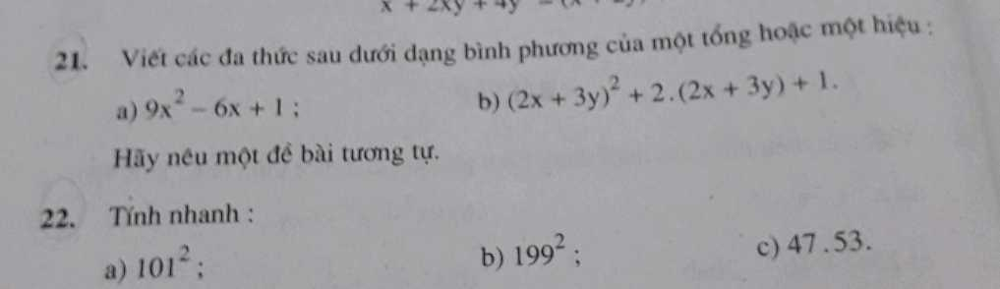

************

PAIRS: 105 - Cosine score: 0.6110339312863383
-- Number of words: 56


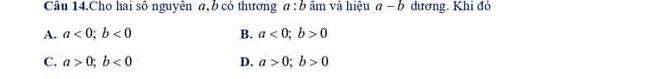

-- Number of words: 57


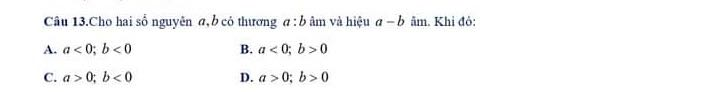

************

PAIRS: 106 - Cosine score: 0.6125216985809006
-- Number of words: 121


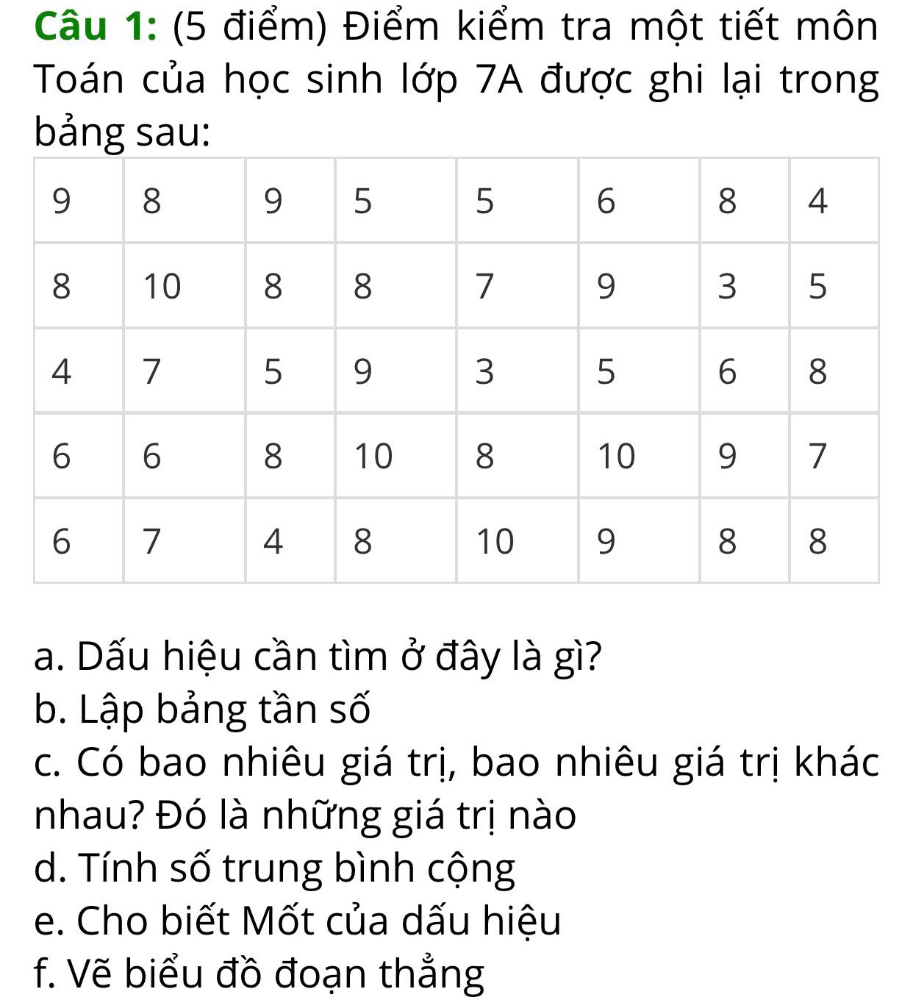

-- Number of words: 146


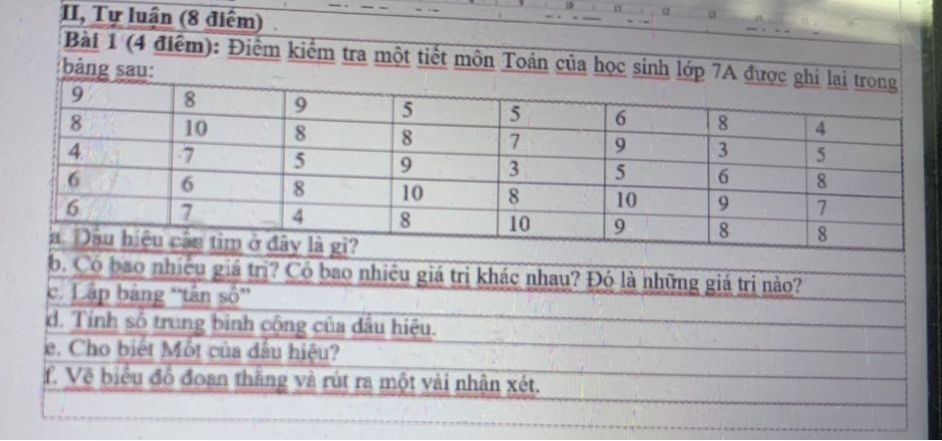

************

PAIRS: 107 - Cosine score: 0.6128369964857026
-- Number of words: 78


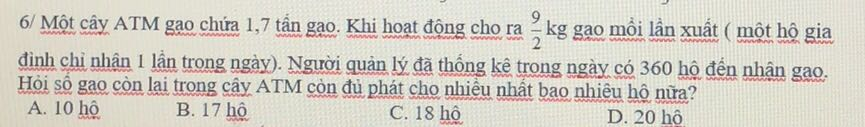

-- Number of words: 75


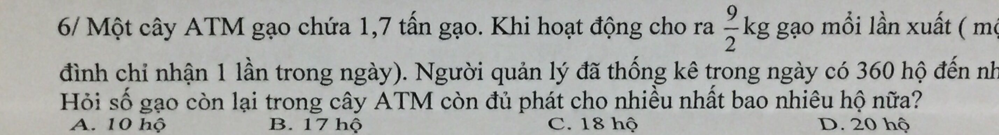

************

PAIRS: 108 - Cosine score: 0.6141511796552834
-- Number of words: 35


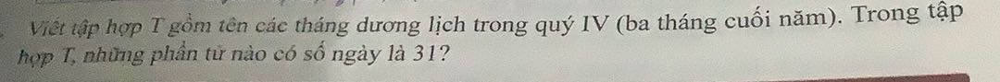

-- Number of words: 31


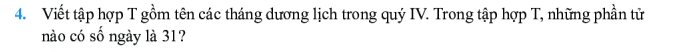

************

PAIRS: 109 - Cosine score: 0.6167845921638373
-- Number of words: 15


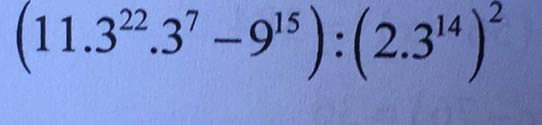

-- Number of words: 83


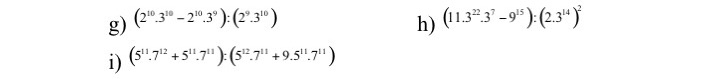

************

PAIRS: 110 - Cosine score: 0.623216625236537
-- Number of words: 57


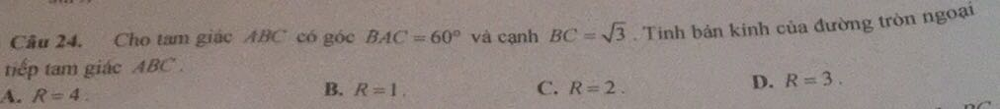

-- Number of words: 56


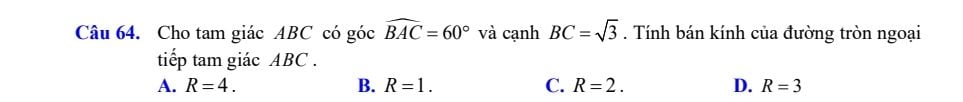

************

PAIRS: 111 - Cosine score: 0.6236637131408438
-- Number of words: 33


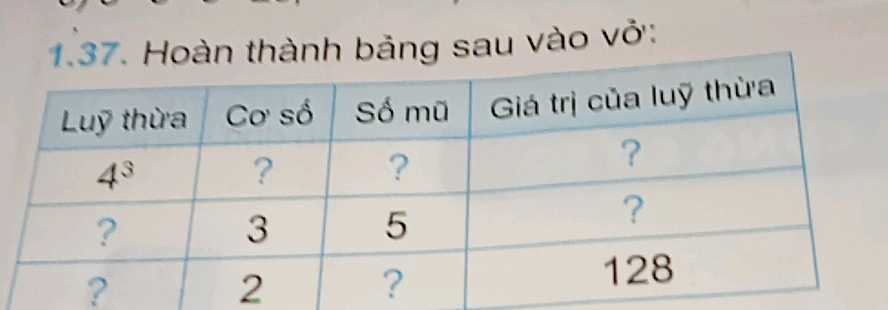

-- Number of words: 34


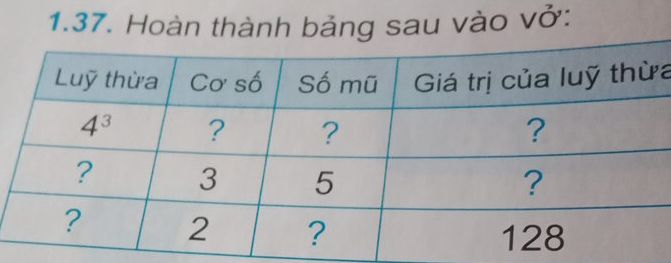

************

PAIRS: 112 - Cosine score: 0.6280275256929397
-- Number of words: 64


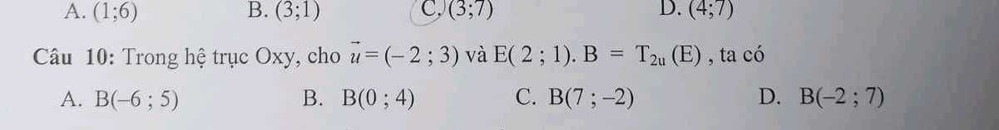

-- Number of words: 71


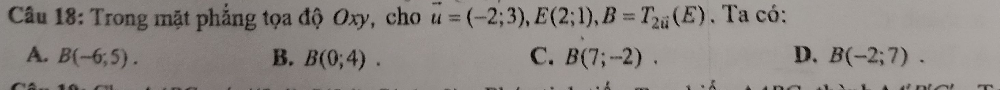

************

PAIRS: 113 - Cosine score: 0.628540418512633
-- Number of words: 51


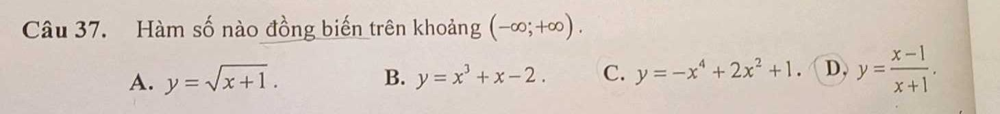

-- Number of words: 51


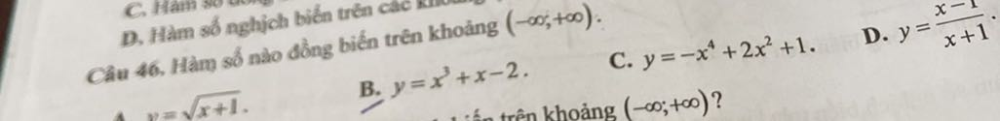

************

PAIRS: 114 - Cosine score: 0.6334466725030099
-- Number of words: 76


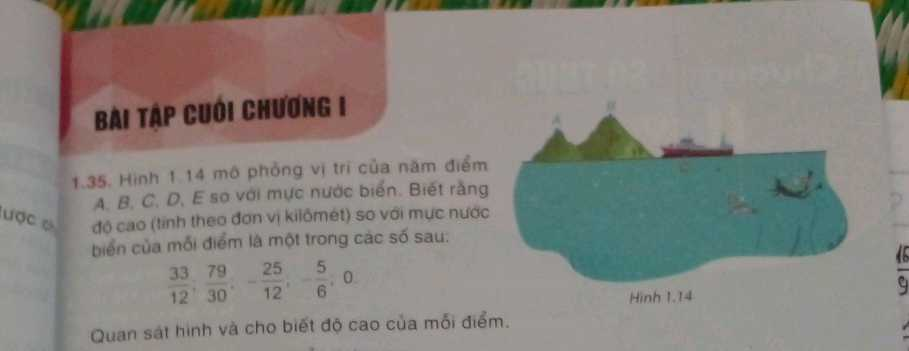

-- Number of words: 78


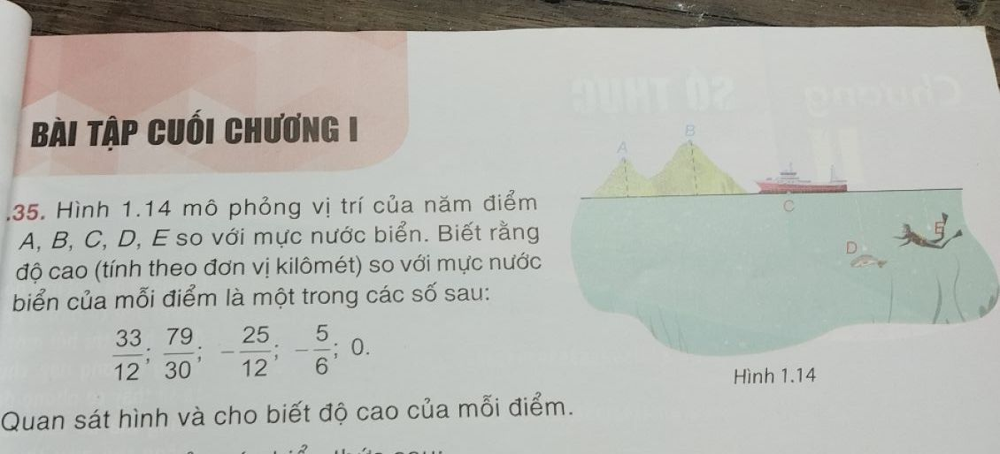

************

PAIRS: 115 - Cosine score: 0.634710197263757
-- Number of words: 54


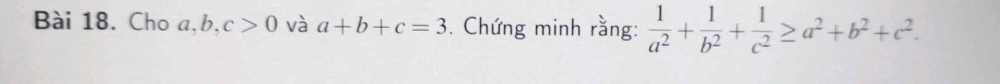

-- Number of words: 48


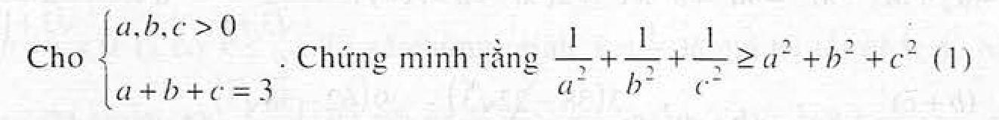

************

PAIRS: 116 - Cosine score: 0.6362953427385781
-- Number of words: 62


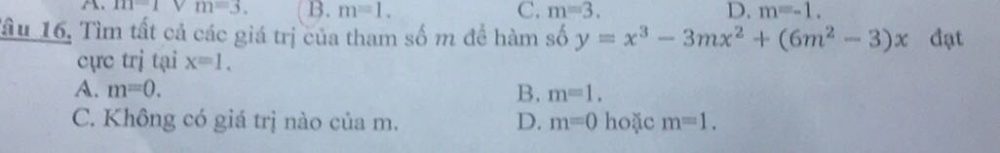

-- Number of words: 69


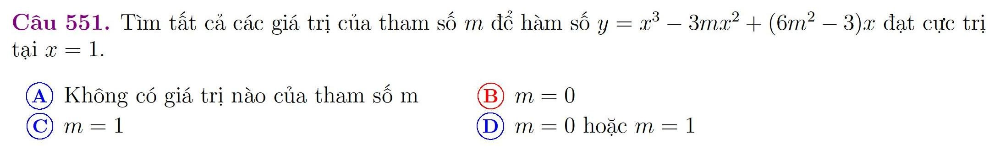

************

PAIRS: 117 - Cosine score: 0.6402477343401033
-- Number of words: 39


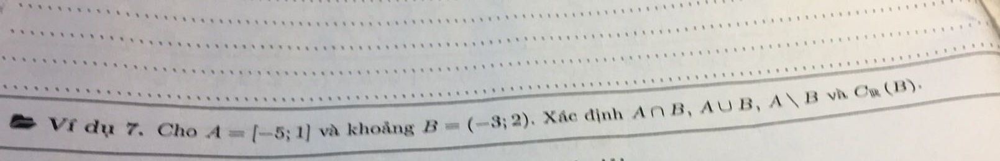

-- Number of words: 34


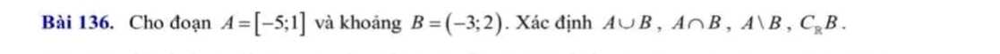

************

PAIRS: 118 - Cosine score: 0.6410678345536434
-- Number of words: 35


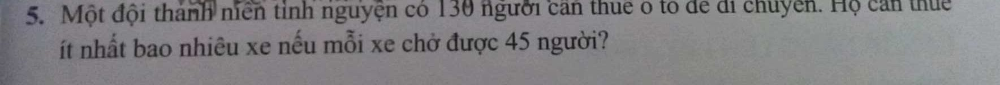

-- Number of words: 32


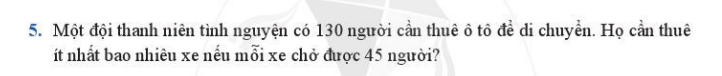

************

PAIRS: 119 - Cosine score: 0.6413596380659787
-- Number of words: 66


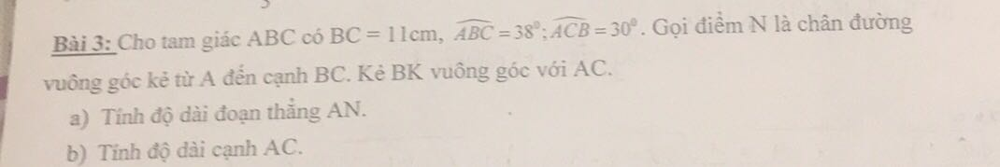

-- Number of words: 52


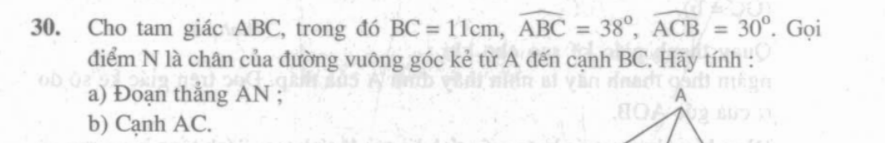

************

PAIRS: 120 - Cosine score: 0.6441906298326208
-- Number of words: 40


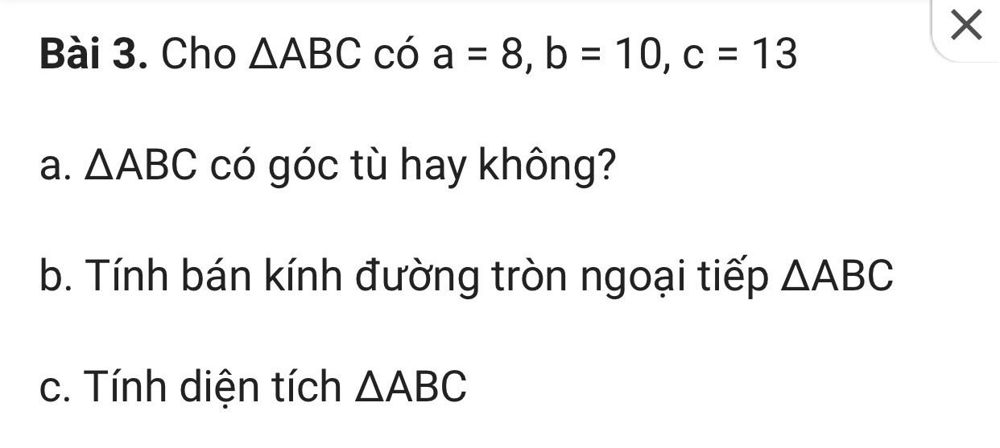

-- Number of words: 48


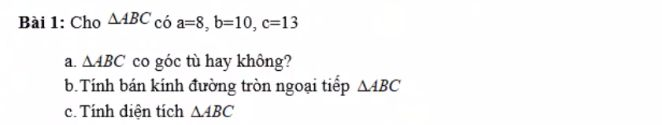

************

PAIRS: 121 - Cosine score: 0.645087412216891
-- Number of words: 48


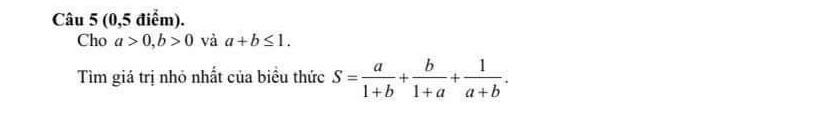

-- Number of words: 48


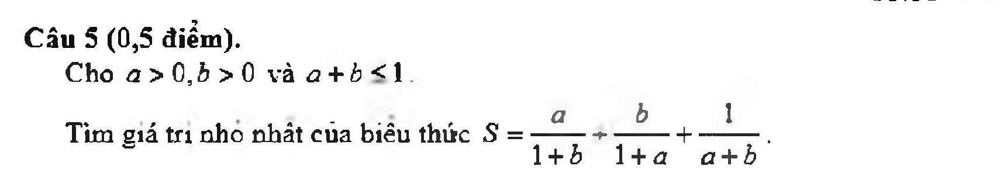

************

PAIRS: 122 - Cosine score: 0.647297617587709
-- Number of words: 18


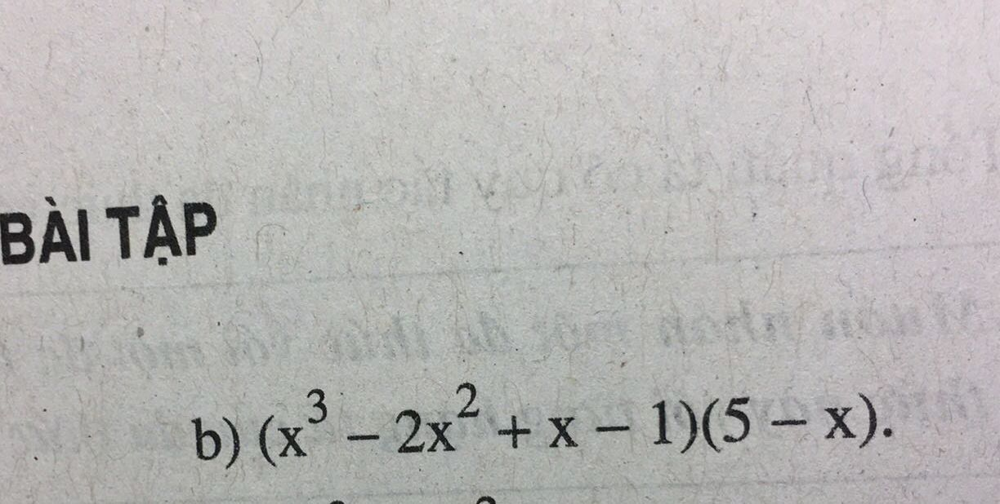

-- Number of words: 17


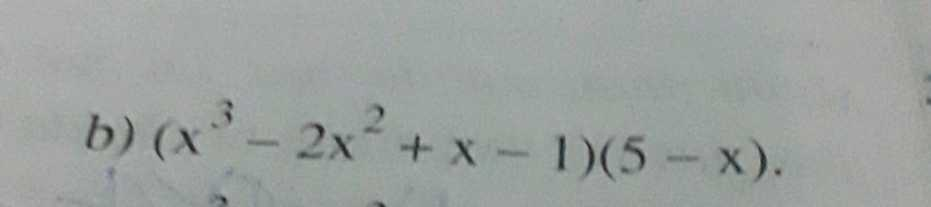

************

PAIRS: 123 - Cosine score: 0.6483830098757929
-- Number of words: 99


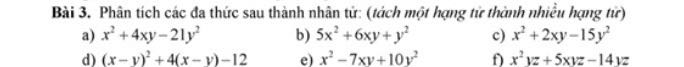

-- Number of words: 98


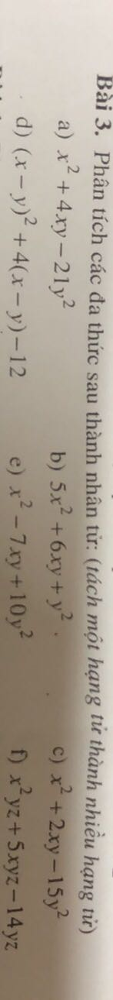

************

PAIRS: 124 - Cosine score: 0.6493787592254744
-- Number of words: 98


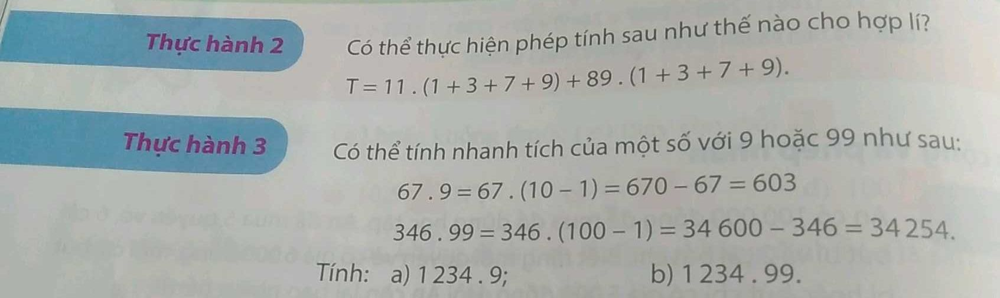

-- Number of words: 263


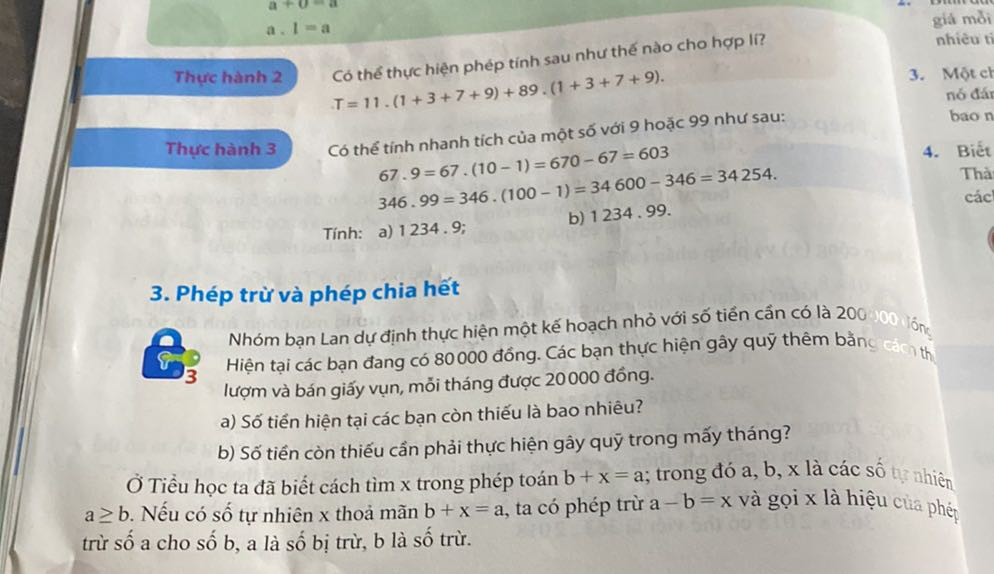

************

PAIRS: 125 - Cosine score: 0.6521271350147569
-- Number of words: 42


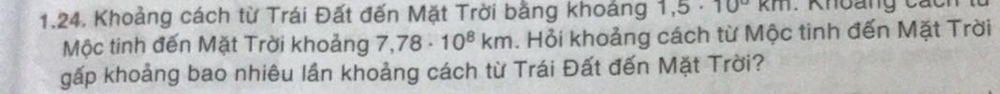

-- Number of words: 145


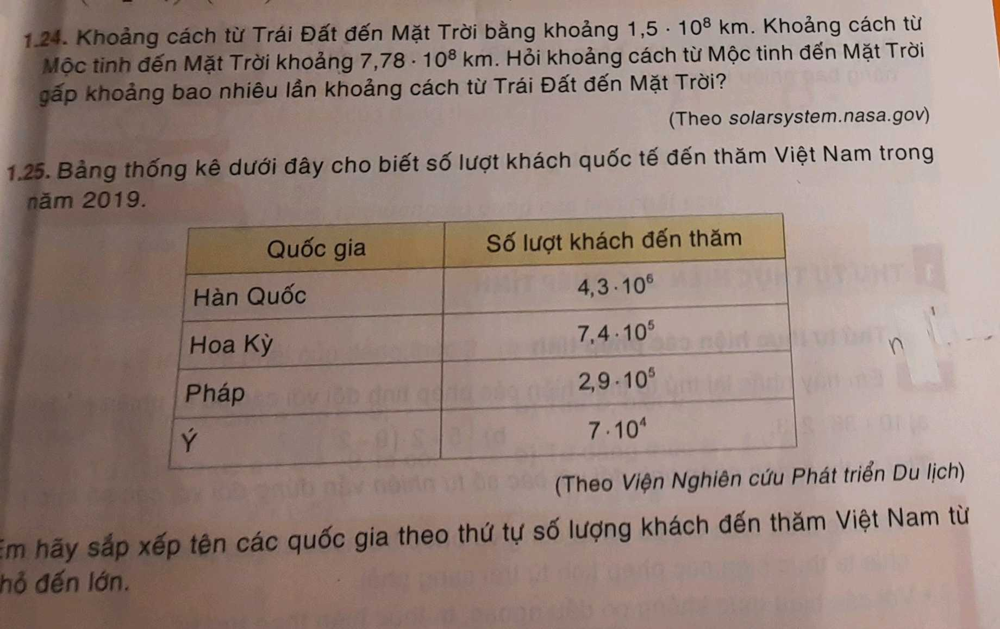

************

PAIRS: 126 - Cosine score: 0.6528340242756986
-- Number of words: 47


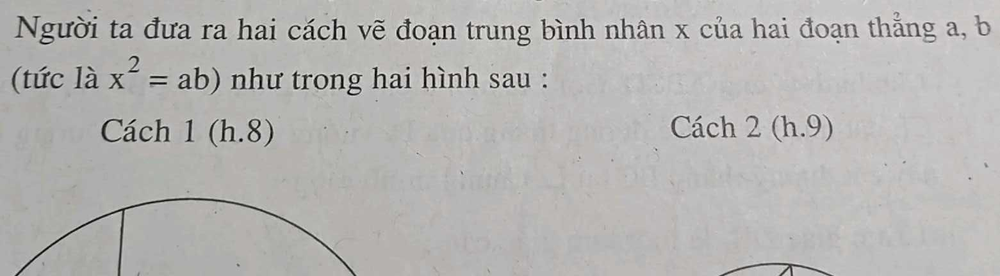

-- Number of words: 52


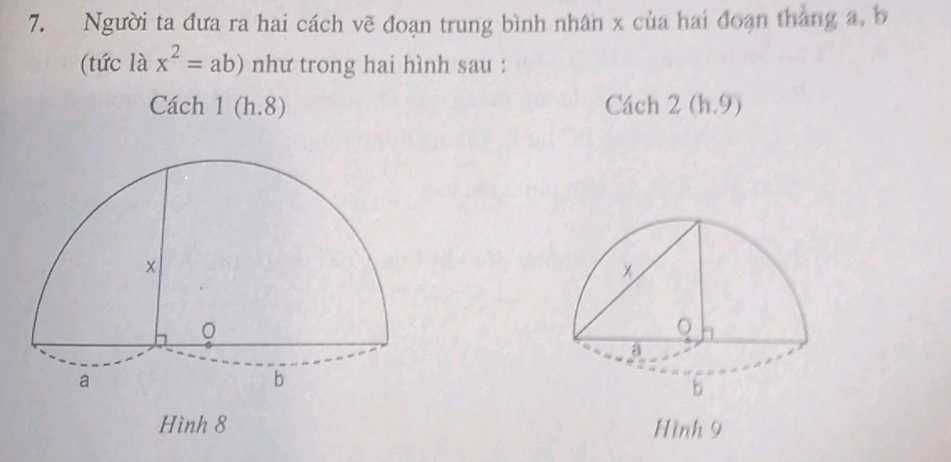

************

PAIRS: 127 - Cosine score: 0.6541495765260898
-- Number of words: 91


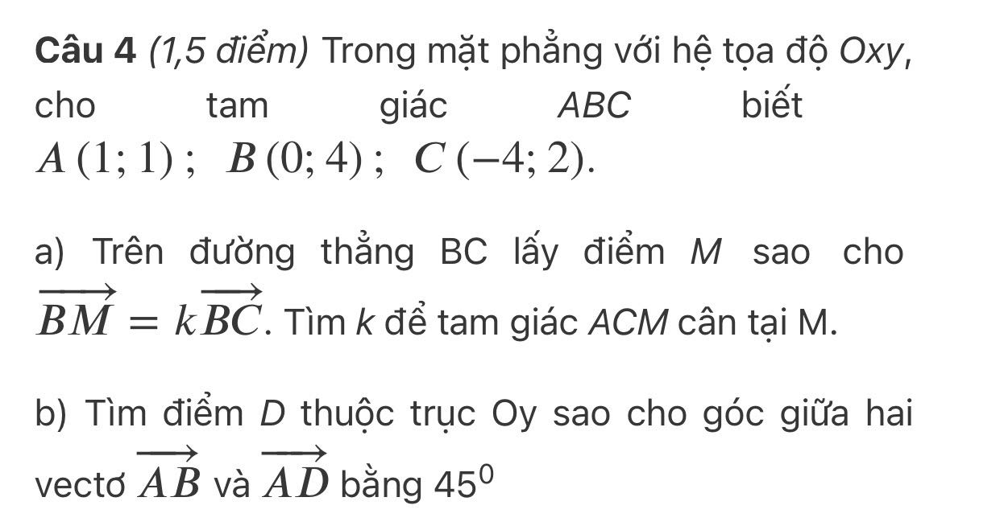

-- Number of words: 96


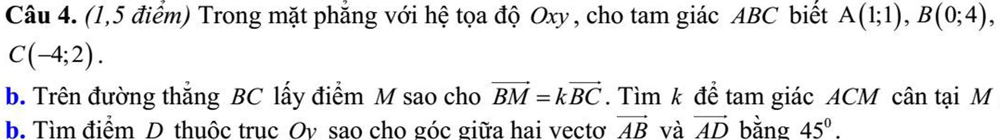

************

PAIRS: 128 - Cosine score: 0.6597995936623589
-- Number of words: 87


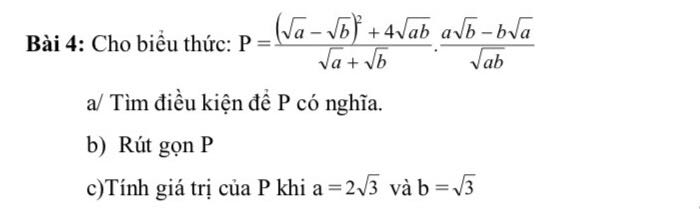

-- Number of words: 85


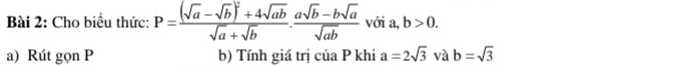

************

PAIRS: 129 - Cosine score: 0.6660789459327908
-- Number of words: 25


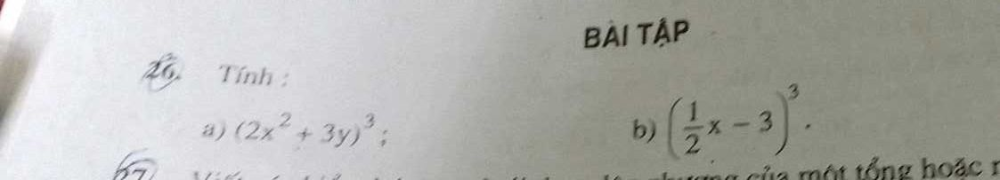

-- Number of words: 24


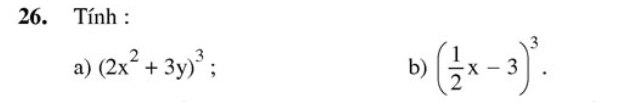

************

PAIRS: 130 - Cosine score: 0.666555556788212
-- Number of words: 100


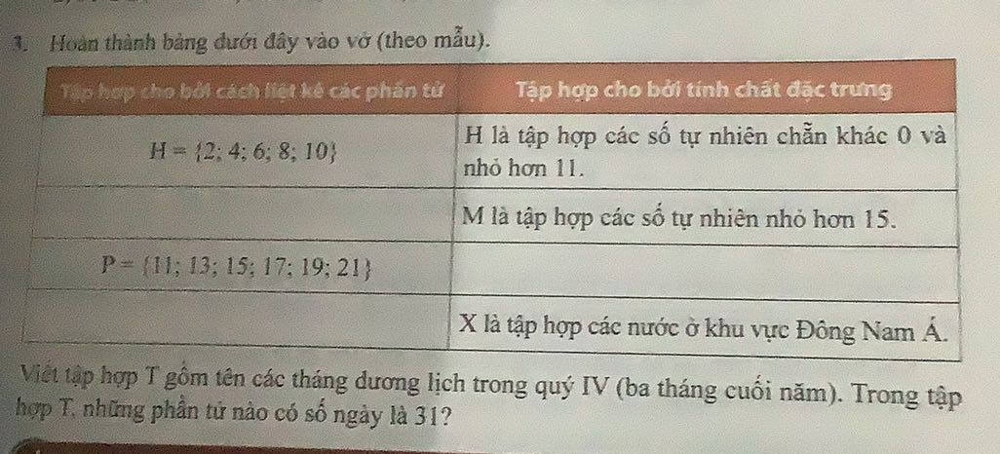

-- Number of words: 95


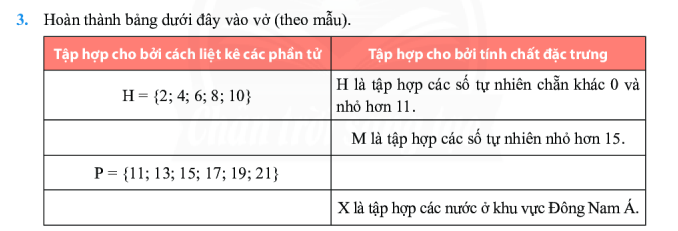

************

PAIRS: 131 - Cosine score: 0.6678943999648741
-- Number of words: 150


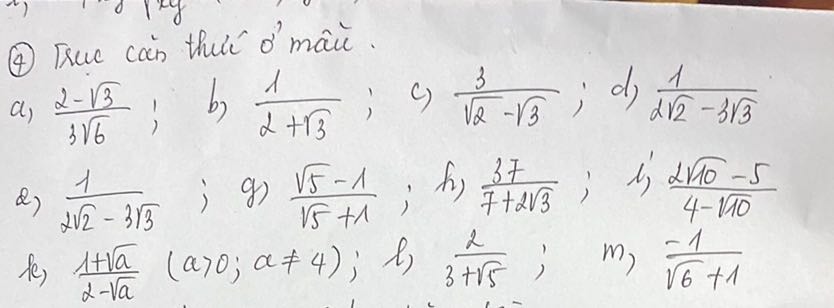

-- Number of words: 150


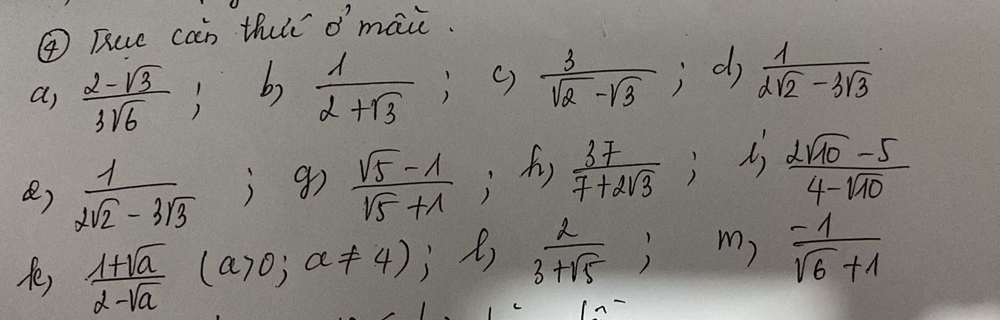

************

PAIRS: 132 - Cosine score: 0.6688522368118132
-- Number of words: 73


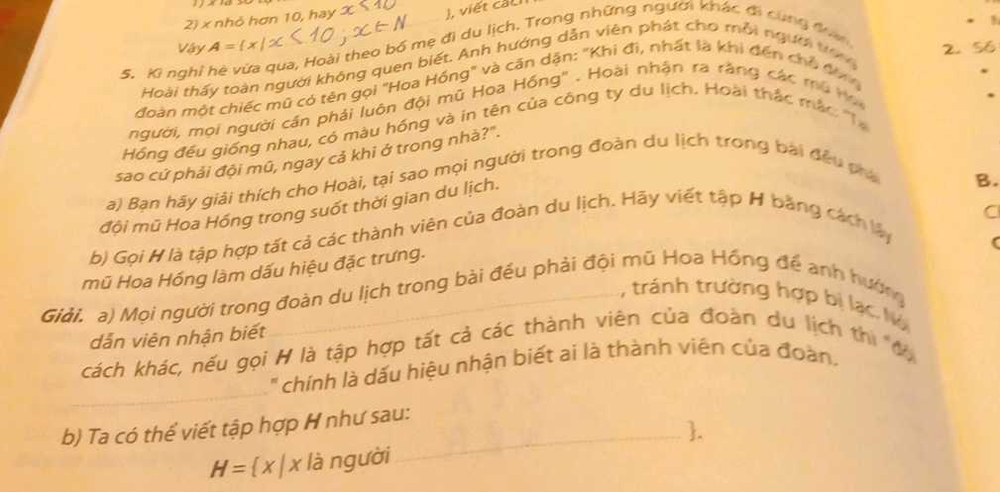

-- Number of words: 269


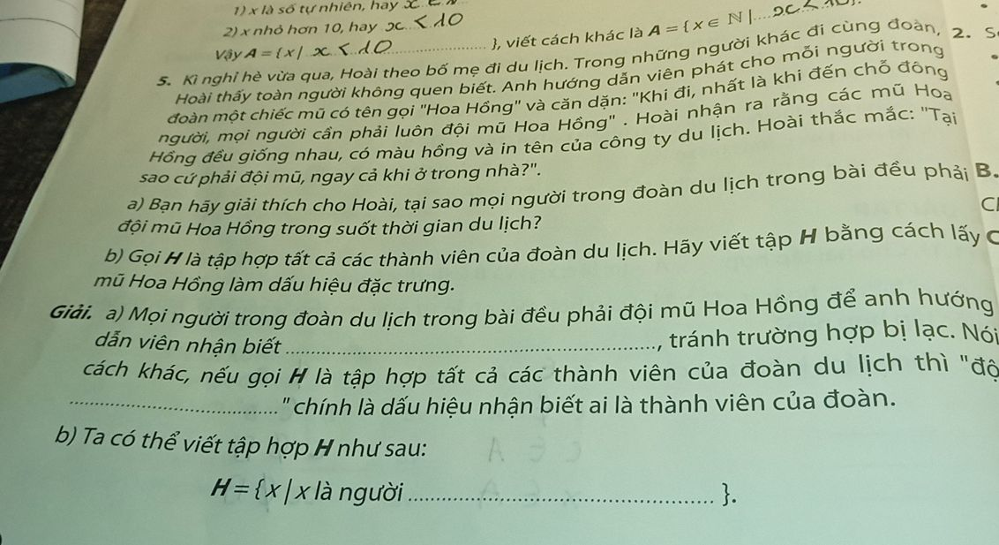

************

PAIRS: 133 - Cosine score: 0.6704635864179318
-- Number of words: 156


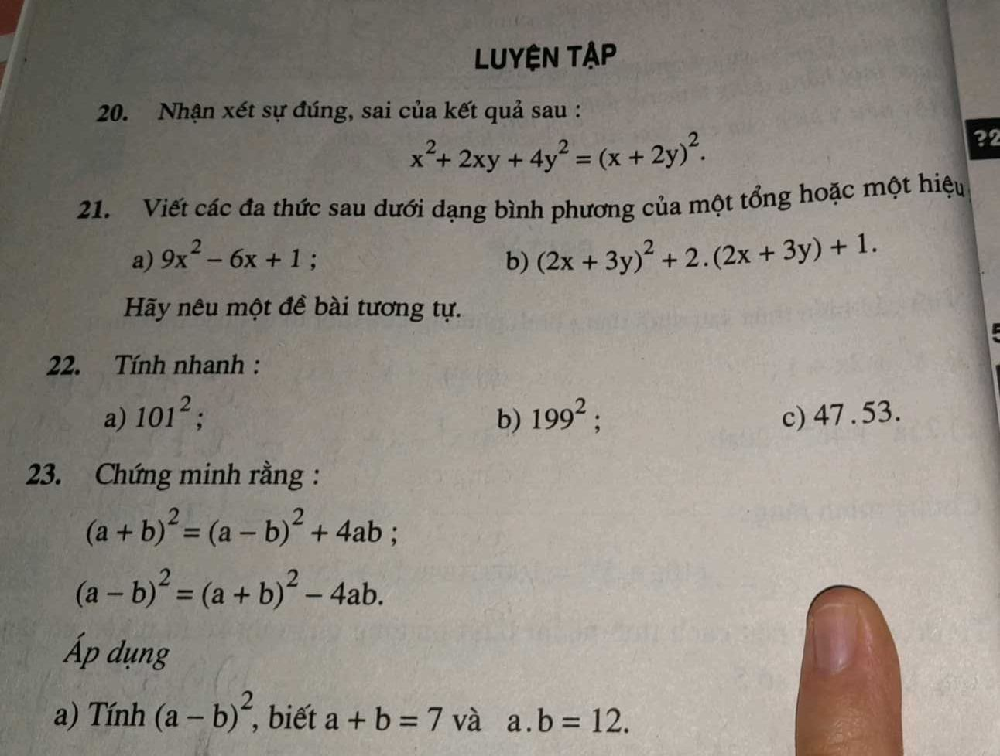

-- Number of words: 248


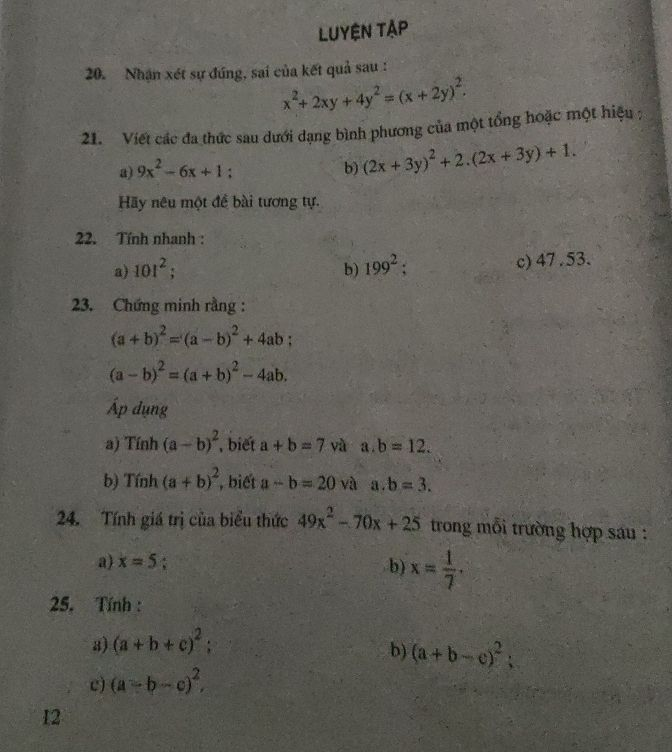

************

PAIRS: 134 - Cosine score: 0.6713982970657241
-- Number of words: 38


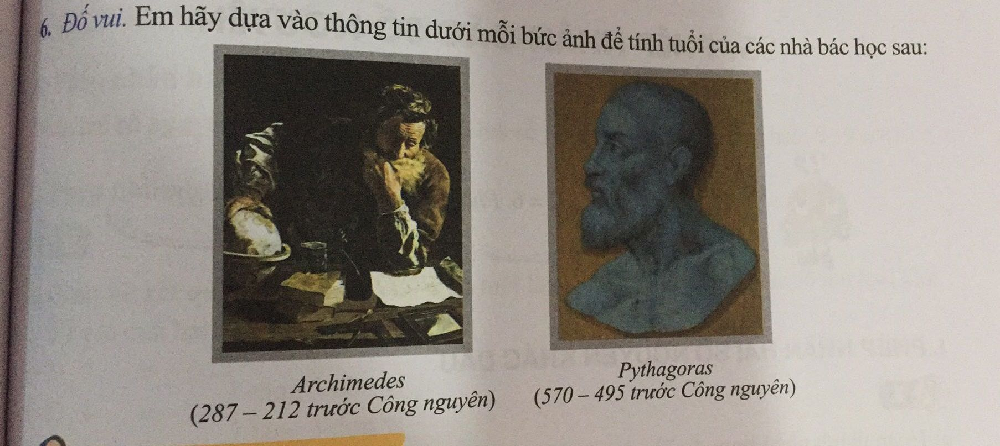

-- Number of words: 22


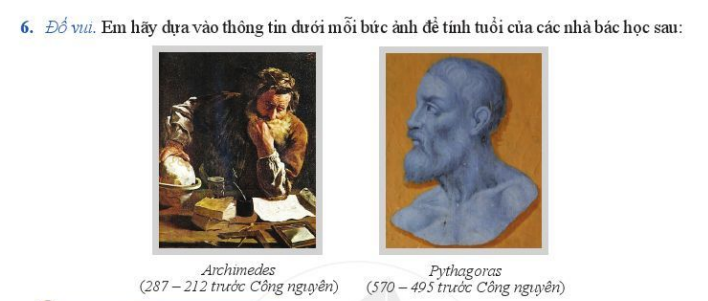

************

PAIRS: 135 - Cosine score: 0.6784067633257478
-- Number of words: 95


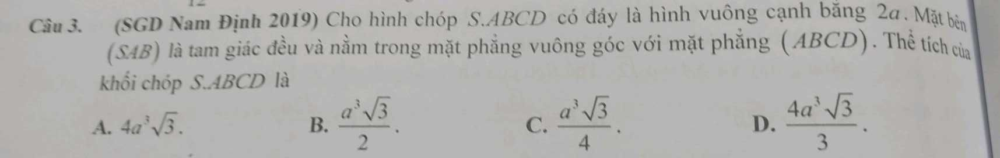

-- Number of words: 124


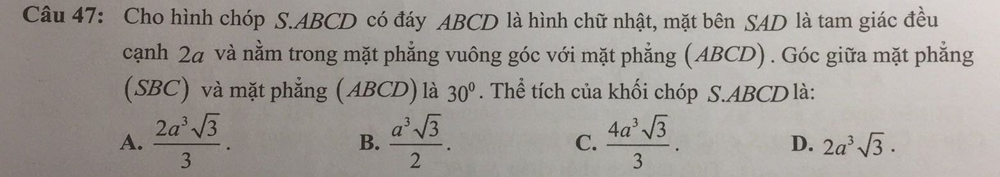

************

PAIRS: 136 - Cosine score: 0.6795439563942007
-- Number of words: 10


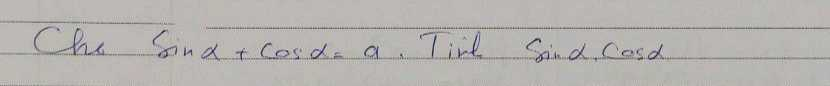

-- Number of words: 55


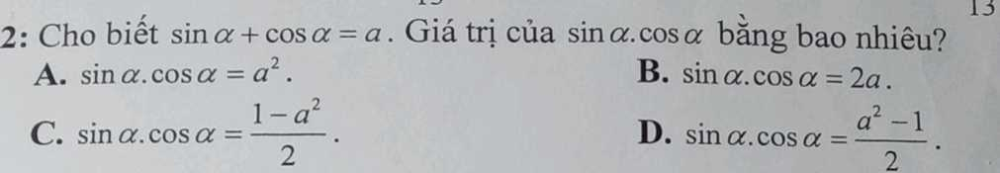

************

PAIRS: 137 - Cosine score: 0.6825864470036562
-- Number of words: 33


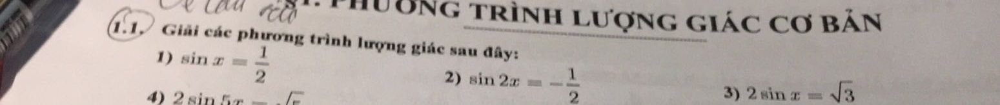

-- Number of words: 23


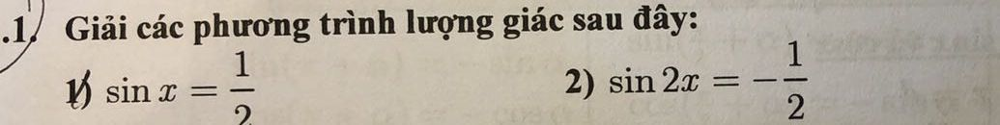

************

PAIRS: 138 - Cosine score: 0.6841127794382833
-- Number of words: 51


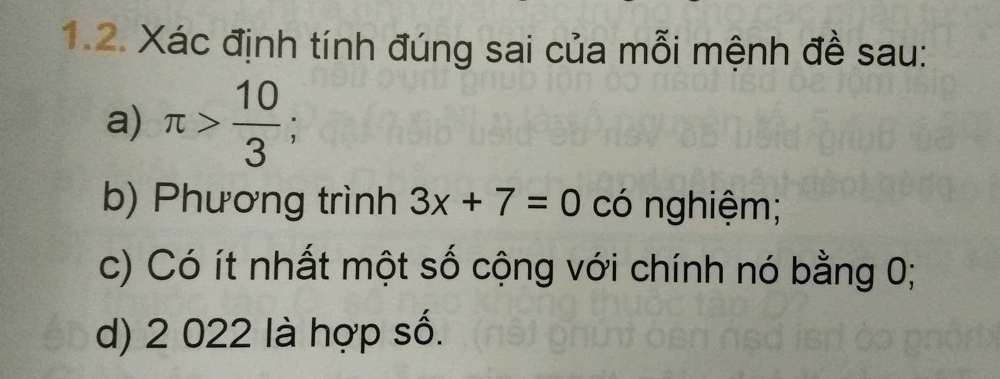

-- Number of words: 48


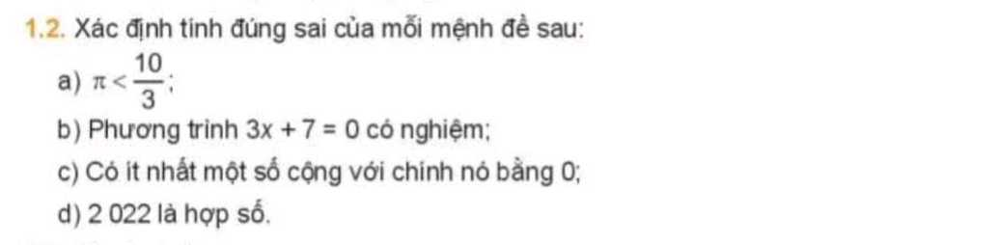

************

PAIRS: 139 - Cosine score: 0.6842481676157075
-- Number of words: 57


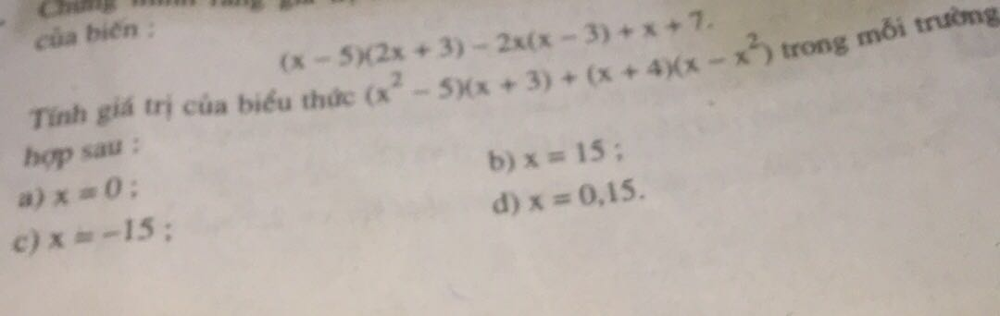

-- Number of words: 56


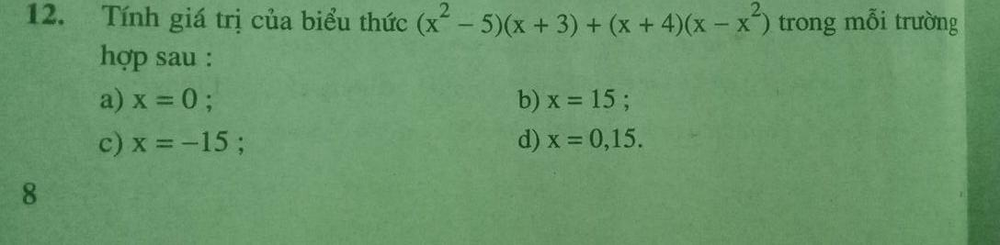

************

PAIRS: 140 - Cosine score: 0.6843739374509753
-- Number of words: 41


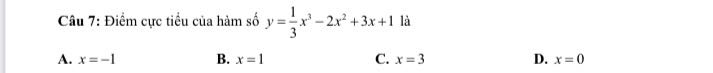

-- Number of words: 40


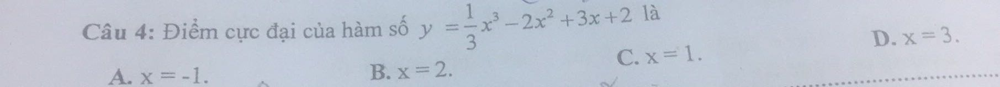

************

PAIRS: 141 - Cosine score: 0.6844977015440303
-- Number of words: 26


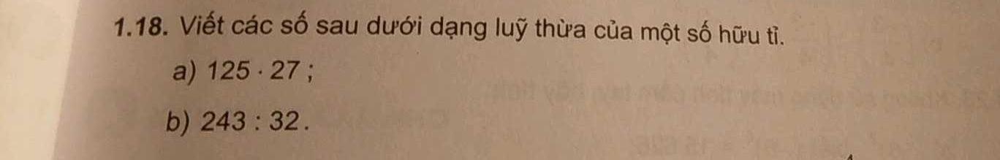

-- Number of words: 24


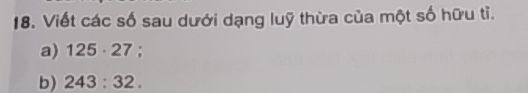

************

PAIRS: 142 - Cosine score: 0.6846635257619776
-- Number of words: 105


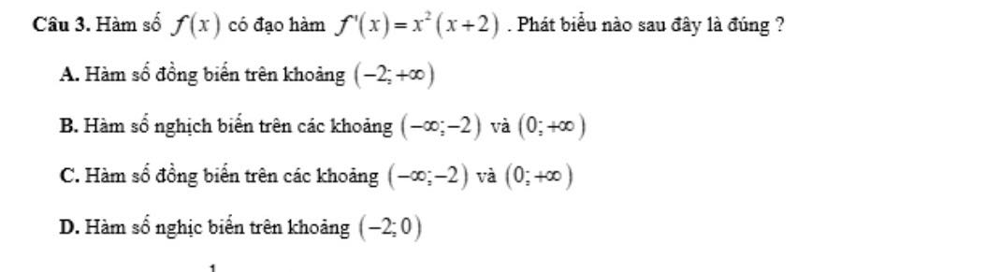

-- Number of words: 112


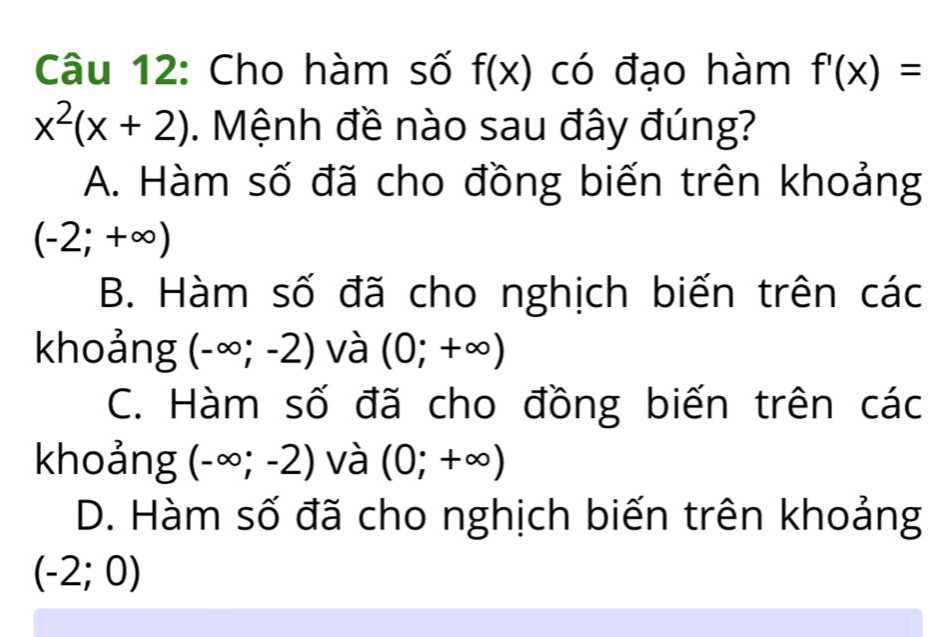

************

PAIRS: 143 - Cosine score: 0.685287094732173
-- Number of words: 69


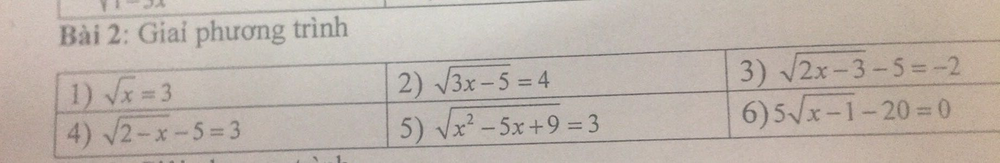

-- Number of words: 75


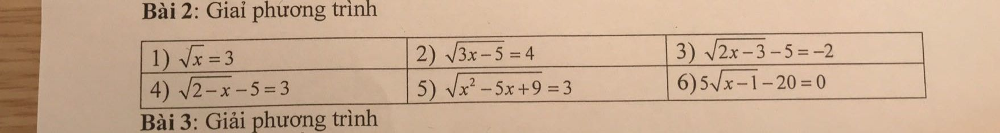

************

PAIRS: 144 - Cosine score: 0.6881705485208081
-- Number of words: 76


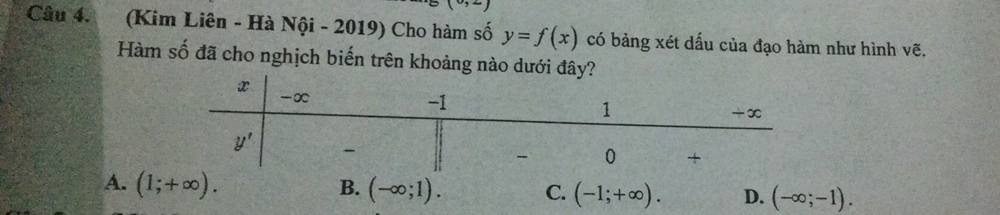

-- Number of words: 86


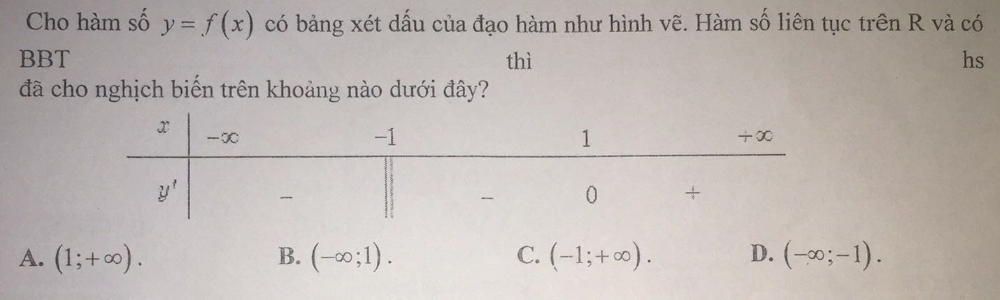

************

PAIRS: 145 - Cosine score: 0.691304178469737
-- Number of words: 40


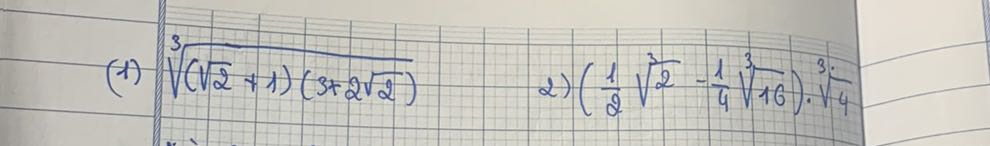

-- Number of words: 42


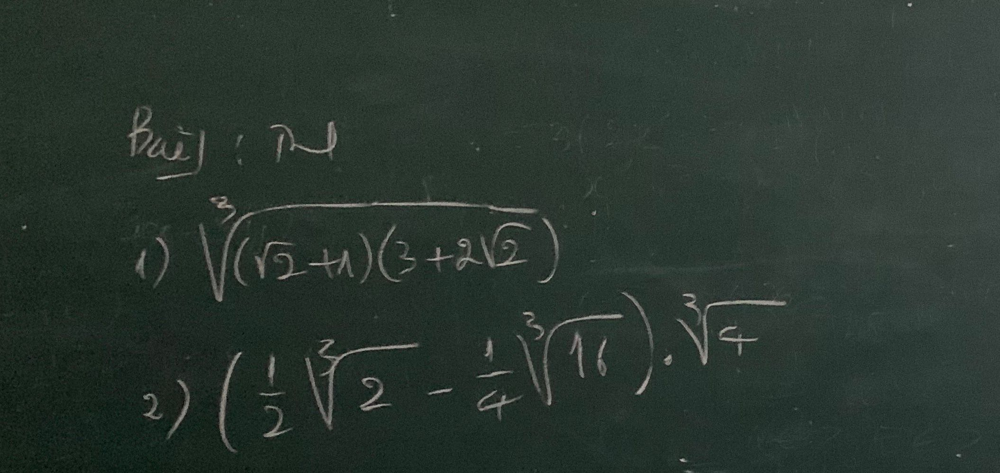

************

PAIRS: 146 - Cosine score: 0.6915774755343651
-- Number of words: 41


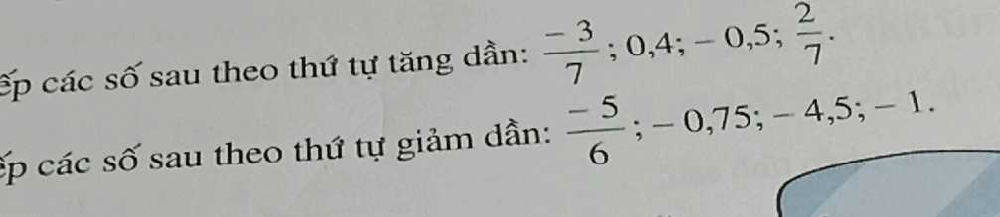

-- Number of words: 47


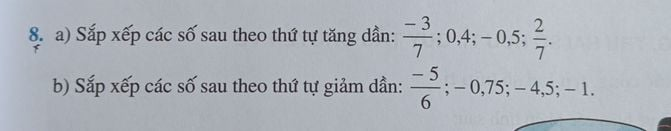

************

PAIRS: 147 - Cosine score: 0.691699679314655
-- Number of words: 60


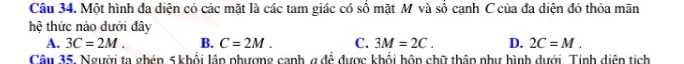

-- Number of words: 57


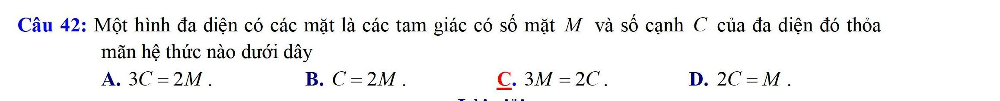

************

PAIRS: 148 - Cosine score: 0.6940579178002251
-- Number of words: 125


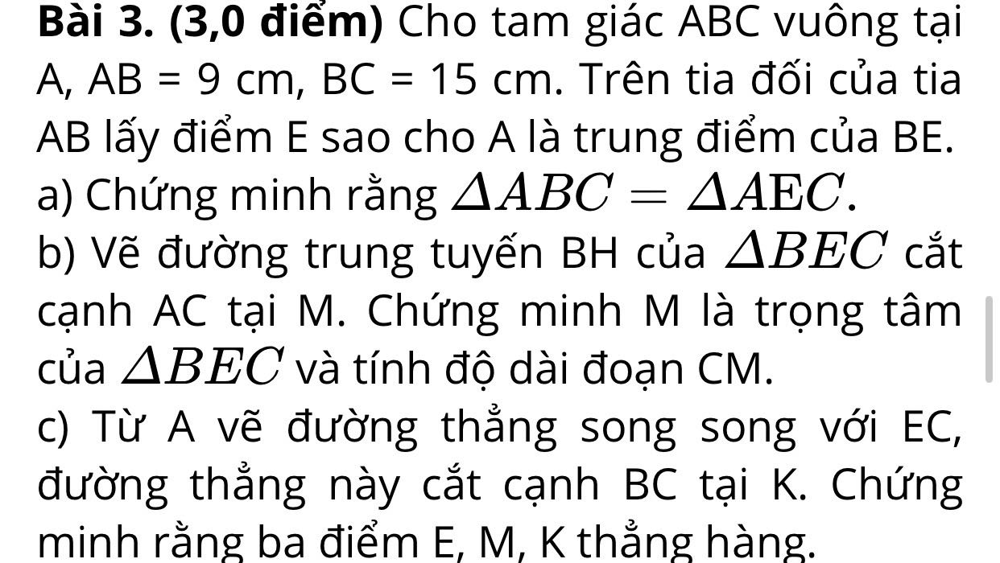

-- Number of words: 132


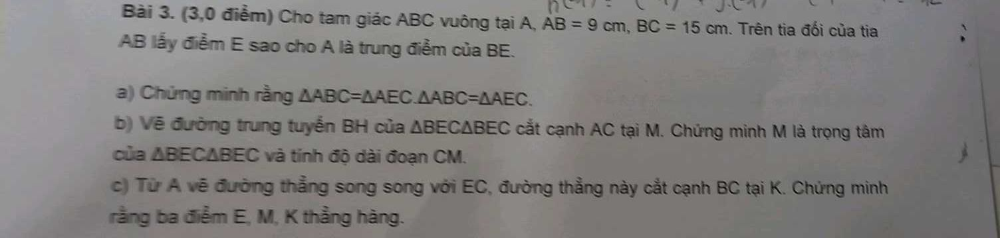

************

PAIRS: 149 - Cosine score: 0.6950061355765718
-- Number of words: 73


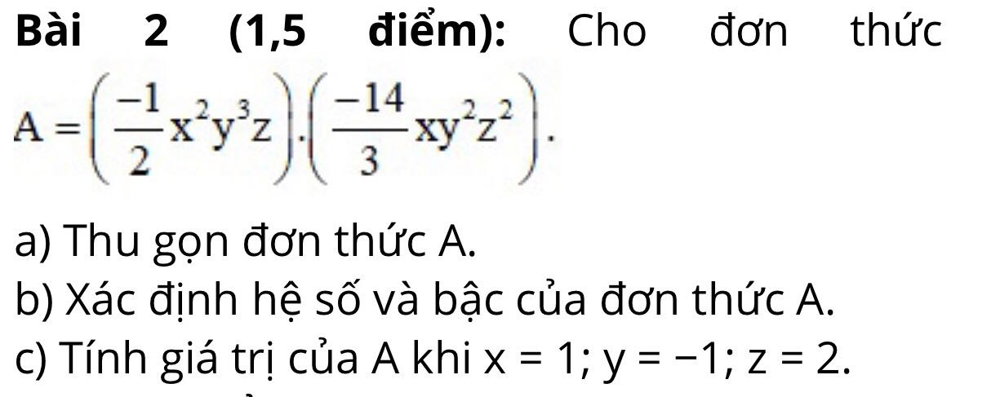

-- Number of words: 67


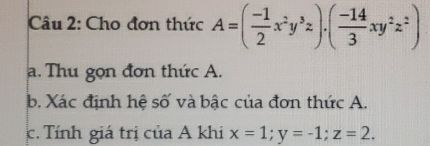

************

PAIRS: 150 - Cosine score: 0.6961326932069459
-- Number of words: 63


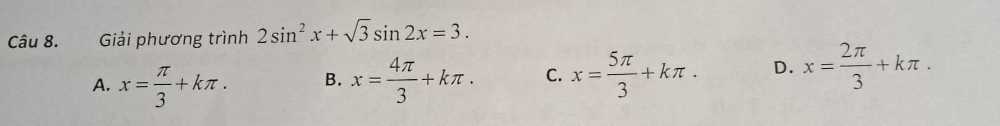

-- Number of words: 64


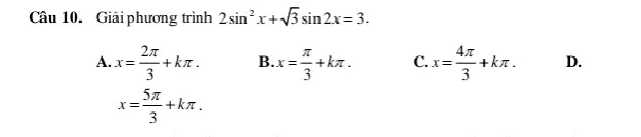

************

PAIRS: 151 - Cosine score: 0.7006136072500256
-- Number of words: 13


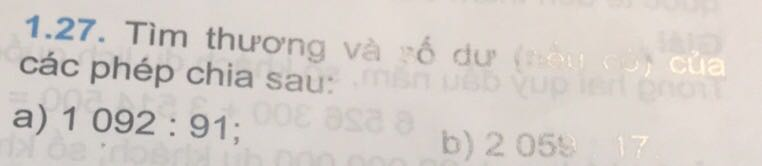

-- Number of words: 28


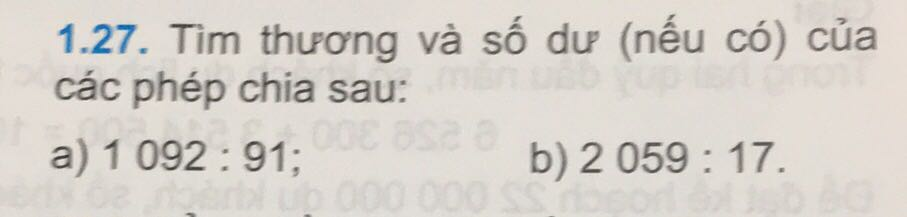

************

PAIRS: 152 - Cosine score: 0.7022280903846332
-- Number of words: 24


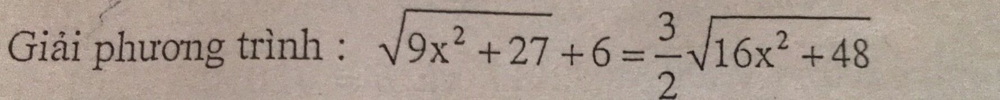

-- Number of words: 26


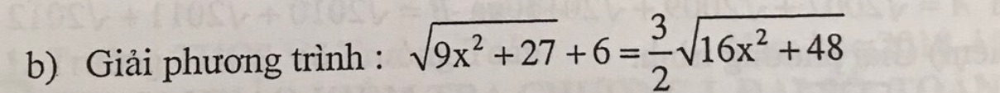

************

PAIRS: 153 - Cosine score: 0.7103206267158972
-- Number of words: 58


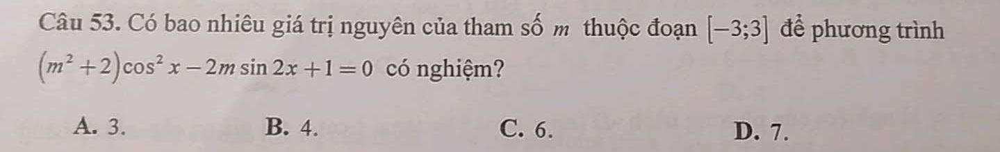

-- Number of words: 58


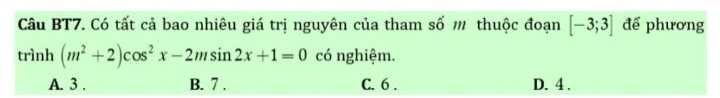

************

PAIRS: 154 - Cosine score: 0.7107727046153443
-- Number of words: 246


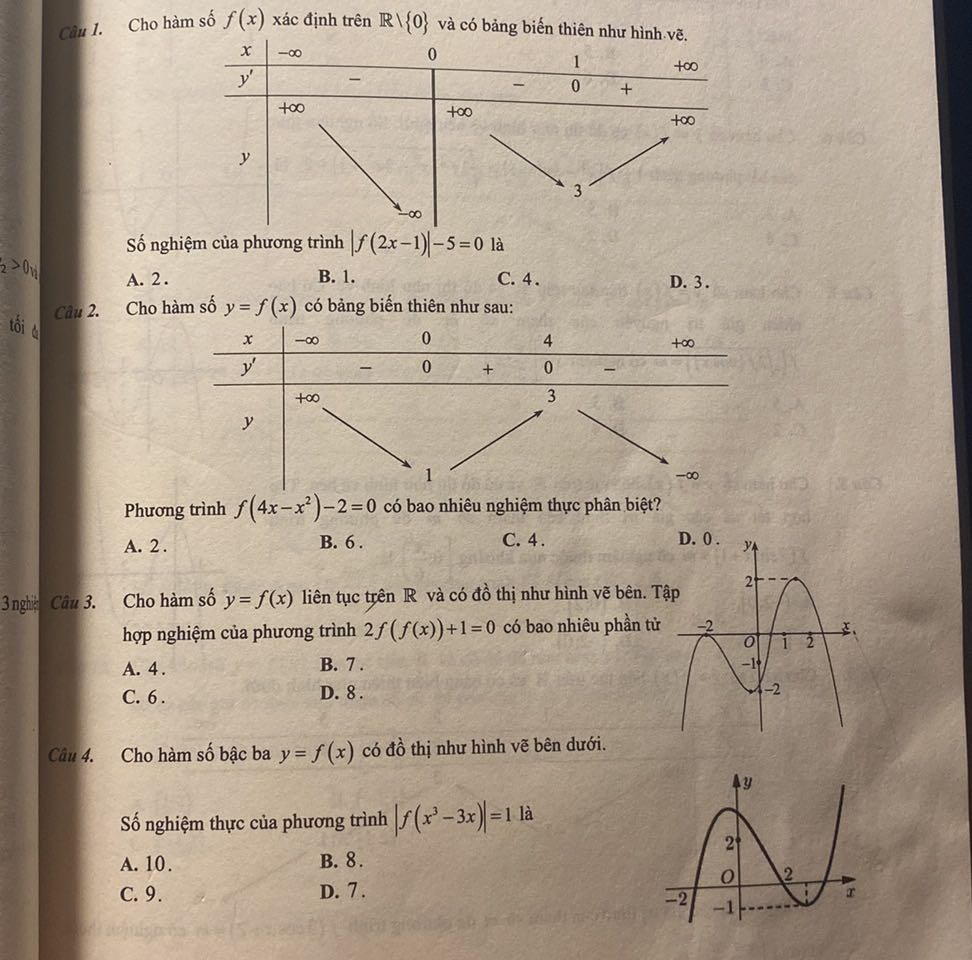

-- Number of words: 64


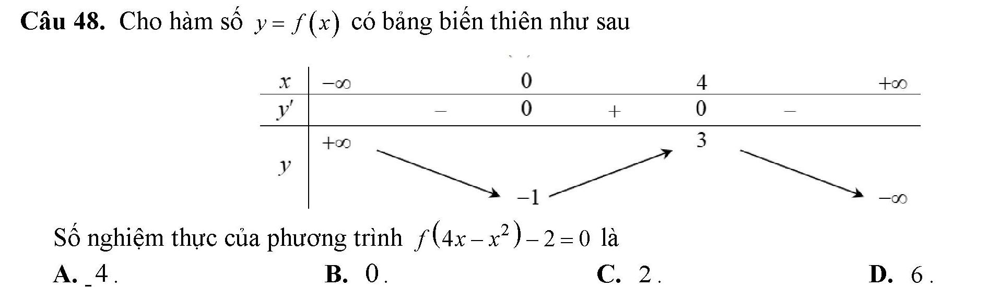

************

PAIRS: 155 - Cosine score: 0.7120933764376527
-- Number of words: 86


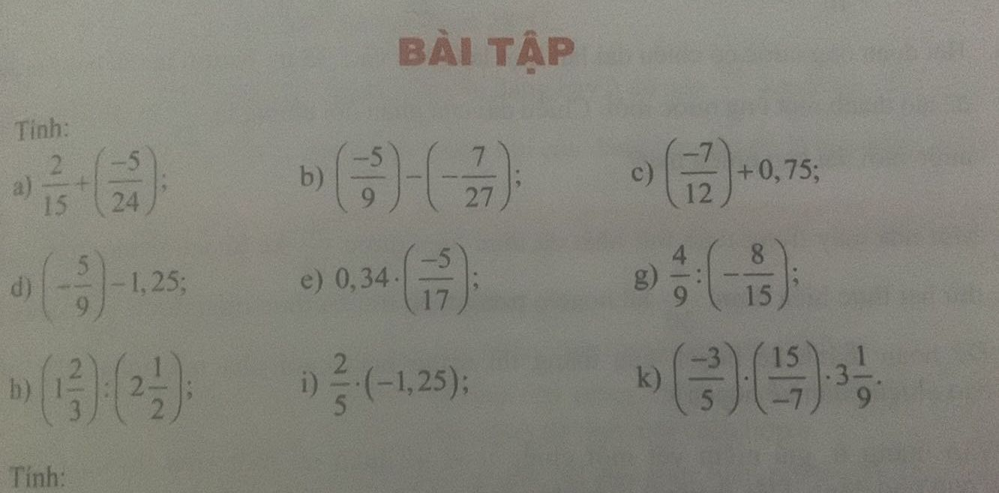

-- Number of words: 93


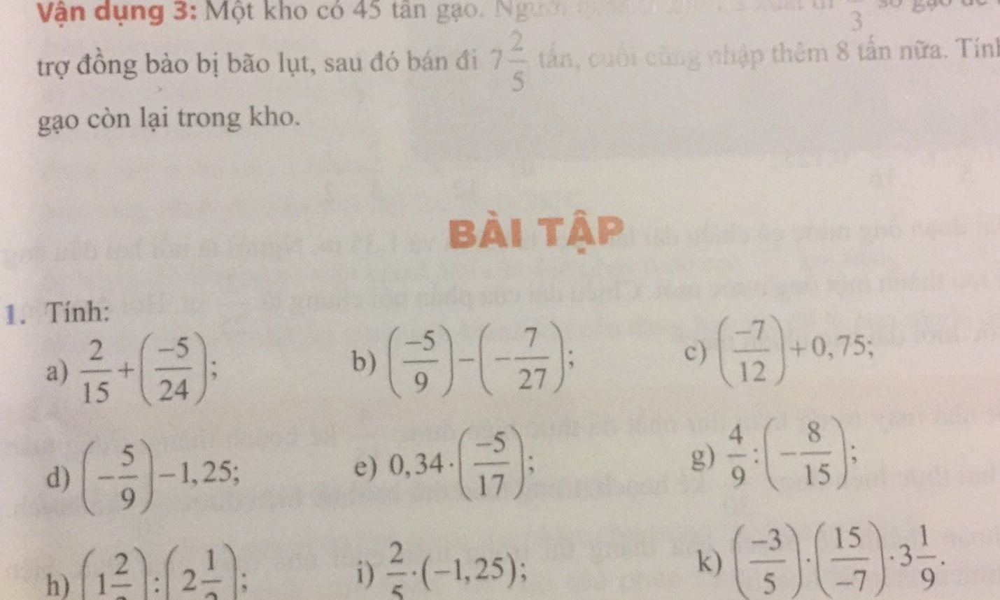

************

PAIRS: 156 - Cosine score: 0.7121675095842019
-- Number of words: 8


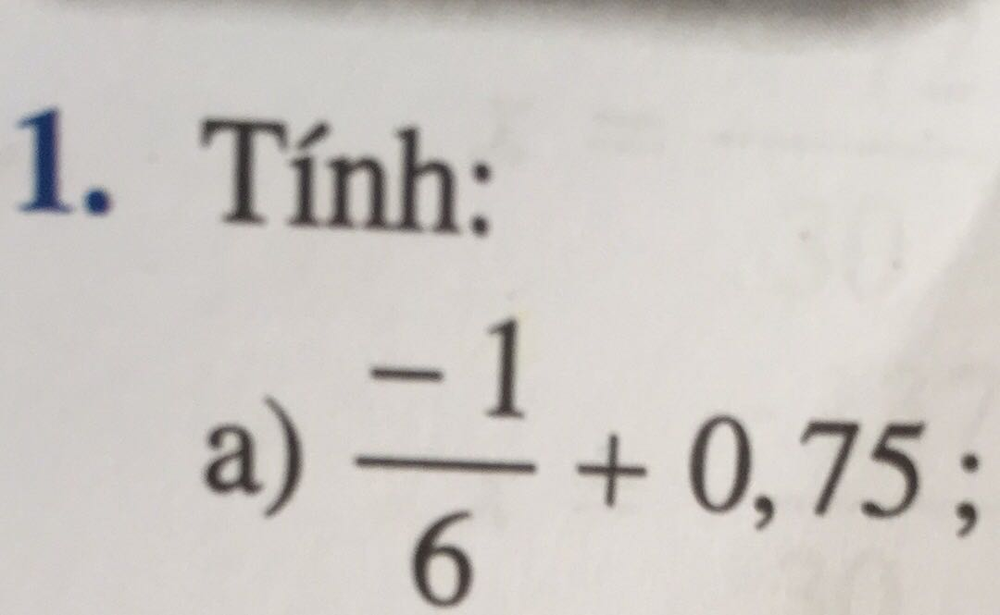

-- Number of words: 6


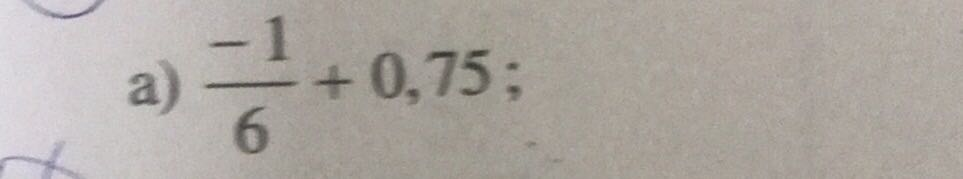

************

PAIRS: 157 - Cosine score: 0.712510134635556
-- Number of words: 60


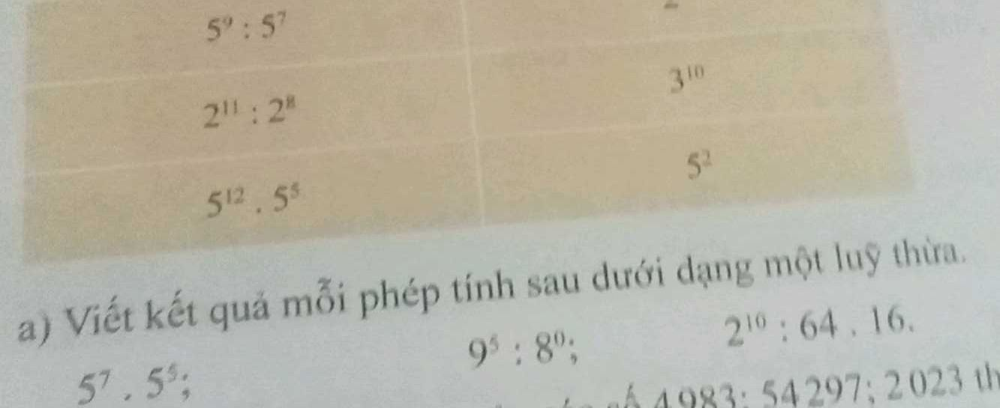

-- Number of words: 34


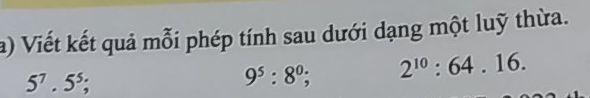

************

PAIRS: 158 - Cosine score: 0.7125340167550729
-- Number of words: 54


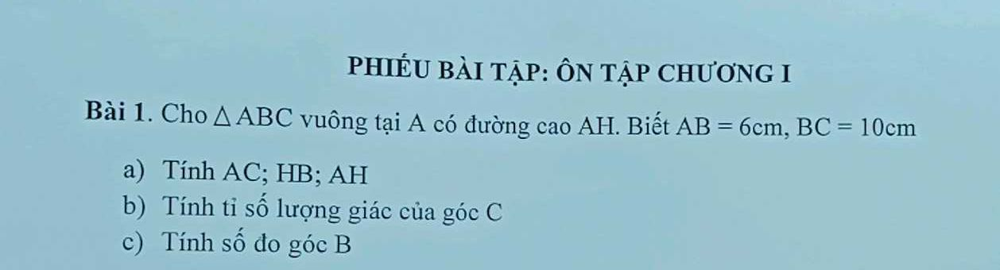

-- Number of words: 50


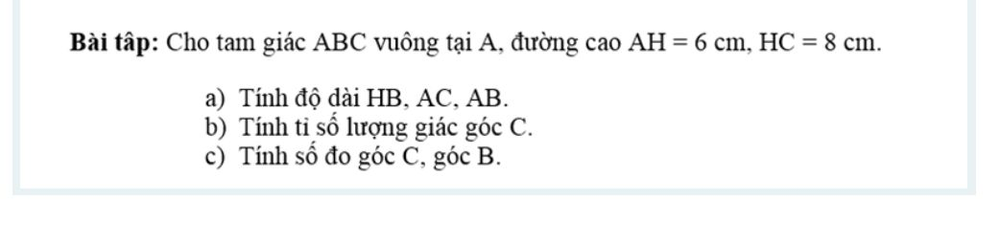

************

PAIRS: 159 - Cosine score: 0.7127577758855834
-- Number of words: 16


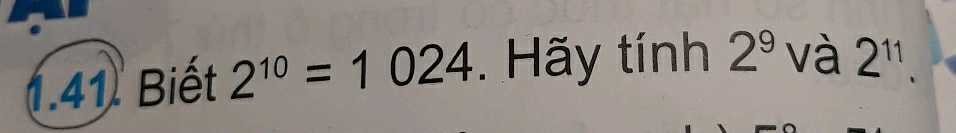

-- Number of words: 16


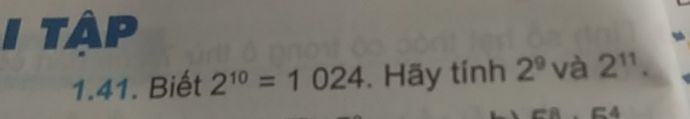

************

PAIRS: 160 - Cosine score: 0.7127577758855834
-- Number of words: 17


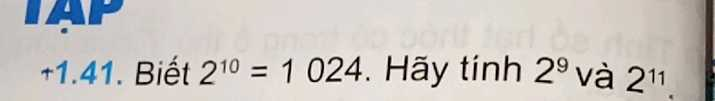

-- Number of words: 16


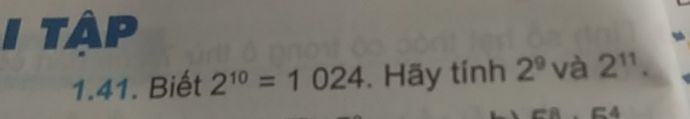

************

PAIRS: 161 - Cosine score: 0.712828266360191
-- Number of words: 14


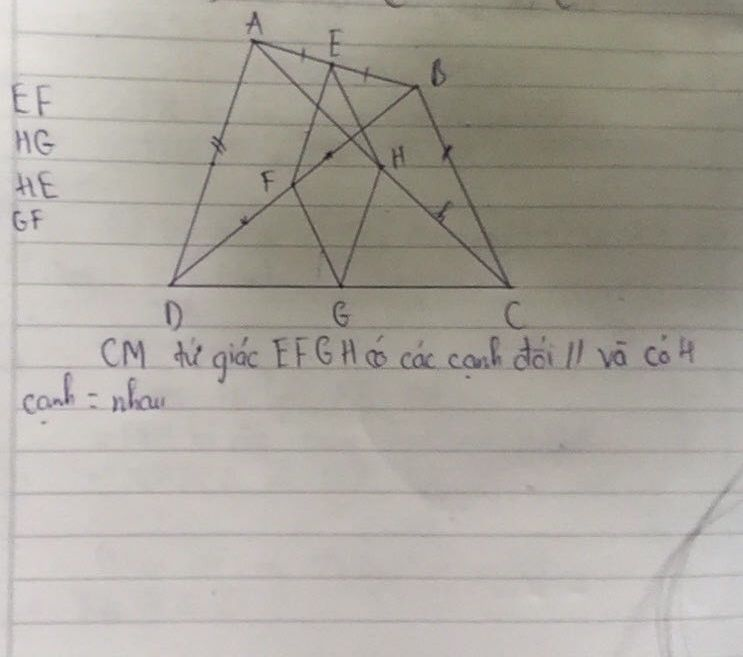

-- Number of words: 14


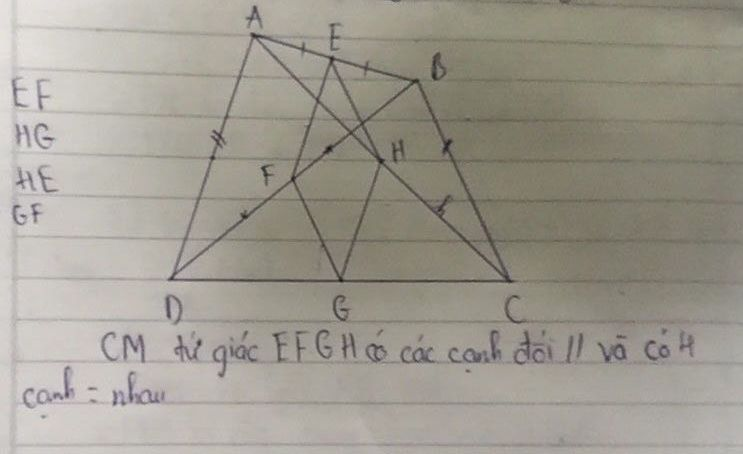

************

PAIRS: 162 - Cosine score: 0.7180686248963644
-- Number of words: 31


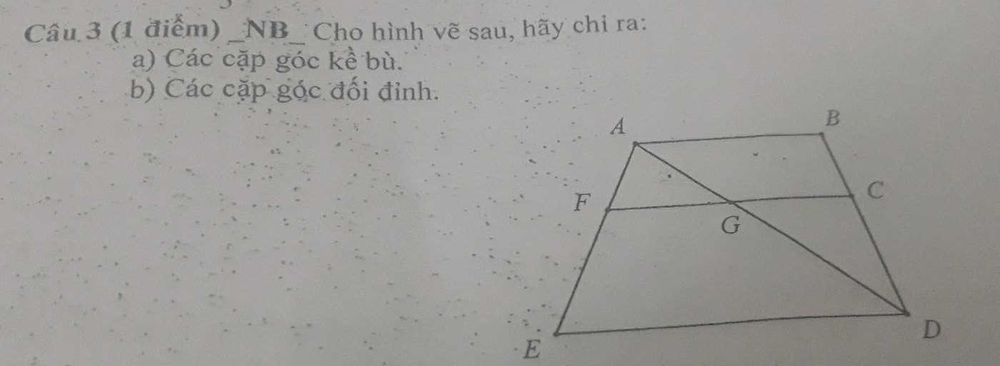

-- Number of words: 31


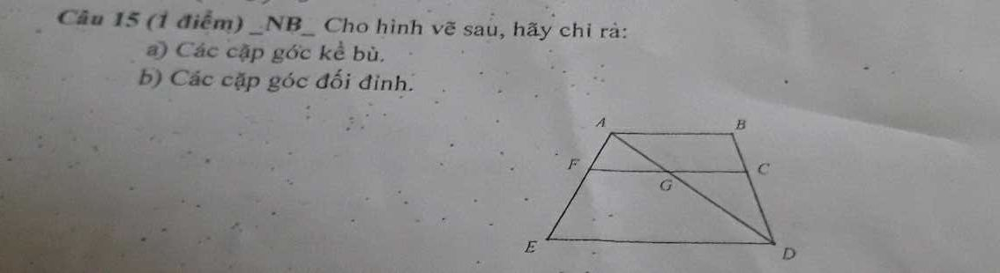

************

PAIRS: 163 - Cosine score: 0.718610851215385
-- Number of words: 95


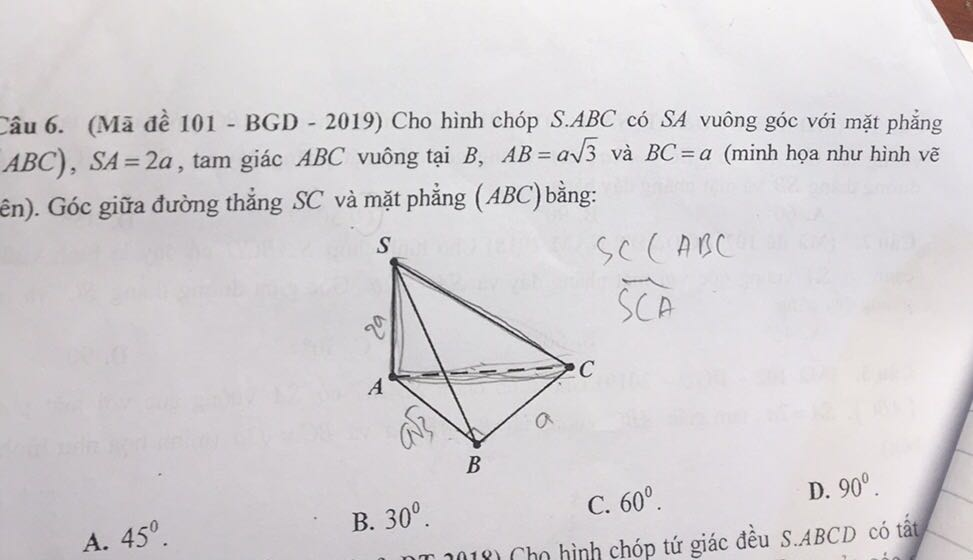

-- Number of words: 76


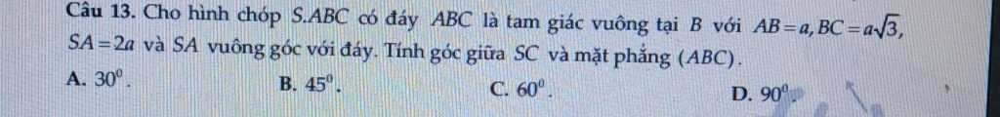

************

PAIRS: 164 - Cosine score: 0.7189239840264288
-- Number of words: 23


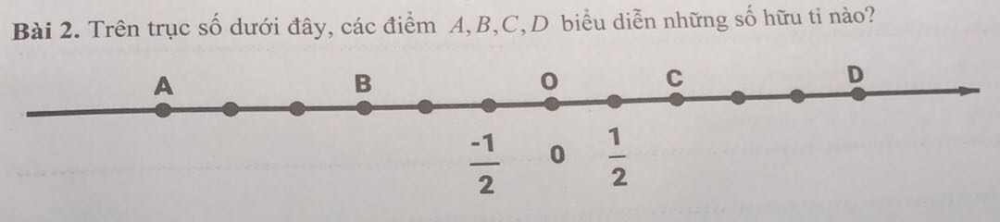

-- Number of words: 54


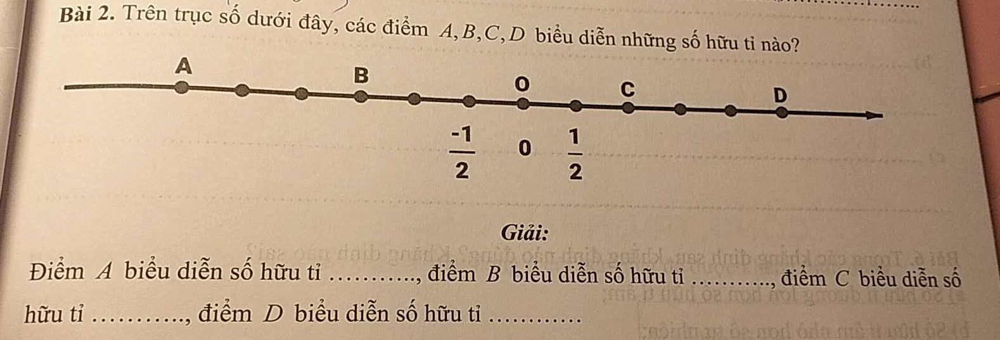

************

PAIRS: 165 - Cosine score: 0.7204020938783398
-- Number of words: 29


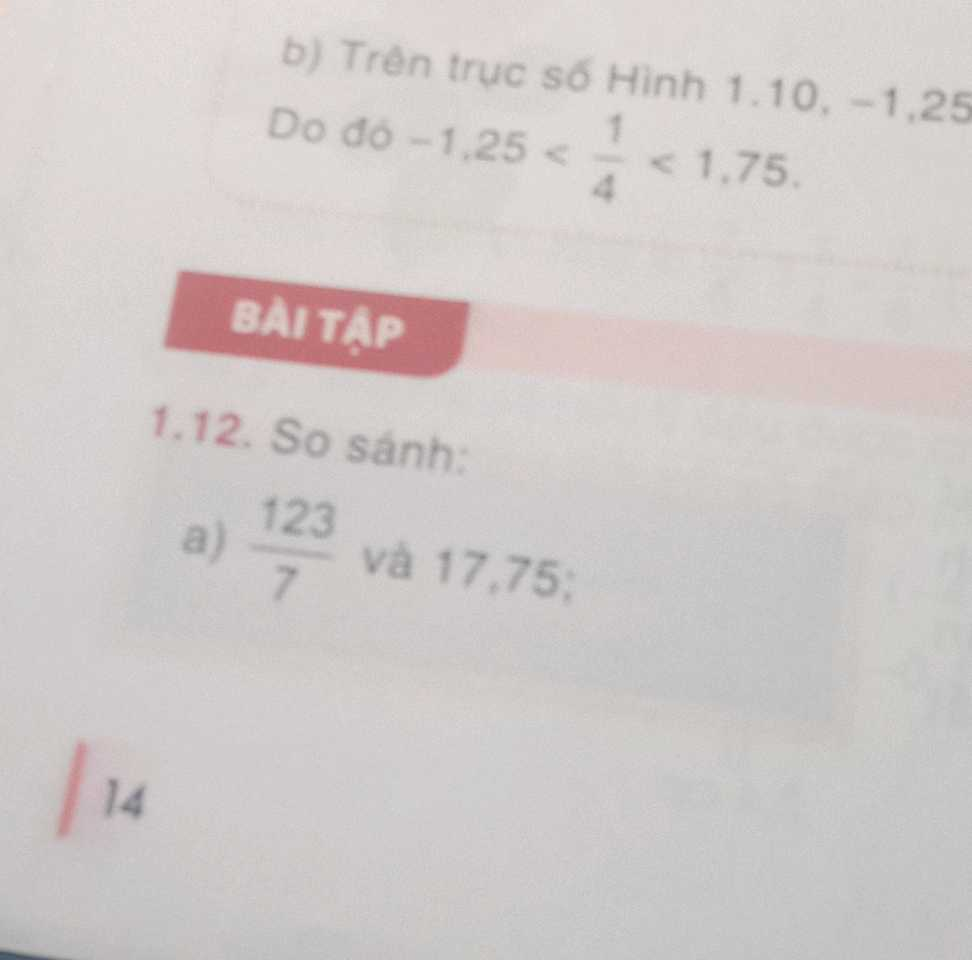

-- Number of words: 25


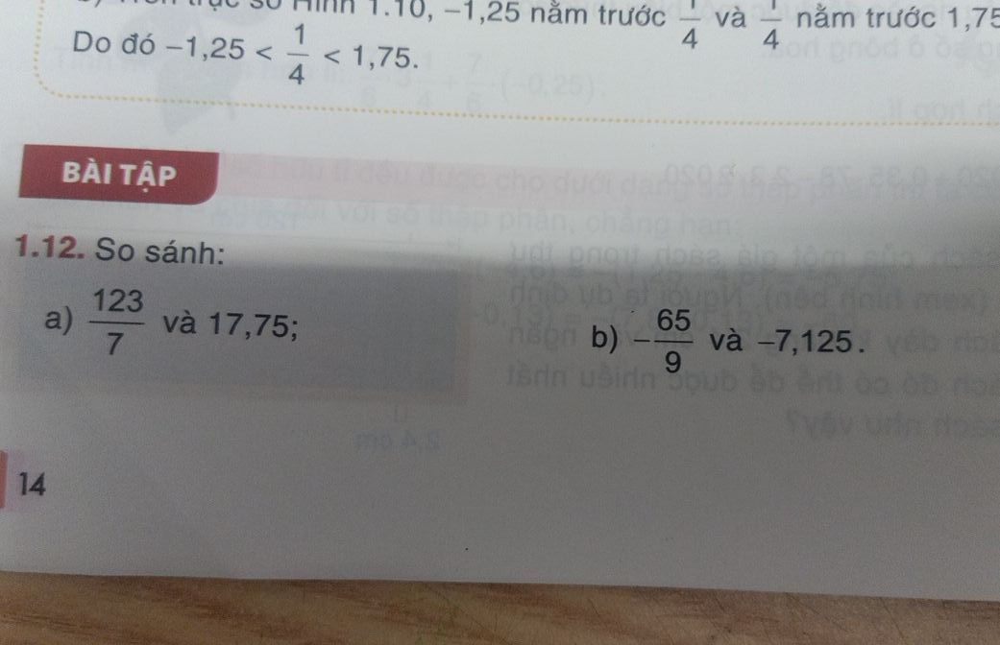

************

PAIRS: 166 - Cosine score: 0.7226013862339364
-- Number of words: 65


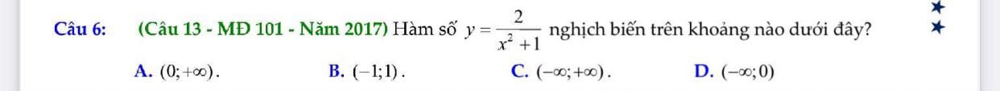

-- Number of words: 60


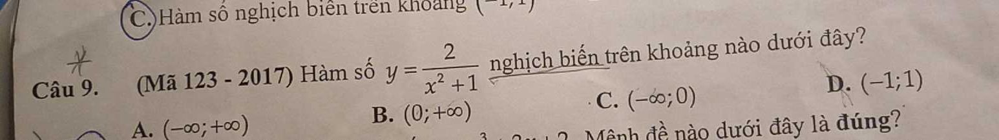

************

PAIRS: 167 - Cosine score: 0.7230963398242889
-- Number of words: 58


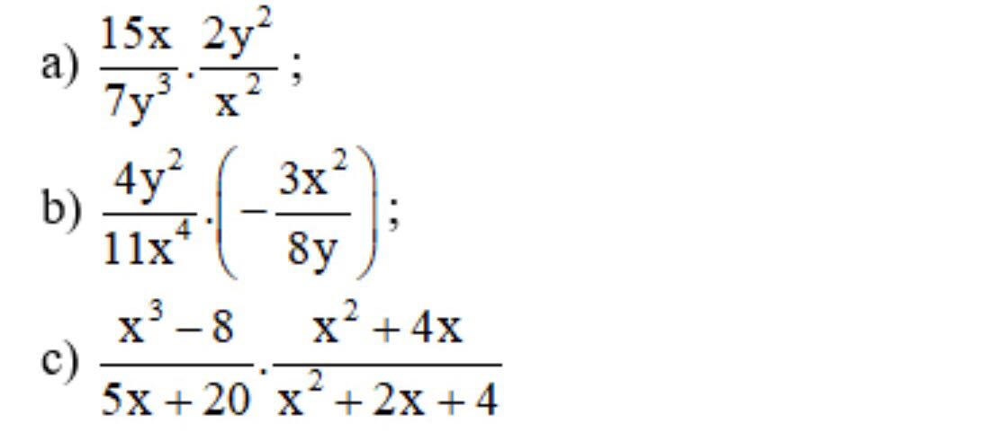

-- Number of words: 67


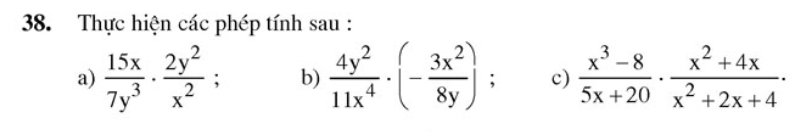

************

PAIRS: 168 - Cosine score: 0.7248096614284532
-- Number of words: 70


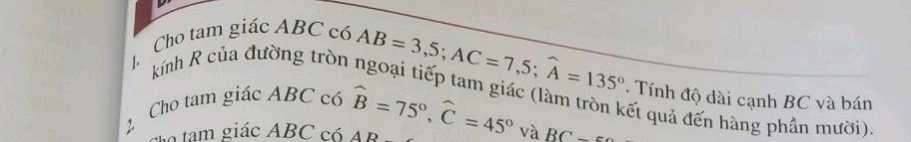

-- Number of words: 46


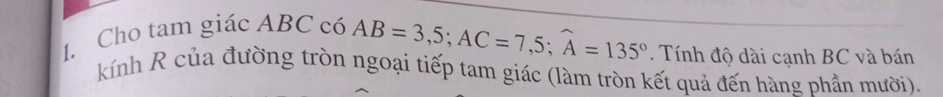

************

PAIRS: 169 - Cosine score: 0.7253367475329647
-- Number of words: 12


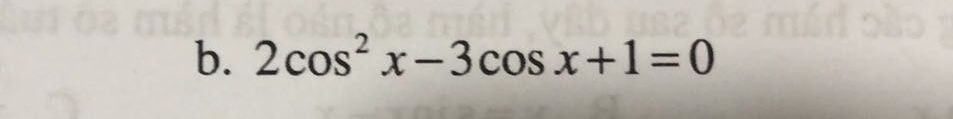

-- Number of words: 16


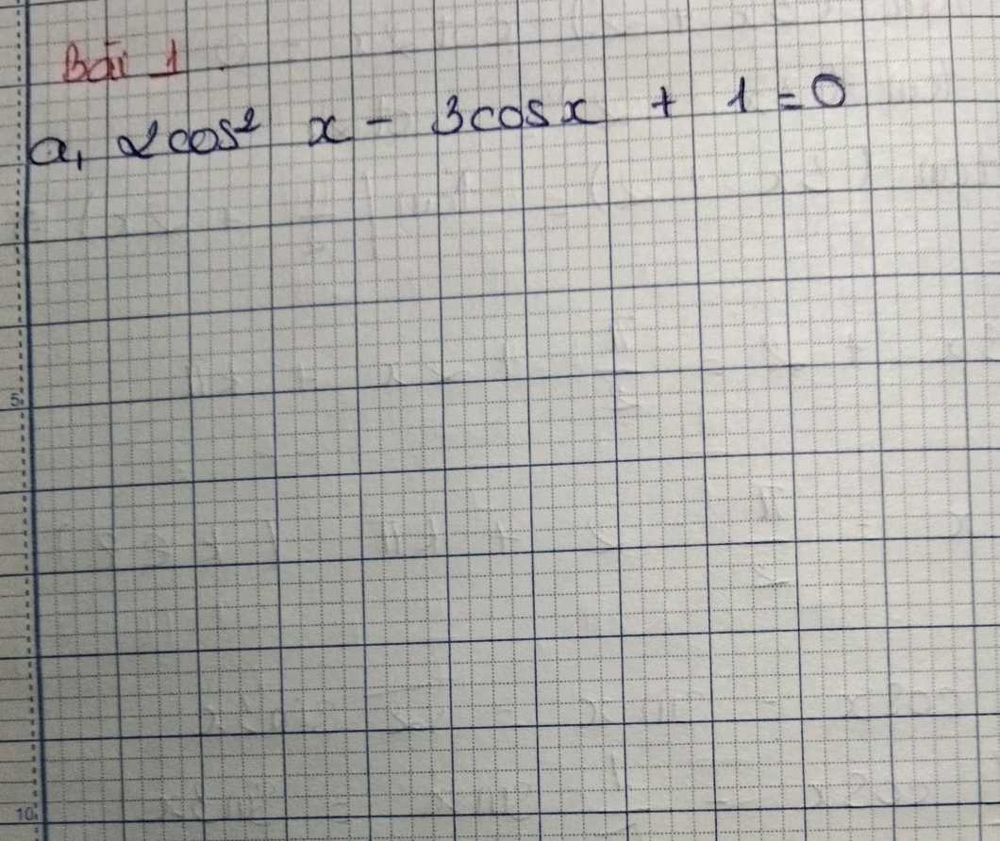

************

PAIRS: 170 - Cosine score: 0.7264155975557756
-- Number of words: 15


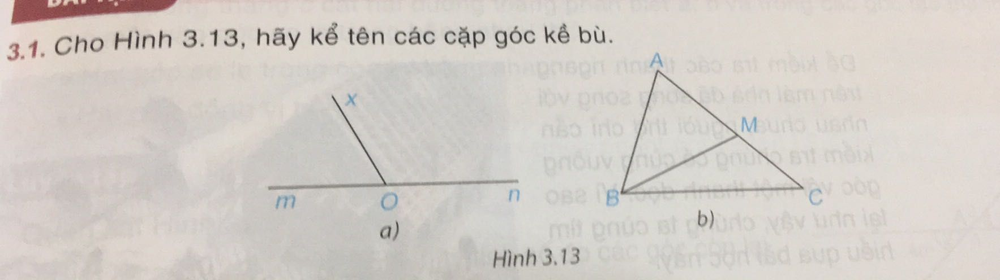

-- Number of words: 19


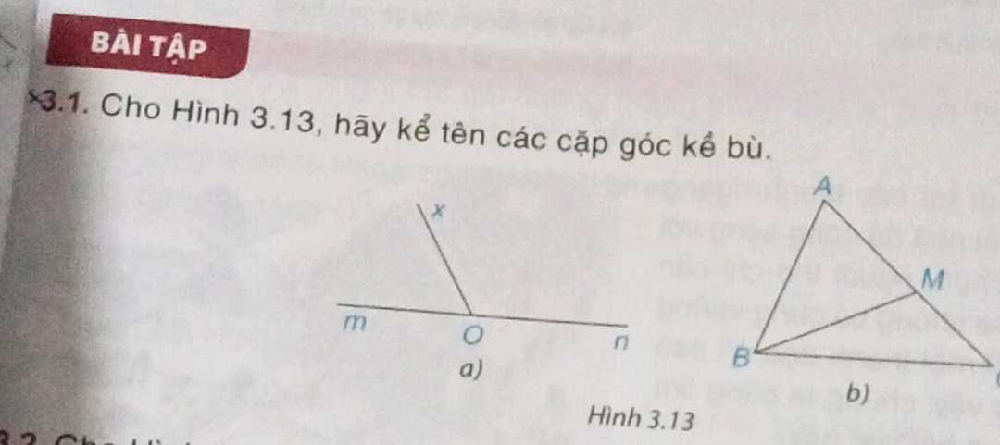

************

PAIRS: 171 - Cosine score: 0.7264155975557756
-- Number of words: 16


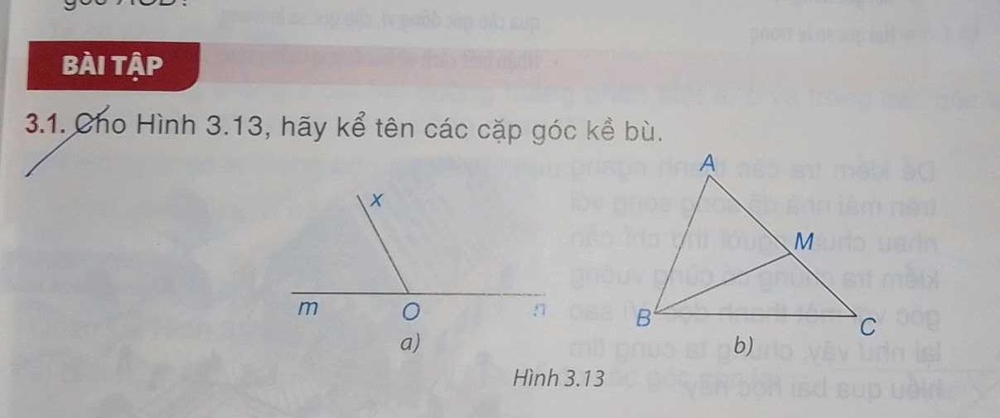

-- Number of words: 19


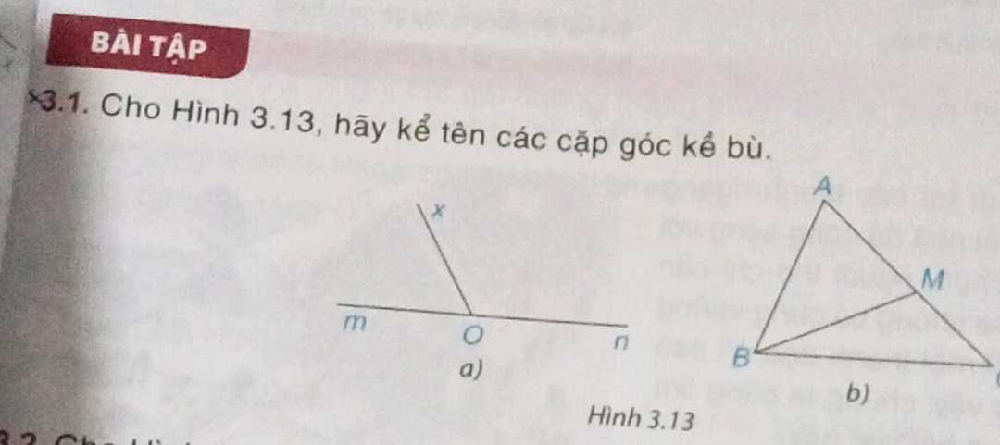

************

PAIRS: 172 - Cosine score: 0.7290304449352597
-- Number of words: 65


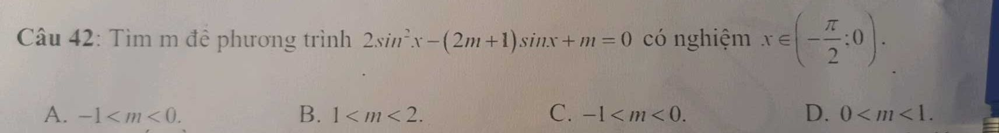

-- Number of words: 65


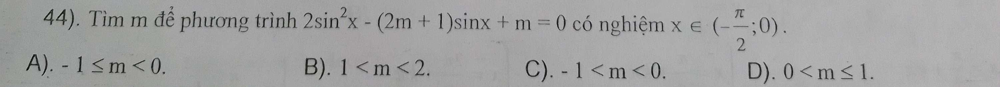

************

PAIRS: 173 - Cosine score: 0.7299557144975704
-- Number of words: 32


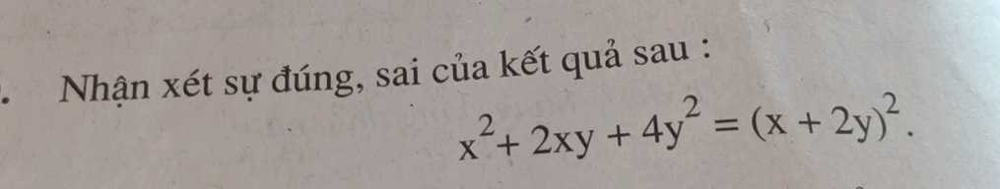

-- Number of words: 33


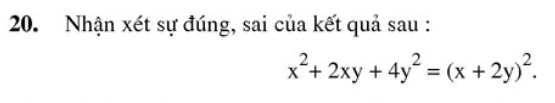

************

PAIRS: 174 - Cosine score: 0.730614984521229
-- Number of words: 23


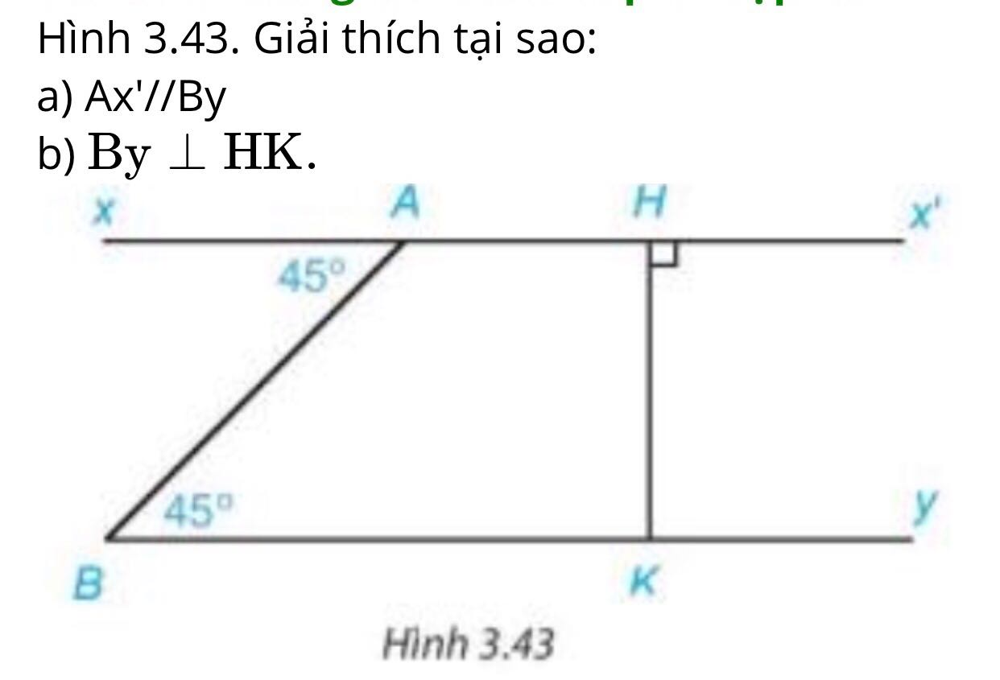

-- Number of words: 28


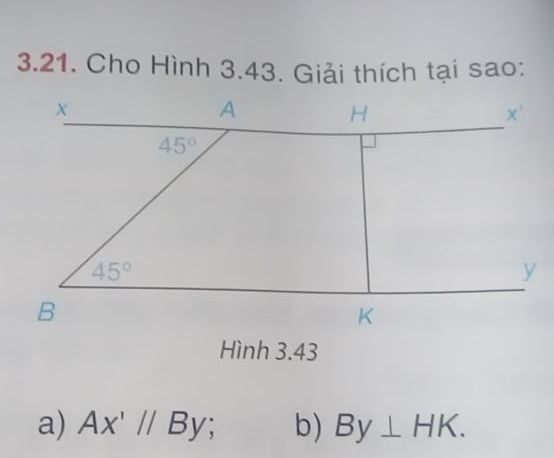

************

PAIRS: 175 - Cosine score: 0.7342553715144133
-- Number of words: 68


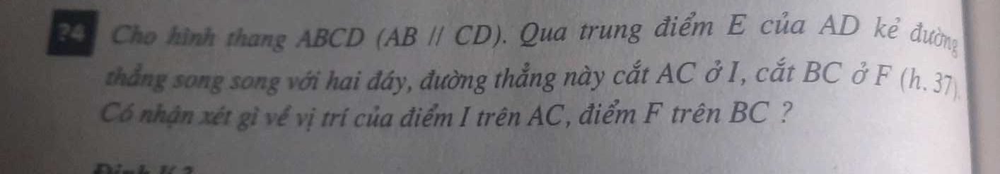

-- Number of words: 71


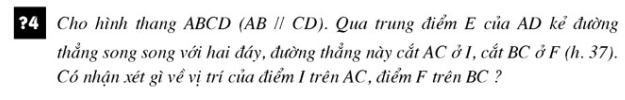

************

PAIRS: 176 - Cosine score: 0.7349463418426805
-- Number of words: 59


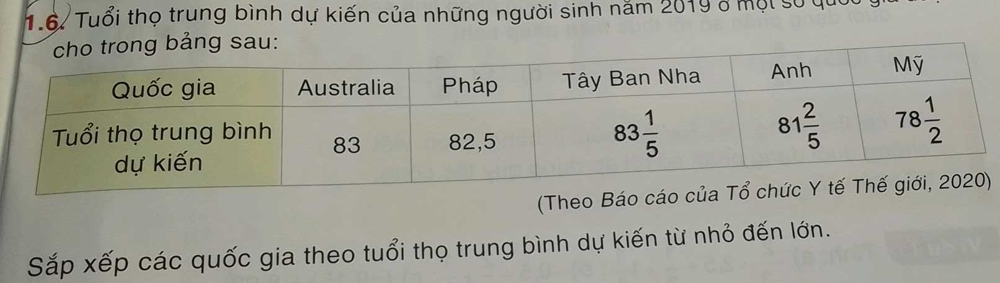

-- Number of words: 54


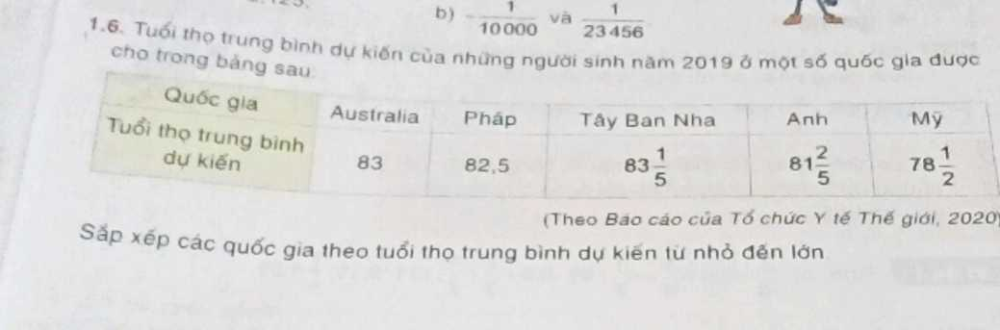

************

PAIRS: 177 - Cosine score: 0.735515473326865
-- Number of words: 30


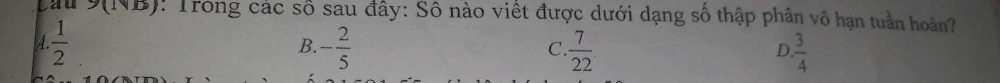

-- Number of words: 32


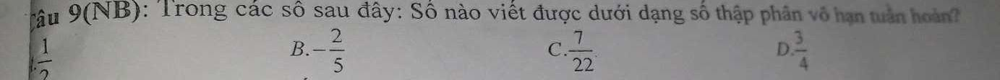

************

PAIRS: 178 - Cosine score: 0.737252750419866
-- Number of words: 222


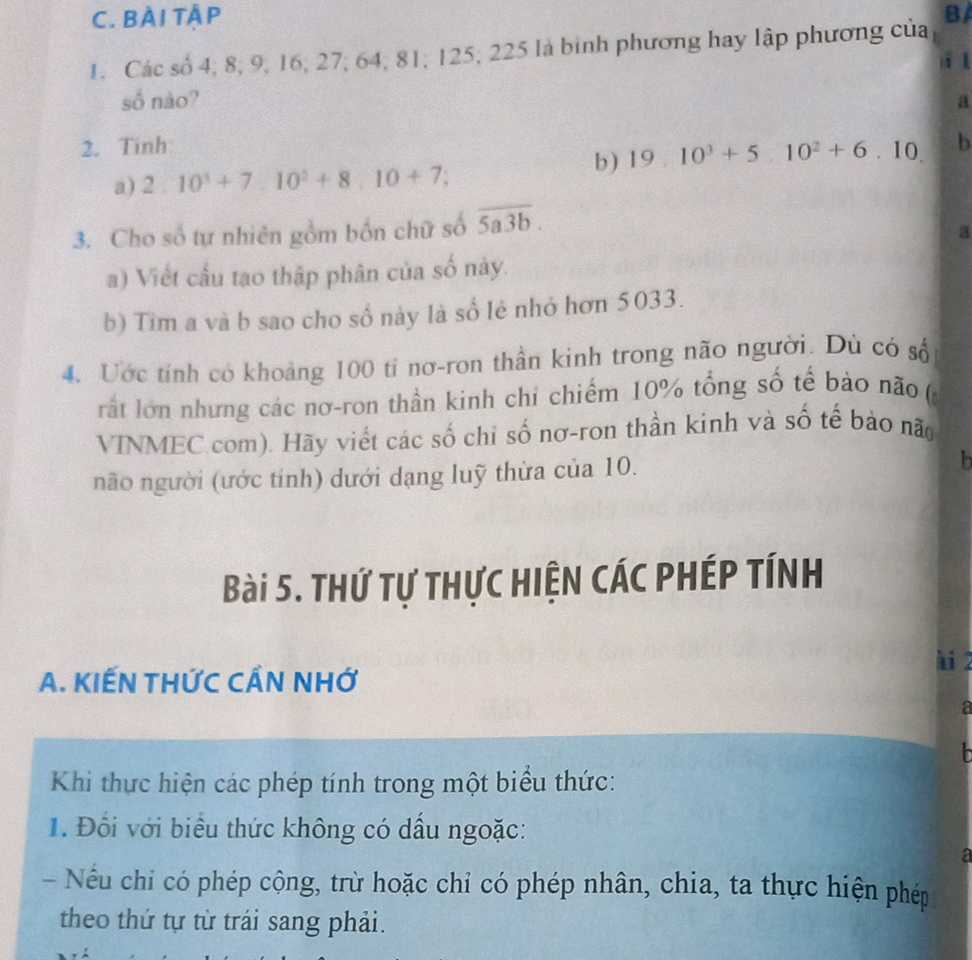

-- Number of words: 178


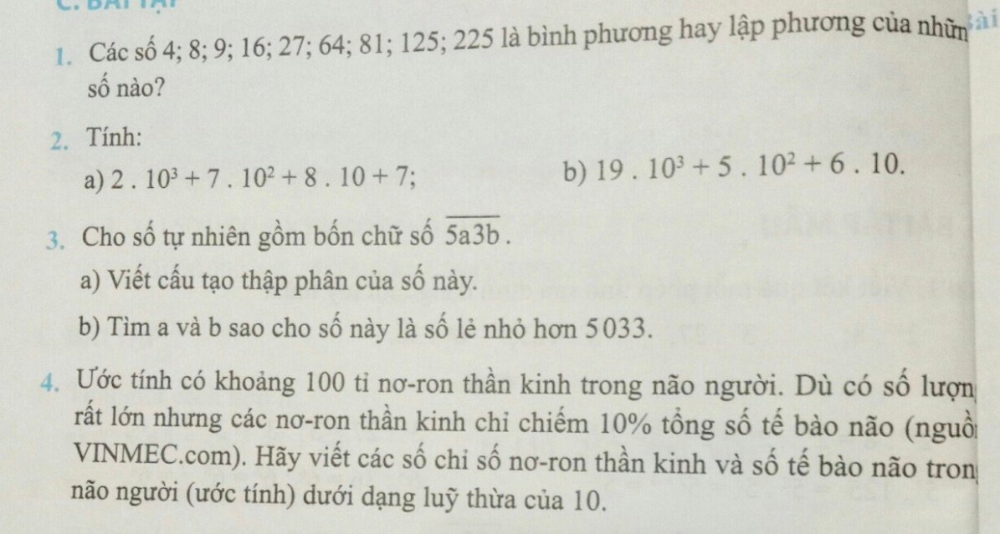

************

PAIRS: 179 - Cosine score: 0.7383211437183017
-- Number of words: 45


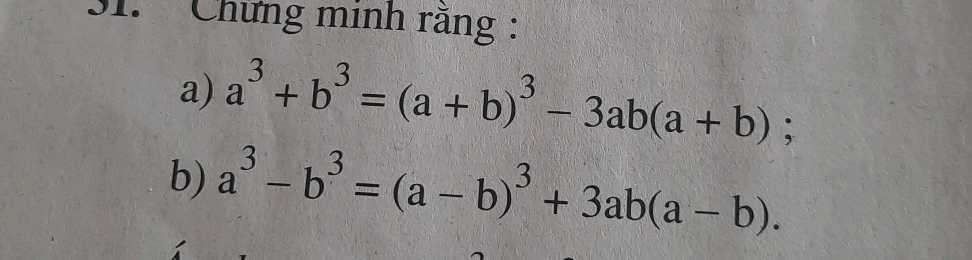

-- Number of words: 42


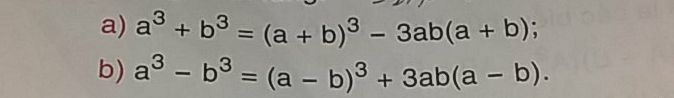

************

PAIRS: 180 - Cosine score: 0.7389806551898841
-- Number of words: 128


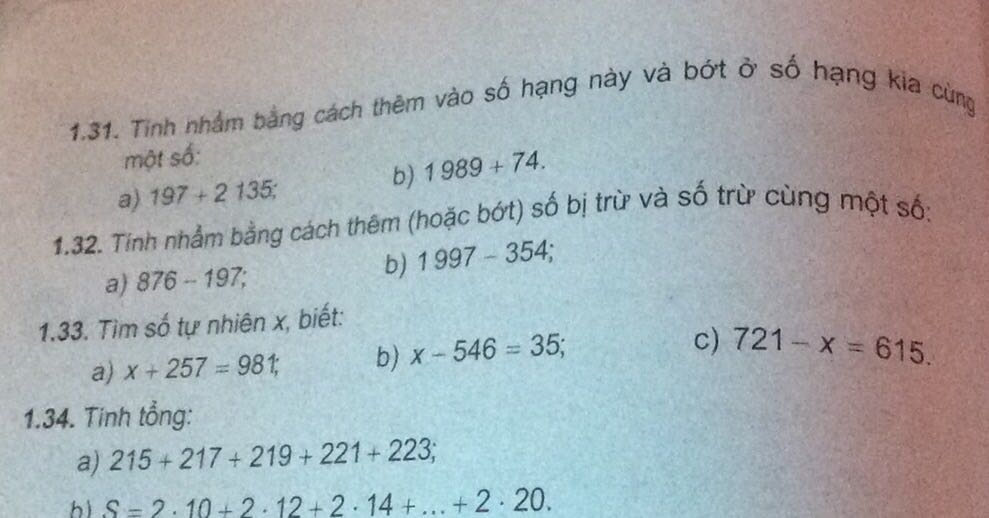

-- Number of words: 59


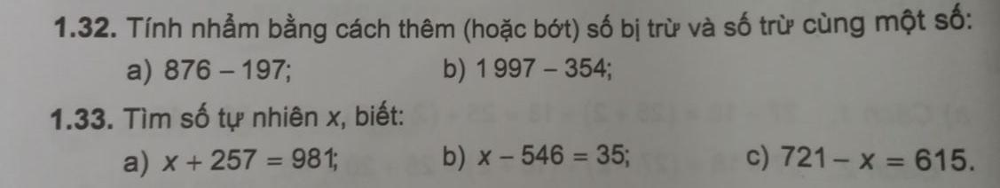

************

PAIRS: 181 - Cosine score: 0.7401413470872105
-- Number of words: 81


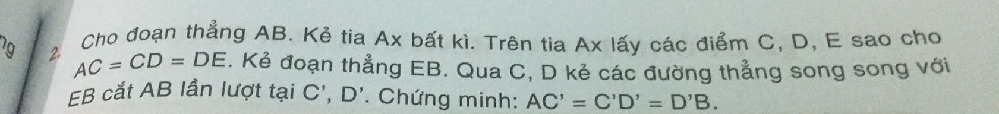

-- Number of words: 76


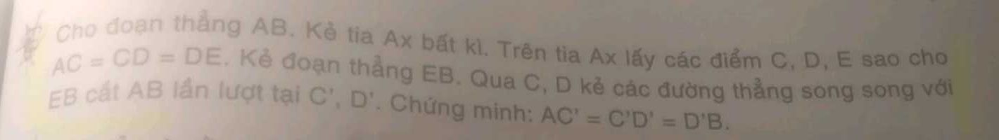

************

PAIRS: 182 - Cosine score: 0.7436622698559118
-- Number of words: 42


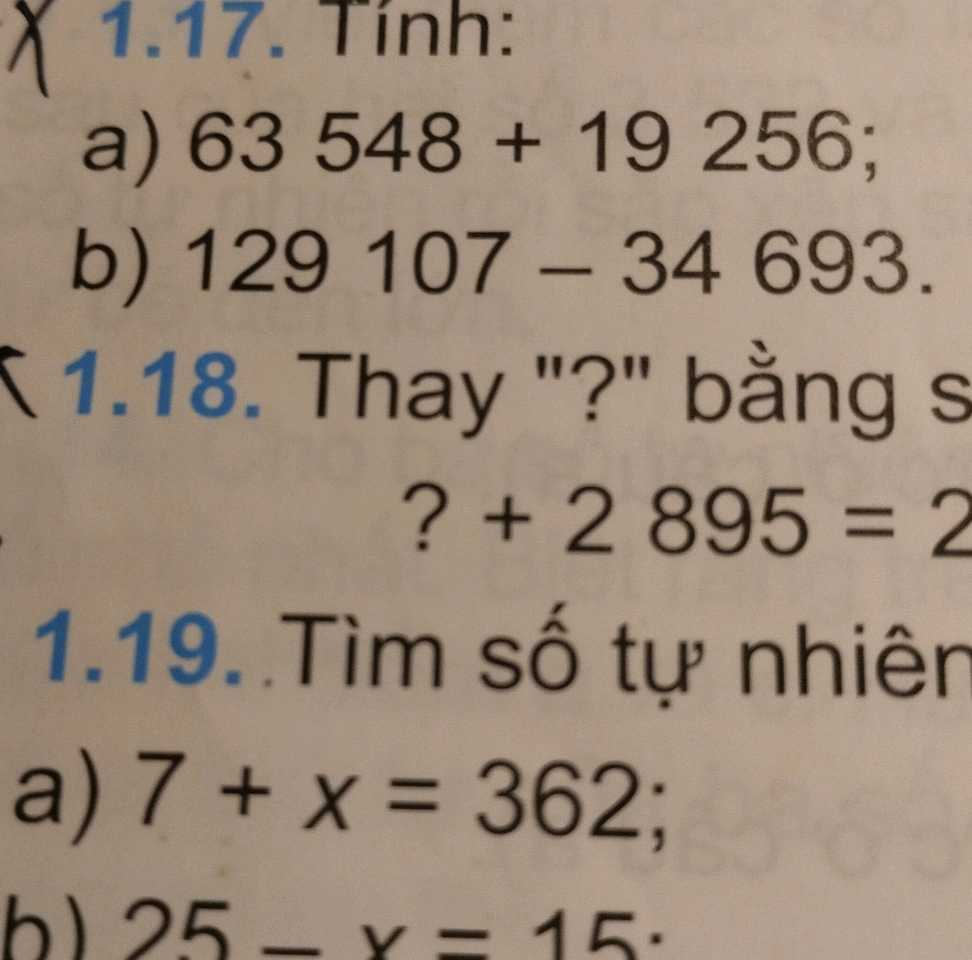

-- Number of words: 31


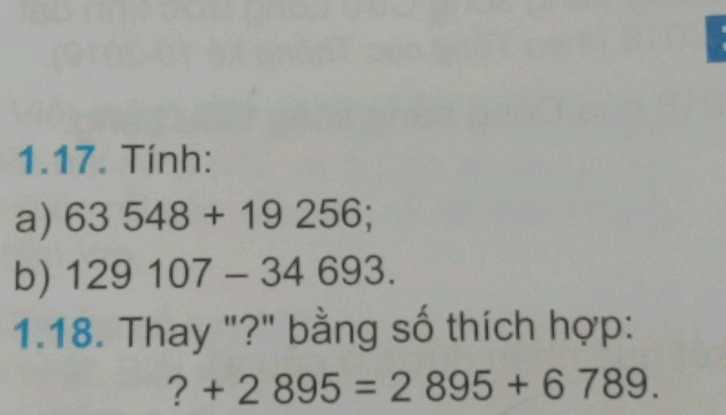

************

PAIRS: 183 - Cosine score: 0.744078735031612
-- Number of words: 33


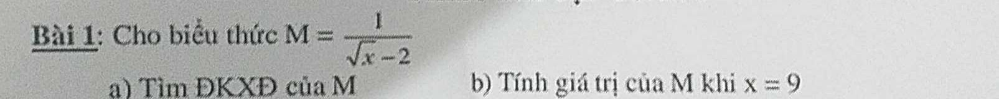

-- Number of words: 33


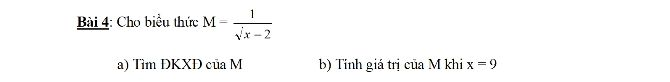

************

PAIRS: 184 - Cosine score: 0.745664346286959
-- Number of words: 33


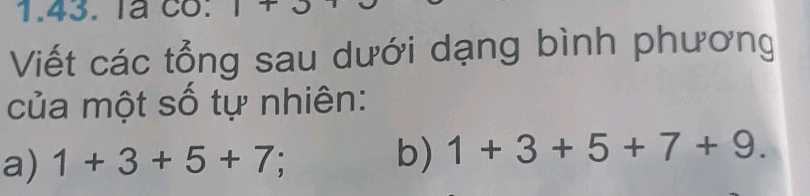

-- Number of words: 33


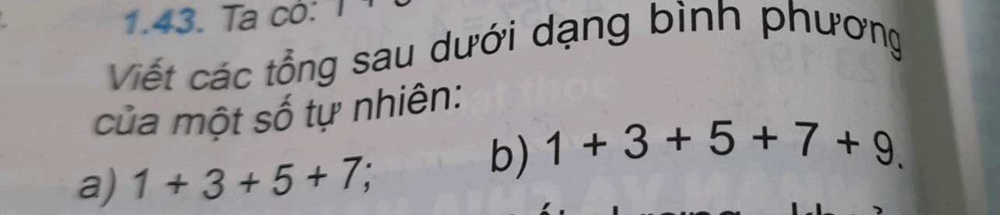

************

PAIRS: 185 - Cosine score: 0.7476270572983142
-- Number of words: 17


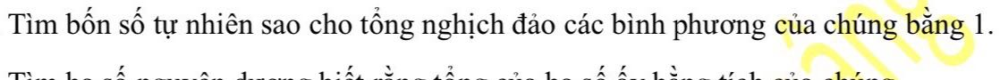

-- Number of words: 20


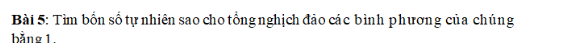

************

PAIRS: 186 - Cosine score: 0.747763938082539
-- Number of words: 13


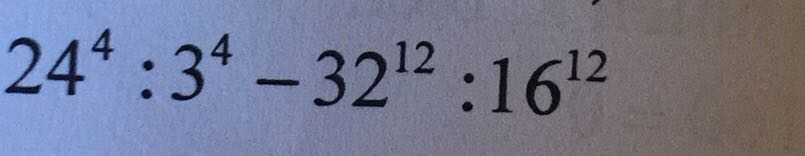

-- Number of words: 17


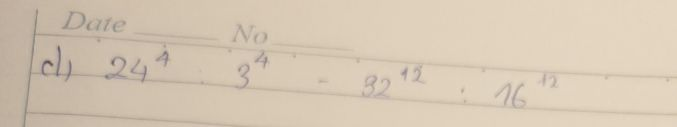

************



In [89]:
idx = 0
# end = 20
for url1 in df_test2['Question Image'].values:
    print('PAIRS: {} - Cosine score: {}'.format(idx + 1, df_test2['score'].values[idx]))
    print('-- Number of words:', df_test2['word_count_lookup'].values[idx])
    img0 = Disp.Image(requests.get(df_test2['Lookup Image'].values[idx]).content)
    display(img0)
    print('-- Number of words:', df_test2['word_count_question'].values[idx])
    img1 = Disp.Image(requests.get(url1).content)
    display(img1)
#     print('-- Number of words:', df_test['cosine_word_count_question'].values[idx])
#     img2 = Disp.Image(requests.get(url2).content)
#     display(img2)
    print('************')
    print()
    idx += 1

In [ ]:
sb.set_theme()
plt.figure(figsize=(20,8))
plt.subplot(121)
sb.distplot(df_pos['word_count_lookup'], hist = False, rug = True, kde_kws={'shade':'kde_kws'}, label='User Questions')
sb.distplot(df_pos['word_count_question'],hist = False, rug = True, kde_kws={'shade':'kde_kws'}, label='SE Answers')
plt.title('MATCH')
plt.legend()
plt.subplot(122)
sb.distplot(df_neg['word_count_lookup'], hist = False, rug = True, kde_kws={'shade':'kde_kws'}, label='User Questions')
sb.distplot(df_neg['word_count_question'],hist = False, rug = True, kde_kws={'shade':'kde_kws'}, label='SE Answers')
plt.ylim([0, 0.01])
plt.title('NOT MATCH')
plt.legend()
plt.suptitle('Distribution of words', fontsize = 20, color = 'r');

In [ ]:
mask1 = df['Human Feedback'] == 'NOT MATCH'
mask2 = df['Human Feedback'] == 'MATCH'

df_neg = df[mask1].reset_index(drop = True)
df_pos = df[mask2].reset_index(drop = True)

print(df_neg.shape)
print(df_pos.shape)

In [ ]:
df['diff_word'] = abs(df['word_count_question'] - df['word_count_lookup'])
df_neg['diff_word'] = abs(df_neg['word_count_question'] - df_neg['word_count_lookup'])
df_pos['diff_word'] = abs(df_pos['word_count_question'] - df_pos['word_count_lookup'])

my_bins = [-np.inf, 5, 10, 15, 20, np.inf]
my_labels = ['Very low', 'Low', 'Medium', 'High', 'Very high']

df['diff_bin'] = pd.cut(df['diff_word'], bins=my_bins, labels=my_labels)
df_neg['diff_bin'] = pd.cut(df_neg['diff_word'], bins=my_bins, labels=my_labels)
df_pos['diff_bin'] = pd.cut(df_pos['diff_word'], bins=my_bins, labels=my_labels)

In [ ]:
plt.figure(figsize=(20, 8))
plt.subplot(121)
sb.countplot(df_pos['diff_bin'])
plt.title('MATCH')
plt.subplot(122)
sb.countplot(df_neg['diff_bin'])
plt.title('NOT MATCH')
plt.suptitle('Bins of words diffirence', fontsize = 20, color = 'r');

In [ ]:
tf_pos = TfidfVectorizer(analyzer = 'word', stop_words = stop_words, min_df=0)
tfidf_matrix_pos = tf_pos.fit_transform(df_pos['clean_question'])
tfidf_matrix_pos = pd.DataFrame(tfidf_matrix_pos.toarray(),
                                columns = tf_pos.get_feature_names())
tfidf_matrix_pos.head()
tfidf_matrix_pos.shape

In [ ]:
def cosine_search_all(queries, tf, tfidf_matrix, data, top_result = 5, check_time = True):
    t0 = time()
    results = pd.DataFrame(columns = ['lookup_text', 'question_text', 'sim_score', 
                                      'cosine_word_count_question', 'cosine_diff_bin', 'cosine_image'])
    for q in queries:
        query = clean_function(q)
        query_tf = tf.transform([query])
        query_tf = pd.DataFrame(query_tf.toarray(),
                                columns = tf.get_feature_names())
        cosine_sim = cosine_similarity(query_tf, tfidf_matrix).flatten()
        related_index = cosine_sim.argsort()[-top_result:][::-1]
        cosine_sim = sorted(cosine_sim, reverse = True)
        similarities_score = cosine_sim[:top_result]
        result = pd.DataFrame({'lookup_text': q,
                               'question_text': data.iloc[related_index, :]['question_plain'].values,
                               'sim_score': similarities_score,
                               'cosine_word_count_question': data.iloc[related_index, :]['word_count_question'].values,
                               'cosine_diff_bin': data.iloc[related_index, :]['diff_bin'].values,
                               'cosine_image': data.iloc[related_index, :]['Question Image'].values}).head(1)
        results = pd.concat([results, result], ignore_index = True)
    if check_time:
        print('Time:', time() - t0)
    return results

In [ ]:
result_pos = cosine_search_all(df_pos['lookup_plain'], tf_pos, tfidf_matrix_pos, df_pos)

In [ ]:
df_pos['search_result'] = result_pos['question_text']
df_pos['score'] = result_pos['sim_score']
df_pos['cosine_word_count_question'] = result_pos['cosine_word_count_question']
df_pos['cosine_diff_bin'] = result_pos['cosine_diff_bin']
df_pos['cosine_image'] = result_pos['cosine_image']

In [ ]:
mask5 = df_pos['question_plain'] != df_pos['search_result']

df_check_pos = df_pos[mask5]
df_check_pos.shape

In [ ]:
mask6 = df_pos['question_plain'] == df_pos['search_result']

df_match_pos = df_pos[mask6]
df_match_pos.shape

In [ ]:
pca = PCA(n_components = 600, random_state=42)
question_pca = pca.fit_transform(tfidf_matrix_pos)

In [ ]:
print('Sum of variance: {}'.format(pca.explained_variance_ratio_.sum()))
print()
sb.set_theme()
plt.figure(figsize=(10, 6))
plt.plot(np.cumsum(pca.explained_variance_ratio_), marker = "o")
plt.xlabel("Number of features")
plt.ylabel("Variance (%)")
plt.title("Graph showing % of cumulative variance by number of features (k)")
# plt.xlim([0, tfidf_matrix.shape[1] - 1])
plt.grid(axis = "y")
plt.show()

In [ ]:
def cosine_search_all_pca(queries, tf, pca_matrix, data, top_result = 5, check_time = True):
    t0 = time()
    results = pd.DataFrame(columns = ['lookup_text', 'question_text', 'sim_score', 
                                      'cosine_word_count_question', 'cosine_diff_bin', 'cosine_image'])
    for q in queries:
        query = clean_function(q)
        query_tf = tf.transform([query])
        query_tf = pd.DataFrame(query_tf.toarray(),
                                columns = tf.get_feature_names())
        query_pca = pca.transform(query_tf)
        cosine_sim = cosine_similarity(query_pca, pca_matrix).flatten()
        related_index = cosine_sim.argsort()[-top_result:][::-1]
        cosine_sim = sorted(cosine_sim, reverse = True)
        similarities_score = cosine_sim[:top_result]
        result = pd.DataFrame({'lookup_text': q,
                               'question_text': data.iloc[related_index, :]['question_plain'].values,
                               'sim_score': similarities_score,
                               'cosine_word_count_question': data.iloc[related_index, :]['word_count_question'].values,
                               'cosine_diff_bin': data.iloc[related_index, :]['diff_bin'].values,
                               'cosine_image': data.iloc[related_index, :]['Question Image'].values}).head(1)
        results = pd.concat([results, result], ignore_index = True)
    times = time() - t0
    if check_time:
        if times < 60:
            print('Cosine search took {:.2f}s.'.format(times))
        else:
            print('Cosine search took {:.2f} minutes.'.format(times / 60))
    return results

In [ ]:
result_pos_pca = cosine_search_all_pca(df_pos['question_plain'], tf_pos, question_pca, df_pos)

In [ ]:
df_pos['search_result'] = result_pos_pca['question_text']
df_pos['score'] = result_pos_pca['sim_score']
df_pos['cosine_word_count_question'] = result_pos_pca['cosine_word_count_question']
df_pos['cosine_diff_bin'] = result_pos_pca['cosine_diff_bin']
df_pos['cosine_image'] = result_pos_pca['cosine_image']

In [ ]:
mask6 = df_pos['question_plain'] == df_pos['search_result']

df_match_pos = df_pos[mask6]
df_match_pos.shape

In [ ]:
mask5 = df_pos['question_plain'] != df_pos['search_result']

df_check_pos = df_pos[mask5]
df_check_pos.shape

In [ ]:
def cosine_pos(query, tf, pca_matrix, data, top_result = 5, check_time = True):
    t0 = time()
    query = clean_function(query)
    query_tf = tf.transform([query])
    query_tf = pd.DataFrame(query_tf.toarray(),
                            columns = tf.get_feature_names())
    query_pca = pca.transform(query_tf)
    cosine_sim = cosine_similarity(query_pca, pca_matrix).flatten()
    
    related_question = cosine_sim.argsort()[-top_result:][::-1]
    
    cosine_sim = sorted(cosine_sim, reverse = True)
    similarities_score = cosine_sim[:top_result]
    
    result = pd.DataFrame({'question_text': data.iloc[related_question, :]['question_plain'].values,
                           'sim_score': similarities_score})
    if check_time:
        print('Time:', time() - t0)
    return result

In [ ]:
def check_wrong_results(indices):
    index_ = df_check_pos.index.tolist()
    no_results = []
    top5_results = []
    for num in indices:
        df_results = cosine_pos(df_check_pos.iloc[num]['lookup_plain'], tf_pos, question_pca, df_pos, check_time = False)
        top_results = df_results['question_text'].values
        if (df_check_pos.iloc[num]['lookup_plain'] in top_results) or (df_check_pos.iloc[num]['question_plain'] in top_results):
            top5_results.append(index_[num])
        else:
            no_results.append(index_[num])
    return top5_results, no_results

top5_result_pos, no_result_pos = check_wrong_results(list(range(0, len(df_check_pos.index))))

In [ ]:
print(len(top5_result_pos))
print(len(no_result_pos))